In [1]:
from PIL import Image
from PIL import Image, ImageFilter
from PIL import Image, ImageEnhance
import pandas as pd
import os
import cv2
import numpy as np
import matplotlib.image as ig
from matplotlib import pyplot as plt
from __future__ import absolute_import, division, print_function
from collections import Counter
from PIL import Image
import tensorflow as tf
from __future__ import absolute_import, division, print_function
from collections import Counter
import io

In [2]:
import pandas as pd
import os
def get_csv_data(video_folder_name, fileName):    
    data = pd.read_csv(fileName, sep=';')
    data.columns = ['ID', 'file_name', 'cut_frame']
    file_paths = []
    for entry in data.iloc():
        file_paths.append(video_folder_name + entry['file_name'])
    data['file_path'] = file_paths
    data.set_index('ID', inplace=True, drop=True)
#     data["cut_frame"] = pd.to_numeric(data["cut_frame"])
    return data


def get_videos_from_folder(video_folder_name):
    video_files = []
    for root, dirs, files in os.walk(video_folder_name):
        for filename in files:
            if '.mp4' in filename:
                video_files.append({"file_name": filename, "file_path": video_folder_name + filename})
    data = pd.DataFrame(video_files, columns=['file_name', 'file_path'])
    return data

test = get_csv_data('../WS2020_DeepLearning_Videos/Task2_Test/', '../Task2_Test.csv')

test.dropna(inplace=True)
display(test)

,file_name,cut_frame,file_path
ID,,,
1,_tigfCJFLZg_00293.mp4,131.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
2,_tigfCJFLZg_00295.mp4,85.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
3,_tigfCJFLZg_00298.mp4,93.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
4,_tigfCJFLZg_00299.mp4,138.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
5,_tigfCJFLZg_00301.mp4,124.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
...,...,...,...
86,_tigfCJFLZg_00428.mp4,45.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
87,_tigfCJFLZg_00429.mp4,125.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...
88,_tigfCJFLZg_00430.mp4,49.0,../WS2020_DeepLearning_Videos/Task2_Test/_tigf...


In [3]:
import cv2
import numpy as np
import math

class_names = ['wet', 'dry']
from scipy.ndimage import rotate


def get_label_for_frame(frame_number, cut_frame):
    if(frame_number >= cut_frame):
        return 0
    else:
        return 1   
    
def get_frames_labels(data):
    frames = []
    labels = []
    videos = []
    
    for file in data.iloc():
        file_path = file['file_path']
        cutframe = file['cut_frame']
        file_name = file['file_name']
        
        # Playing video from file:
        cap = cv2.VideoCapture(file['file_path'])
        totalFrames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        currentFrame = 0
        success, frame = cap.read()
        

        while(success):
            
            label = get_label_for_frame(currentFrame, cutframe)
            
            
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)           
                
            videos.append(file_name)  
            frames.append(frame)
            labels.append(label)

            currentFrame += 1
            success, frame = cap.read()
            
        cap.release()
        cv2.destroyAllWindows()
    
    return (frames, labels, videos)

test_frames, test_labels, test_video= get_frames_labels(test)

In [8]:
import cv2
import matplotlib.pyplot as plt
import numpy as np


def get_needed_frames(videos, frames, labels):
        
    df1 = pd.DataFrame(columns = ['Number' , 'Frame', 'Video']) 
    for i in range(0,len(test_frames)):
        if(labels[i]==0):

            df1=df1.append({'Number' : i , 'Frame' : frames[i], 'Video' : videos[i][10:]},ignore_index=True)
    frame =[]
    video = []
    for item in df1.iloc():
    
        video.append(item['Video'])  
        frame.append(item['Frame'])
          
    
      
    listDFs=[]
    df = pd.DataFrame(columns = ['Number' , 'Frame', 'Video']) 
    
    for i in range(1,len(video)):
        if(str(video[i])==str(video[i-1])):
           
            df = df.append({'Number' : i , 'Frame' : frame[i], 'Video' : video[i][3:]},ignore_index=True)
            #print("if")
        else:
            listDFs.append(df)
            df=pd.DataFrame(columns = ['Number' , 'Frame', 'Video'])    
            #print("else")
        
    print(listDFs[0])  
    print(listDFs[1])
    print(listDFs[2])
    return listDFs
                         
listDFs = get_needed_frames(test_video, test_frames, test_labels)

   Number                                              Frame     Video
0       1  [[[21, 77, 120], [83, 139, 182], [81, 139, 197...  0293.mp4
1       2  [[[27, 79, 123], [91, 143, 187], [90, 143, 203...  0293.mp4
2       3  [[[34, 81, 125], [100, 147, 191], [97, 146, 20...  0293.mp4
3       4  [[[34, 81, 129], [101, 148, 196], [100, 149, 2...  0293.mp4
4       5  [[[32, 80, 130], [102, 150, 200], [99, 149, 21...  0293.mp4
5       6  [[[30, 81, 132], [101, 152, 203], [99, 151, 21...  0293.mp4
6       7  [[[27, 79, 133], [99, 151, 205], [98, 153, 219...  0293.mp4
7       8  [[[29, 79, 137], [100, 150, 208], [96, 152, 22...  0293.mp4
8       9  [[[29, 75, 137], [100, 146, 208], [91, 153, 22...  0293.mp4
9      10  [[[31, 77, 139], [102, 148, 210], [92, 154, 22...  0293.mp4
10     11  [[[32, 78, 140], [103, 149, 211], [92, 154, 22...  0293.mp4
11     12  [[[33, 79, 141], [104, 150, 212], [93, 155, 22...  0293.mp4
12     13  [[[33, 79, 141], [104, 150, 212], [93, 155, 22...  0293.mp4
13    

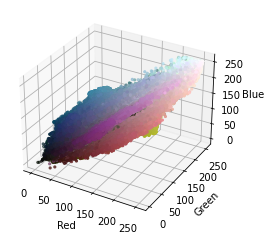

In [9]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors

r, g, b = cv2.split(training_frames[0])
fig = plt.figure()
axis = fig.add_subplot(1, 1, 1, projection="3d")


pixel_colors = training_frames[7].reshape((np.shape(training_frames[7])[0]*np.shape(training_frames[0])[1], 3))
norm = colors.Normalize(vmin=-1.,vmax=1.)
norm.autoscale(pixel_colors)
pixel_colors = norm(pixel_colors).tolist()

axis.scatter(r.flatten(), g.flatten(), b.flatten(), facecolors=pixel_colors, marker=".")
axis.set_xlabel("Red")
axis.set_ylabel("Green")
axis.set_zlabel("Blue")
plt.show()

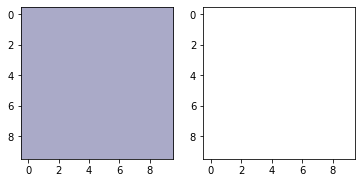

In [10]:
light_white = (170, 170, 200)
dark_white = (255, 255, 255)


lw_square = np.full((10, 10, 3), light_white, dtype=np.uint8) / 255.0
dw_square = np.full((10, 10, 3), dark_white, dtype=np.uint8) / 255.0

plt.subplot(1, 2, 1)
plt.imshow(lw_square)
plt.subplot(1, 2, 2)
plt.imshow(dw_square)
plt.show()

[[[ 60  61  66]
  [ 73  74  79]
  [ 76  76  84]
  ...
  [ 11  14  21]
  [  8  11  18]
  [  8  11  18]]

 [[ 60  61  66]
  [ 73  74  79]
  [ 76  76  84]
  ...
  [  9  12  19]
  [  7  10  17]
  [  7  10  17]]

 [[ 60  61  66]
  [ 73  74  79]
  [ 76  76  84]
  ...
  [  5   9  13]
  [  4   8  12]
  [  4   8  12]]

 ...

 [[ 93  74  37]
  [223 204 167]
  [216 198 156]
  ...
  [224 233 255]
  [224 233 255]
  [225 234 255]]

 [[ 91  72  49]
  [221 202 179]
  [214 195 168]
  ...
  [197 213 251]
  [199 215 253]
  [201 217 255]]

 [[ 54  35  12]
  [138 119  96]
  [187 168 141]
  ...
  [170 186 224]
  [172 188 226]
  [177 193 231]]]


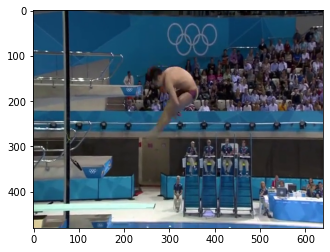

In [31]:
plt.imshow(test_frames[77])
print(test_frames[77])

5811 Pixel in Video: 0293.mp4


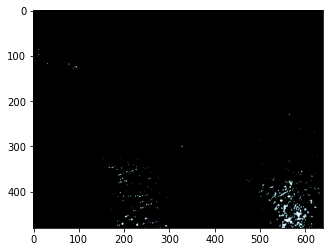

5769 Pixel in Video: 0293.mp4


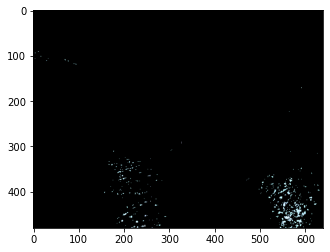

6411 Pixel in Video: 0293.mp4


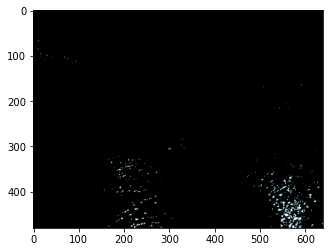

6411 Pixel in Video: 0293.mp4


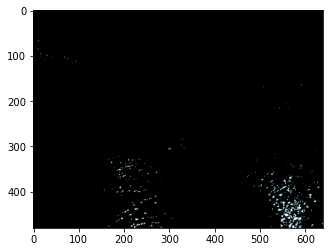

5730 Pixel in Video: 0293.mp4


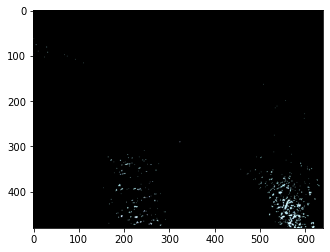

6264 Pixel in Video: 0293.mp4


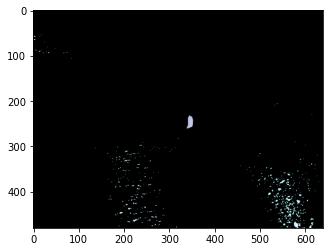

6579 Pixel in Video: 0293.mp4


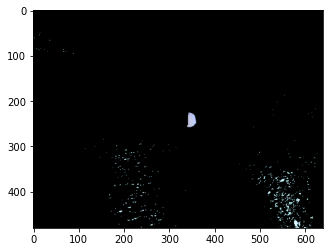

6960 Pixel in Video: 0293.mp4


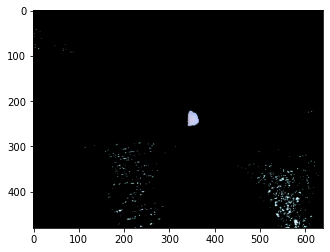

7026 Pixel in Video: 0293.mp4


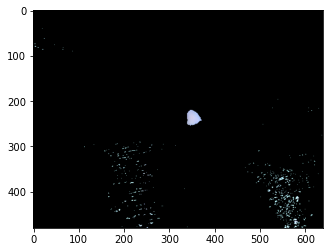

7575 Pixel in Video: 0293.mp4


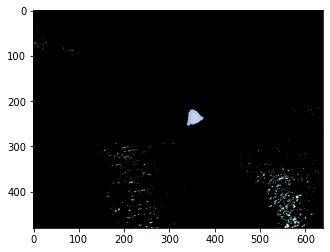

7056 Pixel in Video: 0293.mp4


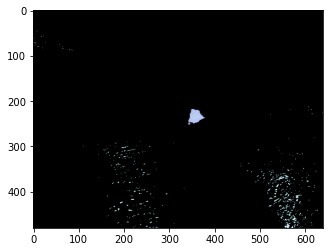

6666 Pixel in Video: 0293.mp4


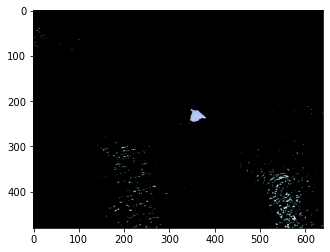

5547 Pixel in Video: 0293.mp4


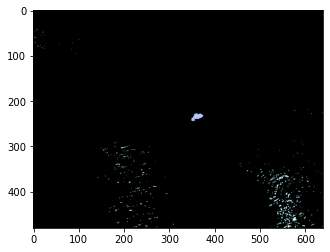

5265 Pixel in Video: 0293.mp4


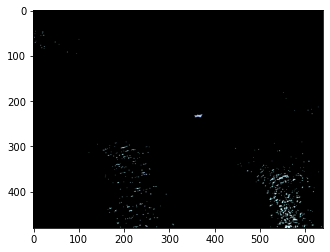

4806 Pixel in Video: 0293.mp4


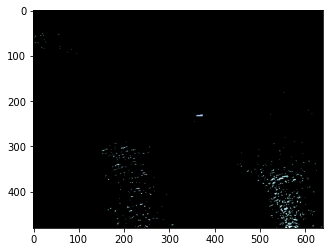

5208 Pixel in Video: 0293.mp4


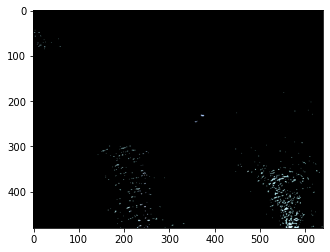

414 Pixel in Video: 0295.mp4


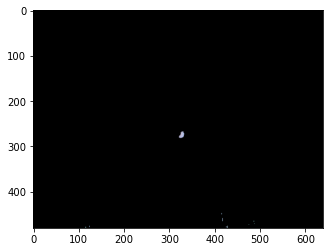

1197 Pixel in Video: 0295.mp4


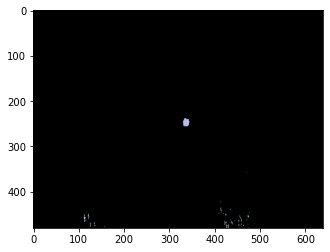

1755 Pixel in Video: 0295.mp4


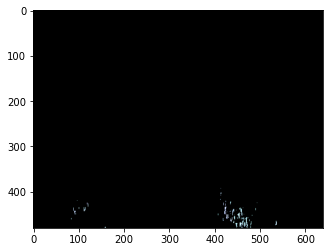

3042 Pixel in Video: 0295.mp4


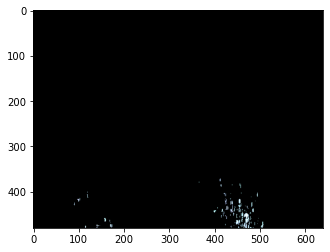

3363 Pixel in Video: 0295.mp4


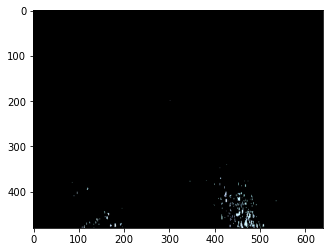

4929 Pixel in Video: 0295.mp4


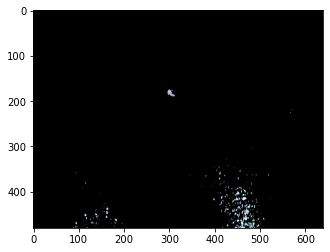

5919 Pixel in Video: 0295.mp4


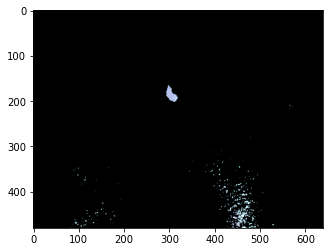

6531 Pixel in Video: 0295.mp4


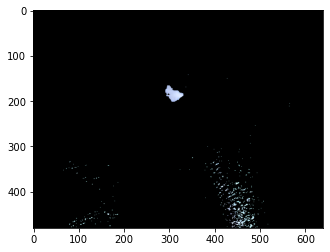

6966 Pixel in Video: 0295.mp4


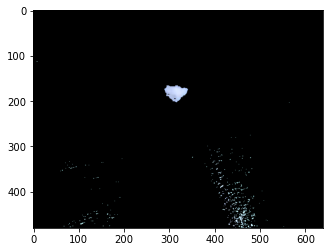

7440 Pixel in Video: 0295.mp4


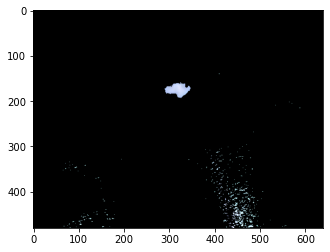

6813 Pixel in Video: 0295.mp4


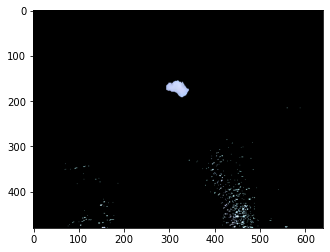

7431 Pixel in Video: 0295.mp4


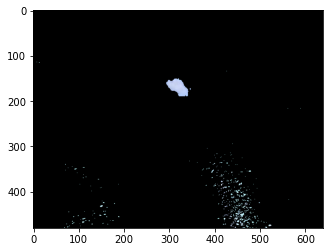

6990 Pixel in Video: 0295.mp4


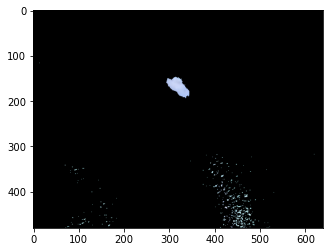

7044 Pixel in Video: 0295.mp4


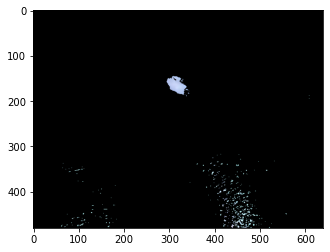

5982 Pixel in Video: 0295.mp4


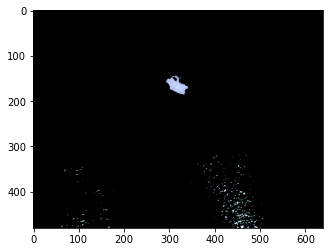

6372 Pixel in Video: 0295.mp4


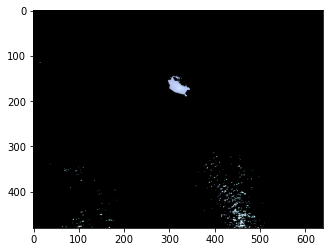

5706 Pixel in Video: 0295.mp4


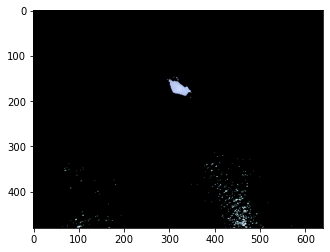

5997 Pixel in Video: 0295.mp4


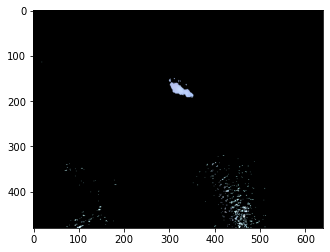

5076 Pixel in Video: 0295.mp4


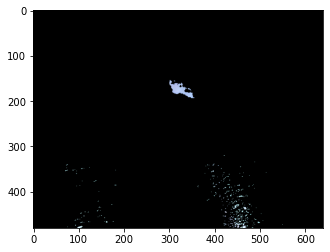

5118 Pixel in Video: 0295.mp4


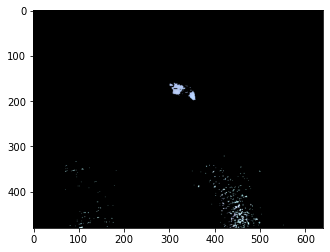

5394 Pixel in Video: 0295.mp4


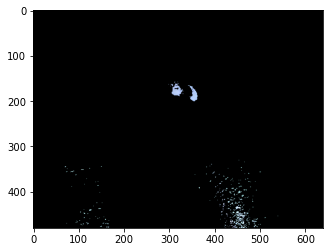

5544 Pixel in Video: 0295.mp4


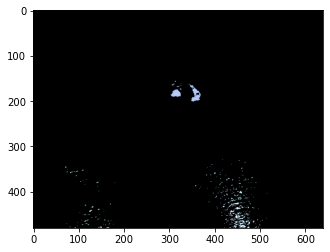

4746 Pixel in Video: 0295.mp4


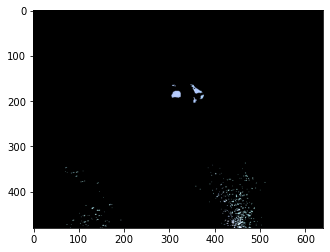

885 Pixel in Video: 0298.mp4


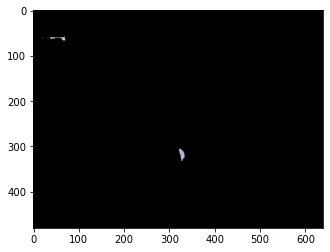

498 Pixel in Video: 0298.mp4


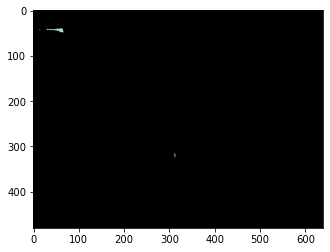

1248 Pixel in Video: 0298.mp4


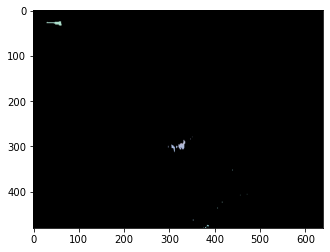

3933 Pixel in Video: 0298.mp4


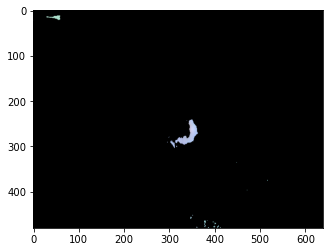

5757 Pixel in Video: 0298.mp4


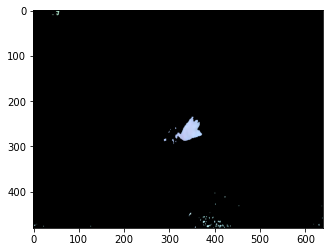

5985 Pixel in Video: 0298.mp4


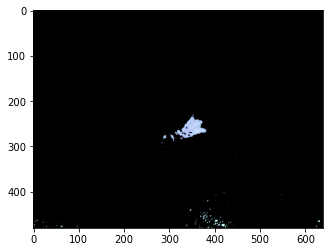

6882 Pixel in Video: 0298.mp4


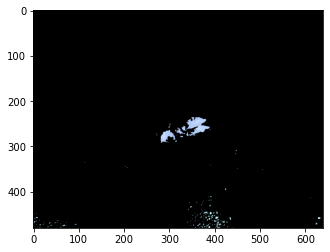

9768 Pixel in Video: 0298.mp4


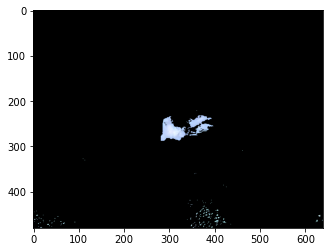

11154 Pixel in Video: 0298.mp4


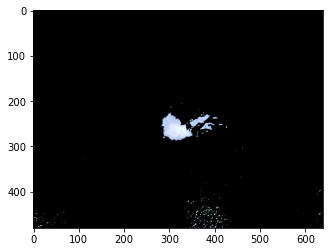

13398 Pixel in Video: 0298.mp4


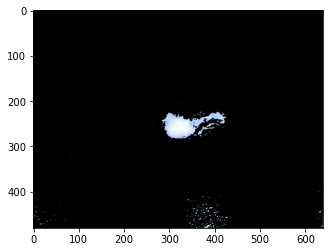

14223 Pixel in Video: 0298.mp4


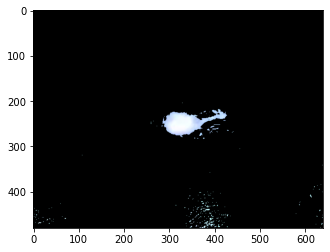

14889 Pixel in Video: 0298.mp4


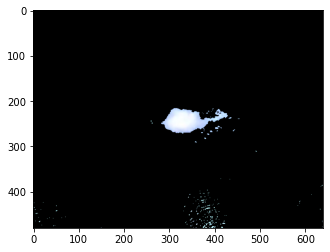

16269 Pixel in Video: 0298.mp4


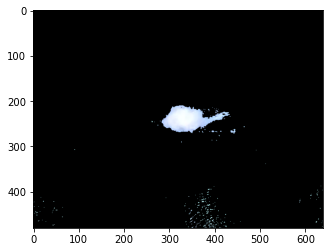

17187 Pixel in Video: 0298.mp4


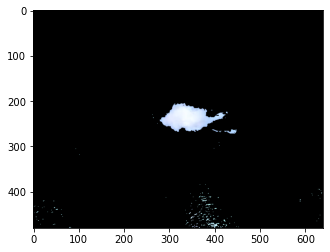

18873 Pixel in Video: 0298.mp4


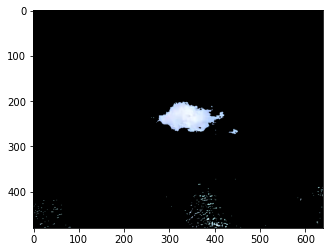

19161 Pixel in Video: 0298.mp4


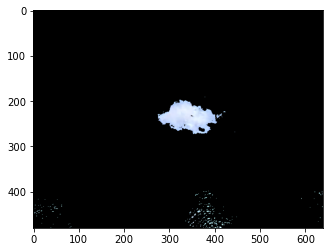

19479 Pixel in Video: 0298.mp4


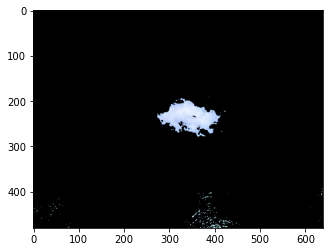

18390 Pixel in Video: 0298.mp4


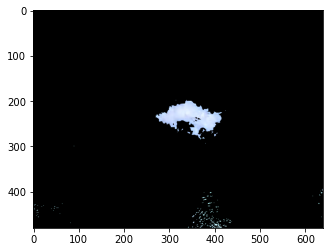

18216 Pixel in Video: 0298.mp4


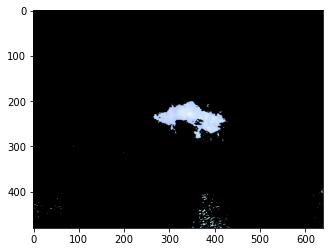

18051 Pixel in Video: 0298.mp4


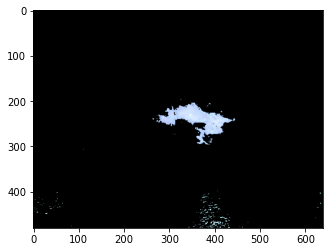

17349 Pixel in Video: 0298.mp4


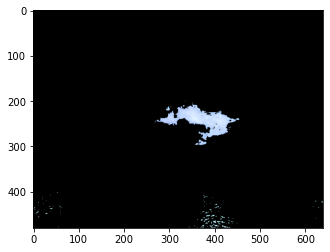

16053 Pixel in Video: 0298.mp4


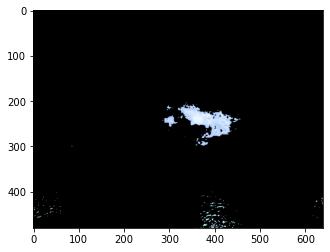

36 Pixel in Video: 0299.mp4


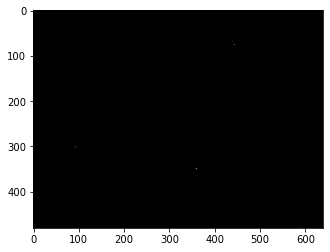

132 Pixel in Video: 0299.mp4


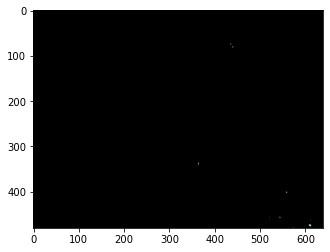

117 Pixel in Video: 0299.mp4


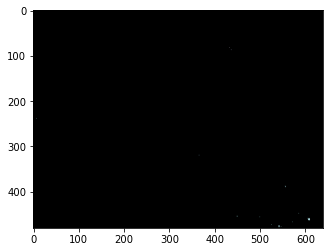

1116 Pixel in Video: 0299.mp4


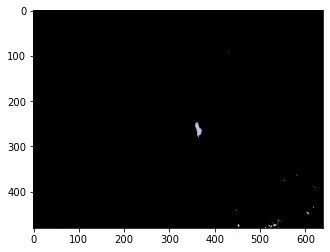

1626 Pixel in Video: 0299.mp4


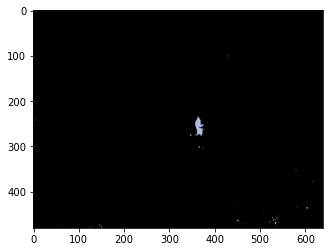

1020 Pixel in Video: 0299.mp4


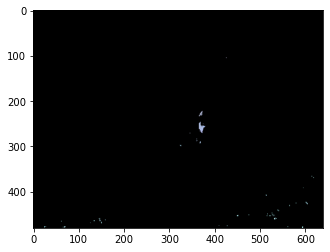

507 Pixel in Video: 0299.mp4


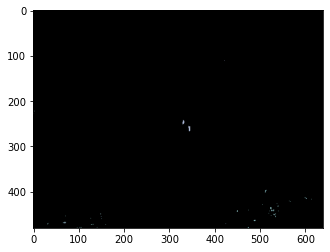

1332 Pixel in Video: 0299.mp4


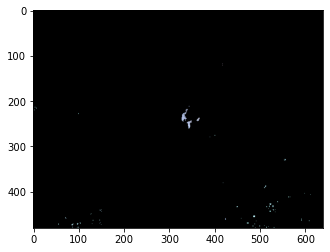

2436 Pixel in Video: 0299.mp4


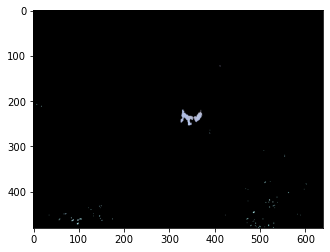

3627 Pixel in Video: 0299.mp4


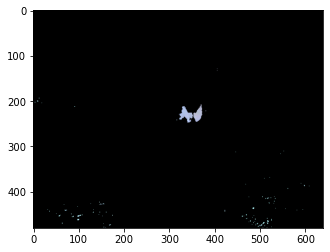

4260 Pixel in Video: 0299.mp4


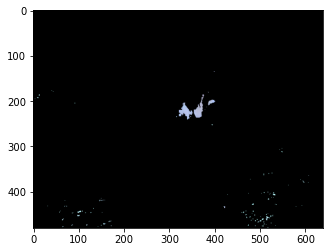

5580 Pixel in Video: 0299.mp4


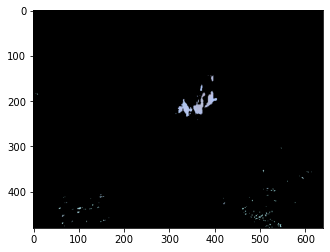

7569 Pixel in Video: 0299.mp4


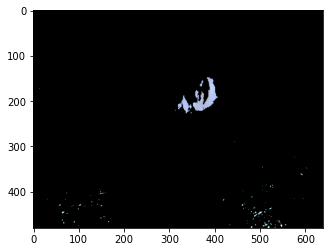

9108 Pixel in Video: 0299.mp4


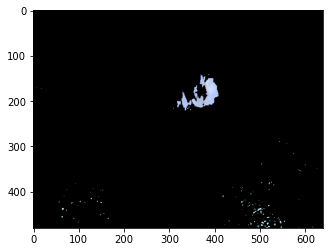

9705 Pixel in Video: 0299.mp4


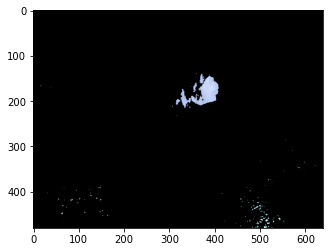

10017 Pixel in Video: 0299.mp4


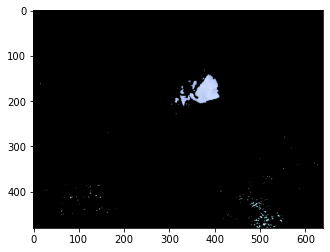

9645 Pixel in Video: 0299.mp4


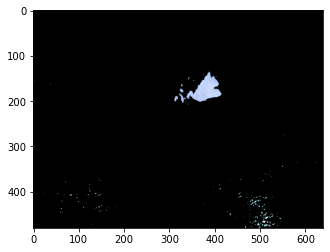

10464 Pixel in Video: 0299.mp4


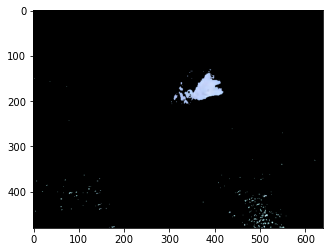

10392 Pixel in Video: 0299.mp4


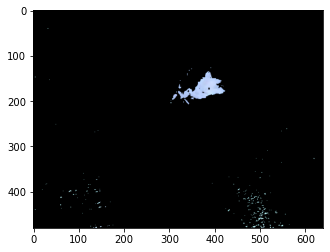

10647 Pixel in Video: 0299.mp4


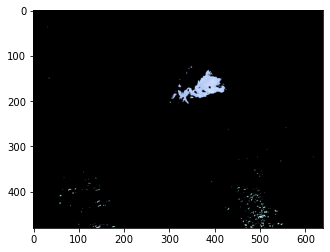

10368 Pixel in Video: 0299.mp4


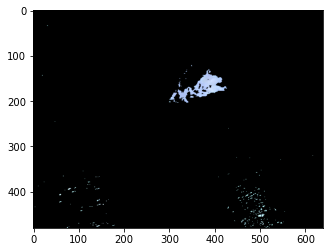

11568 Pixel in Video: 0299.mp4


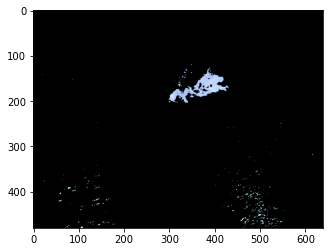

11505 Pixel in Video: 0299.mp4


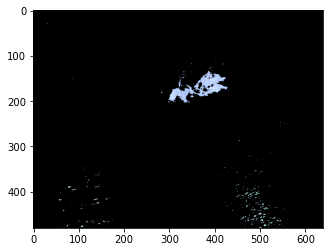

12933 Pixel in Video: 0299.mp4


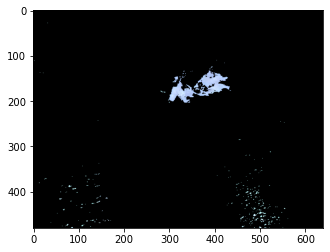

14130 Pixel in Video: 0299.mp4


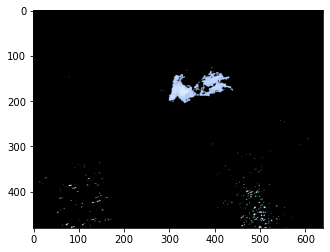

15186 Pixel in Video: 0299.mp4


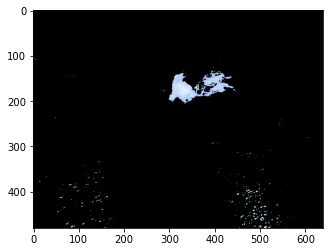

16206 Pixel in Video: 0299.mp4


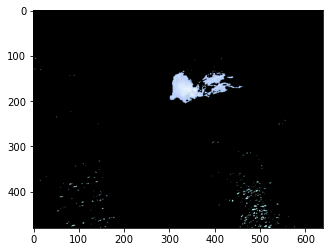

17220 Pixel in Video: 0299.mp4


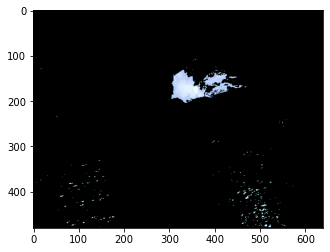

17301 Pixel in Video: 0299.mp4


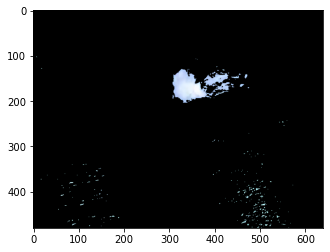

18645 Pixel in Video: 0299.mp4


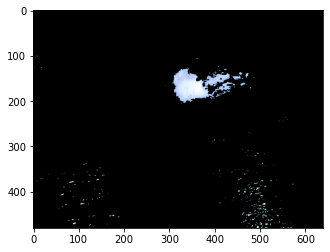

18774 Pixel in Video: 0299.mp4


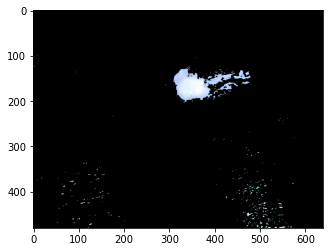

20688 Pixel in Video: 0299.mp4


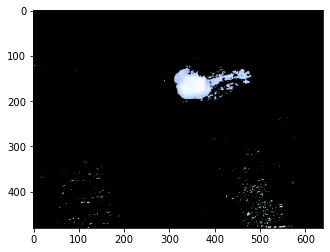

20145 Pixel in Video: 0299.mp4


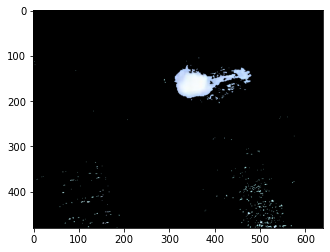

20373 Pixel in Video: 0299.mp4


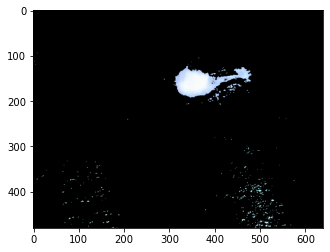

20373 Pixel in Video: 0299.mp4


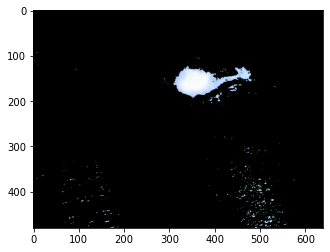

20763 Pixel in Video: 0299.mp4


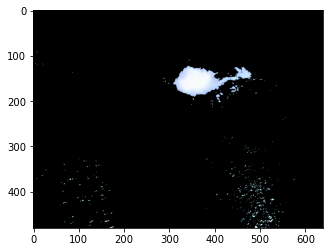

21216 Pixel in Video: 0299.mp4


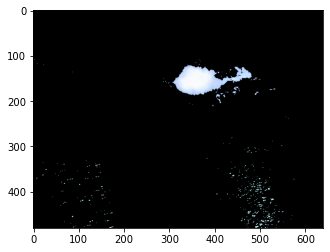

22212 Pixel in Video: 0299.mp4


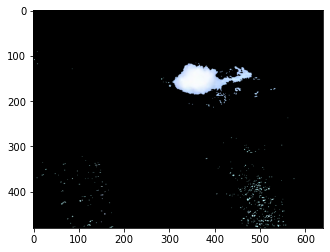

22911 Pixel in Video: 0299.mp4


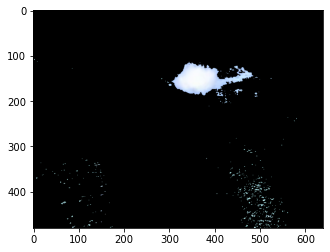

23391 Pixel in Video: 0299.mp4


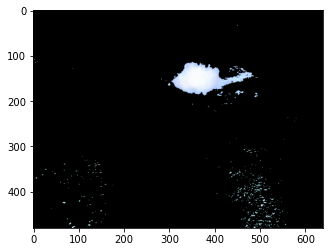

23244 Pixel in Video: 0299.mp4


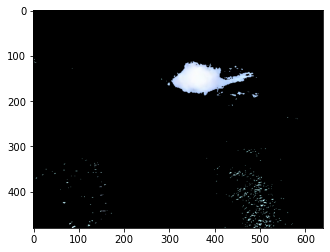

23619 Pixel in Video: 0299.mp4


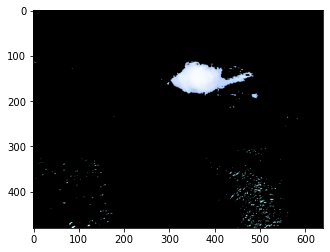

24129 Pixel in Video: 0299.mp4


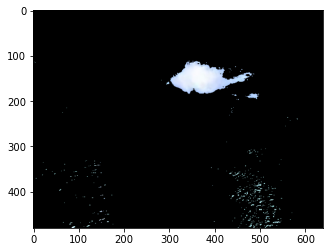

24900 Pixel in Video: 0299.mp4


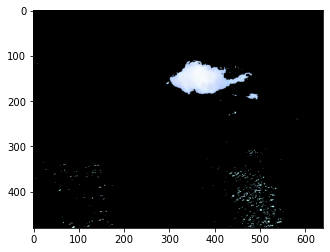

25305 Pixel in Video: 0299.mp4


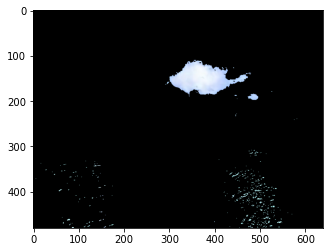

26358 Pixel in Video: 0299.mp4


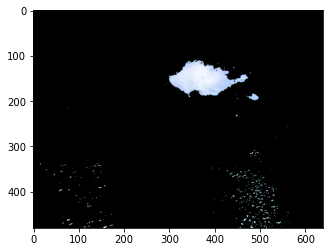

26661 Pixel in Video: 0299.mp4


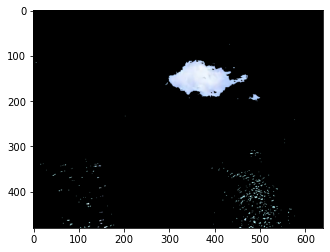

27546 Pixel in Video: 0299.mp4


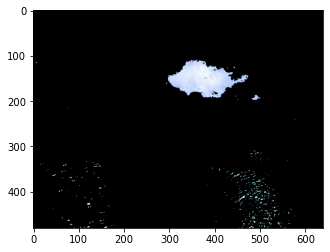

6009 Pixel in Video: 0301.mp4


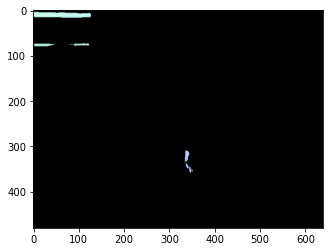

2301 Pixel in Video: 0301.mp4


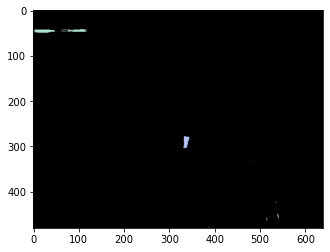

1629 Pixel in Video: 0301.mp4


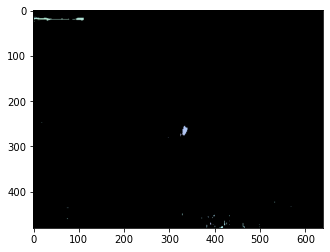

1827 Pixel in Video: 0301.mp4


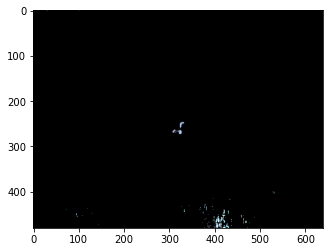

4461 Pixel in Video: 0301.mp4


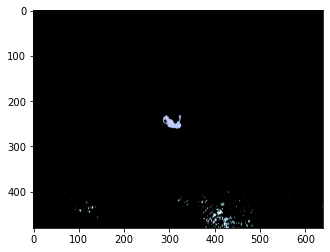

5658 Pixel in Video: 0301.mp4


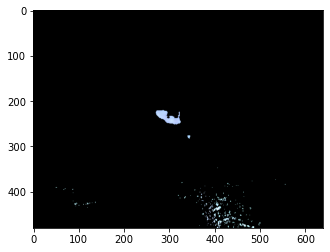

5751 Pixel in Video: 0301.mp4


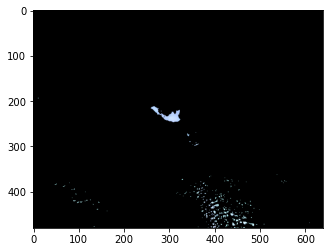

7071 Pixel in Video: 0301.mp4


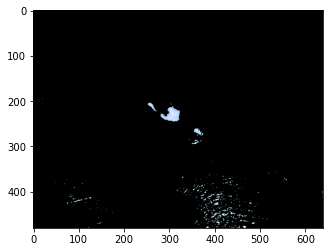

7602 Pixel in Video: 0301.mp4


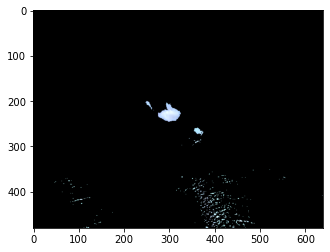

8151 Pixel in Video: 0301.mp4


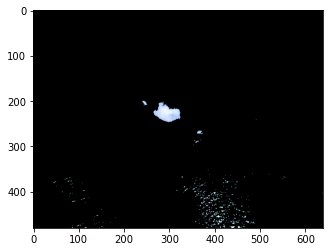

8349 Pixel in Video: 0301.mp4


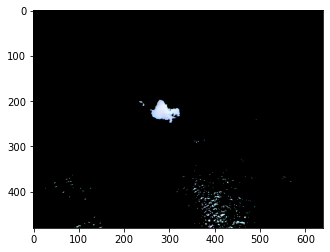

9000 Pixel in Video: 0301.mp4


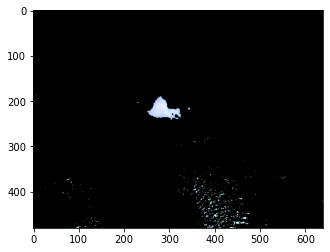

10350 Pixel in Video: 0301.mp4


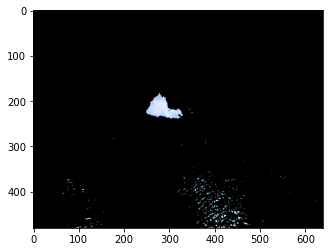

10509 Pixel in Video: 0301.mp4


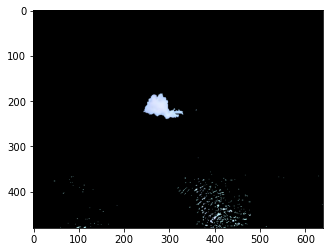

10869 Pixel in Video: 0301.mp4


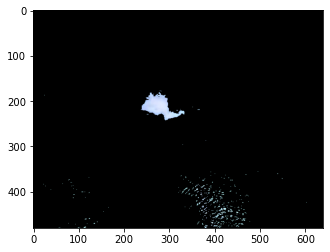

11388 Pixel in Video: 0301.mp4


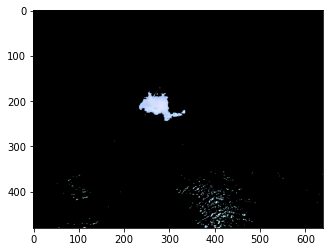

11121 Pixel in Video: 0301.mp4


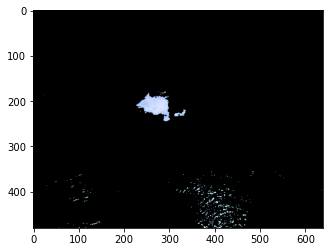

10290 Pixel in Video: 0301.mp4


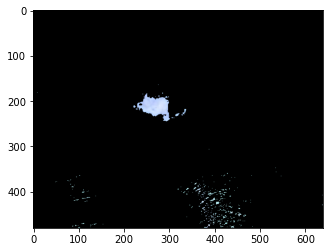

9579 Pixel in Video: 0301.mp4


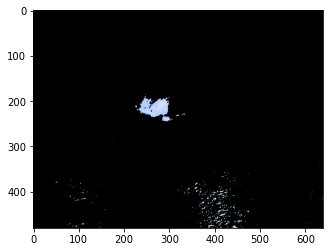

8517 Pixel in Video: 0301.mp4


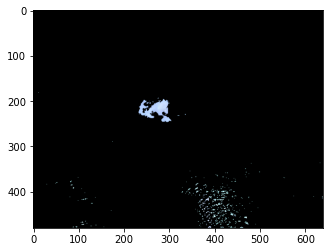

1119 Pixel in Video: 0302.mp4


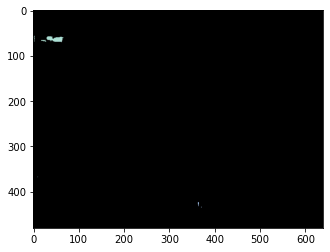

909 Pixel in Video: 0302.mp4


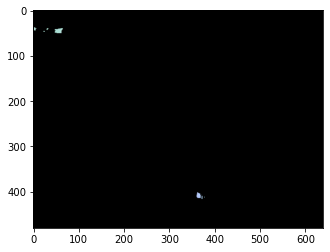

1308 Pixel in Video: 0302.mp4


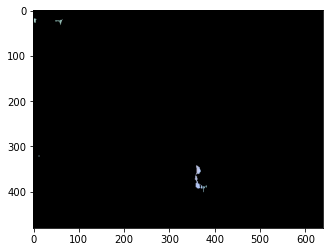

2511 Pixel in Video: 0302.mp4


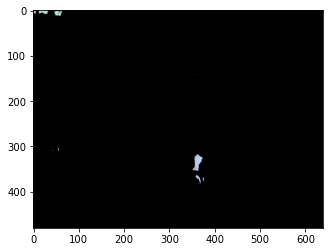

1536 Pixel in Video: 0302.mp4


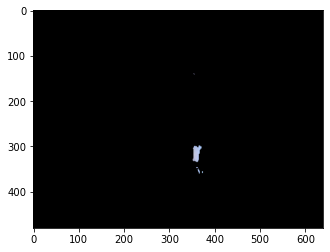

1350 Pixel in Video: 0302.mp4


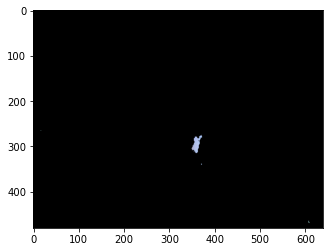

924 Pixel in Video: 0302.mp4


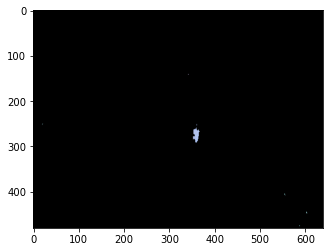

897 Pixel in Video: 0302.mp4


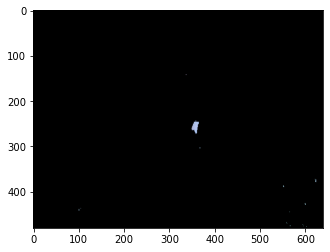

1323 Pixel in Video: 0302.mp4


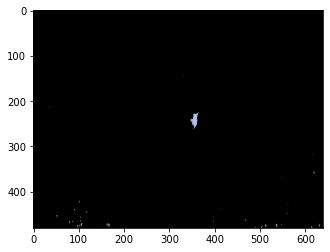

1455 Pixel in Video: 0302.mp4


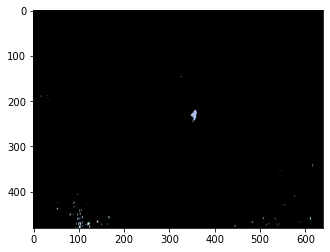

1533 Pixel in Video: 0302.mp4


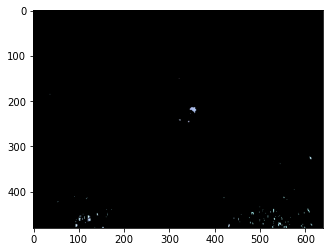

1746 Pixel in Video: 0302.mp4


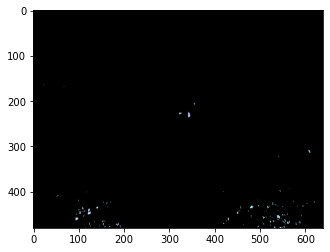

2625 Pixel in Video: 0302.mp4


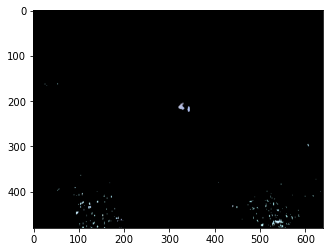

2898 Pixel in Video: 0302.mp4


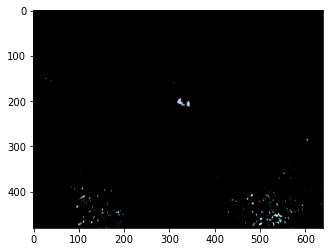

3975 Pixel in Video: 0302.mp4


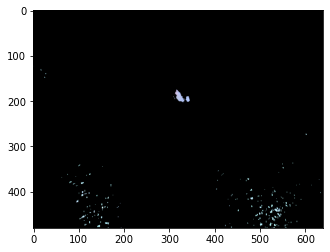

5541 Pixel in Video: 0302.mp4


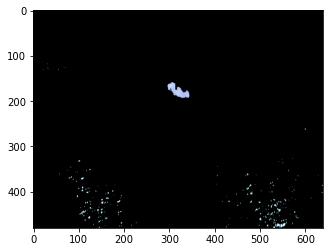

6876 Pixel in Video: 0302.mp4


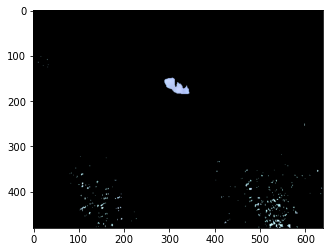

7788 Pixel in Video: 0302.mp4


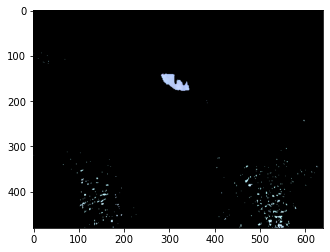

8220 Pixel in Video: 0302.mp4


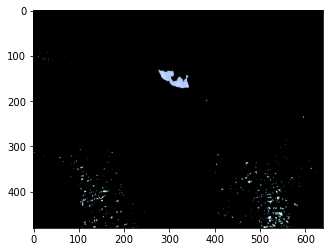

7452 Pixel in Video: 0302.mp4


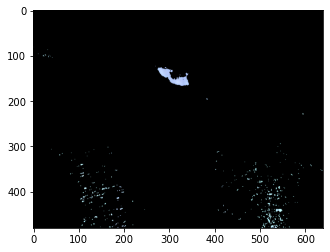

8193 Pixel in Video: 0302.mp4


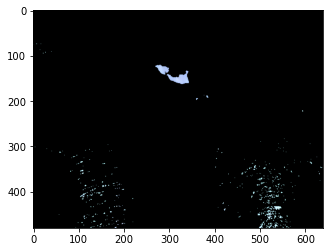

7914 Pixel in Video: 0302.mp4


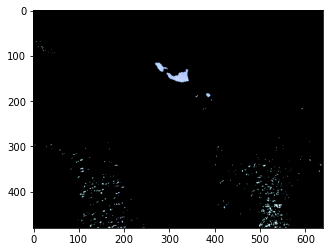

8082 Pixel in Video: 0302.mp4


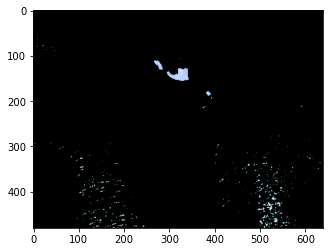

8799 Pixel in Video: 0302.mp4


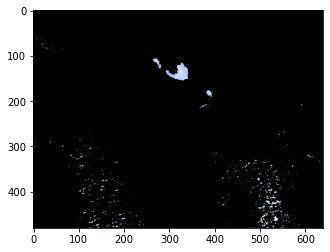

9174 Pixel in Video: 0302.mp4


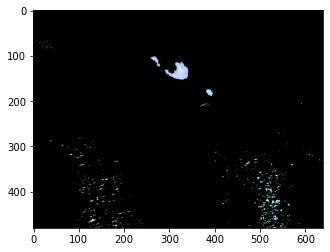

9624 Pixel in Video: 0302.mp4


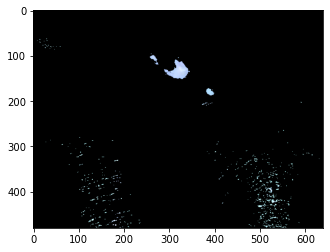

9945 Pixel in Video: 0302.mp4


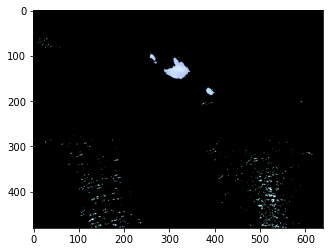

10317 Pixel in Video: 0302.mp4


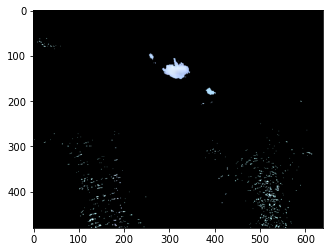

10767 Pixel in Video: 0302.mp4


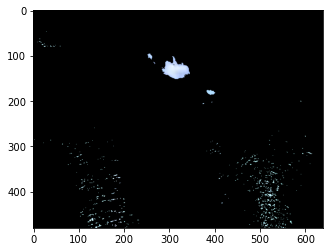

10887 Pixel in Video: 0302.mp4


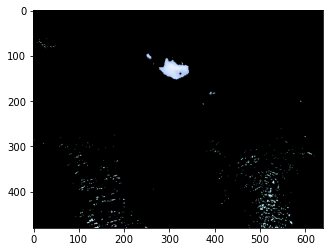

11175 Pixel in Video: 0302.mp4


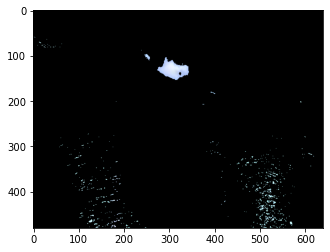

11532 Pixel in Video: 0302.mp4


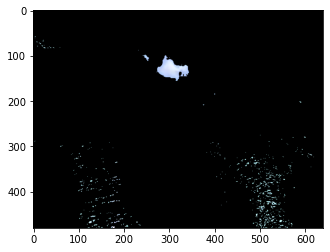

11196 Pixel in Video: 0302.mp4


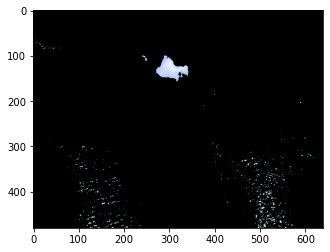

11556 Pixel in Video: 0302.mp4


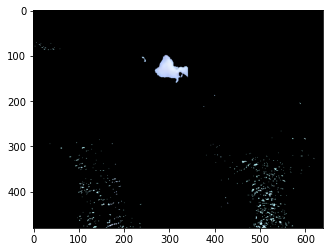

12432 Pixel in Video: 0302.mp4


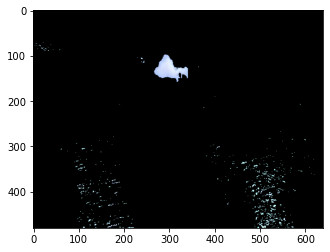

12246 Pixel in Video: 0302.mp4


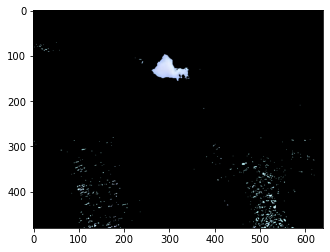

12588 Pixel in Video: 0302.mp4


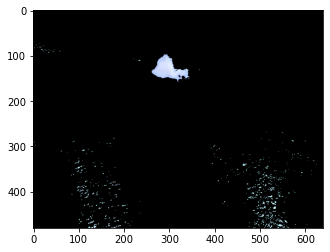

13089 Pixel in Video: 0302.mp4


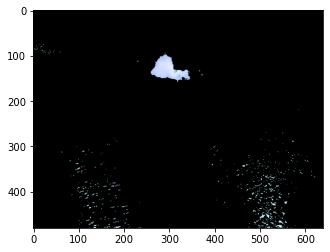

13554 Pixel in Video: 0302.mp4


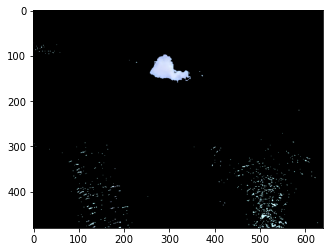

13854 Pixel in Video: 0302.mp4


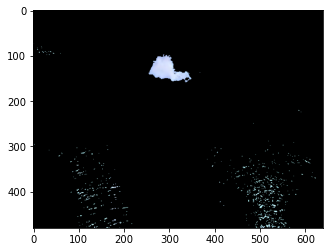

13983 Pixel in Video: 0302.mp4


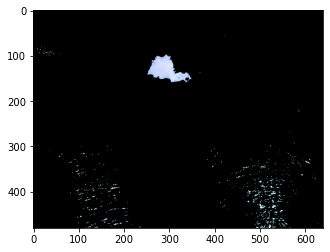

13995 Pixel in Video: 0302.mp4


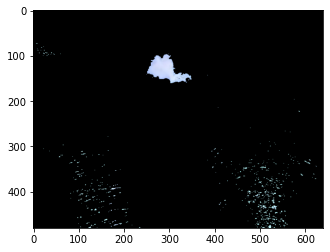

14580 Pixel in Video: 0302.mp4


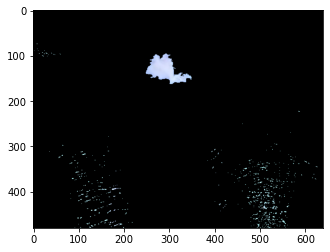

14862 Pixel in Video: 0302.mp4


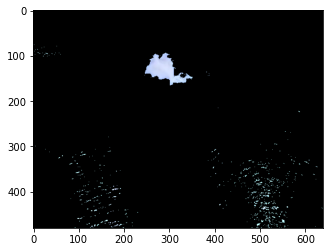

25704 Pixel in Video: 0303.mp4


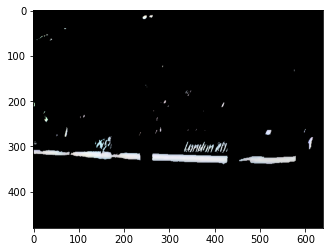

25713 Pixel in Video: 0303.mp4


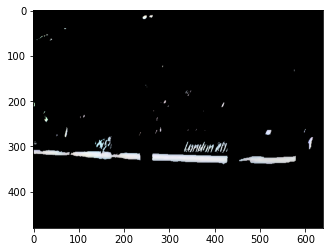

23229 Pixel in Video: 0303.mp4


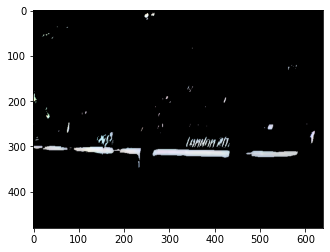

18492 Pixel in Video: 0303.mp4


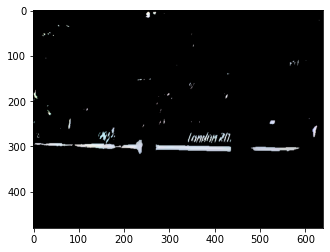

10914 Pixel in Video: 0303.mp4


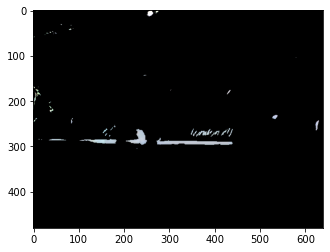

9525 Pixel in Video: 0303.mp4


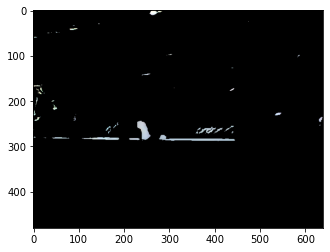

1173 Pixel in Video: 0303.mp4


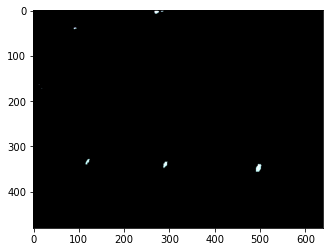

1164 Pixel in Video: 0303.mp4


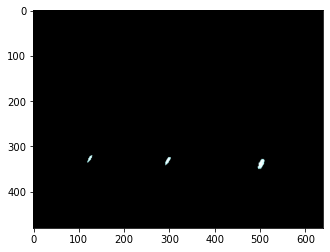

1407 Pixel in Video: 0303.mp4


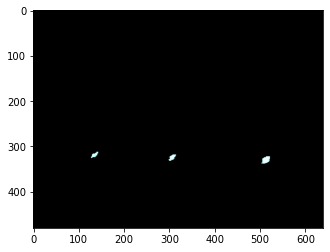

1128 Pixel in Video: 0303.mp4


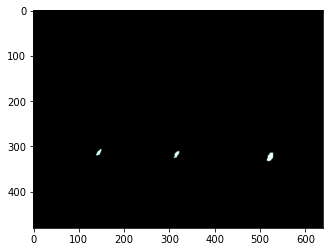

1104 Pixel in Video: 0303.mp4


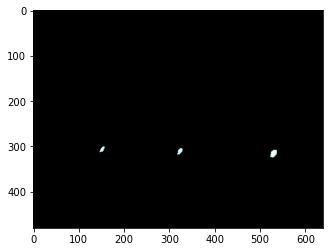

987 Pixel in Video: 0303.mp4


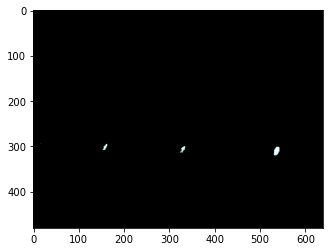

993 Pixel in Video: 0303.mp4


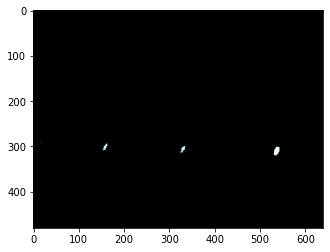

747 Pixel in Video: 0303.mp4


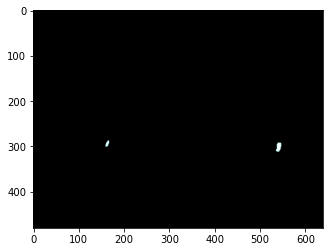

789 Pixel in Video: 0303.mp4


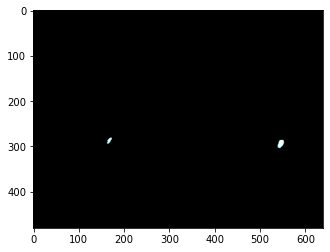

822 Pixel in Video: 0303.mp4


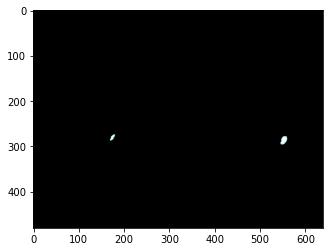

831 Pixel in Video: 0303.mp4


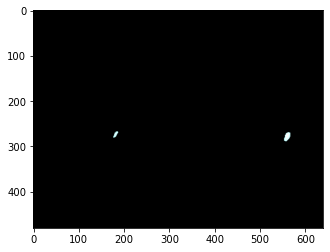

14724 Pixel in Video: 0304.mp4


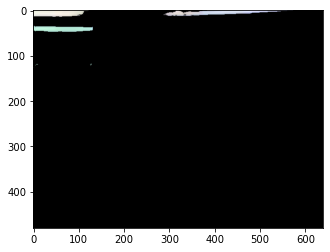

14730 Pixel in Video: 0304.mp4


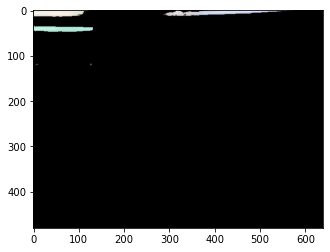

5592 Pixel in Video: 0304.mp4


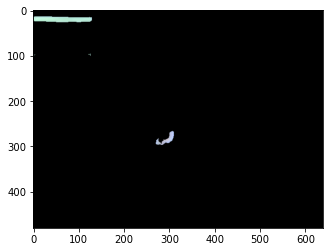

2793 Pixel in Video: 0304.mp4


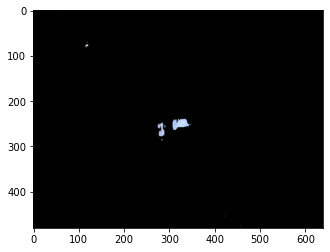

2991 Pixel in Video: 0304.mp4


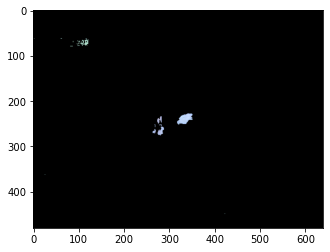

3402 Pixel in Video: 0304.mp4


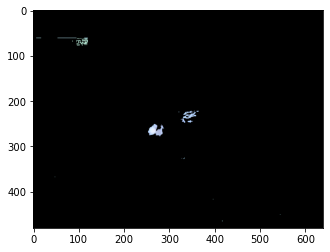

2865 Pixel in Video: 0304.mp4


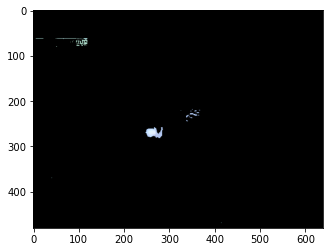

2937 Pixel in Video: 0304.mp4


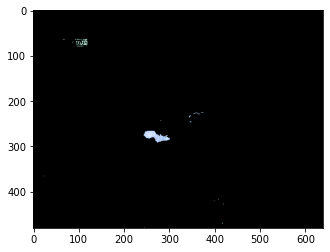

4497 Pixel in Video: 0304.mp4


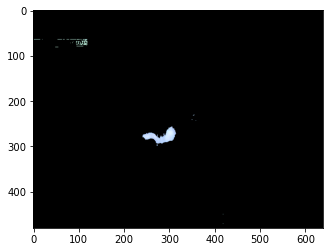

6474 Pixel in Video: 0304.mp4


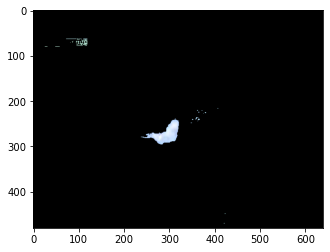

7941 Pixel in Video: 0304.mp4


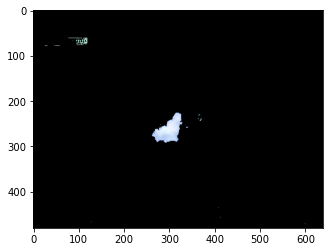

8535 Pixel in Video: 0304.mp4


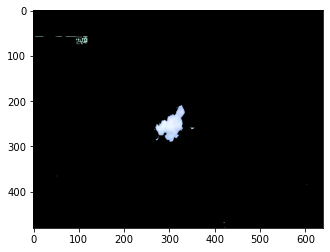

9072 Pixel in Video: 0304.mp4


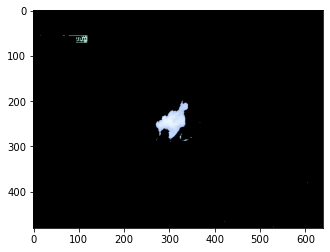

9180 Pixel in Video: 0304.mp4


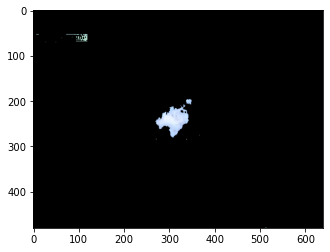

9645 Pixel in Video: 0304.mp4


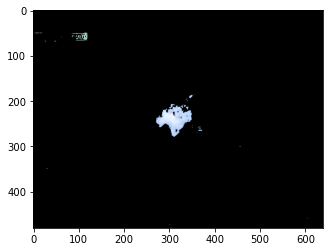

9378 Pixel in Video: 0304.mp4


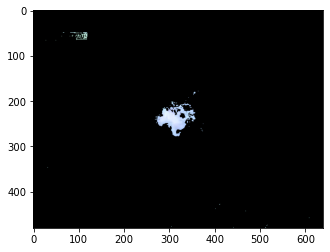

9003 Pixel in Video: 0304.mp4


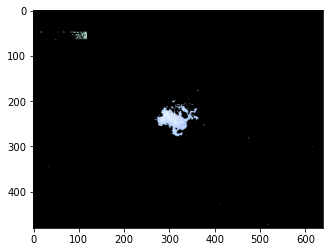

7602 Pixel in Video: 0304.mp4


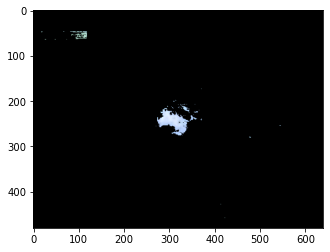

7290 Pixel in Video: 0304.mp4


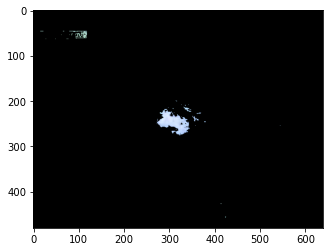

24015 Pixel in Video: 0305.mp4


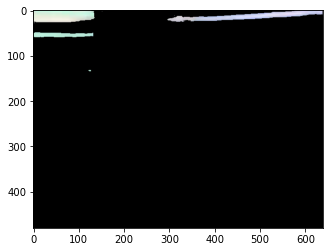

15087 Pixel in Video: 0305.mp4


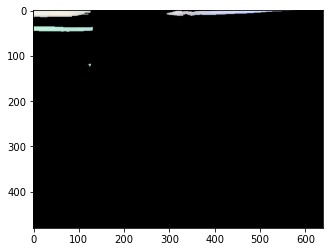

5010 Pixel in Video: 0305.mp4


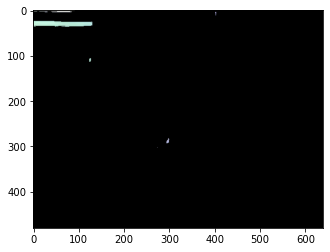

5010 Pixel in Video: 0305.mp4


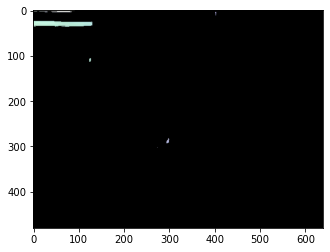

5844 Pixel in Video: 0305.mp4


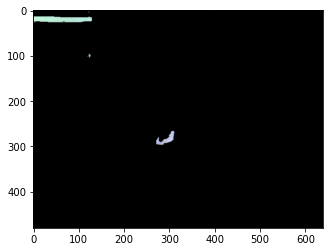

6771 Pixel in Video: 0305.mp4


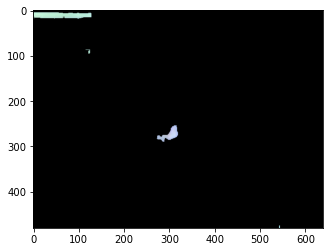

6774 Pixel in Video: 0305.mp4


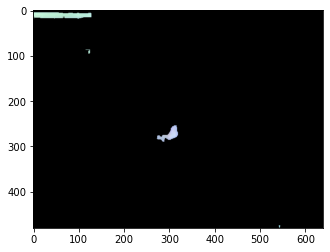

7131 Pixel in Video: 0305.mp4


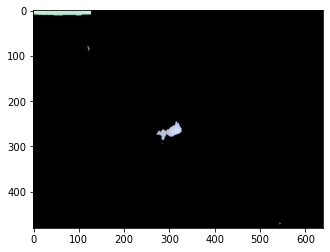

7131 Pixel in Video: 0305.mp4


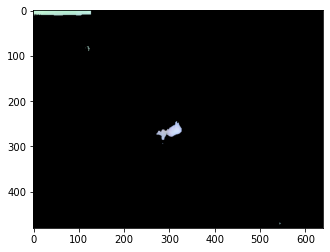

4767 Pixel in Video: 0305.mp4


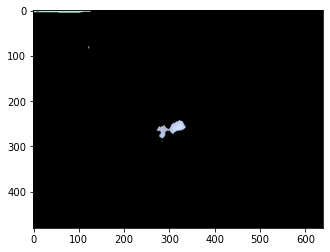

3342 Pixel in Video: 0305.mp4


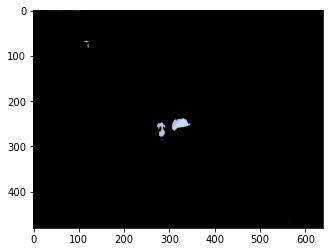

3348 Pixel in Video: 0305.mp4


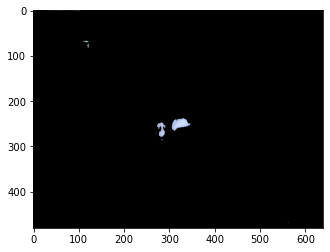

2709 Pixel in Video: 0305.mp4


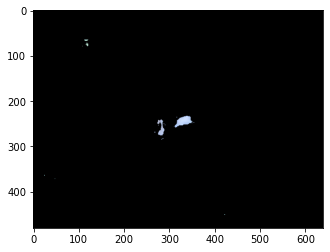

2709 Pixel in Video: 0305.mp4


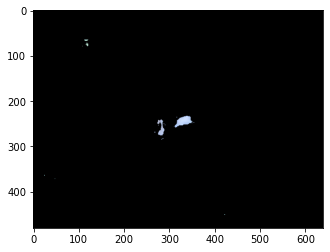

3228 Pixel in Video: 0305.mp4


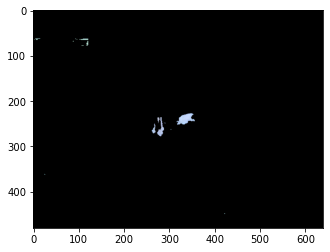

3225 Pixel in Video: 0305.mp4


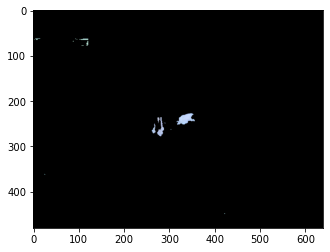

3231 Pixel in Video: 0305.mp4


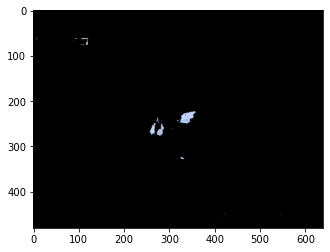

3231 Pixel in Video: 0305.mp4


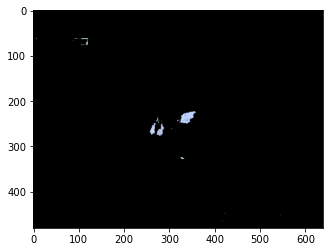

3243 Pixel in Video: 0305.mp4


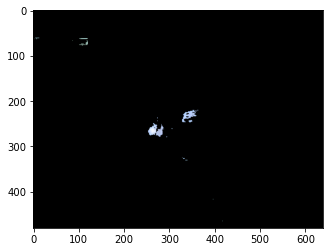

2802 Pixel in Video: 0305.mp4


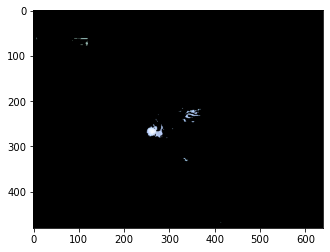

2970 Pixel in Video: 0305.mp4


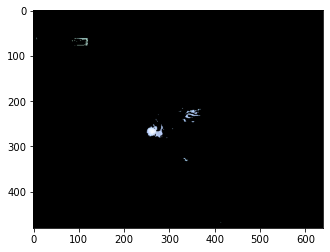

2748 Pixel in Video: 0305.mp4


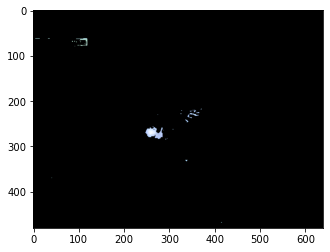

2751 Pixel in Video: 0305.mp4


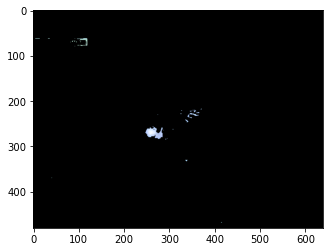

2691 Pixel in Video: 0305.mp4


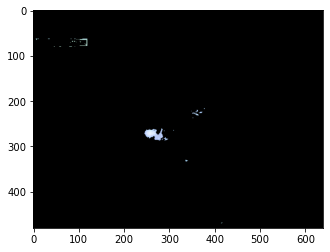

3000 Pixel in Video: 0305.mp4


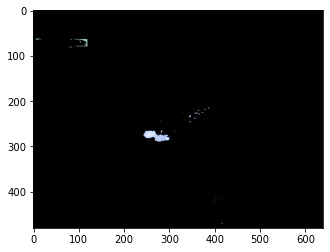

3009 Pixel in Video: 0305.mp4


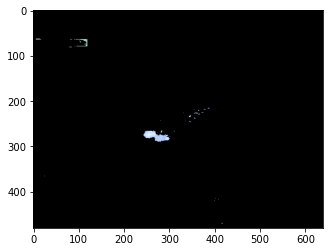

3510 Pixel in Video: 0305.mp4


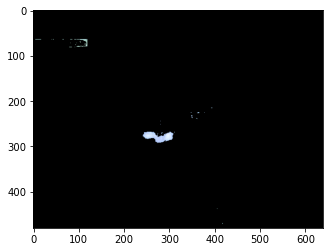

4494 Pixel in Video: 0305.mp4


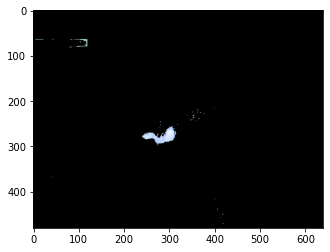

4482 Pixel in Video: 0305.mp4


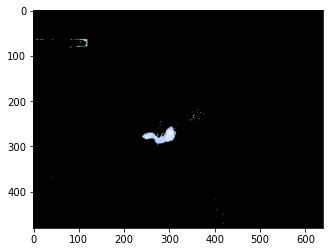

5229 Pixel in Video: 0305.mp4


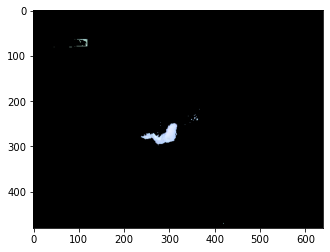

20265 Pixel in Video: 0308.mp4


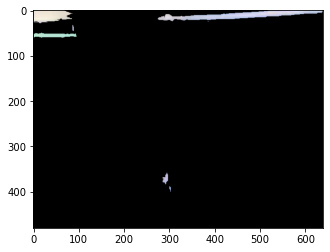

2742 Pixel in Video: 0308.mp4


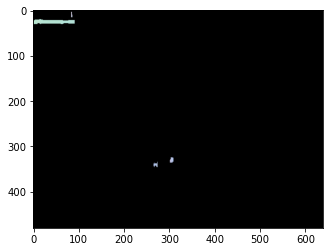

4119 Pixel in Video: 0308.mp4


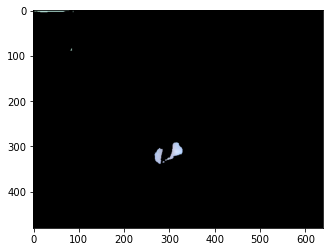

4227 Pixel in Video: 0308.mp4


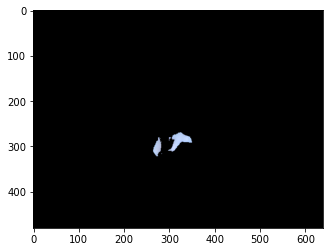

2610 Pixel in Video: 0308.mp4


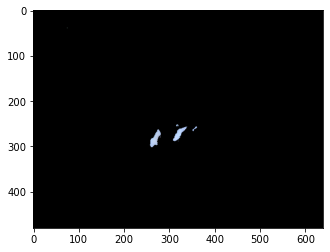

2826 Pixel in Video: 0308.mp4


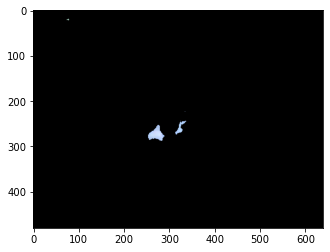

3153 Pixel in Video: 0308.mp4


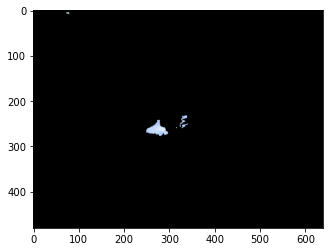

3741 Pixel in Video: 0308.mp4


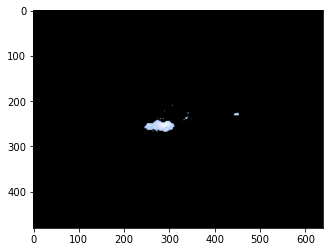

6042 Pixel in Video: 0308.mp4


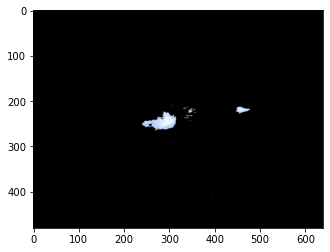

7080 Pixel in Video: 0308.mp4


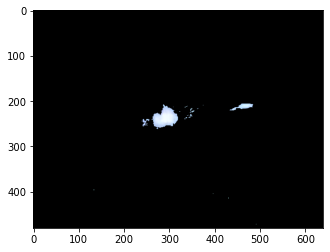

7629 Pixel in Video: 0308.mp4


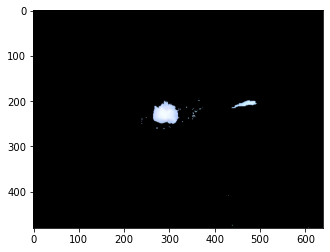

7149 Pixel in Video: 0308.mp4


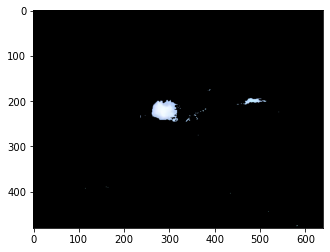

6660 Pixel in Video: 0308.mp4


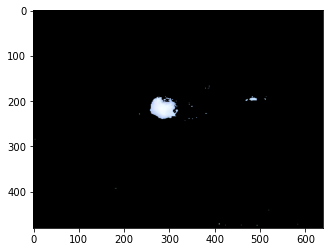

6378 Pixel in Video: 0308.mp4


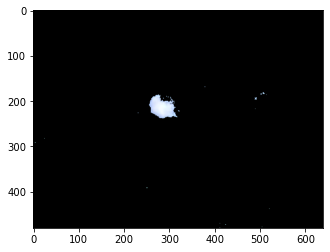

6765 Pixel in Video: 0308.mp4


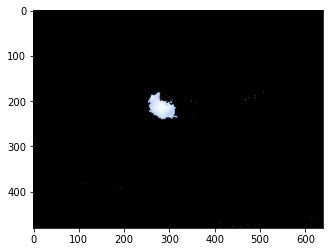

6363 Pixel in Video: 0308.mp4


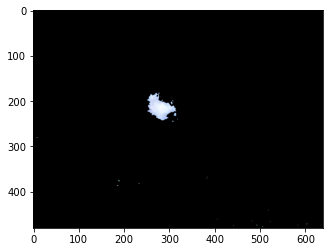

6057 Pixel in Video: 0308.mp4


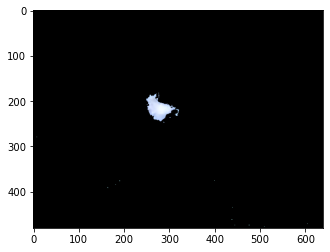

5682 Pixel in Video: 0308.mp4


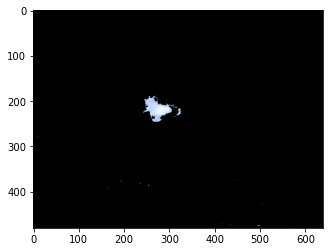

5484 Pixel in Video: 0308.mp4


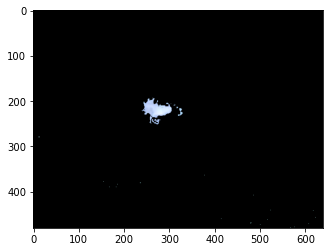

4851 Pixel in Video: 0308.mp4


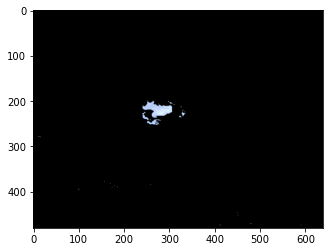

4311 Pixel in Video: 0308.mp4


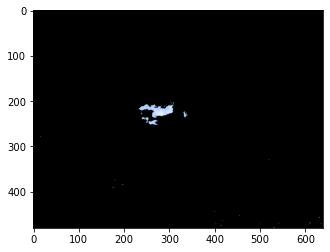

3918 Pixel in Video: 0308.mp4


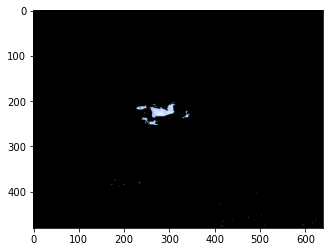

3459 Pixel in Video: 0308.mp4


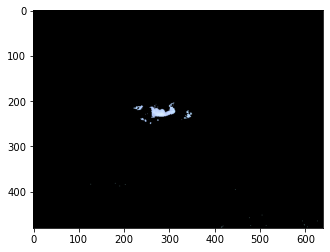

2814 Pixel in Video: 0308.mp4


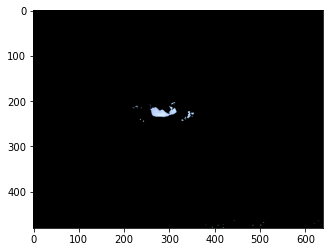

2751 Pixel in Video: 0308.mp4


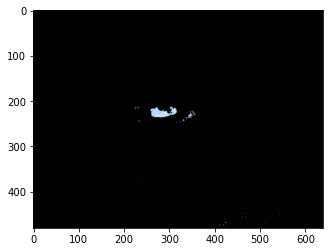

2844 Pixel in Video: 0308.mp4


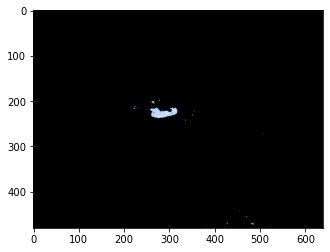

3135 Pixel in Video: 0308.mp4


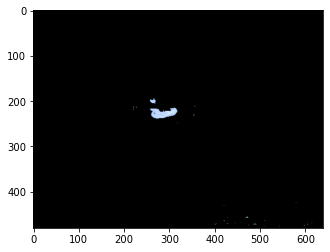

3348 Pixel in Video: 0308.mp4


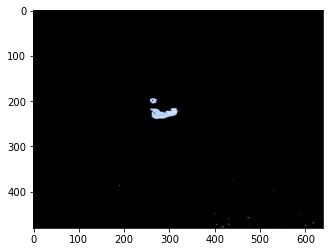

3348 Pixel in Video: 0308.mp4


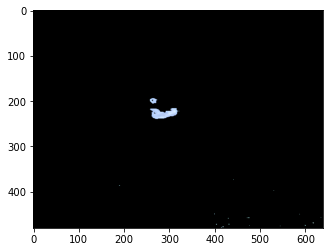

3423 Pixel in Video: 0308.mp4


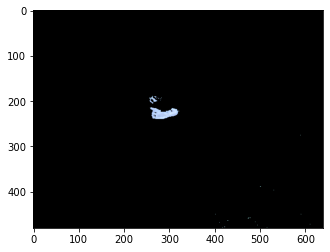

4245 Pixel in Video: 0308.mp4


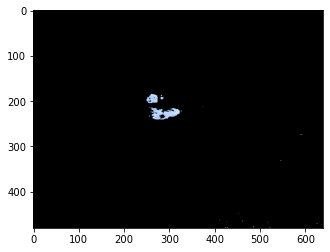

4680 Pixel in Video: 0308.mp4


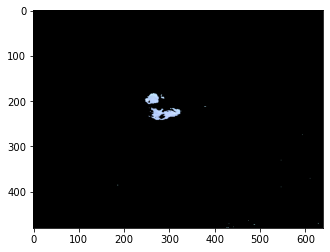

4524 Pixel in Video: 0308.mp4


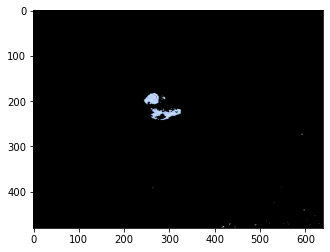

4704 Pixel in Video: 0308.mp4


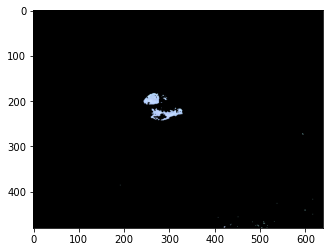

429 Pixel in Video: 0308.mp4


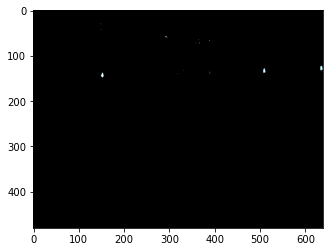

387 Pixel in Video: 0308.mp4


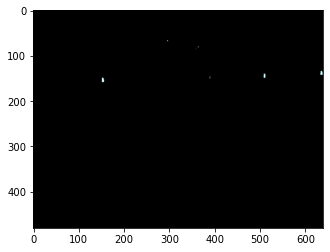

402 Pixel in Video: 0308.mp4


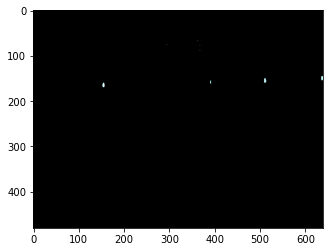

23733 Pixel in Video: 0309.mp4


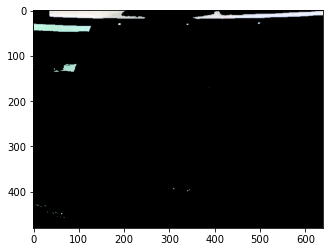

20196 Pixel in Video: 0309.mp4


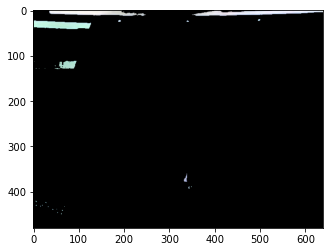

14478 Pixel in Video: 0309.mp4


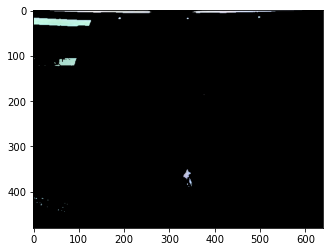

8235 Pixel in Video: 0309.mp4


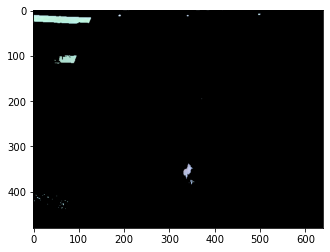

8256 Pixel in Video: 0309.mp4


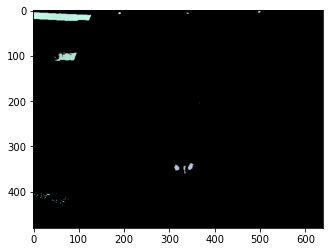

8142 Pixel in Video: 0309.mp4


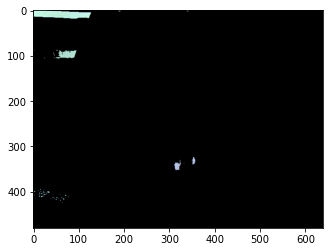

7860 Pixel in Video: 0309.mp4


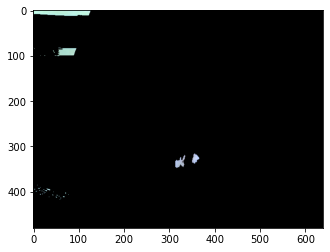

7245 Pixel in Video: 0309.mp4


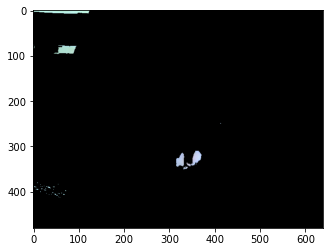

6714 Pixel in Video: 0309.mp4


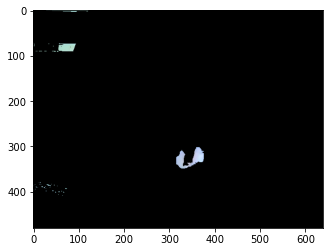

6633 Pixel in Video: 0309.mp4


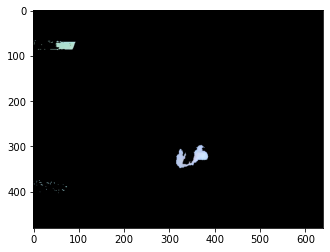

7416 Pixel in Video: 0309.mp4


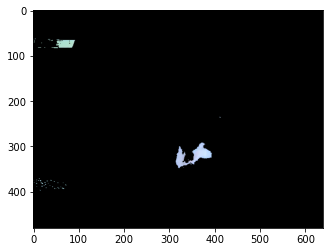

7761 Pixel in Video: 0309.mp4


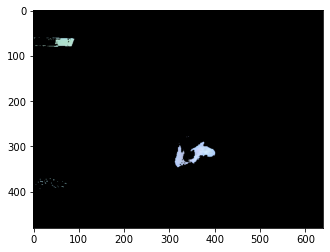

7773 Pixel in Video: 0309.mp4


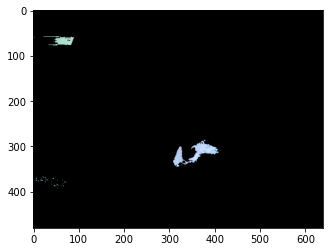

7482 Pixel in Video: 0309.mp4


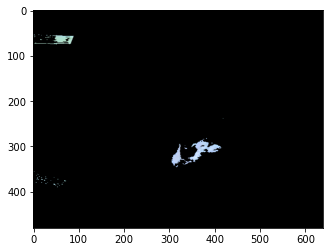

7290 Pixel in Video: 0309.mp4


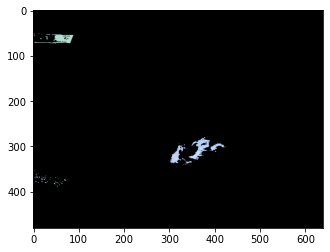

6999 Pixel in Video: 0309.mp4


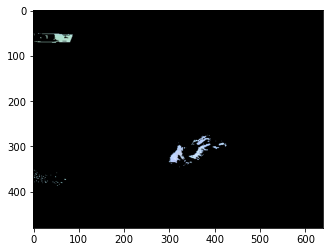

7230 Pixel in Video: 0309.mp4


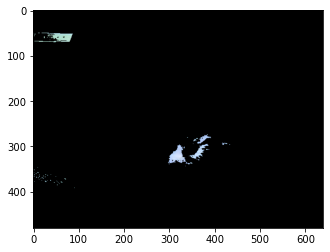

7011 Pixel in Video: 0309.mp4


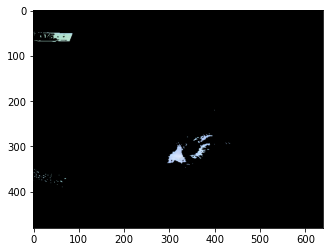

6849 Pixel in Video: 0309.mp4


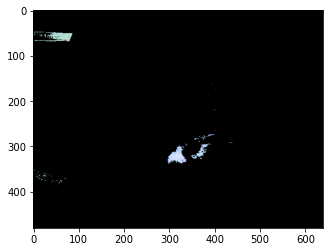

6720 Pixel in Video: 0309.mp4


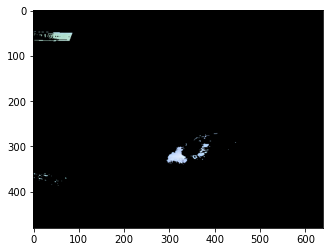

6624 Pixel in Video: 0309.mp4


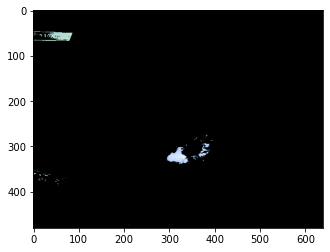

6429 Pixel in Video: 0309.mp4


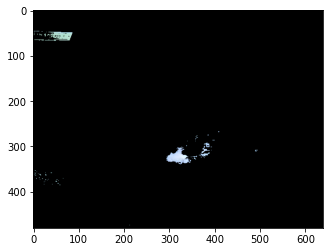

7026 Pixel in Video: 0309.mp4


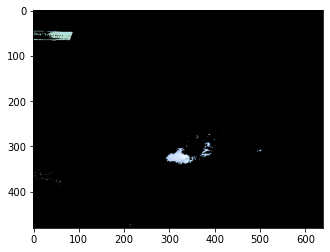

7419 Pixel in Video: 0309.mp4


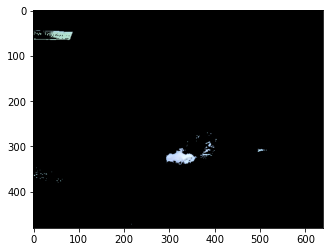

8187 Pixel in Video: 0309.mp4


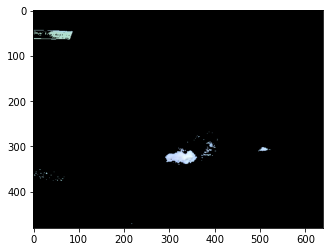

8946 Pixel in Video: 0309.mp4


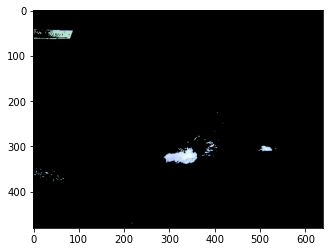

9534 Pixel in Video: 0309.mp4


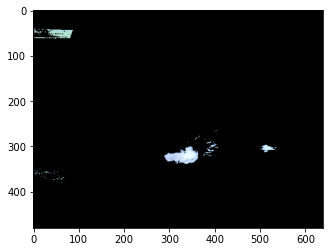

10299 Pixel in Video: 0309.mp4


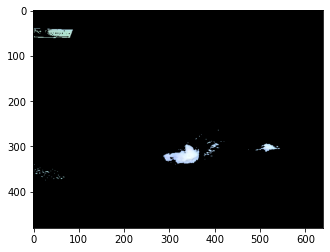

10851 Pixel in Video: 0309.mp4


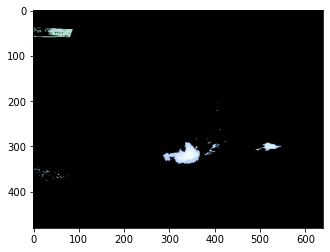

11112 Pixel in Video: 0309.mp4


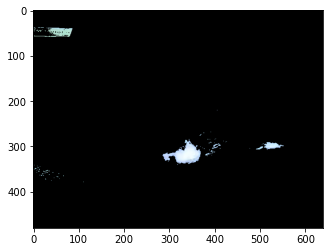

11364 Pixel in Video: 0309.mp4


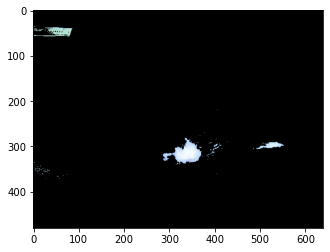

11541 Pixel in Video: 0309.mp4


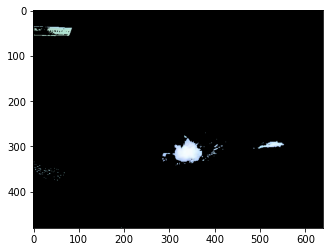

11646 Pixel in Video: 0309.mp4


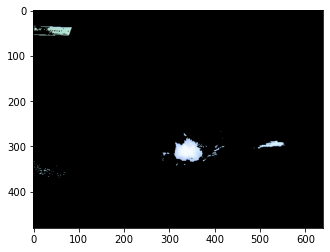

11853 Pixel in Video: 0309.mp4


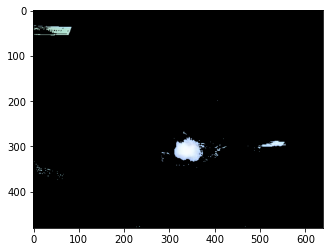

11904 Pixel in Video: 0309.mp4


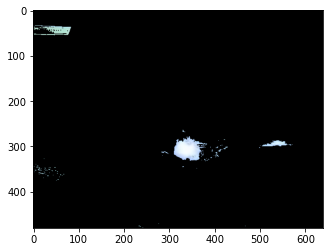

11823 Pixel in Video: 0309.mp4


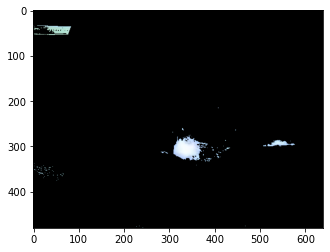

11619 Pixel in Video: 0309.mp4


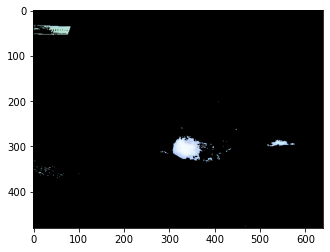

11433 Pixel in Video: 0309.mp4


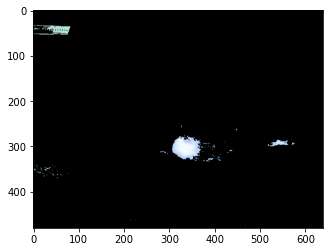

11139 Pixel in Video: 0309.mp4


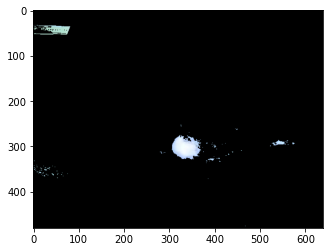

10992 Pixel in Video: 0309.mp4


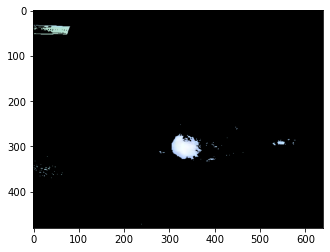

10704 Pixel in Video: 0309.mp4


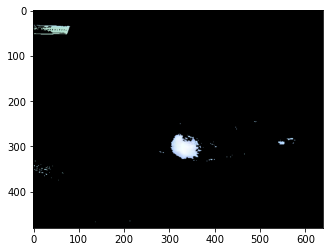

10365 Pixel in Video: 0309.mp4


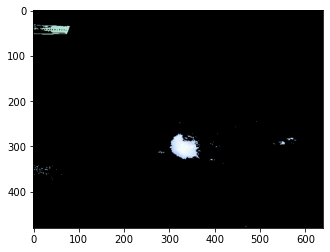

10152 Pixel in Video: 0309.mp4


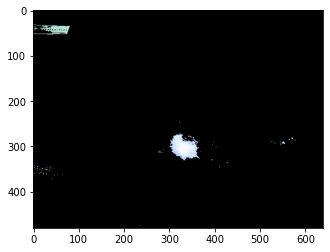

10092 Pixel in Video: 0309.mp4


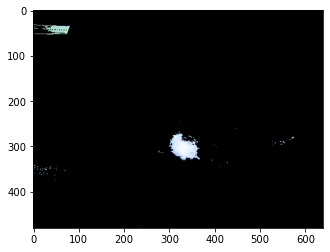

10122 Pixel in Video: 0309.mp4


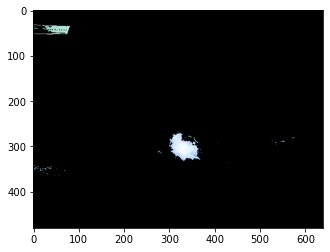

10206 Pixel in Video: 0309.mp4


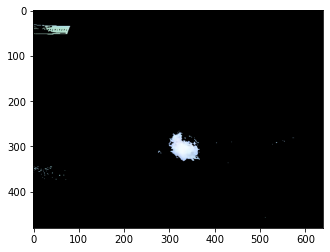

10266 Pixel in Video: 0309.mp4


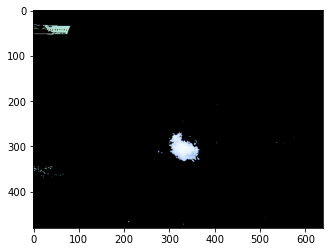

10092 Pixel in Video: 0309.mp4


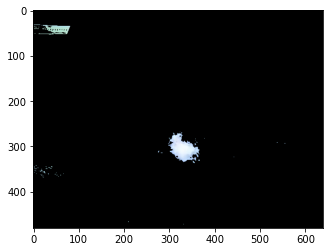

9891 Pixel in Video: 0309.mp4


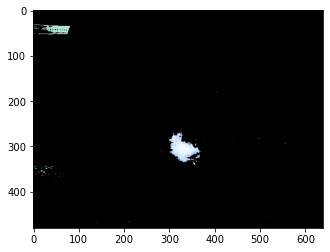

9741 Pixel in Video: 0309.mp4


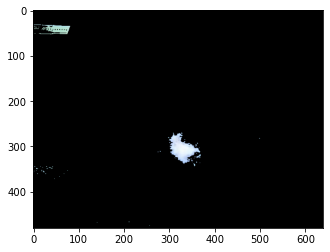

9498 Pixel in Video: 0309.mp4


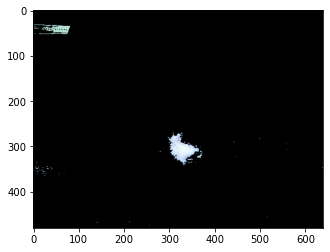

9504 Pixel in Video: 0309.mp4


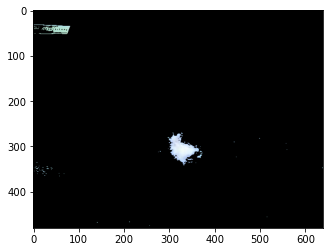

9480 Pixel in Video: 0309.mp4


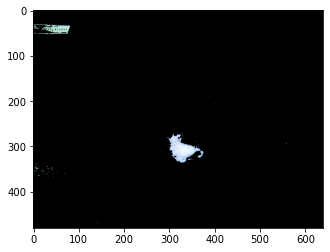

9114 Pixel in Video: 0309.mp4


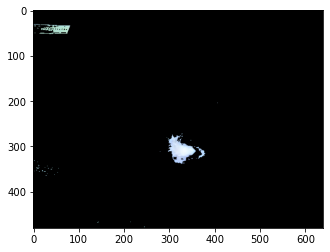

9351 Pixel in Video: 0309.mp4


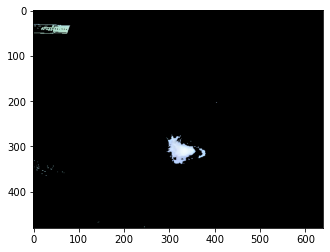

9399 Pixel in Video: 0309.mp4


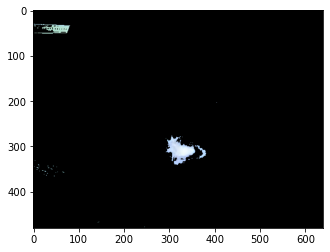

5913 Pixel in Video: 0309.mp4


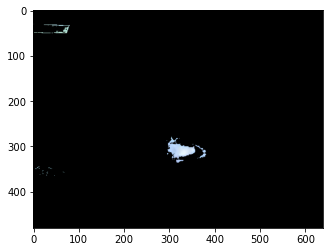

2844 Pixel in Video: 0309.mp4


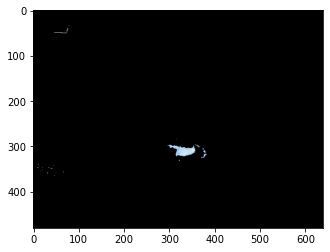

912 Pixel in Video: 0309.mp4


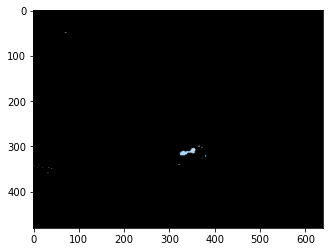

708 Pixel in Video: 0309.mp4


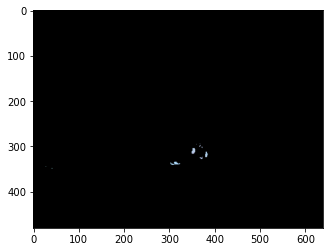

2649 Pixel in Video: 0309.mp4


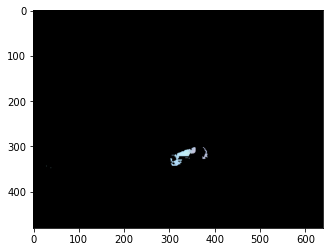

3951 Pixel in Video: 0309.mp4


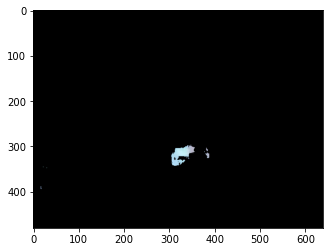

5037 Pixel in Video: 0309.mp4


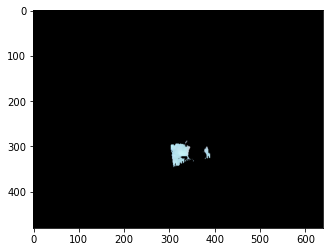

5451 Pixel in Video: 0309.mp4


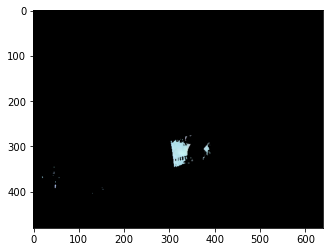

6390 Pixel in Video: 0309.mp4


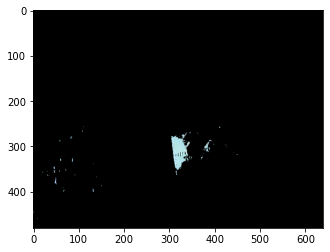

7749 Pixel in Video: 0309.mp4


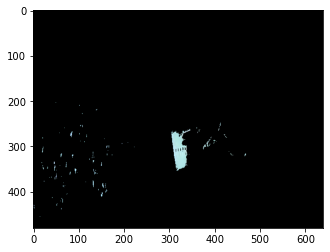

10461 Pixel in Video: 0309.mp4


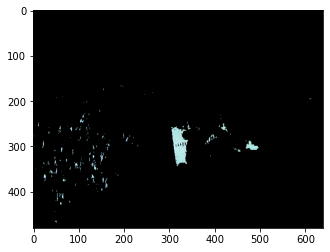

13062 Pixel in Video: 0311.mp4


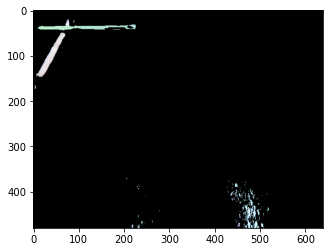

14502 Pixel in Video: 0311.mp4


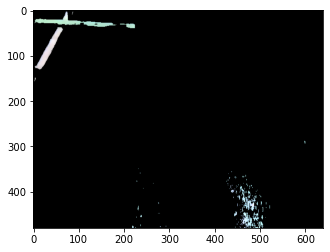

14445 Pixel in Video: 0311.mp4


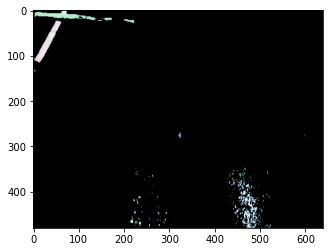

10935 Pixel in Video: 0311.mp4


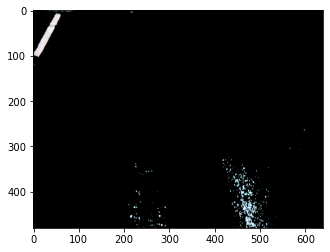

10638 Pixel in Video: 0311.mp4


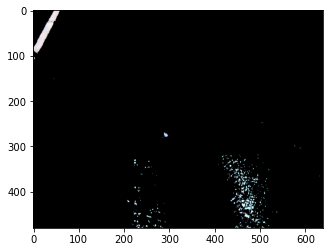

9795 Pixel in Video: 0311.mp4


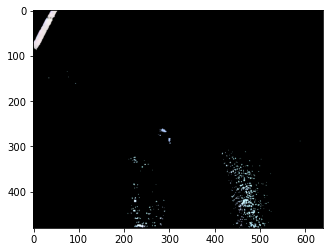

10131 Pixel in Video: 0311.mp4


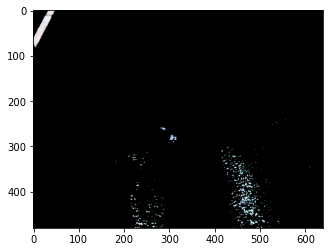

10416 Pixel in Video: 0311.mp4


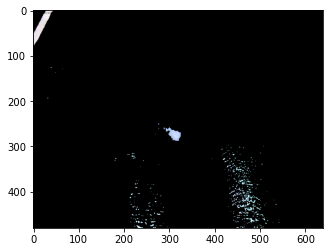

13749 Pixel in Video: 0311.mp4


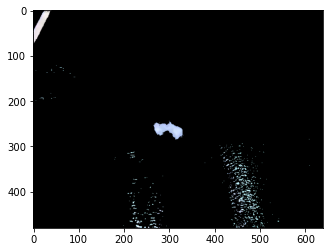

13827 Pixel in Video: 0311.mp4


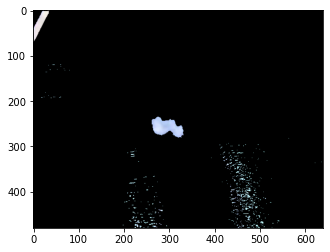

14622 Pixel in Video: 0311.mp4


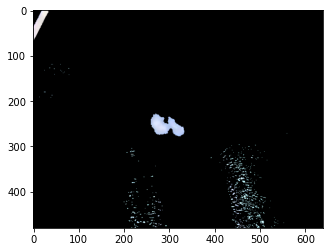

14175 Pixel in Video: 0311.mp4


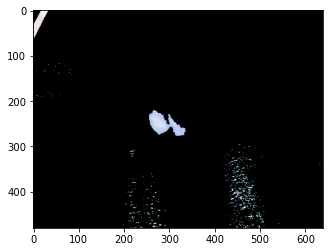

15264 Pixel in Video: 0311.mp4


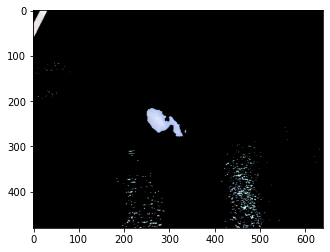

14778 Pixel in Video: 0311.mp4


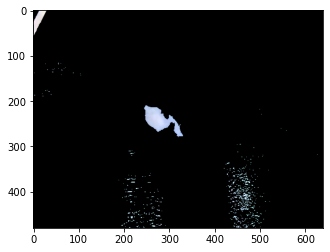

14898 Pixel in Video: 0311.mp4


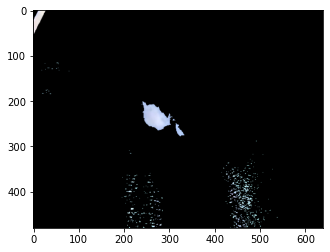

14304 Pixel in Video: 0311.mp4


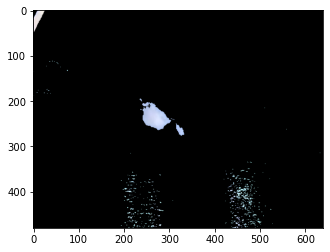

15243 Pixel in Video: 0311.mp4


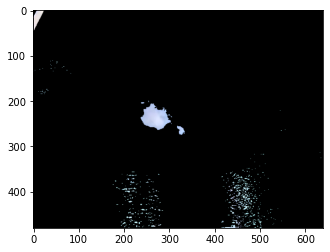

14043 Pixel in Video: 0311.mp4


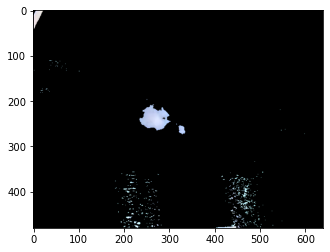

13281 Pixel in Video: 0311.mp4


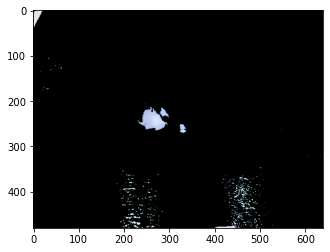

12684 Pixel in Video: 0311.mp4


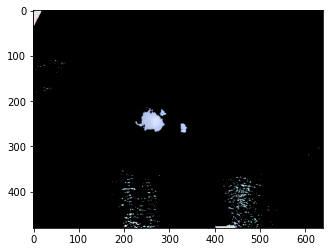

11679 Pixel in Video: 0311.mp4


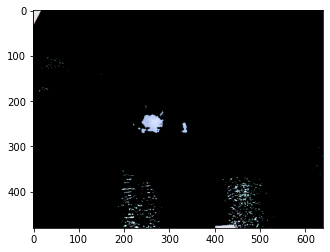

10071 Pixel in Video: 0311.mp4


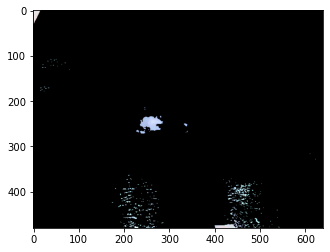

9981 Pixel in Video: 0311.mp4


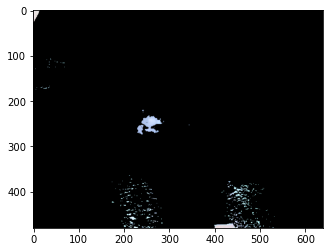

9639 Pixel in Video: 0311.mp4


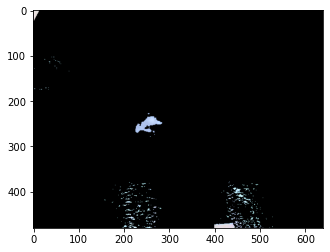

8691 Pixel in Video: 0311.mp4


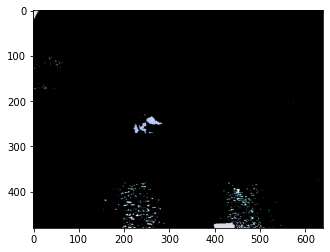

7269 Pixel in Video: 0311.mp4


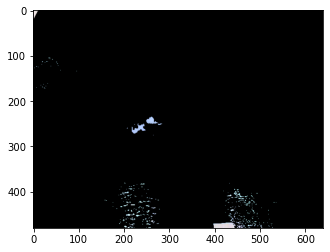

7842 Pixel in Video: 0311.mp4


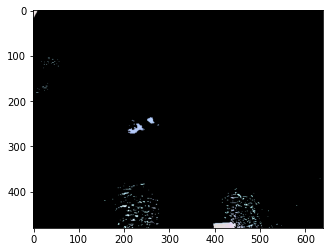

7320 Pixel in Video: 0311.mp4


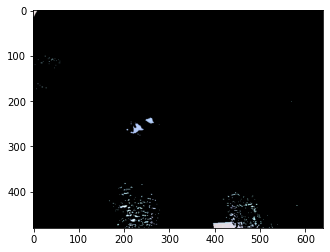

8157 Pixel in Video: 0311.mp4


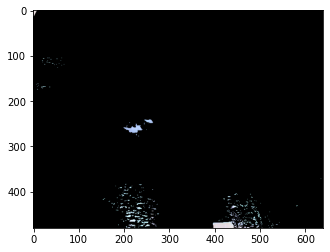

6213 Pixel in Video: 0312.mp4


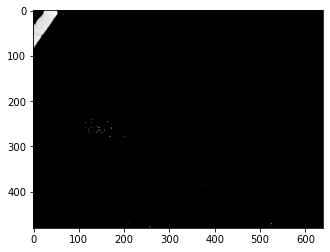

5277 Pixel in Video: 0312.mp4


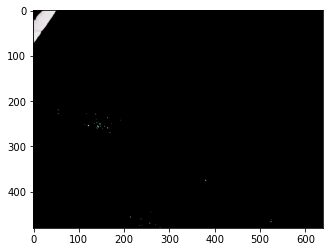

4434 Pixel in Video: 0312.mp4


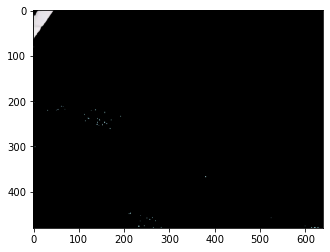

3552 Pixel in Video: 0312.mp4


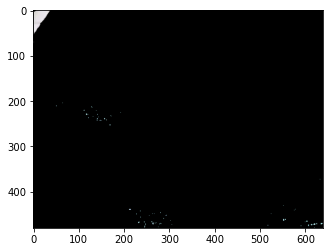

2772 Pixel in Video: 0312.mp4


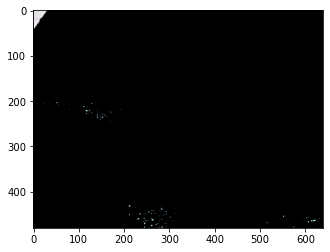

1893 Pixel in Video: 0312.mp4


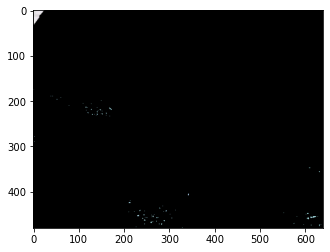

1599 Pixel in Video: 0312.mp4


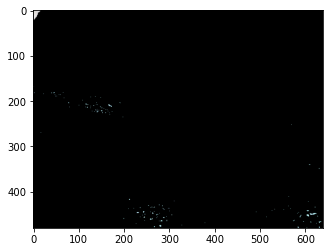

1302 Pixel in Video: 0312.mp4


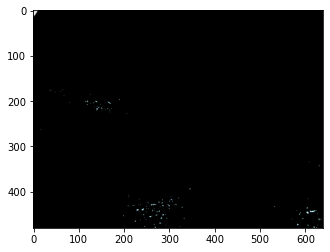

1146 Pixel in Video: 0312.mp4


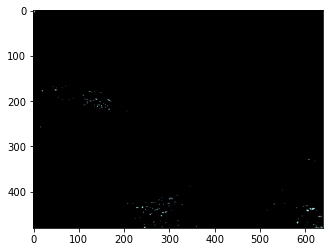

1005 Pixel in Video: 0312.mp4


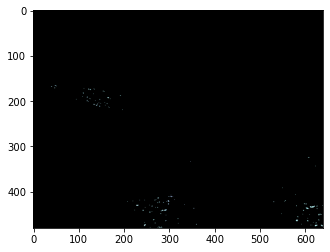

1161 Pixel in Video: 0312.mp4


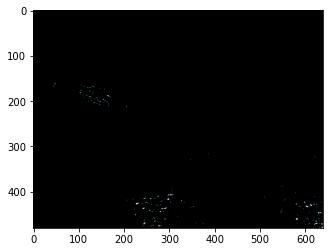

1239 Pixel in Video: 0312.mp4


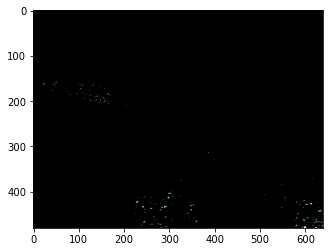

1467 Pixel in Video: 0312.mp4


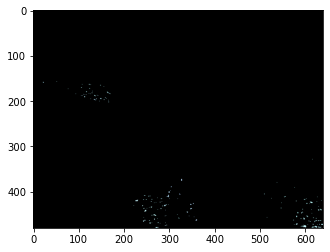

1368 Pixel in Video: 0312.mp4


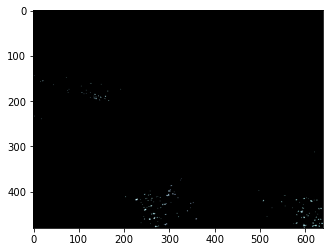

1551 Pixel in Video: 0312.mp4


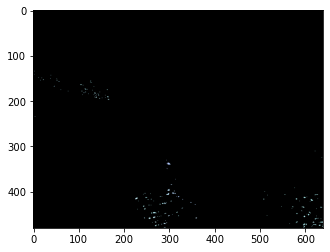

1719 Pixel in Video: 0312.mp4


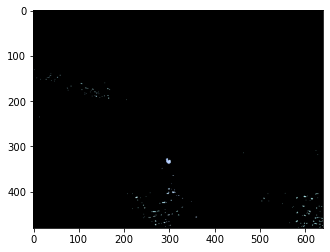

2244 Pixel in Video: 0312.mp4


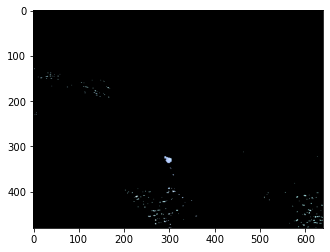

2406 Pixel in Video: 0312.mp4


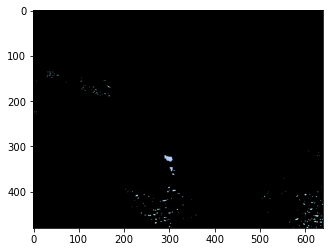

2688 Pixel in Video: 0312.mp4


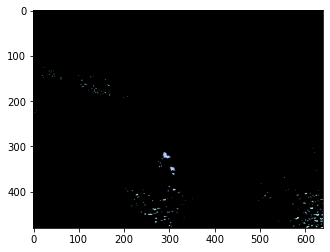

2709 Pixel in Video: 0312.mp4


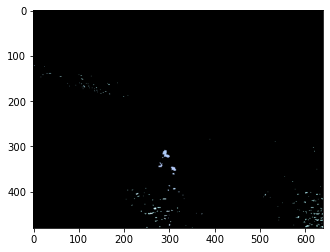

2337 Pixel in Video: 0312.mp4


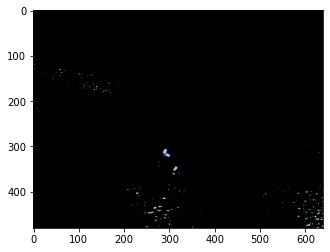

2265 Pixel in Video: 0312.mp4


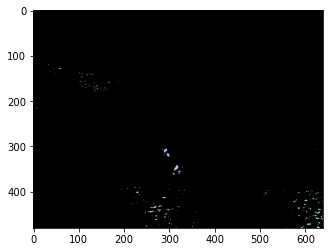

2592 Pixel in Video: 0312.mp4


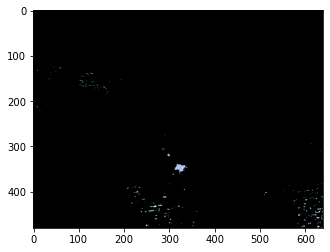

3504 Pixel in Video: 0312.mp4


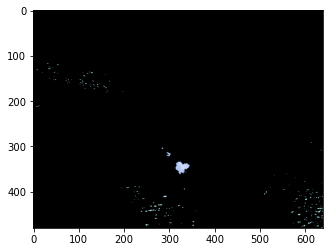

4182 Pixel in Video: 0312.mp4


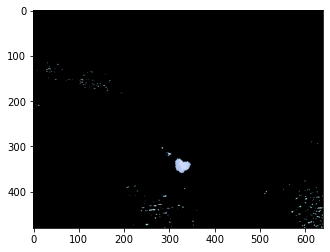

5109 Pixel in Video: 0312.mp4


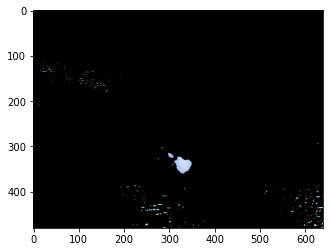

6999 Pixel in Video: 0312.mp4


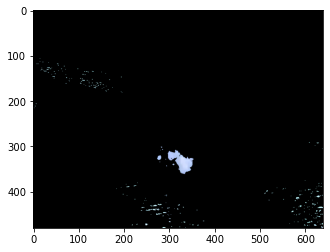

8871 Pixel in Video: 0312.mp4


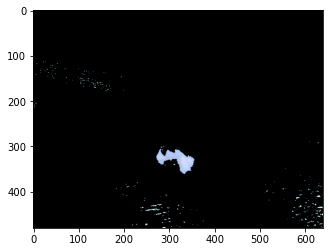

10842 Pixel in Video: 0312.mp4


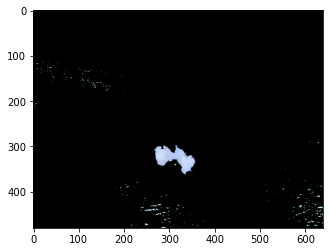

11559 Pixel in Video: 0312.mp4


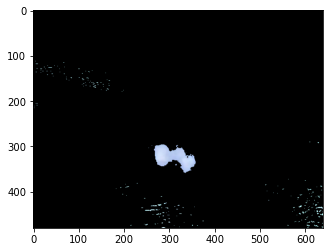

12672 Pixel in Video: 0312.mp4


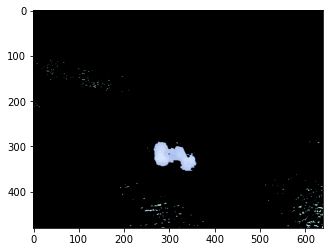

13386 Pixel in Video: 0312.mp4


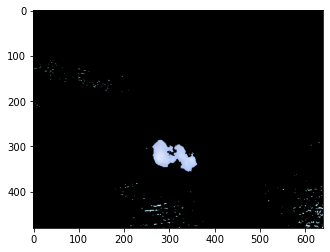

14151 Pixel in Video: 0312.mp4


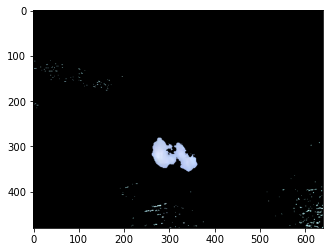

14649 Pixel in Video: 0312.mp4


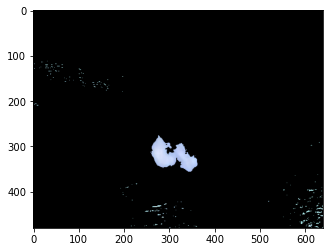

15438 Pixel in Video: 0312.mp4


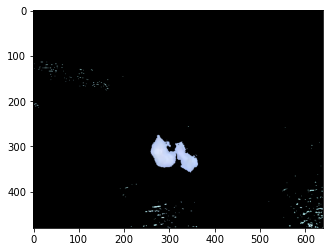

15534 Pixel in Video: 0312.mp4


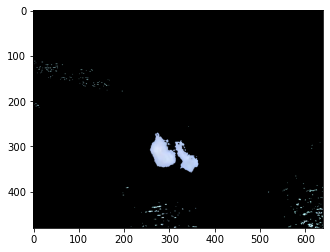

15531 Pixel in Video: 0312.mp4


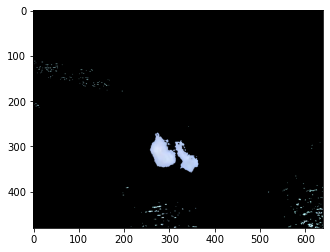

14793 Pixel in Video: 0312.mp4


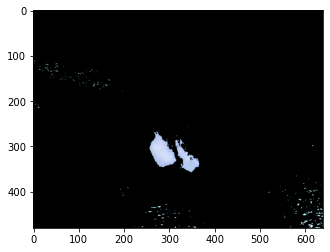

15549 Pixel in Video: 0312.mp4


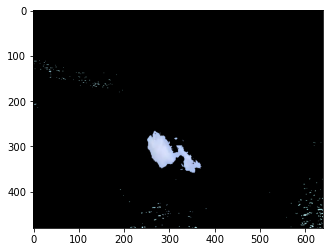

16428 Pixel in Video: 0312.mp4


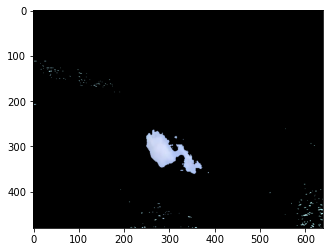

16809 Pixel in Video: 0312.mp4


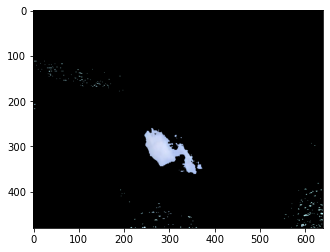

16830 Pixel in Video: 0312.mp4


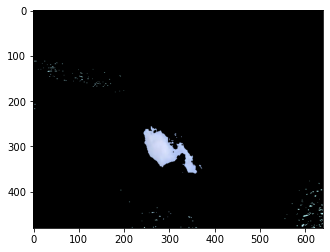

17064 Pixel in Video: 0312.mp4


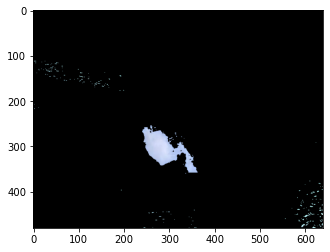

17169 Pixel in Video: 0312.mp4


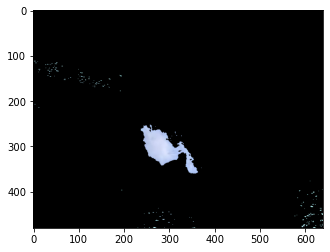

17580 Pixel in Video: 0312.mp4


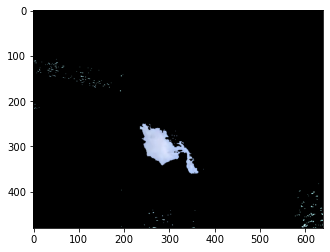

17868 Pixel in Video: 0312.mp4


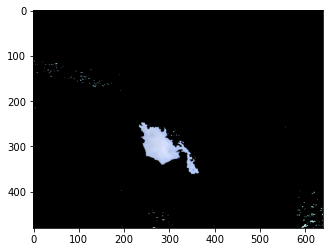

17904 Pixel in Video: 0312.mp4


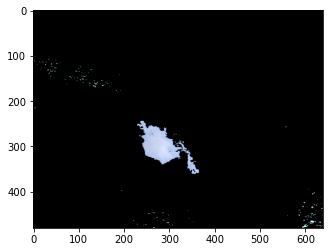

17991 Pixel in Video: 0312.mp4


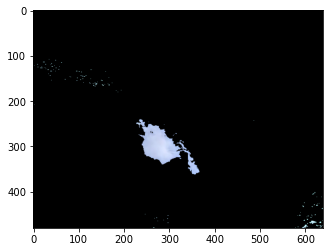

17955 Pixel in Video: 0312.mp4


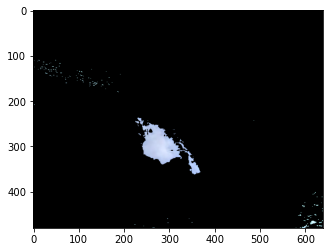

17850 Pixel in Video: 0312.mp4


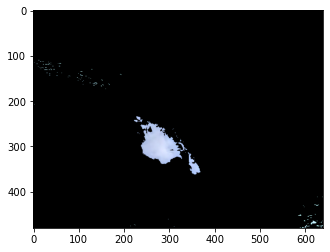

17280 Pixel in Video: 0312.mp4


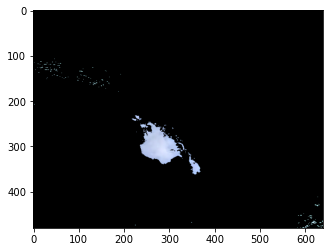

16926 Pixel in Video: 0312.mp4


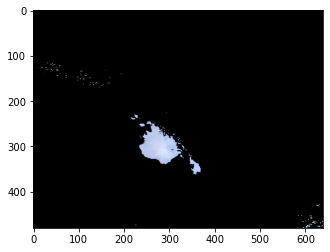

16377 Pixel in Video: 0312.mp4


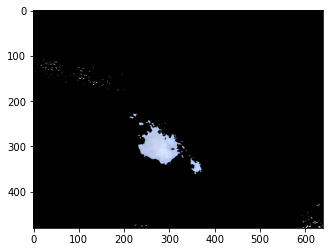

16734 Pixel in Video: 0312.mp4


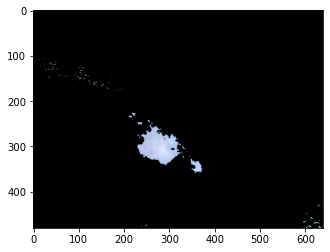

16692 Pixel in Video: 0312.mp4


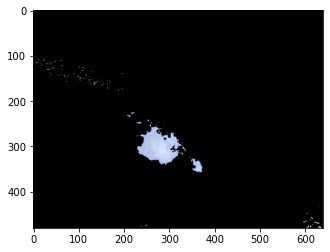

17253 Pixel in Video: 0312.mp4


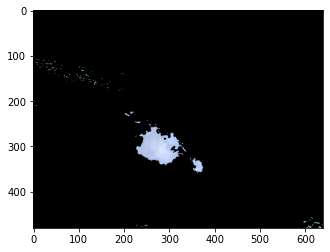

2034 Pixel in Video: 0313.mp4


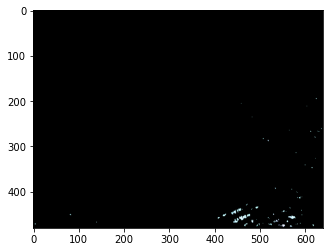

1812 Pixel in Video: 0313.mp4


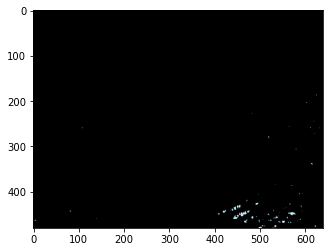

2115 Pixel in Video: 0313.mp4


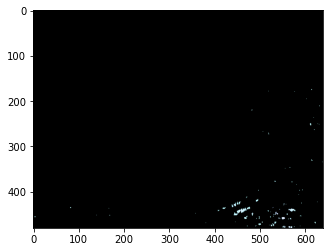

2241 Pixel in Video: 0313.mp4


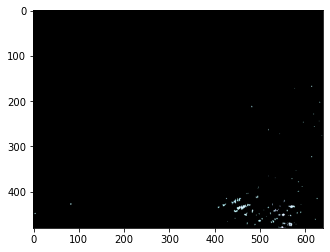

2223 Pixel in Video: 0313.mp4


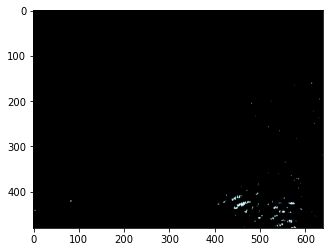

2427 Pixel in Video: 0313.mp4


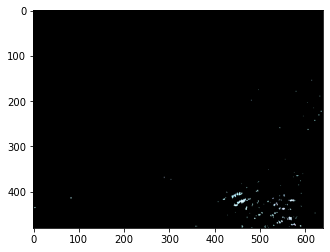

2787 Pixel in Video: 0313.mp4


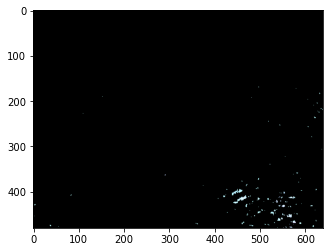

2949 Pixel in Video: 0313.mp4


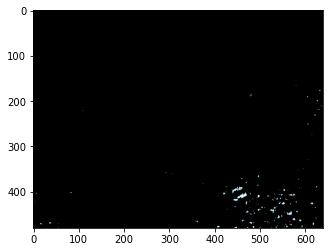

3111 Pixel in Video: 0313.mp4


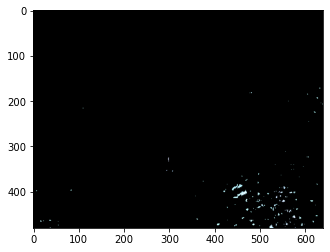

3663 Pixel in Video: 0313.mp4


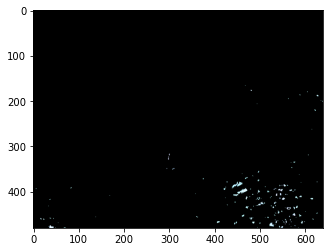

3783 Pixel in Video: 0313.mp4


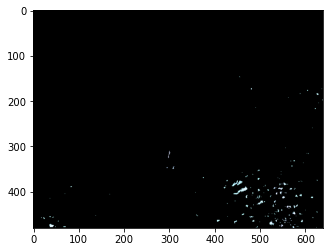

3879 Pixel in Video: 0313.mp4


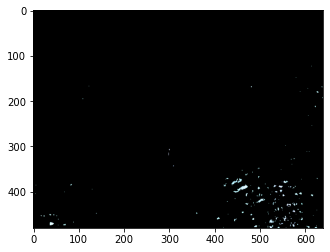

4632 Pixel in Video: 0313.mp4


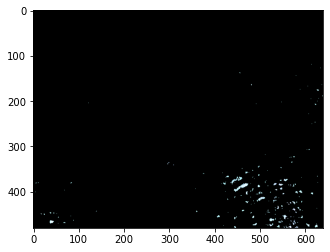

4185 Pixel in Video: 0313.mp4


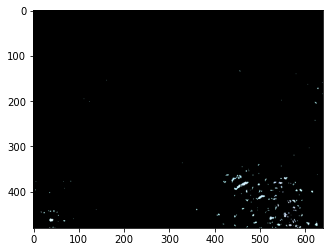

4731 Pixel in Video: 0313.mp4


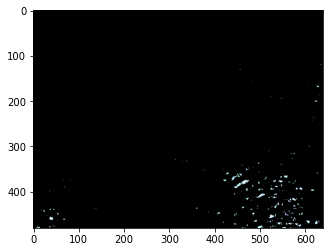

4680 Pixel in Video: 0313.mp4


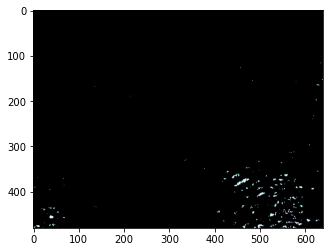

5322 Pixel in Video: 0313.mp4


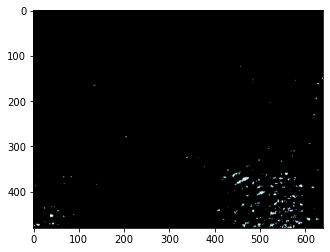

5064 Pixel in Video: 0313.mp4


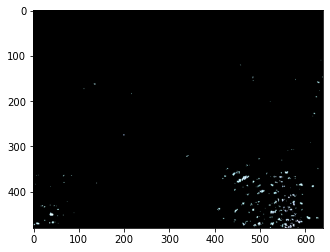

5490 Pixel in Video: 0313.mp4


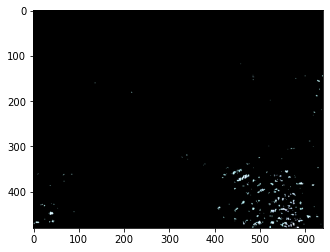

5175 Pixel in Video: 0313.mp4


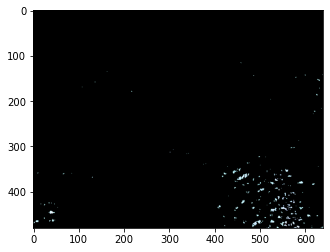

5796 Pixel in Video: 0313.mp4


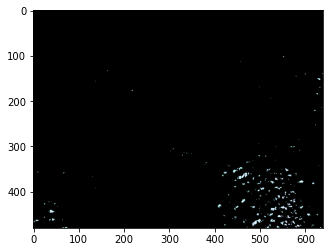

5613 Pixel in Video: 0313.mp4


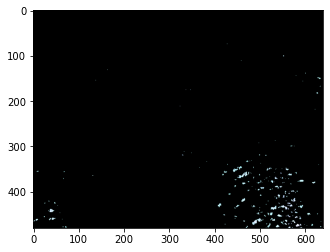

5883 Pixel in Video: 0313.mp4


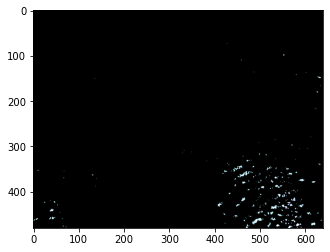

5568 Pixel in Video: 0313.mp4


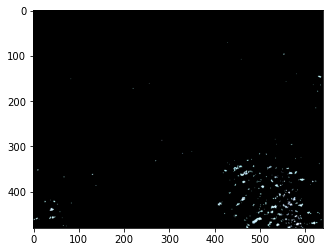

6216 Pixel in Video: 0313.mp4


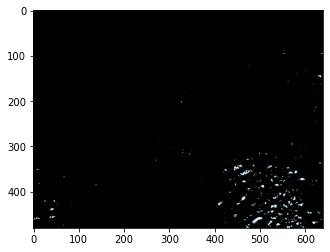

5637 Pixel in Video: 0313.mp4


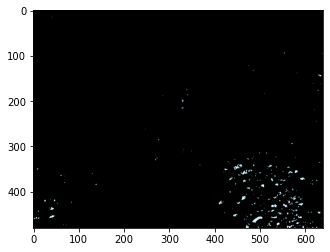

6969 Pixel in Video: 0313.mp4


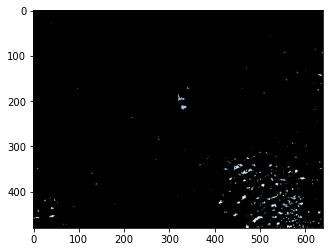

7164 Pixel in Video: 0313.mp4


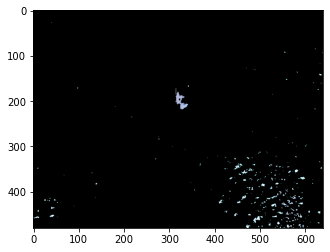

8142 Pixel in Video: 0313.mp4


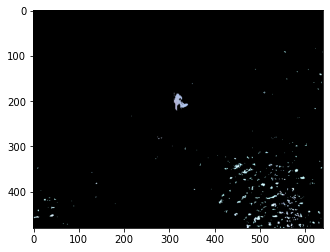

6933 Pixel in Video: 0313.mp4


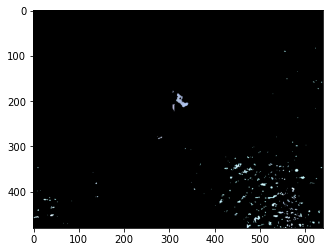

7215 Pixel in Video: 0313.mp4


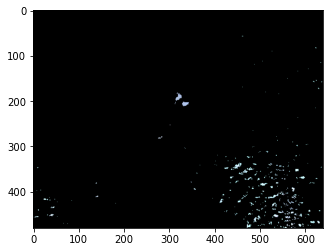

6357 Pixel in Video: 0313.mp4


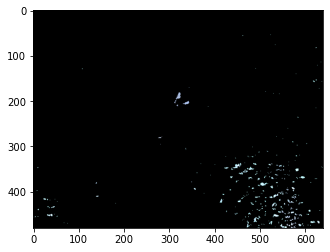

7299 Pixel in Video: 0313.mp4


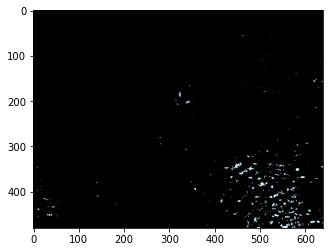

6666 Pixel in Video: 0313.mp4


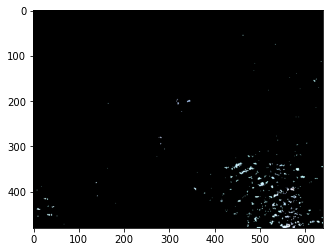

7269 Pixel in Video: 0313.mp4


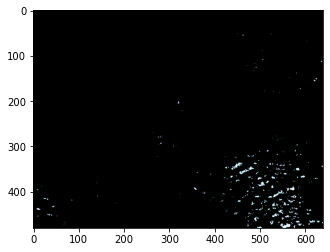

6750 Pixel in Video: 0313.mp4


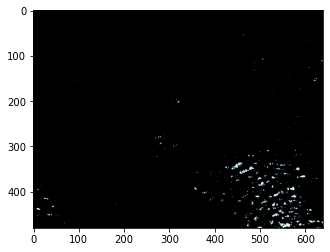

7335 Pixel in Video: 0313.mp4


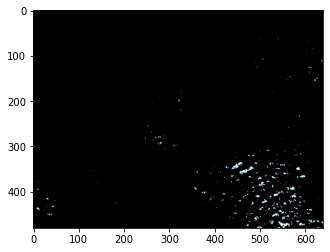

6570 Pixel in Video: 0313.mp4


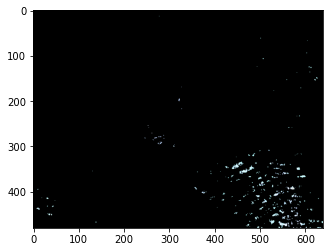

7266 Pixel in Video: 0313.mp4


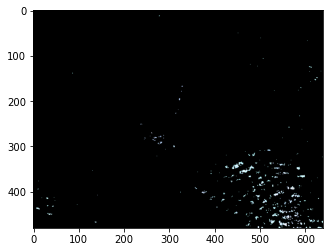

6669 Pixel in Video: 0313.mp4


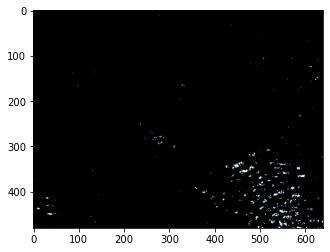

7404 Pixel in Video: 0313.mp4


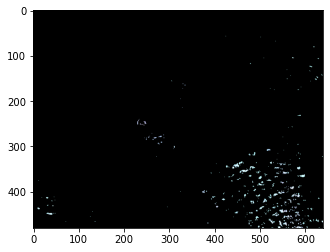

7524 Pixel in Video: 0313.mp4


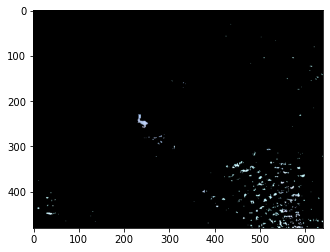

8643 Pixel in Video: 0313.mp4


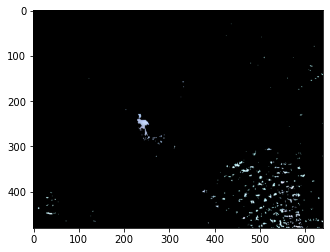

8205 Pixel in Video: 0313.mp4


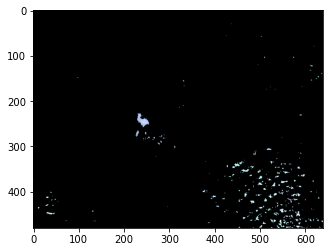

9171 Pixel in Video: 0313.mp4


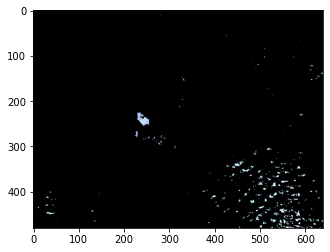

9012 Pixel in Video: 0313.mp4


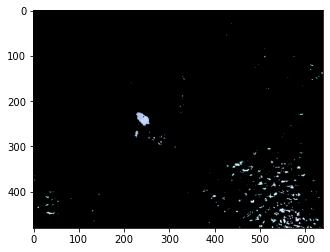

9579 Pixel in Video: 0313.mp4


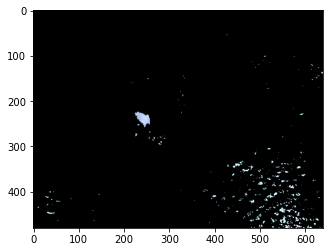

8865 Pixel in Video: 0313.mp4


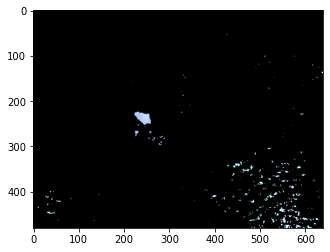

9084 Pixel in Video: 0313.mp4


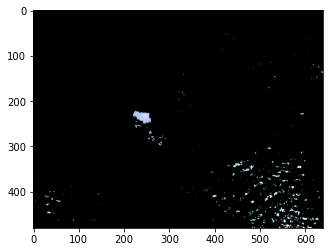

8856 Pixel in Video: 0313.mp4


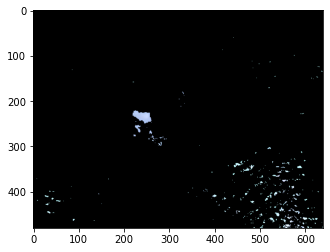

9639 Pixel in Video: 0313.mp4


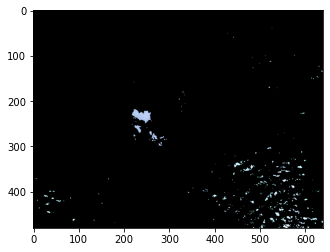

9726 Pixel in Video: 0313.mp4


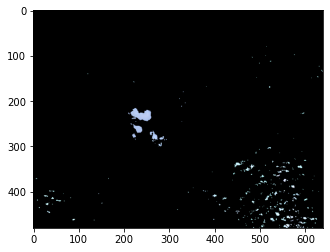

10671 Pixel in Video: 0313.mp4


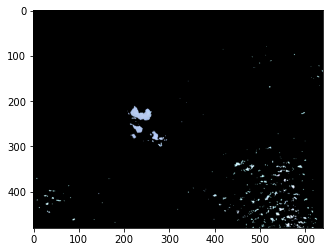

10359 Pixel in Video: 0313.mp4


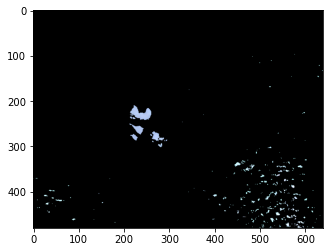

11628 Pixel in Video: 0313.mp4


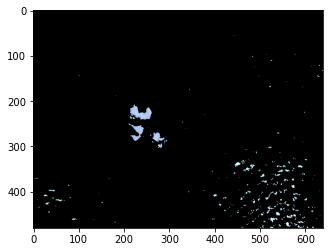

11682 Pixel in Video: 0313.mp4


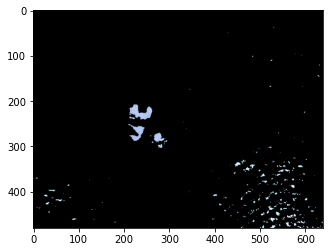

11967 Pixel in Video: 0313.mp4


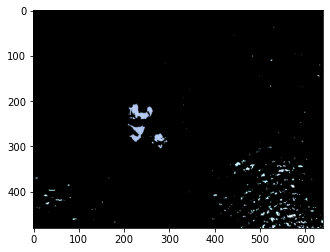

11970 Pixel in Video: 0313.mp4


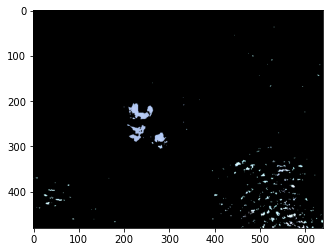

11847 Pixel in Video: 0313.mp4


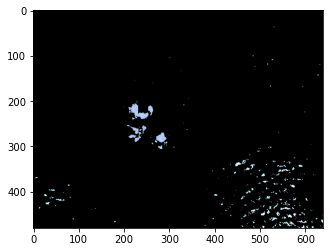

11550 Pixel in Video: 0313.mp4


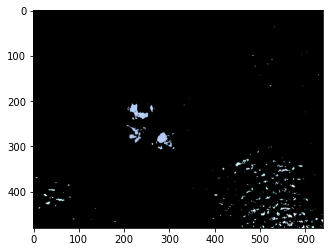

11730 Pixel in Video: 0313.mp4


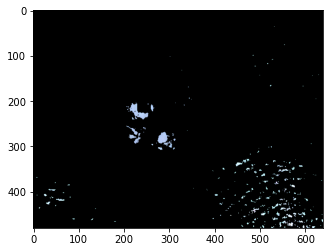

11868 Pixel in Video: 0313.mp4


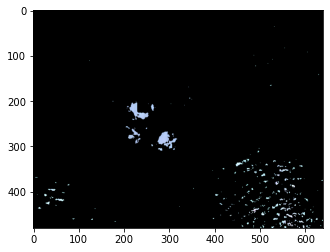

11769 Pixel in Video: 0313.mp4


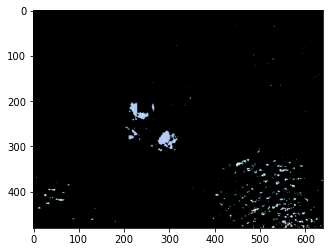

12624 Pixel in Video: 0313.mp4


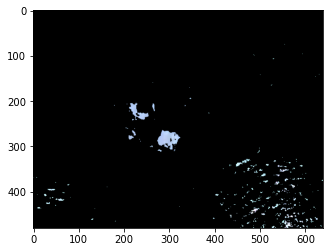

13515 Pixel in Video: 0313.mp4


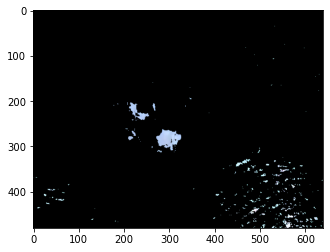

13974 Pixel in Video: 0313.mp4


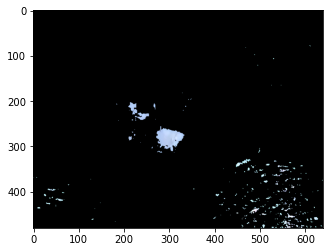

14460 Pixel in Video: 0313.mp4


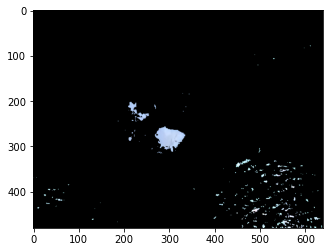

14787 Pixel in Video: 0313.mp4


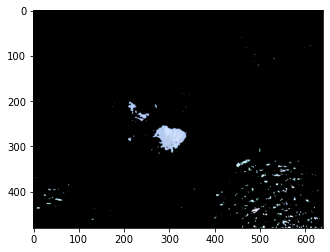

15675 Pixel in Video: 0313.mp4


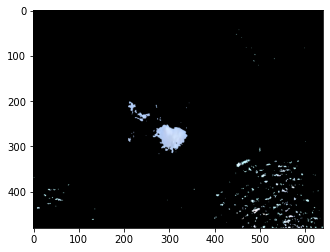

7278 Pixel in Video: 0314.mp4


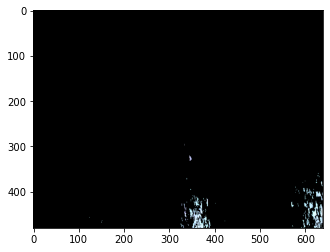

10296 Pixel in Video: 0314.mp4


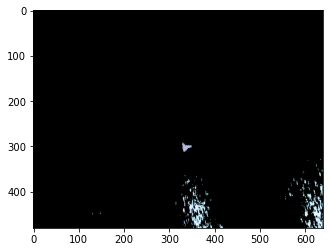

12072 Pixel in Video: 0314.mp4


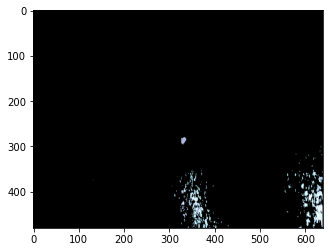

12528 Pixel in Video: 0314.mp4


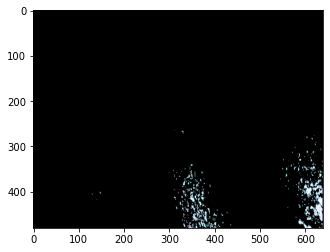

12726 Pixel in Video: 0314.mp4


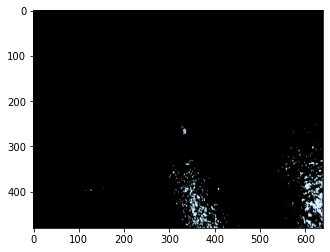

14982 Pixel in Video: 0314.mp4


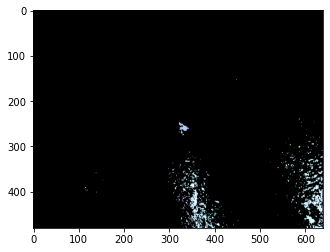

13122 Pixel in Video: 0314.mp4


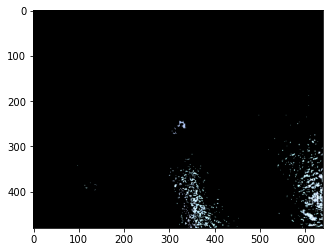

13782 Pixel in Video: 0314.mp4


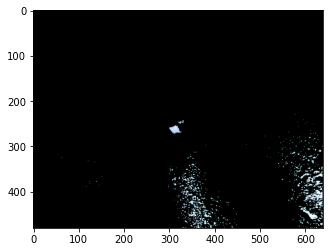

13305 Pixel in Video: 0314.mp4


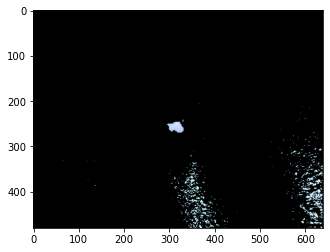

14475 Pixel in Video: 0314.mp4


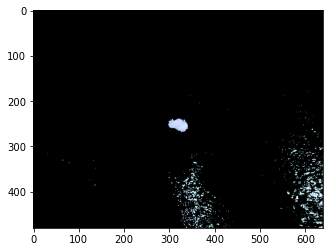

13644 Pixel in Video: 0314.mp4


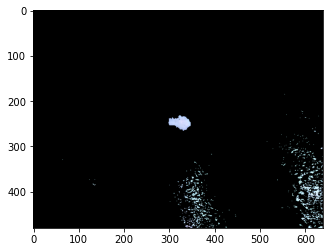

14598 Pixel in Video: 0314.mp4


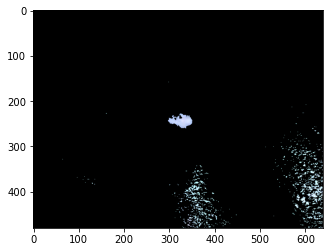

12423 Pixel in Video: 0314.mp4


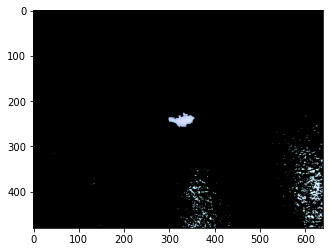

13167 Pixel in Video: 0314.mp4


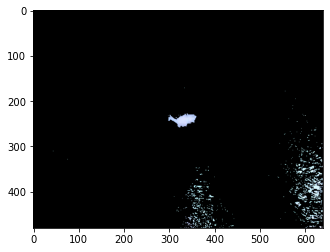

12603 Pixel in Video: 0314.mp4


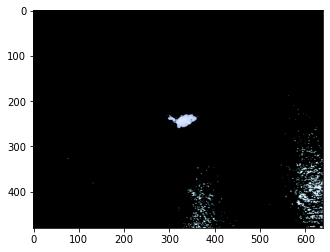

13878 Pixel in Video: 0314.mp4


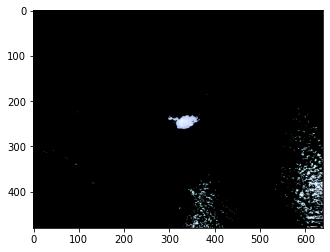

306 Pixel in Video: 0317.mp4


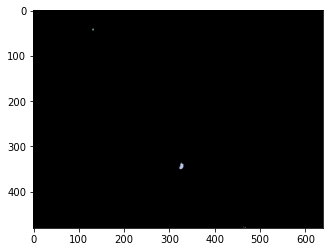

1632 Pixel in Video: 0317.mp4


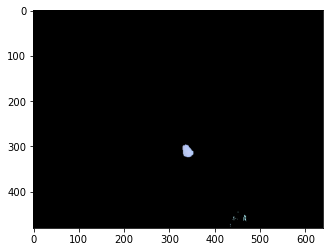

1497 Pixel in Video: 0317.mp4


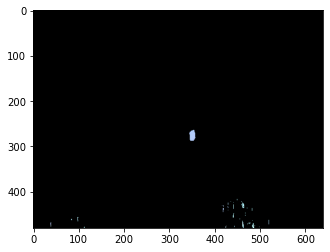

1395 Pixel in Video: 0317.mp4


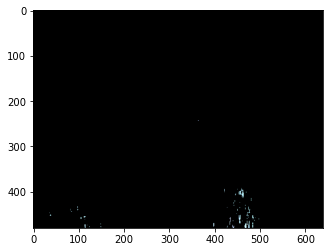

2280 Pixel in Video: 0317.mp4


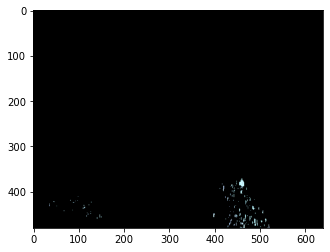

3129 Pixel in Video: 0317.mp4


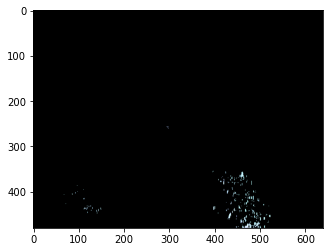

4308 Pixel in Video: 0317.mp4


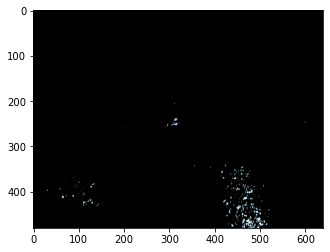

4617 Pixel in Video: 0317.mp4


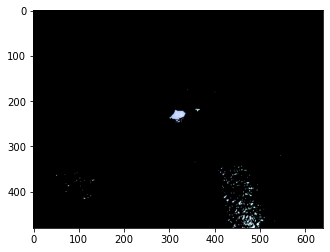

6669 Pixel in Video: 0317.mp4


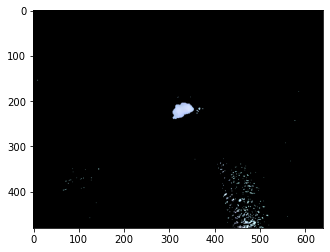

7452 Pixel in Video: 0317.mp4


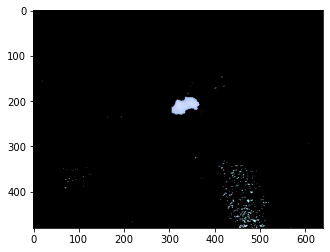

8670 Pixel in Video: 0317.mp4


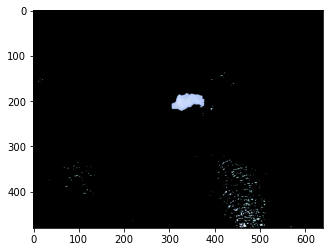

8373 Pixel in Video: 0317.mp4


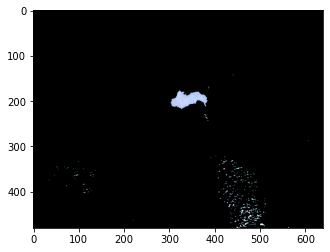

9087 Pixel in Video: 0317.mp4


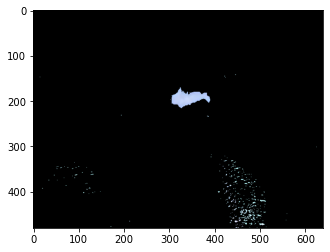

8613 Pixel in Video: 0317.mp4


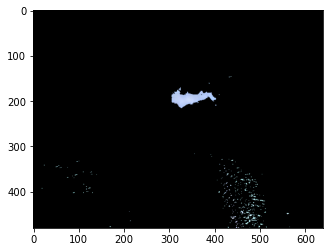

7959 Pixel in Video: 0317.mp4


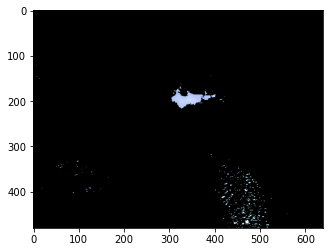

6915 Pixel in Video: 0317.mp4


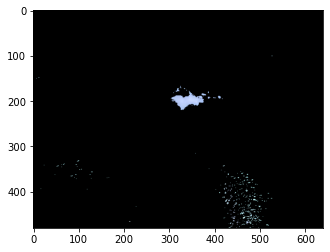

8091 Pixel in Video: 0317.mp4


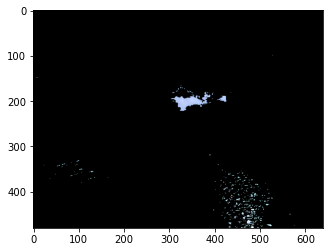

6237 Pixel in Video: 0317.mp4


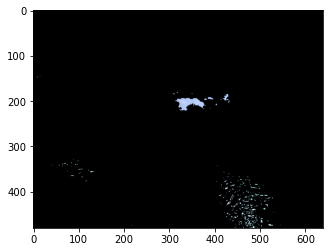

5517 Pixel in Video: 0317.mp4


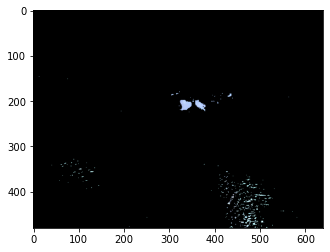

4575 Pixel in Video: 0317.mp4


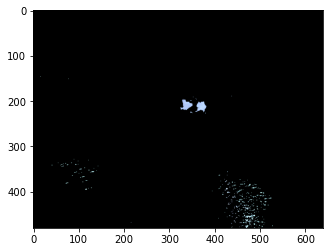

5517 Pixel in Video: 0317.mp4


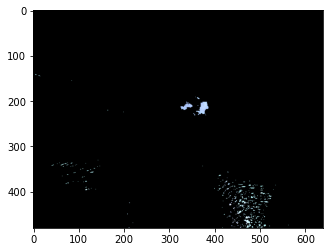

5637 Pixel in Video: 0317.mp4


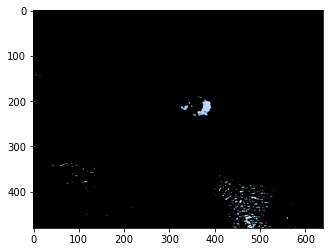

5949 Pixel in Video: 0317.mp4


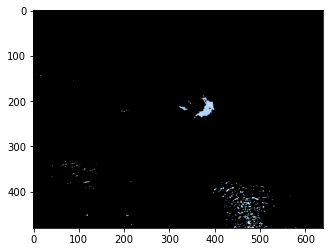

4725 Pixel in Video: 0317.mp4


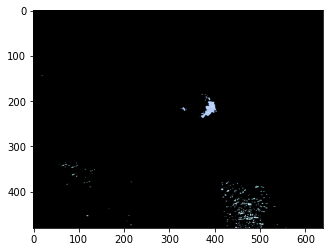

4197 Pixel in Video: 0317.mp4


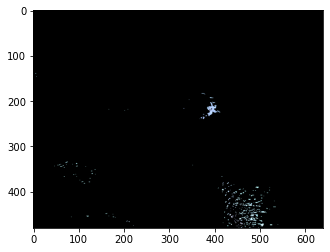

2973 Pixel in Video: 0317.mp4


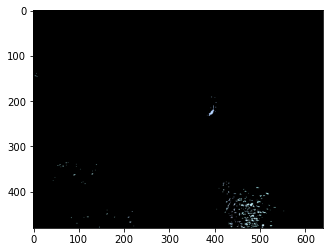

3120 Pixel in Video: 0317.mp4


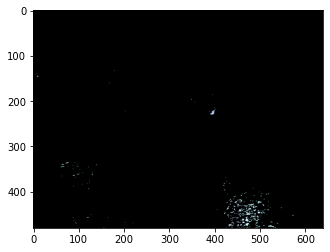

3312 Pixel in Video: 0317.mp4


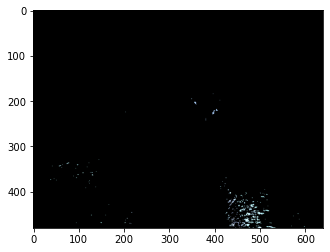

3306 Pixel in Video: 0317.mp4


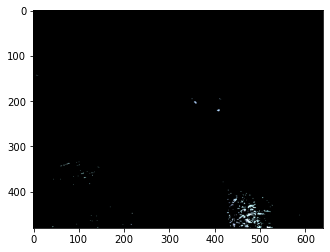

31464 Pixel in Video: 0319.mp4


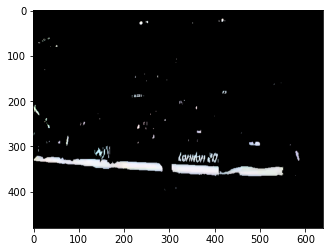

31212 Pixel in Video: 0319.mp4


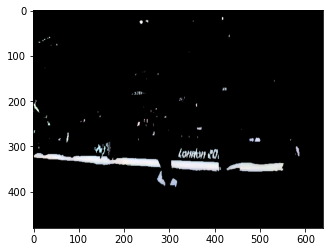

30927 Pixel in Video: 0319.mp4


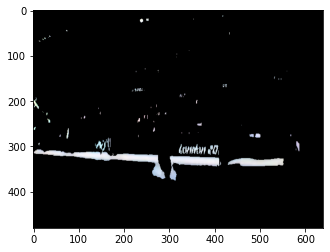

29565 Pixel in Video: 0319.mp4


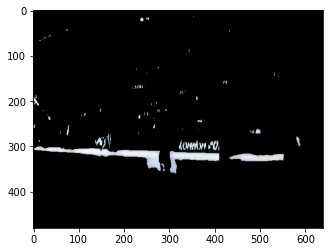

28329 Pixel in Video: 0319.mp4


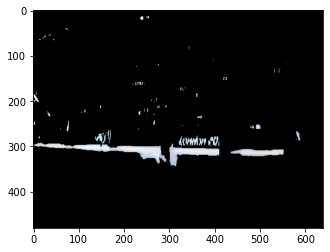

26706 Pixel in Video: 0319.mp4


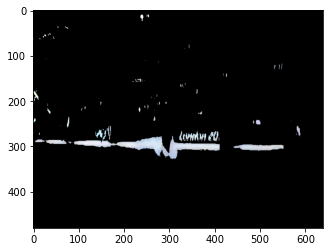

24684 Pixel in Video: 0319.mp4


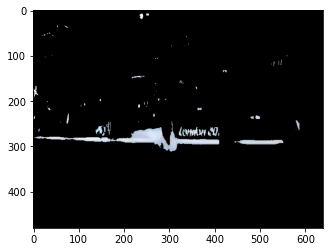

12753 Pixel in Video: 0319.mp4


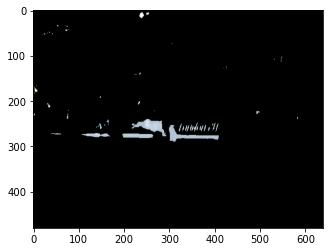

1872 Pixel in Video: 0319.mp4


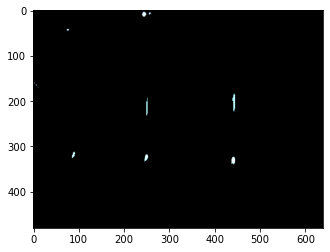

1368 Pixel in Video: 0319.mp4


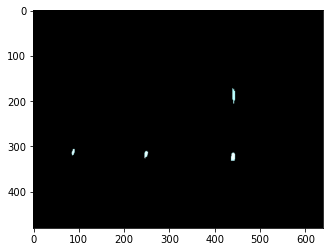

975 Pixel in Video: 0319.mp4


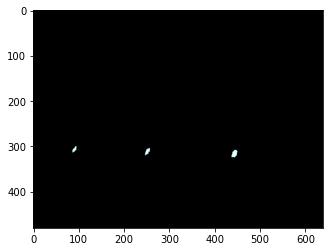

831 Pixel in Video: 0319.mp4


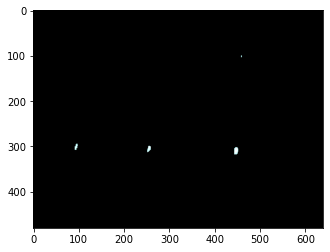

759 Pixel in Video: 0319.mp4


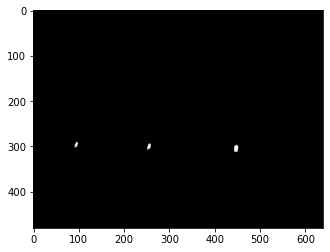

828 Pixel in Video: 0319.mp4


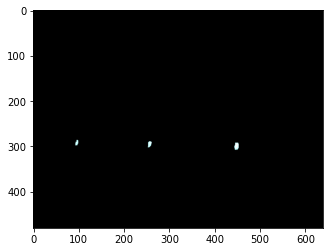

8535 Pixel in Video: 0320.mp4


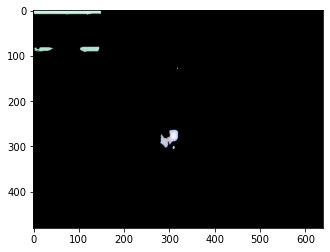

3765 Pixel in Video: 0320.mp4


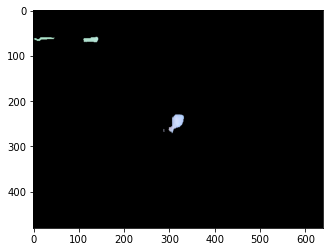

3126 Pixel in Video: 0320.mp4


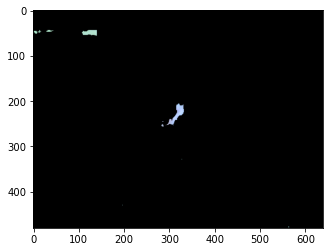

2469 Pixel in Video: 0320.mp4


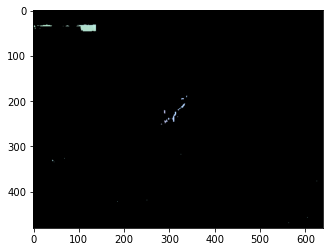

3183 Pixel in Video: 0320.mp4


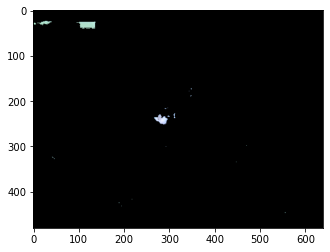

4794 Pixel in Video: 0320.mp4


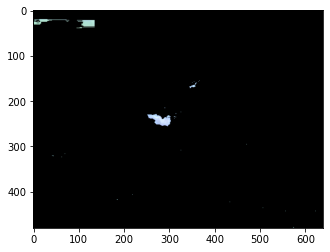

5229 Pixel in Video: 0321.mp4


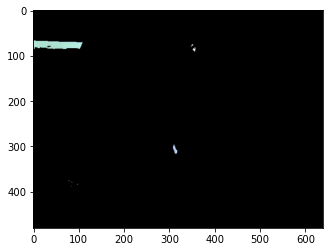

6471 Pixel in Video: 0321.mp4


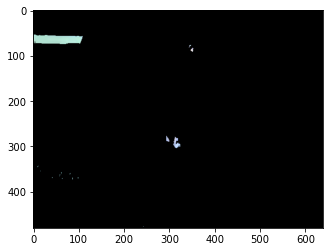

7353 Pixel in Video: 0321.mp4


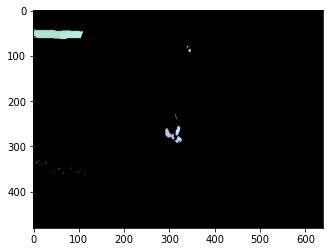

8316 Pixel in Video: 0321.mp4


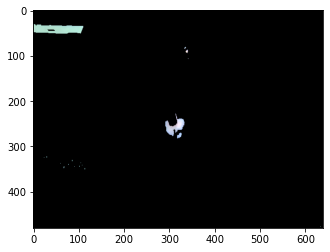

9615 Pixel in Video: 0321.mp4


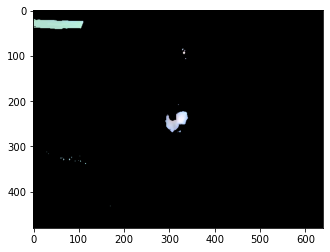

9366 Pixel in Video: 0321.mp4


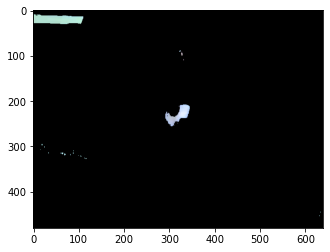

9150 Pixel in Video: 0321.mp4


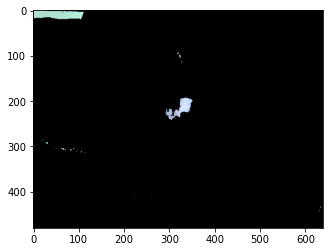

6675 Pixel in Video: 0321.mp4


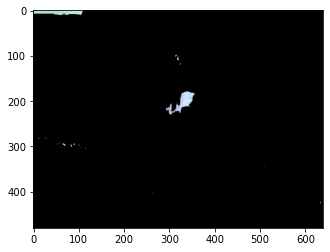

3630 Pixel in Video: 0321.mp4


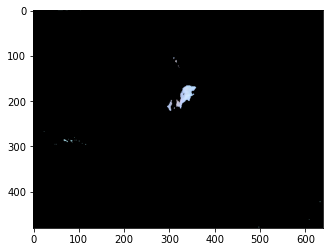

3525 Pixel in Video: 0321.mp4


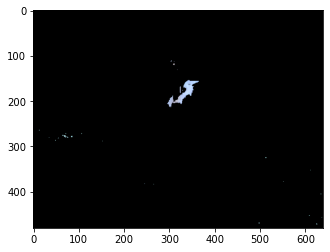

3402 Pixel in Video: 0321.mp4


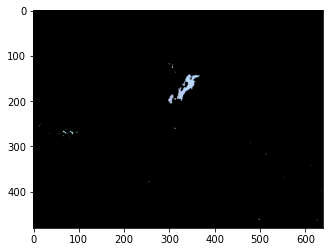

2499 Pixel in Video: 0321.mp4


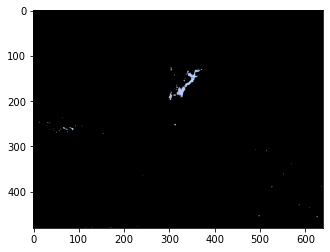

2076 Pixel in Video: 0321.mp4


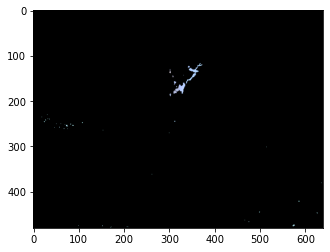

1977 Pixel in Video: 0321.mp4


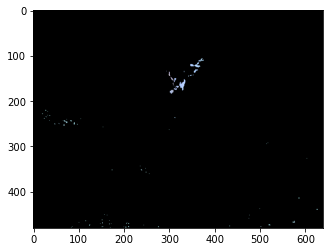

1689 Pixel in Video: 0321.mp4


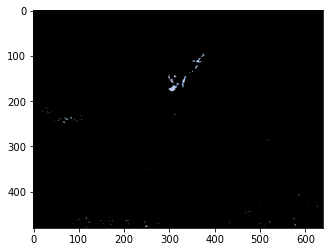

1794 Pixel in Video: 0321.mp4


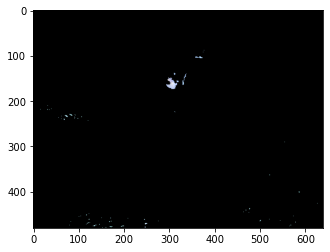

9762 Pixel in Video: 0323.mp4


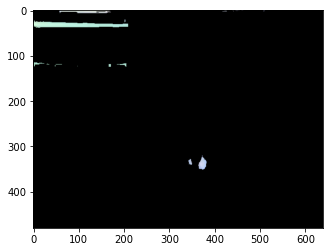

3444 Pixel in Video: 0323.mp4


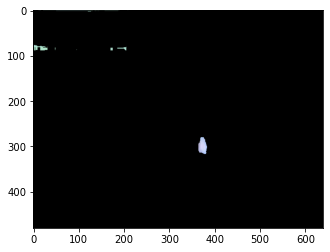

3168 Pixel in Video: 0323.mp4


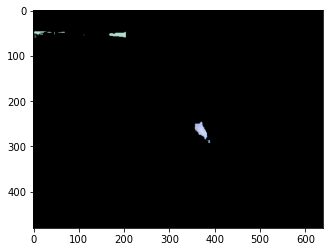

3105 Pixel in Video: 0323.mp4


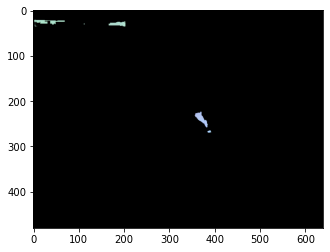

1650 Pixel in Video: 0323.mp4


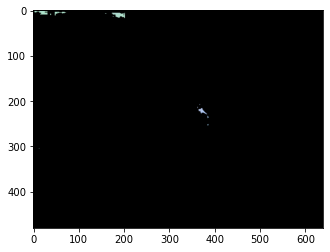

540 Pixel in Video: 0323.mp4


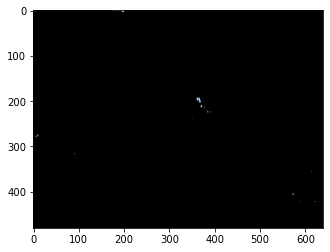

2049 Pixel in Video: 0323.mp4


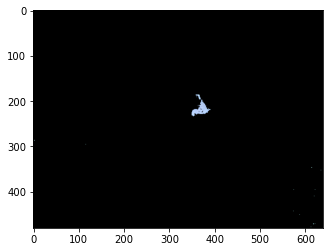

5418 Pixel in Video: 0323.mp4


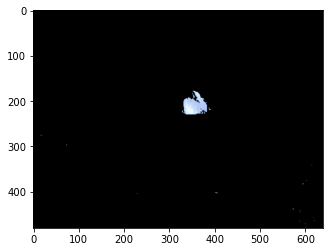

8394 Pixel in Video: 0323.mp4


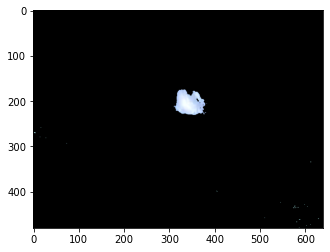

11439 Pixel in Video: 0323.mp4


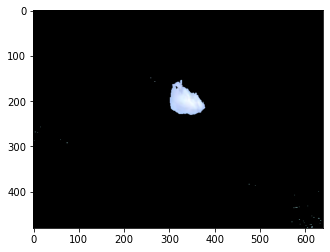

12621 Pixel in Video: 0323.mp4


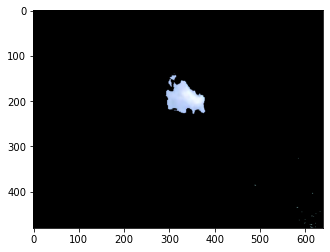

54786 Pixel in Video: 0324.mp4


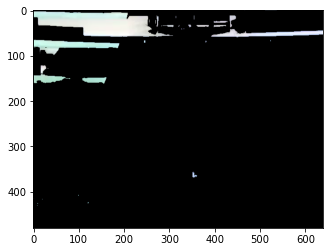

52893 Pixel in Video: 0324.mp4


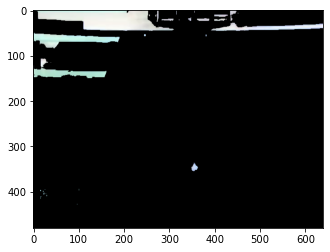

41109 Pixel in Video: 0324.mp4


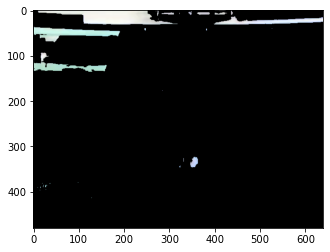

32115 Pixel in Video: 0324.mp4


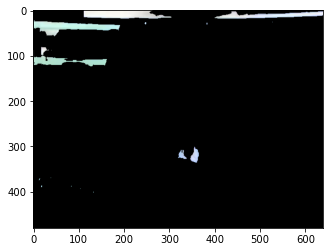

24450 Pixel in Video: 0324.mp4


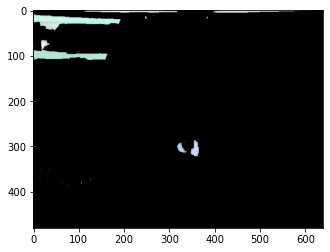

15906 Pixel in Video: 0324.mp4


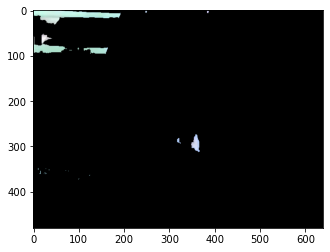

10377 Pixel in Video: 0324.mp4


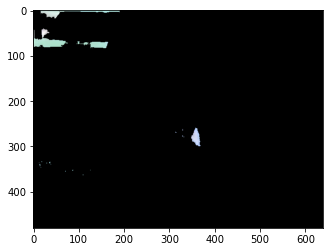

8907 Pixel in Video: 0324.mp4


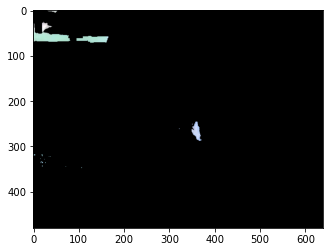

7794 Pixel in Video: 0324.mp4


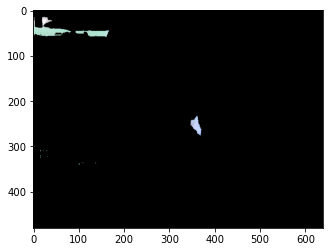

7389 Pixel in Video: 0324.mp4


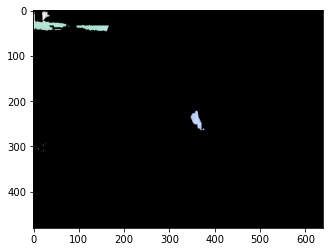

8460 Pixel in Video: 0324.mp4


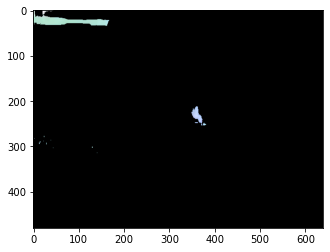

957 Pixel in Video: 0326.mp4


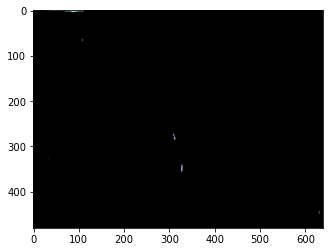

309 Pixel in Video: 0326.mp4


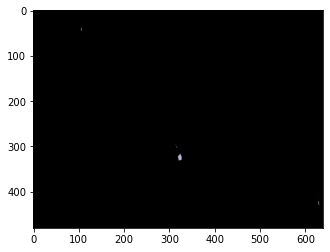

231 Pixel in Video: 0326.mp4


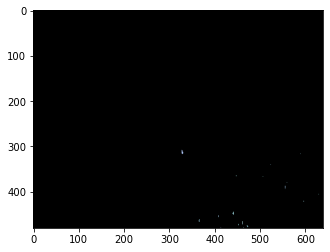

600 Pixel in Video: 0326.mp4


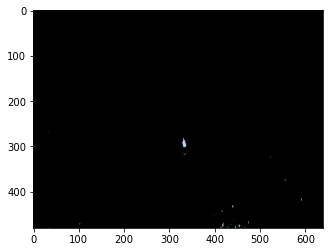

1845 Pixel in Video: 0326.mp4


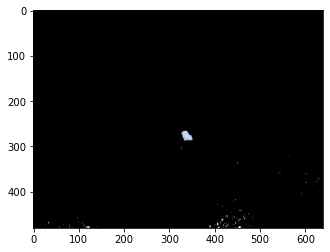

2763 Pixel in Video: 0326.mp4


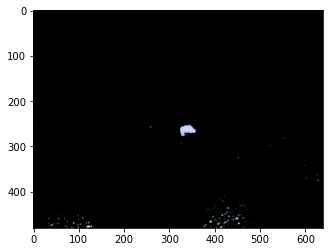

3375 Pixel in Video: 0326.mp4


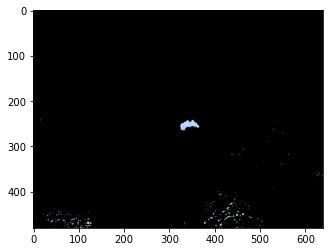

4587 Pixel in Video: 0326.mp4


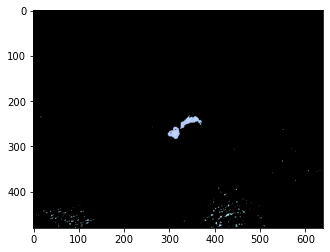

6675 Pixel in Video: 0326.mp4


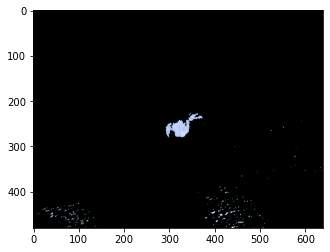

7320 Pixel in Video: 0326.mp4


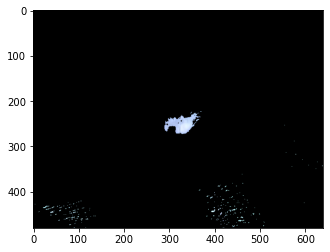

8316 Pixel in Video: 0326.mp4


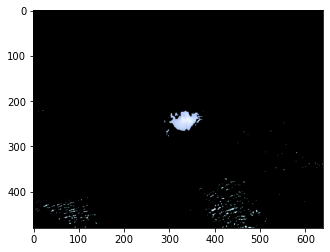

7944 Pixel in Video: 0326.mp4


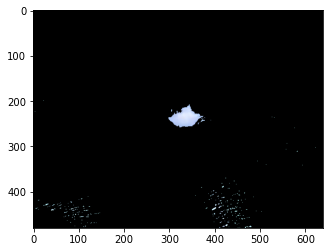

8631 Pixel in Video: 0326.mp4


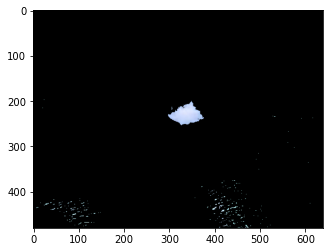

9177 Pixel in Video: 0326.mp4


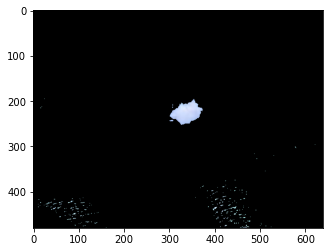

26400 Pixel in Video: 0327.mp4


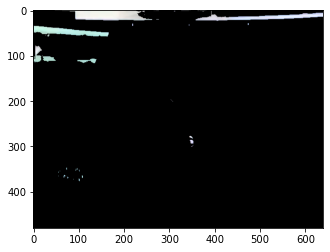

16749 Pixel in Video: 0327.mp4


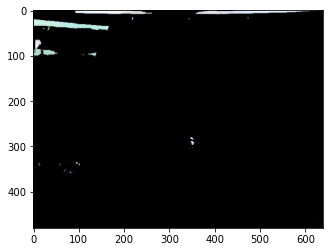

7848 Pixel in Video: 0327.mp4


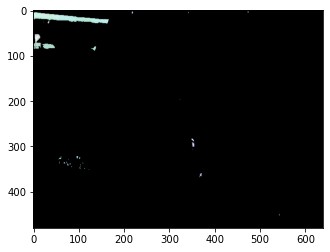

8526 Pixel in Video: 0327.mp4


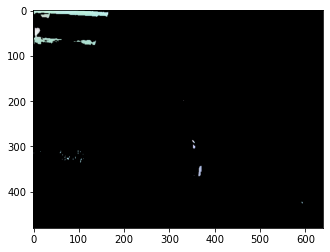

2817 Pixel in Video: 0327.mp4


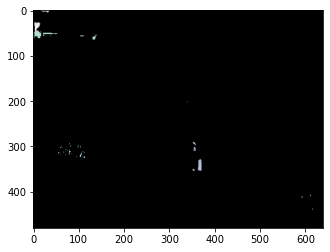

2604 Pixel in Video: 0327.mp4


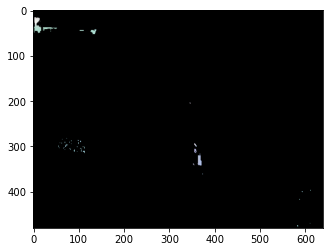

3528 Pixel in Video: 0327.mp4


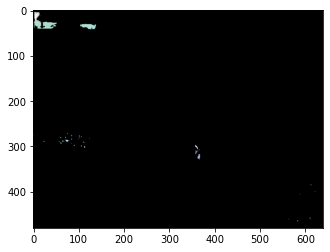

3138 Pixel in Video: 0327.mp4


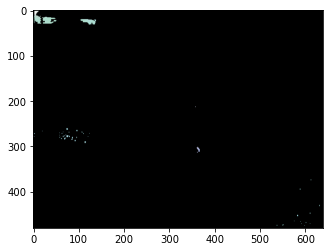

2799 Pixel in Video: 0327.mp4


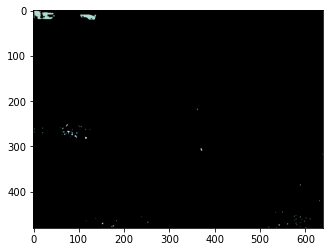

2343 Pixel in Video: 0327.mp4


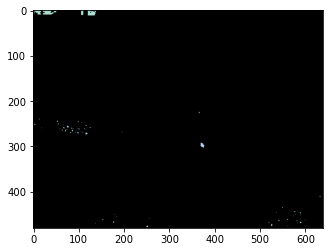

927 Pixel in Video: 0327.mp4


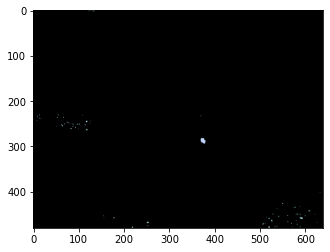

1098 Pixel in Video: 0327.mp4


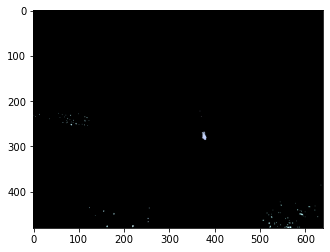

1557 Pixel in Video: 0327.mp4


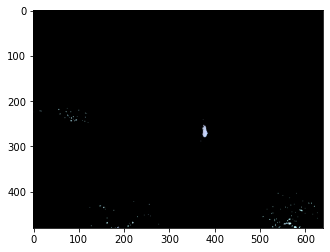

1614 Pixel in Video: 0327.mp4


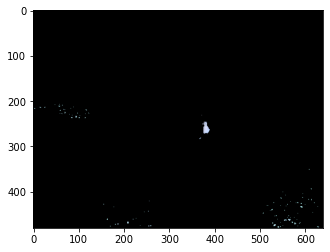

2247 Pixel in Video: 0327.mp4


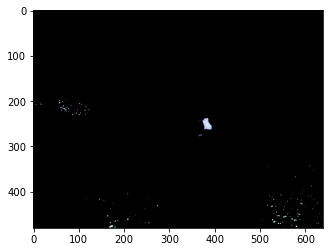

2367 Pixel in Video: 0327.mp4


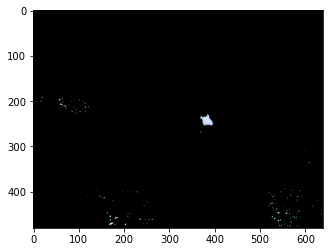

3117 Pixel in Video: 0327.mp4


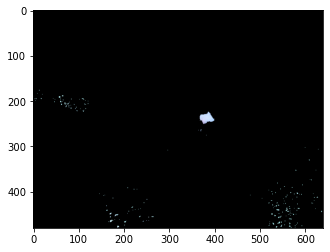

3525 Pixel in Video: 0327.mp4


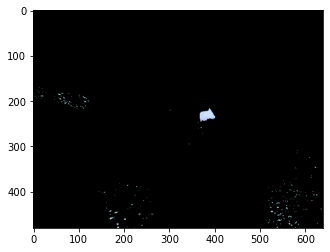

3864 Pixel in Video: 0327.mp4


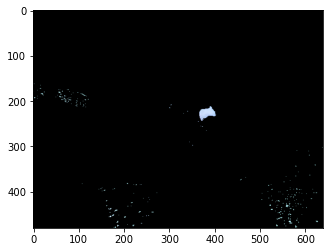

3876 Pixel in Video: 0327.mp4


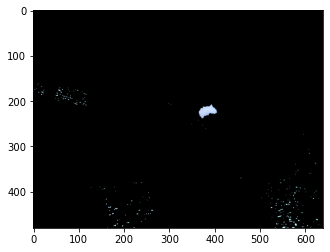

4629 Pixel in Video: 0327.mp4


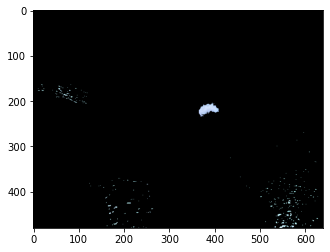

4629 Pixel in Video: 0327.mp4


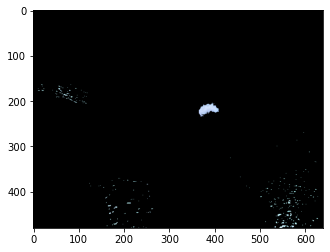

4440 Pixel in Video: 0327.mp4


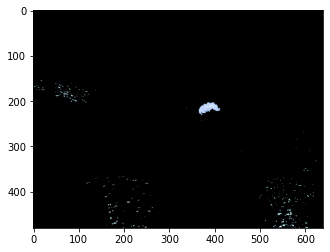

5604 Pixel in Video: 0327.mp4


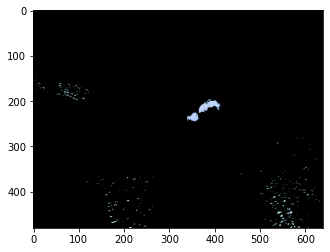

6561 Pixel in Video: 0327.mp4


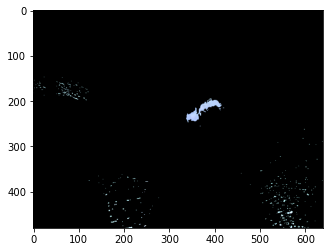

7143 Pixel in Video: 0327.mp4


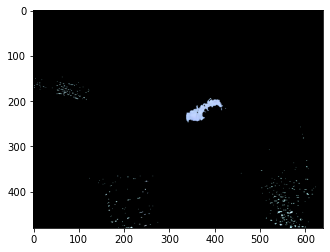

7812 Pixel in Video: 0327.mp4


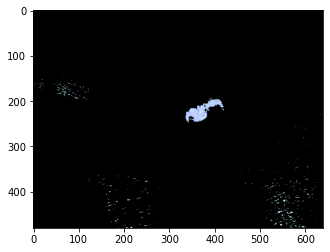

7686 Pixel in Video: 0327.mp4


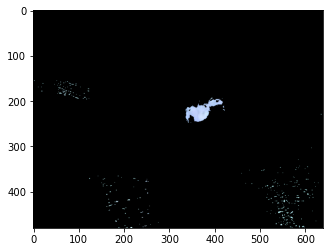

8130 Pixel in Video: 0327.mp4


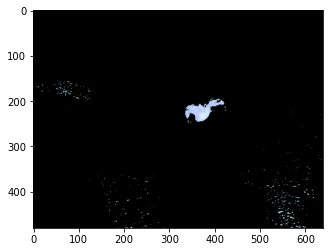

849 Pixel in Video: 0328.mp4


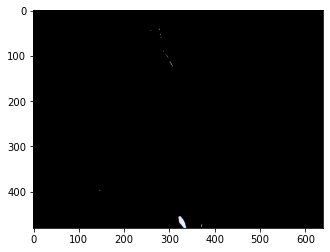

459 Pixel in Video: 0328.mp4


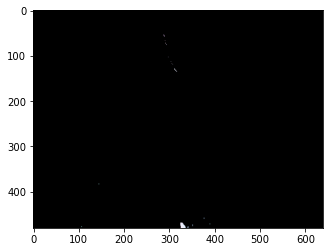

306 Pixel in Video: 0328.mp4


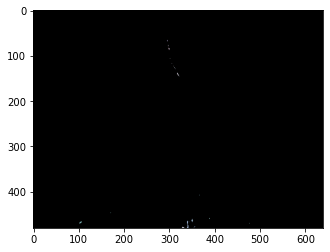

906 Pixel in Video: 0328.mp4


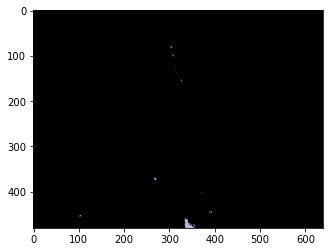

1329 Pixel in Video: 0328.mp4


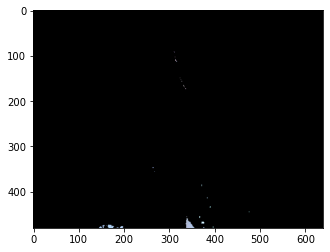

4302 Pixel in Video: 0328.mp4


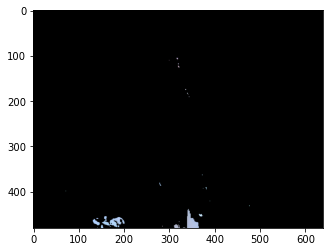

5457 Pixel in Video: 0328.mp4


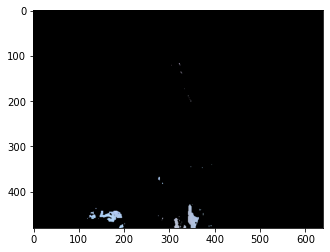

6630 Pixel in Video: 0328.mp4


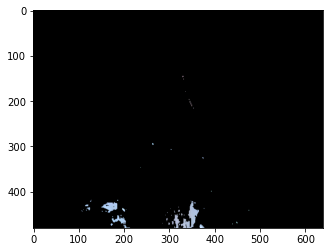

7308 Pixel in Video: 0328.mp4


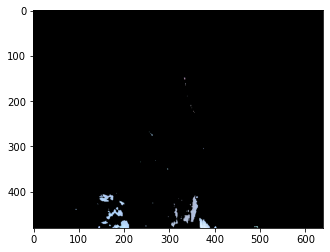

7458 Pixel in Video: 0328.mp4


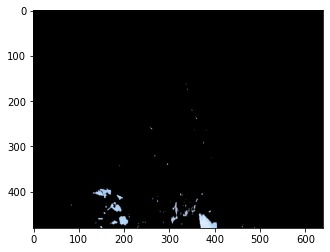

7740 Pixel in Video: 0328.mp4


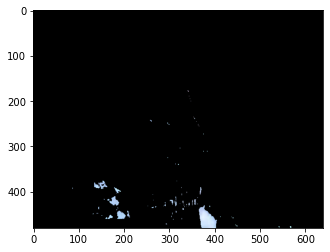

8364 Pixel in Video: 0328.mp4


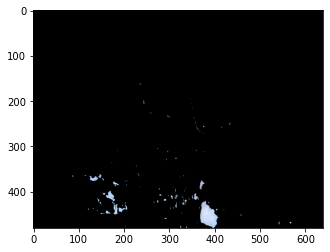

11871 Pixel in Video: 0328.mp4


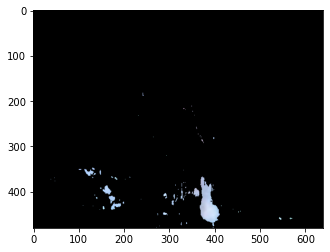

13860 Pixel in Video: 0328.mp4


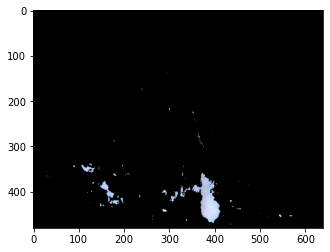

14694 Pixel in Video: 0328.mp4


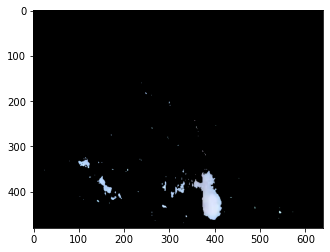

16413 Pixel in Video: 0328.mp4


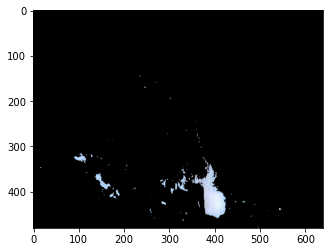

17475 Pixel in Video: 0328.mp4


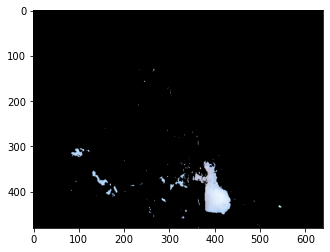

18966 Pixel in Video: 0328.mp4


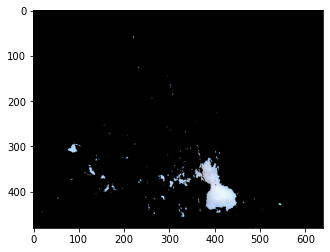

21321 Pixel in Video: 0328.mp4


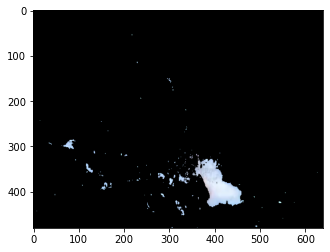

22917 Pixel in Video: 0328.mp4


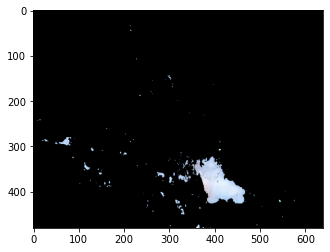

25626 Pixel in Video: 0328.mp4


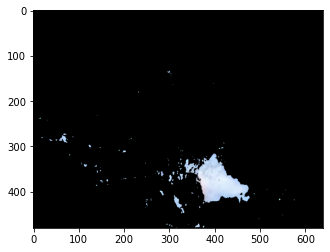

28884 Pixel in Video: 0328.mp4


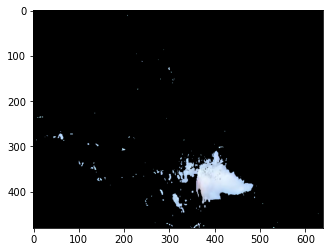

32043 Pixel in Video: 0328.mp4


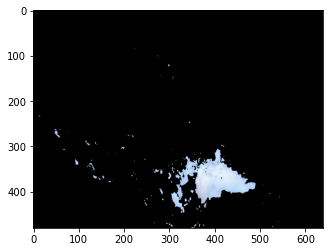

38250 Pixel in Video: 0328.mp4


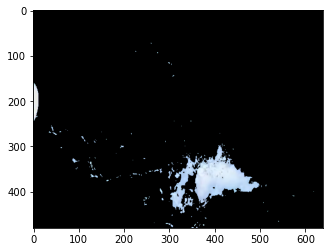

59181 Pixel in Video: 0328.mp4


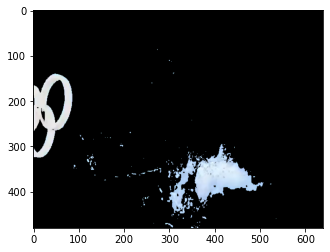

92850 Pixel in Video: 0328.mp4


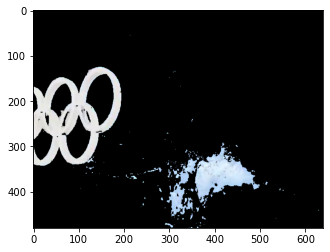

129864 Pixel in Video: 0328.mp4


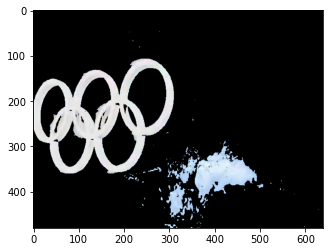

152646 Pixel in Video: 0328.mp4


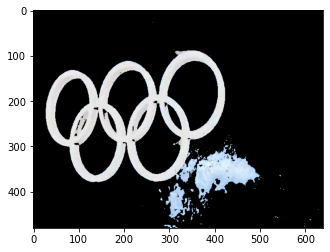

156045 Pixel in Video: 0328.mp4


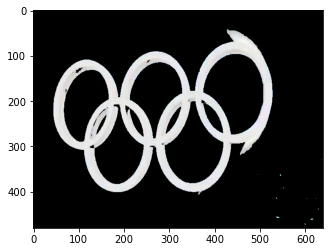

154689 Pixel in Video: 0328.mp4


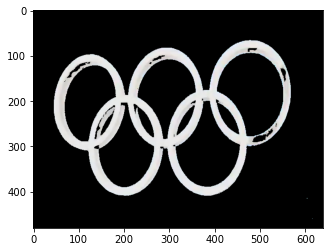

156429 Pixel in Video: 0328.mp4


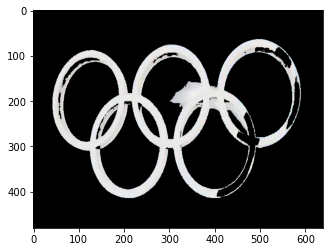

170937 Pixel in Video: 0328.mp4


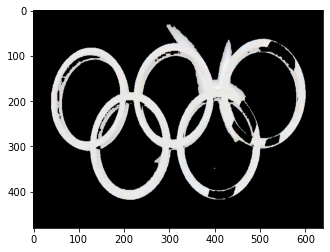

183795 Pixel in Video: 0328.mp4


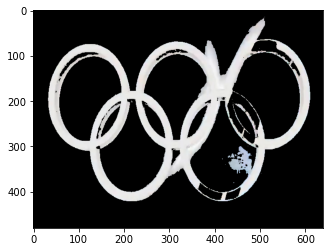

176028 Pixel in Video: 0328.mp4


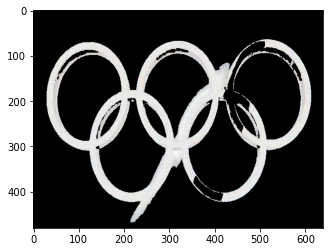

168816 Pixel in Video: 0328.mp4


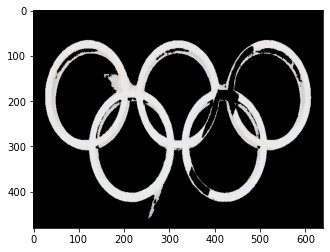

176517 Pixel in Video: 0328.mp4


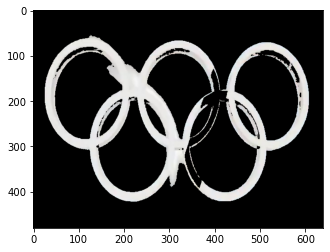

159573 Pixel in Video: 0328.mp4


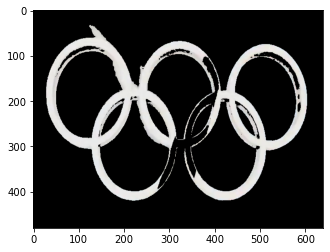

228 Pixel in Video: 0329.mp4


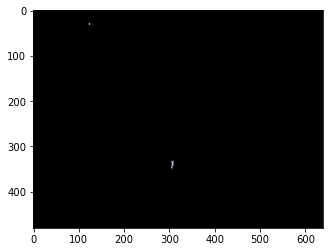

0 Pixel in Video: 0329.mp4


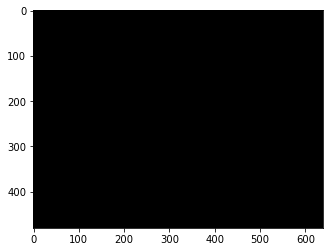

93 Pixel in Video: 0329.mp4


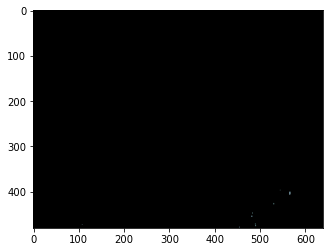

177 Pixel in Video: 0329.mp4


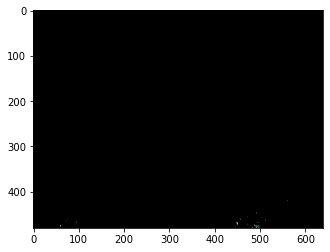

363 Pixel in Video: 0329.mp4


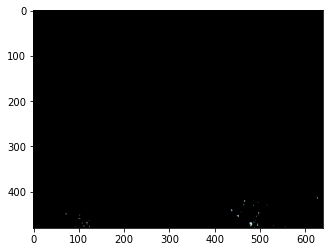

537 Pixel in Video: 0329.mp4


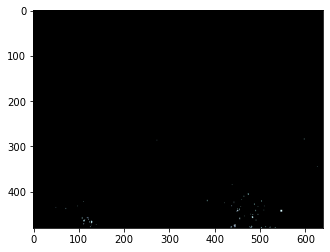

963 Pixel in Video: 0329.mp4


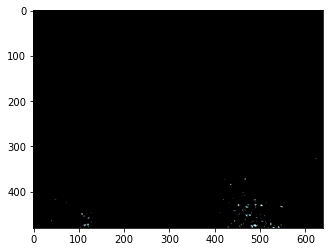

1404 Pixel in Video: 0329.mp4


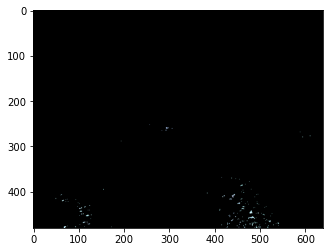

2904 Pixel in Video: 0329.mp4


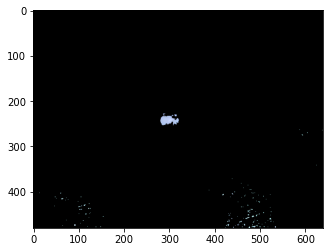

6426 Pixel in Video: 0329.mp4


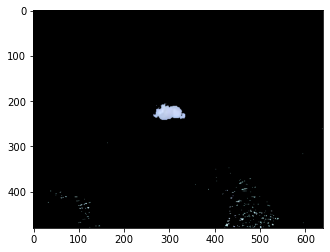

7737 Pixel in Video: 0329.mp4


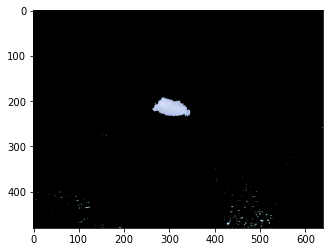

9180 Pixel in Video: 0329.mp4


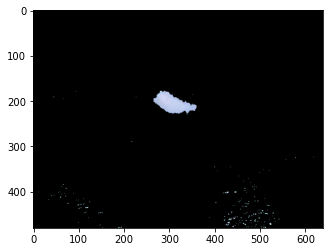

9282 Pixel in Video: 0329.mp4


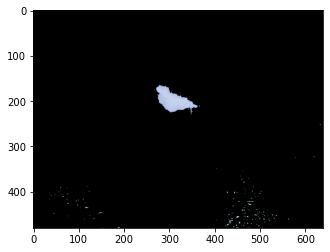

10320 Pixel in Video: 0329.mp4


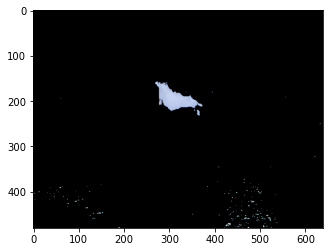

10602 Pixel in Video: 0329.mp4


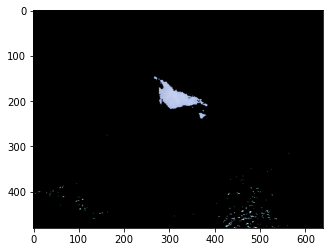

10554 Pixel in Video: 0329.mp4


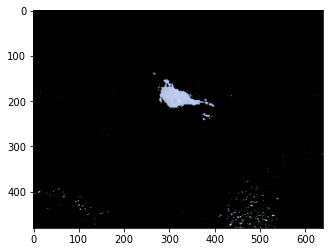

10554 Pixel in Video: 0329.mp4


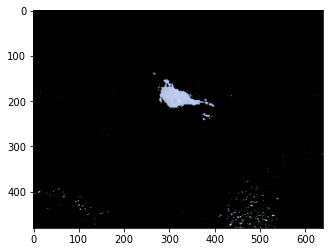

4053 Pixel in Video: 0330.mp4


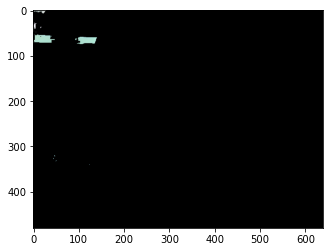

4407 Pixel in Video: 0330.mp4


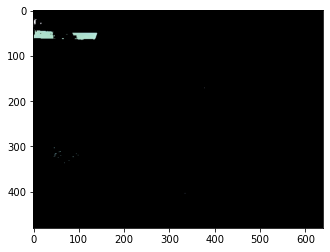

4947 Pixel in Video: 0330.mp4


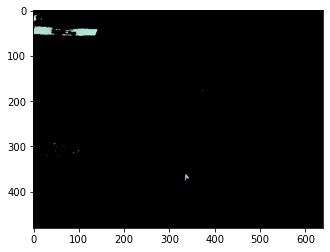

5235 Pixel in Video: 0330.mp4


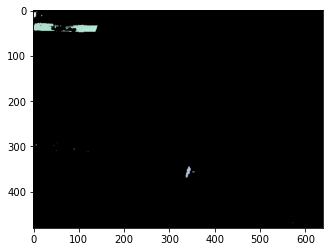

5637 Pixel in Video: 0330.mp4


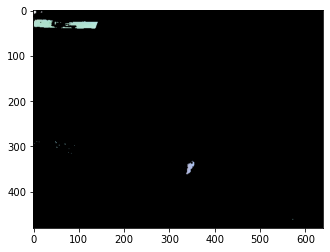

5100 Pixel in Video: 0330.mp4


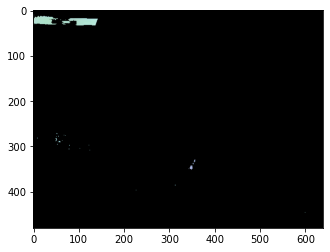

5073 Pixel in Video: 0330.mp4


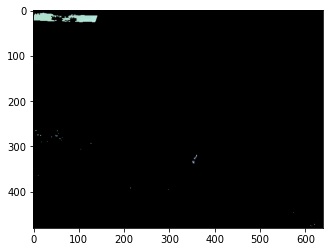

5355 Pixel in Video: 0330.mp4


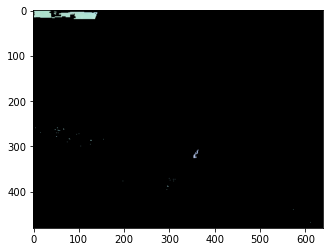

4560 Pixel in Video: 0330.mp4


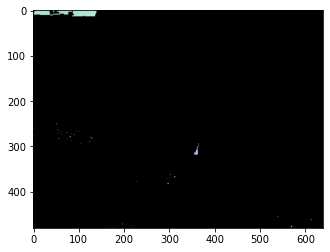

2100 Pixel in Video: 0330.mp4


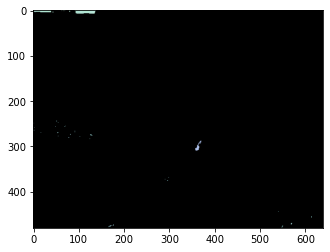

894 Pixel in Video: 0330.mp4


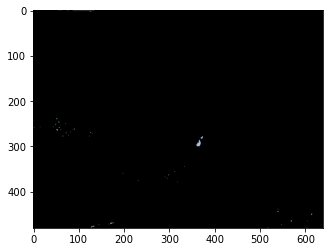

894 Pixel in Video: 0330.mp4


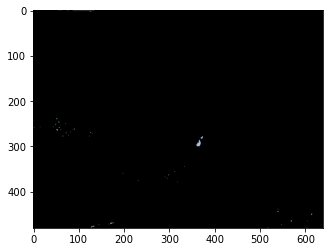

447 Pixel in Video: 0330.mp4


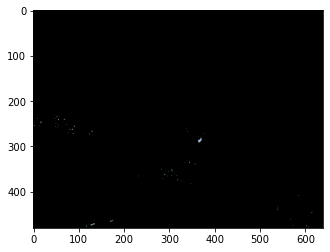

375 Pixel in Video: 0330.mp4


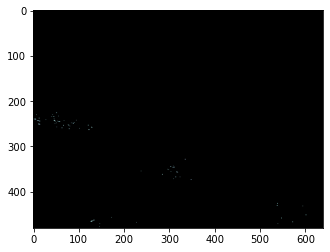

465 Pixel in Video: 0330.mp4


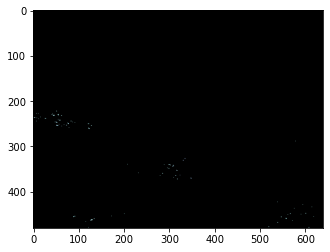

351 Pixel in Video: 0330.mp4


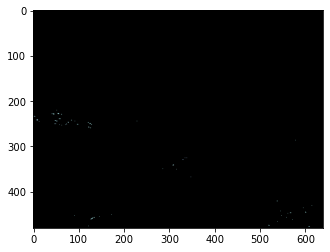

1872 Pixel in Video: 0332.mp4


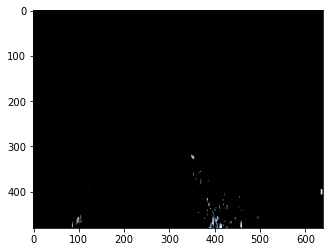

5361 Pixel in Video: 0332.mp4


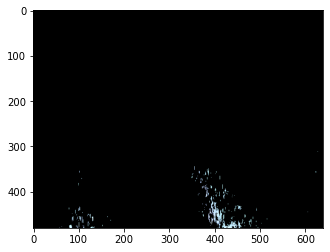

7116 Pixel in Video: 0332.mp4


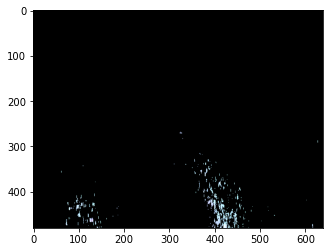

11388 Pixel in Video: 0332.mp4


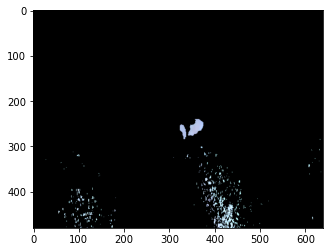

9825 Pixel in Video: 0332.mp4


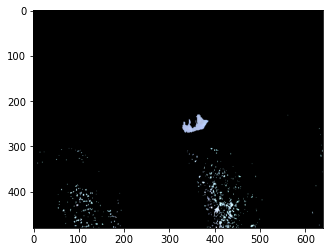

9009 Pixel in Video: 0332.mp4


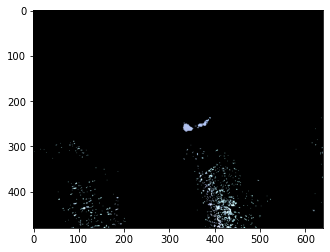

7119 Pixel in Video: 0332.mp4


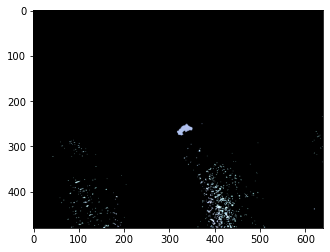

7386 Pixel in Video: 0332.mp4


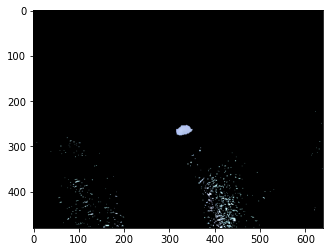

7491 Pixel in Video: 0332.mp4


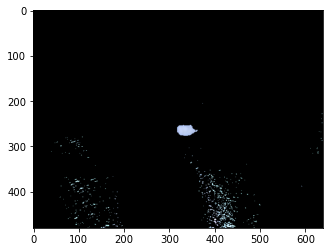

11025 Pixel in Video: 0332.mp4


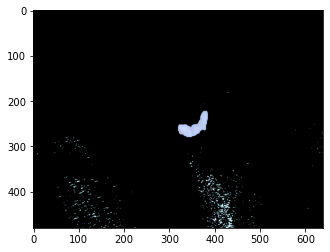

13125 Pixel in Video: 0332.mp4


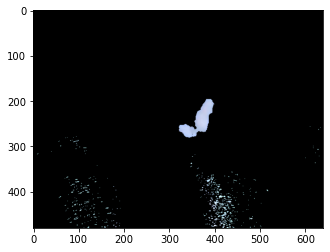

13734 Pixel in Video: 0332.mp4


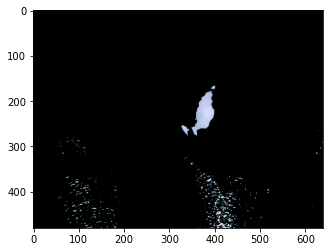

14181 Pixel in Video: 0332.mp4


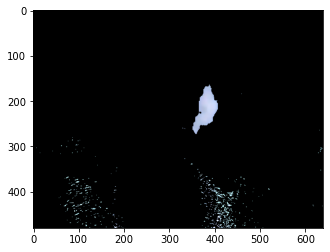

15507 Pixel in Video: 0332.mp4


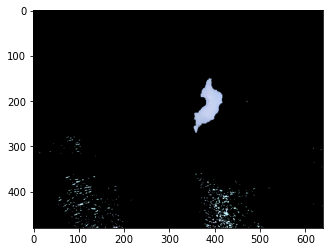

16425 Pixel in Video: 0332.mp4


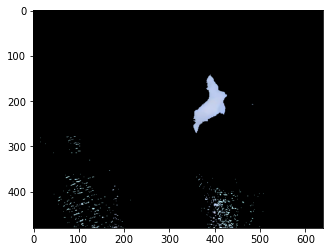

16200 Pixel in Video: 0332.mp4


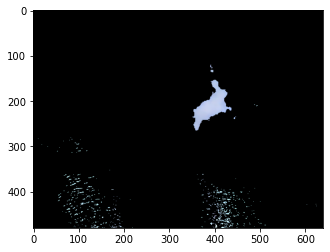

15489 Pixel in Video: 0332.mp4


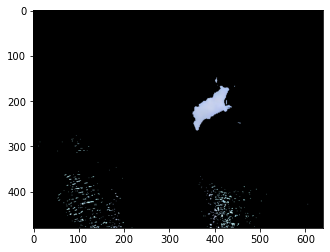

16941 Pixel in Video: 0332.mp4


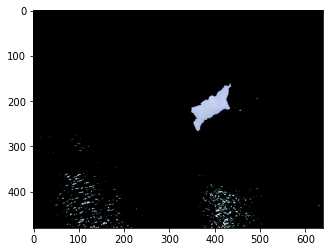

16854 Pixel in Video: 0332.mp4


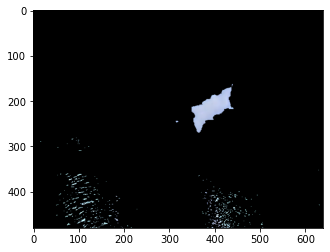

17487 Pixel in Video: 0332.mp4


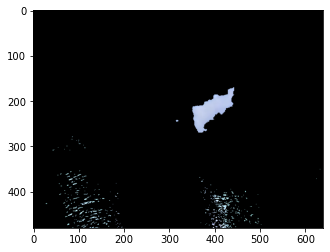

16065 Pixel in Video: 0332.mp4


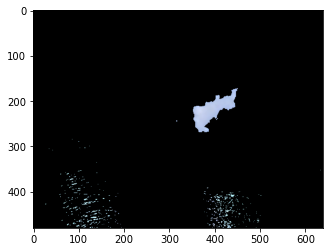

15915 Pixel in Video: 0332.mp4


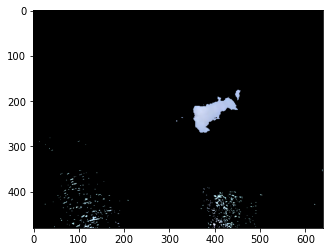

15759 Pixel in Video: 0332.mp4


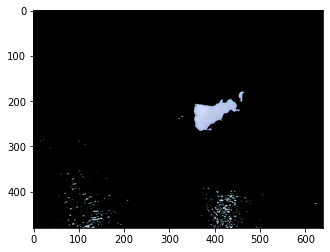

15552 Pixel in Video: 0332.mp4


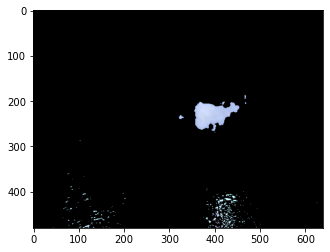

16116 Pixel in Video: 0332.mp4


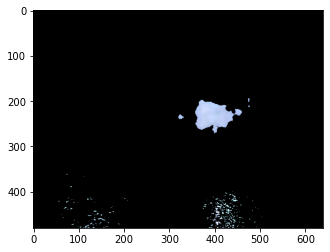

16218 Pixel in Video: 0332.mp4


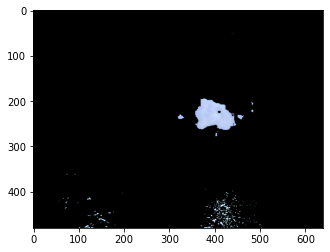

17103 Pixel in Video: 0332.mp4


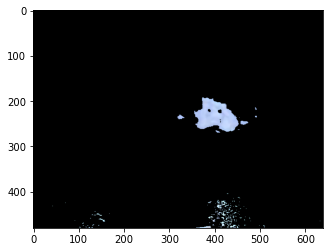

16533 Pixel in Video: 0332.mp4


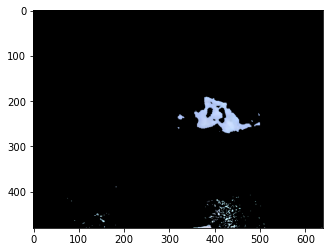

14544 Pixel in Video: 0332.mp4


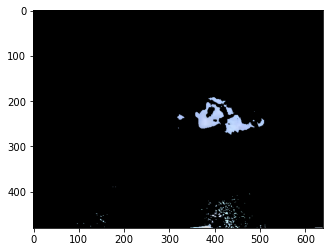

12633 Pixel in Video: 0332.mp4


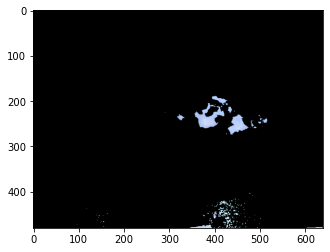

10656 Pixel in Video: 0332.mp4


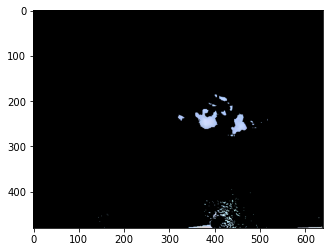

10728 Pixel in Video: 0332.mp4


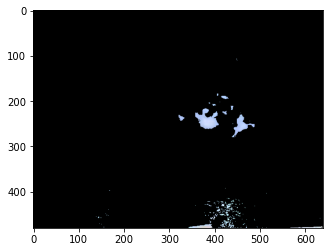

10470 Pixel in Video: 0332.mp4


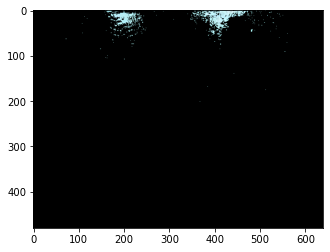

9783 Pixel in Video: 0332.mp4


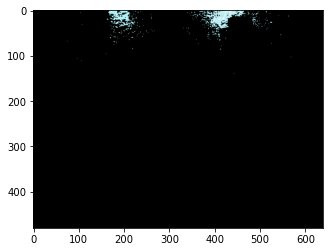

11370 Pixel in Video: 0332.mp4


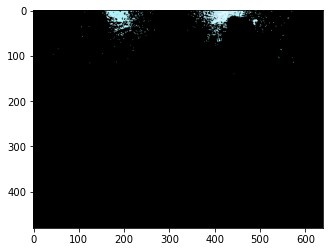

12189 Pixel in Video: 0332.mp4


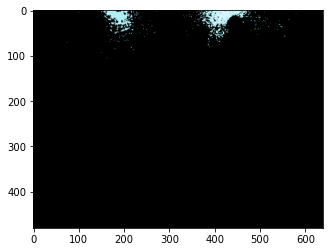

14601 Pixel in Video: 0332.mp4


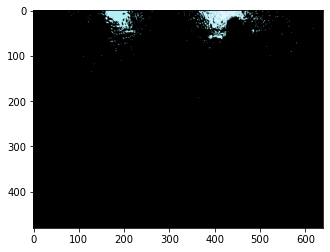

15930 Pixel in Video: 0332.mp4


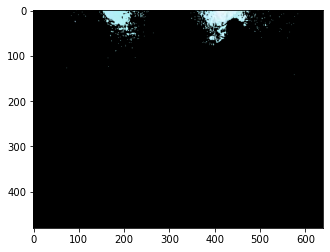

18999 Pixel in Video: 0332.mp4


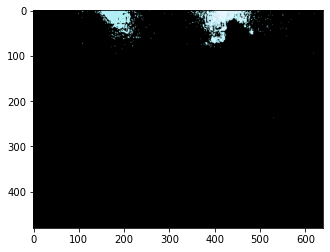

21324 Pixel in Video: 0332.mp4


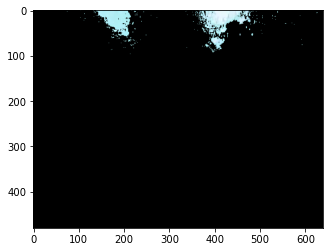

23307 Pixel in Video: 0332.mp4


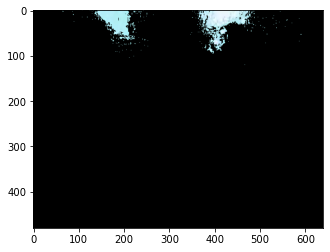

25665 Pixel in Video: 0332.mp4


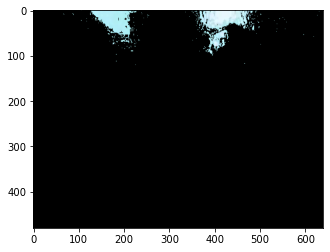

1269 Pixel in Video: 0333.mp4


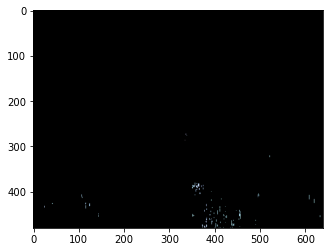

1260 Pixel in Video: 0333.mp4


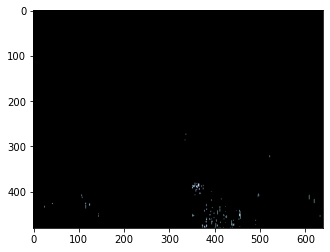

1752 Pixel in Video: 0333.mp4


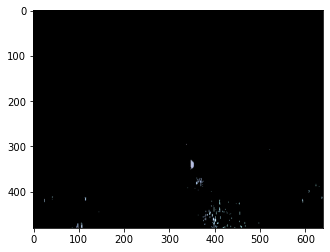

1755 Pixel in Video: 0333.mp4


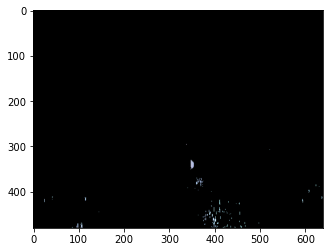

1806 Pixel in Video: 0333.mp4


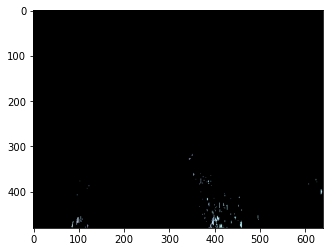

3360 Pixel in Video: 0333.mp4


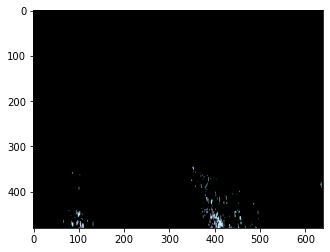

3348 Pixel in Video: 0333.mp4


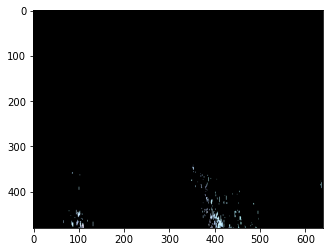

5421 Pixel in Video: 0333.mp4


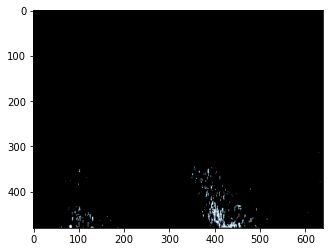

5493 Pixel in Video: 0333.mp4


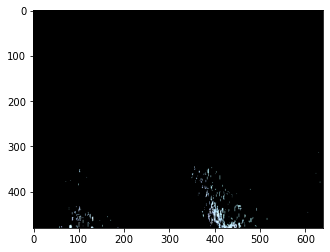

6747 Pixel in Video: 0333.mp4


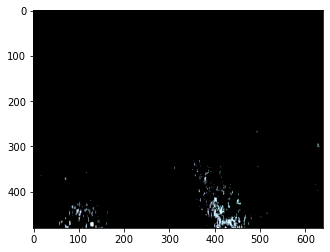

6648 Pixel in Video: 0333.mp4


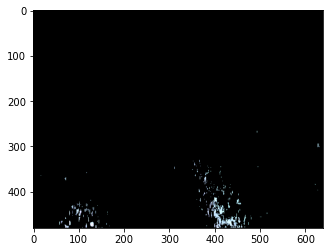

8055 Pixel in Video: 0333.mp4


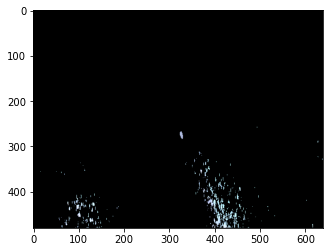

10641 Pixel in Video: 0333.mp4


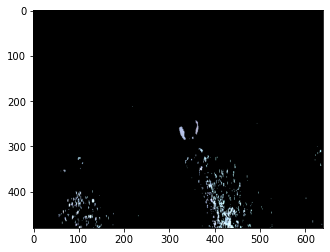

10671 Pixel in Video: 0333.mp4


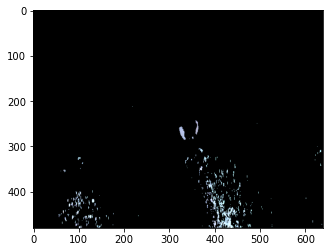

13212 Pixel in Video: 0333.mp4


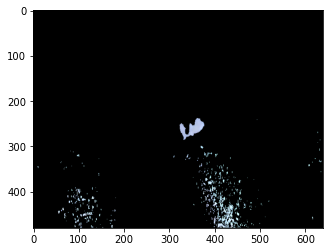

13203 Pixel in Video: 0333.mp4


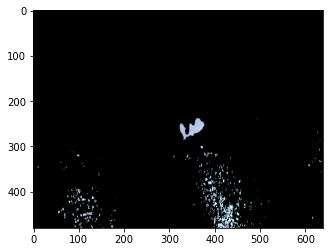

12963 Pixel in Video: 0333.mp4


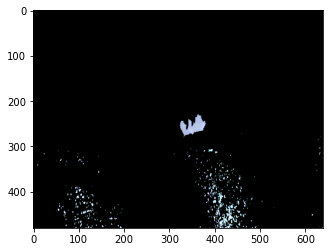

11943 Pixel in Video: 0333.mp4


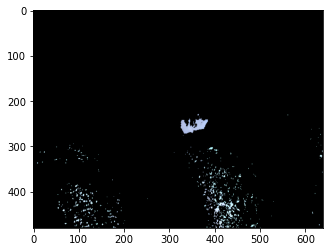

11970 Pixel in Video: 0333.mp4


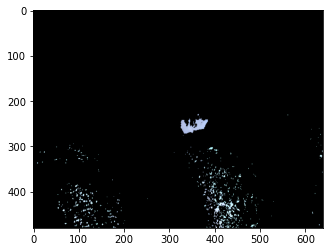

11013 Pixel in Video: 0333.mp4


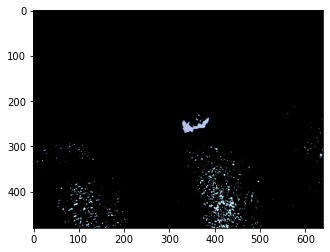

8097 Pixel in Video: 0337.mp4


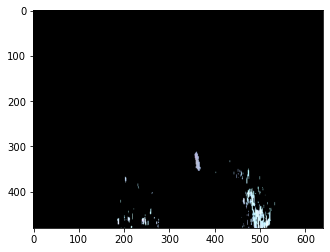

9852 Pixel in Video: 0337.mp4


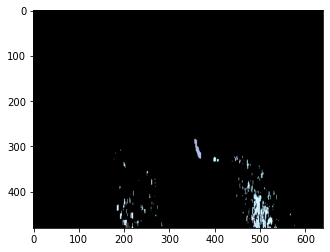

12999 Pixel in Video: 0337.mp4


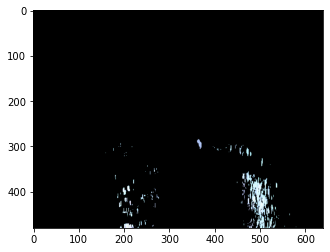

16803 Pixel in Video: 0337.mp4


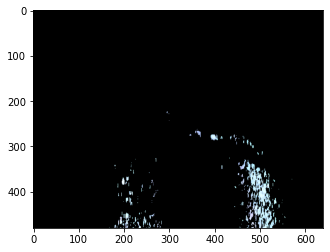

23787 Pixel in Video: 0337.mp4


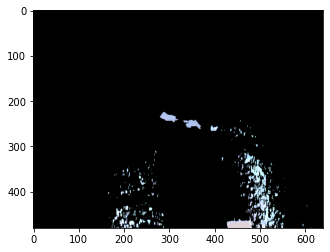

31713 Pixel in Video: 0337.mp4


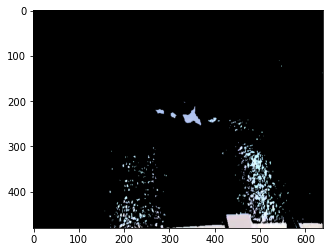

41133 Pixel in Video: 0337.mp4


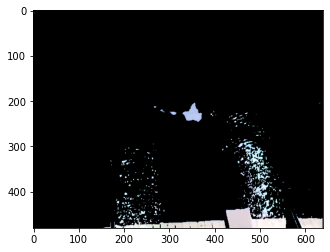

47577 Pixel in Video: 0337.mp4


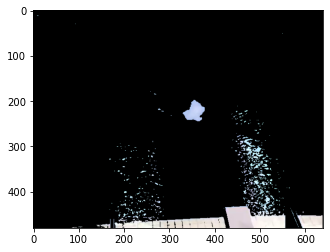

52653 Pixel in Video: 0337.mp4


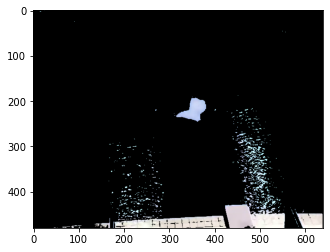

55509 Pixel in Video: 0337.mp4


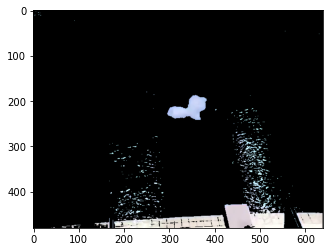

55968 Pixel in Video: 0337.mp4


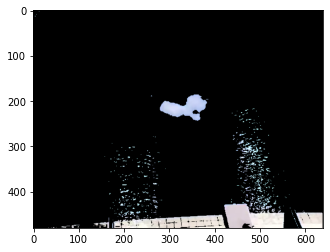

55737 Pixel in Video: 0337.mp4


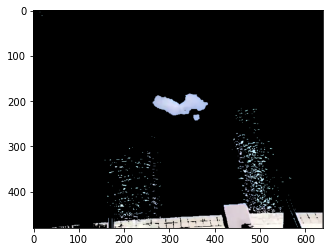

56157 Pixel in Video: 0337.mp4


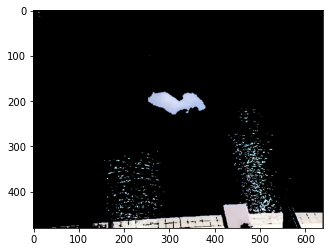

57048 Pixel in Video: 0337.mp4


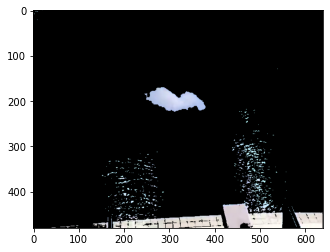

58761 Pixel in Video: 0337.mp4


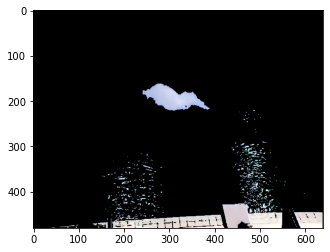

60018 Pixel in Video: 0337.mp4


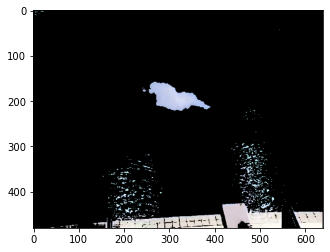

2004 Pixel in Video: 0338.mp4


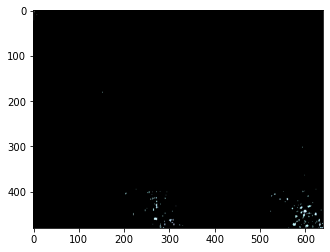

2697 Pixel in Video: 0338.mp4


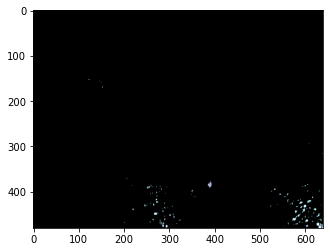

3681 Pixel in Video: 0338.mp4


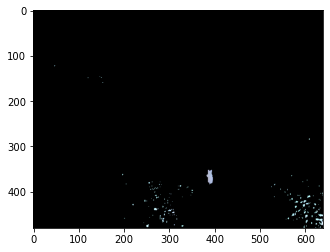

4644 Pixel in Video: 0338.mp4


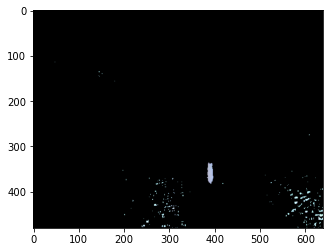

5199 Pixel in Video: 0338.mp4


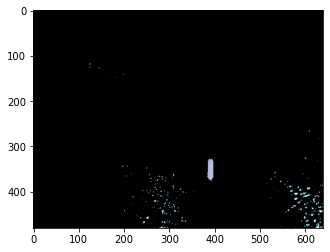

6138 Pixel in Video: 0338.mp4


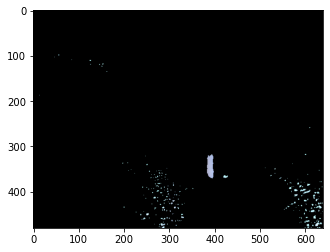

5952 Pixel in Video: 0338.mp4


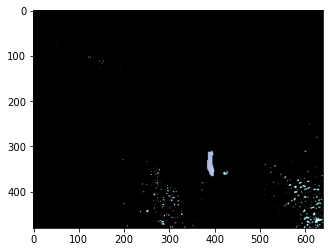

5919 Pixel in Video: 0338.mp4


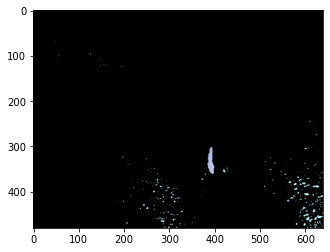

6186 Pixel in Video: 0338.mp4


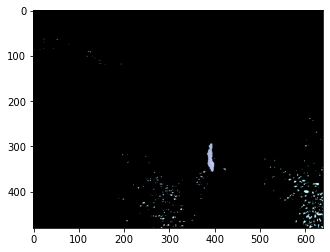

6432 Pixel in Video: 0338.mp4


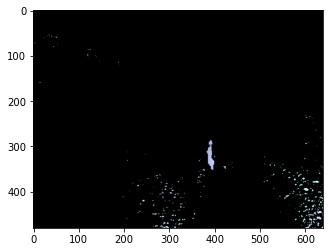

6339 Pixel in Video: 0338.mp4


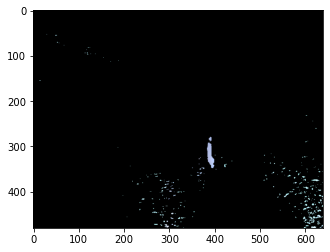

6522 Pixel in Video: 0338.mp4


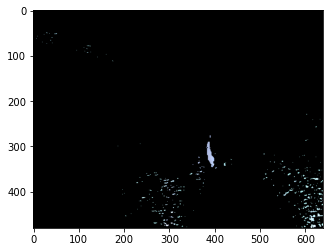

6705 Pixel in Video: 0338.mp4


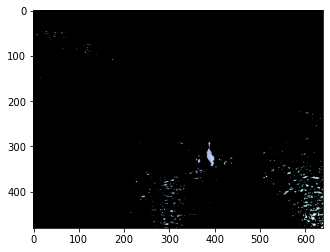

7812 Pixel in Video: 0338.mp4


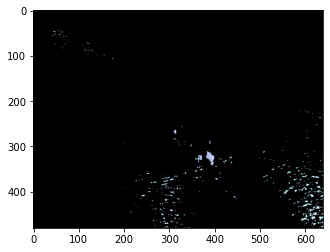

8394 Pixel in Video: 0338.mp4


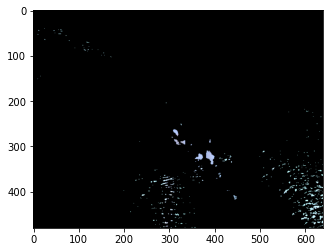

10029 Pixel in Video: 0338.mp4


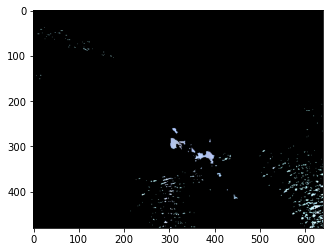

10869 Pixel in Video: 0338.mp4


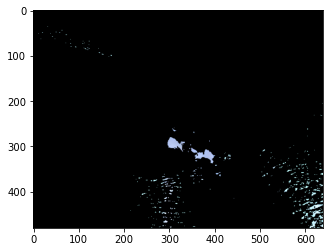

12276 Pixel in Video: 0338.mp4


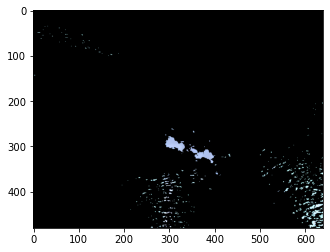

12249 Pixel in Video: 0338.mp4


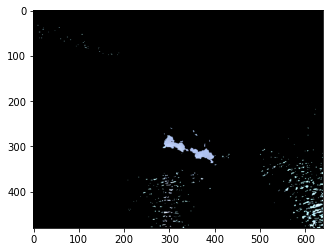

12828 Pixel in Video: 0338.mp4


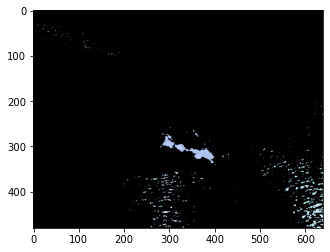

12339 Pixel in Video: 0338.mp4


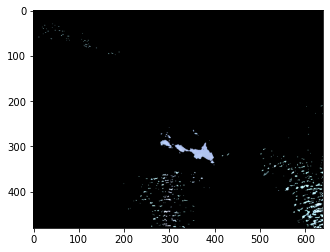

12738 Pixel in Video: 0338.mp4


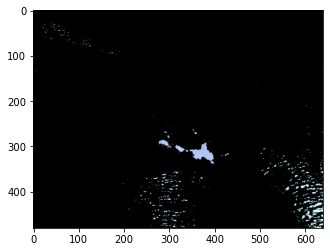

12585 Pixel in Video: 0338.mp4


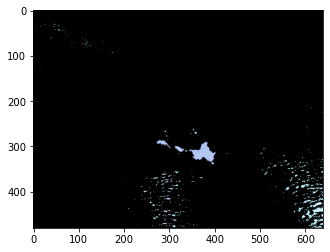

13320 Pixel in Video: 0338.mp4


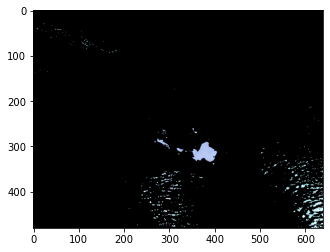

13557 Pixel in Video: 0338.mp4


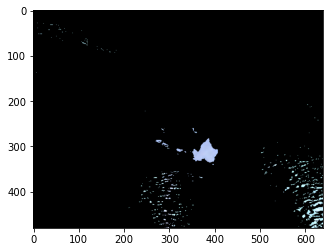

14229 Pixel in Video: 0338.mp4


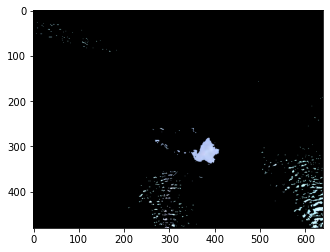

14778 Pixel in Video: 0338.mp4


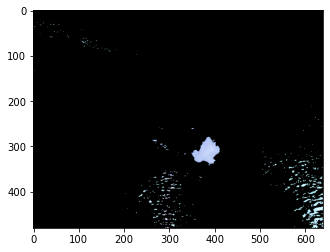

15285 Pixel in Video: 0338.mp4


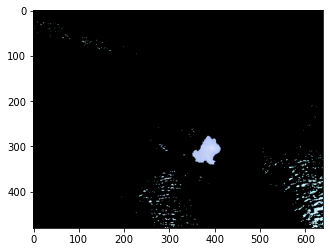

15558 Pixel in Video: 0338.mp4


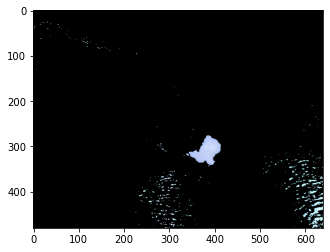

16536 Pixel in Video: 0338.mp4


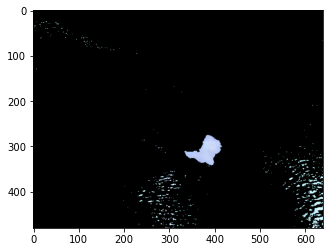

1449 Pixel in Video: 0340.mp4


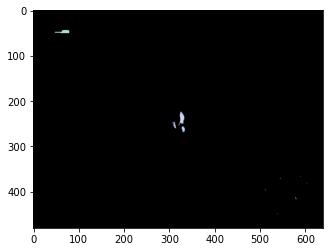

2832 Pixel in Video: 0340.mp4


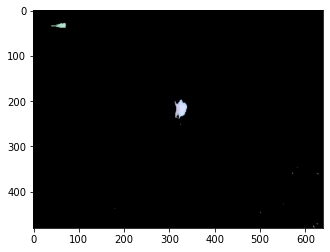

5385 Pixel in Video: 0340.mp4


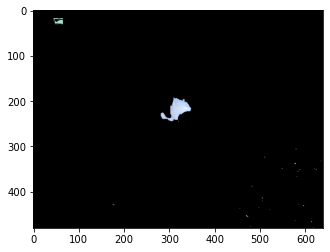

6165 Pixel in Video: 0340.mp4


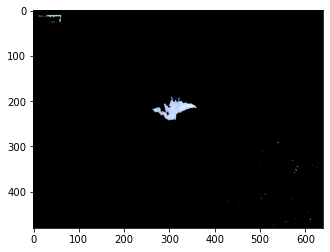

7725 Pixel in Video: 0340.mp4


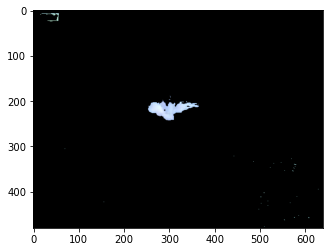

7773 Pixel in Video: 0340.mp4


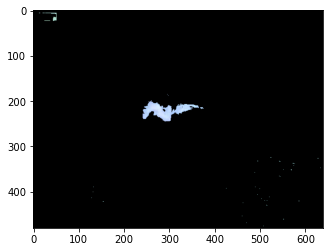

5655 Pixel in Video: 0340.mp4


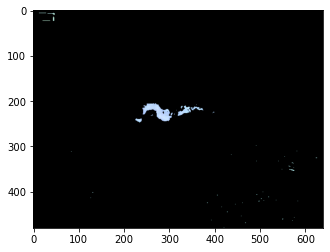

4836 Pixel in Video: 0340.mp4


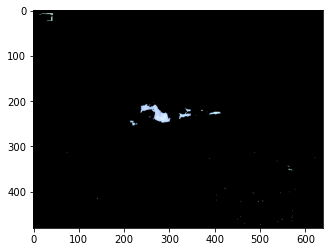

5580 Pixel in Video: 0340.mp4


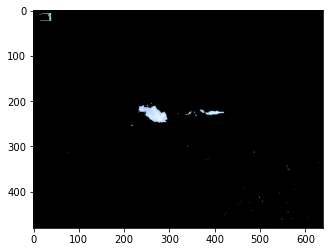

6495 Pixel in Video: 0340.mp4


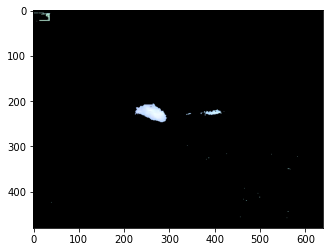

7014 Pixel in Video: 0340.mp4


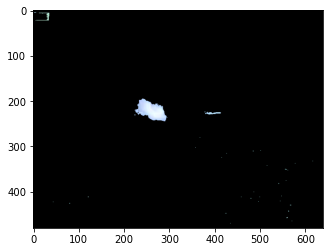

6690 Pixel in Video: 0340.mp4


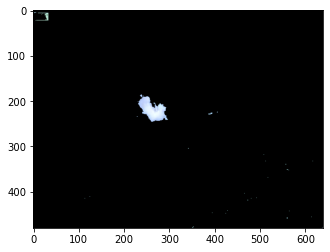

6546 Pixel in Video: 0340.mp4


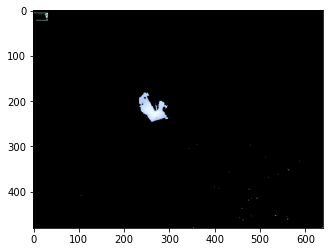

5949 Pixel in Video: 0340.mp4


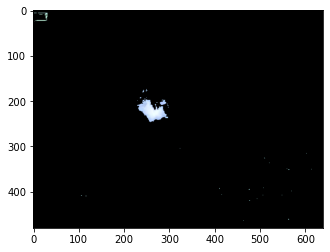

5229 Pixel in Video: 0340.mp4


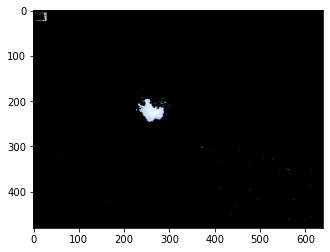

5424 Pixel in Video: 0340.mp4


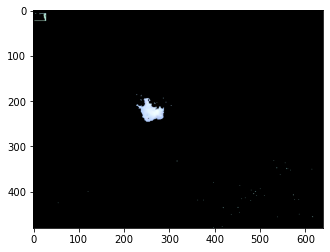

5175 Pixel in Video: 0340.mp4


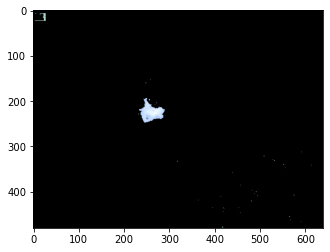

5178 Pixel in Video: 0340.mp4


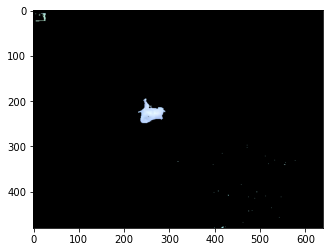

5229 Pixel in Video: 0340.mp4


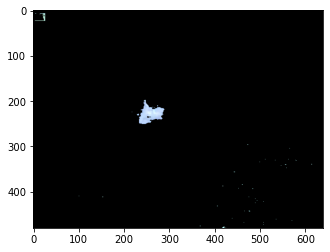

5460 Pixel in Video: 0340.mp4


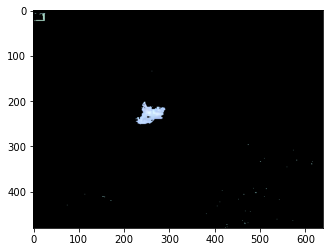

19356 Pixel in Video: 0342.mp4


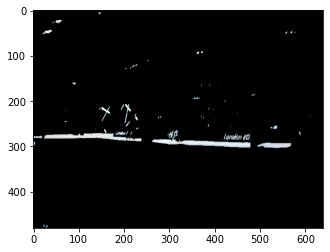

18531 Pixel in Video: 0342.mp4


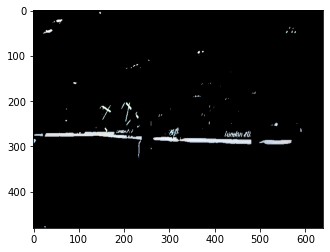

17526 Pixel in Video: 0342.mp4


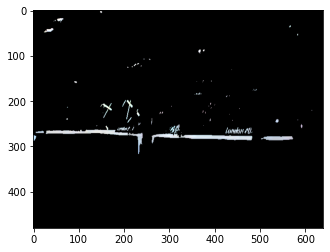

15480 Pixel in Video: 0342.mp4


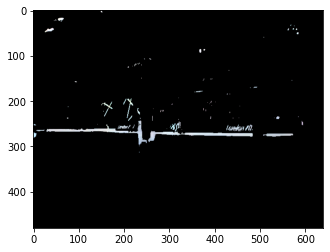

9024 Pixel in Video: 0342.mp4


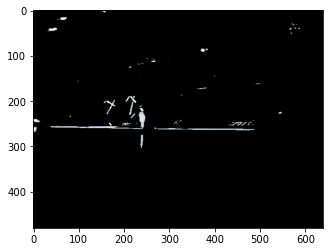

918 Pixel in Video: 0342.mp4


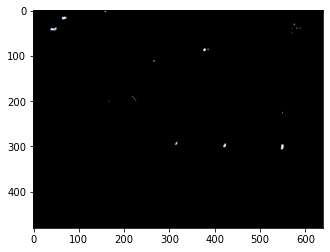

411 Pixel in Video: 0342.mp4


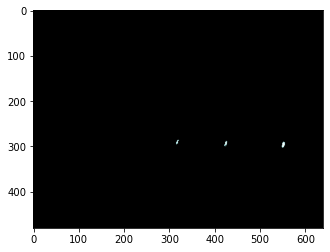

477 Pixel in Video: 0342.mp4


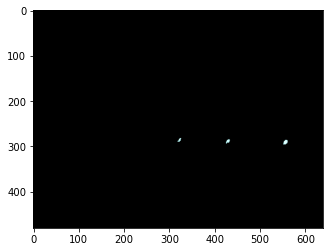

402 Pixel in Video: 0342.mp4


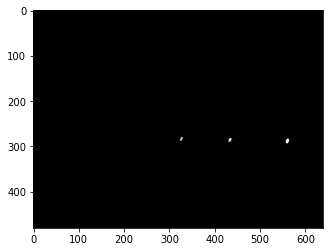

324 Pixel in Video: 0342.mp4


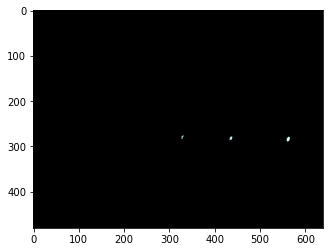

396 Pixel in Video: 0342.mp4


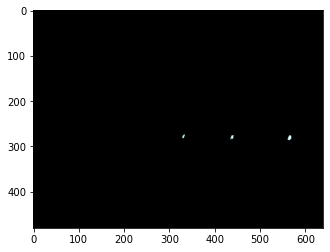

315 Pixel in Video: 0342.mp4


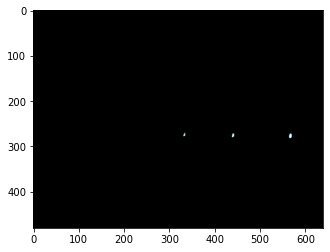

396 Pixel in Video: 0342.mp4


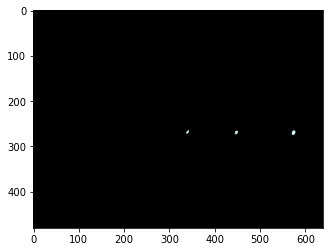

414 Pixel in Video: 0342.mp4


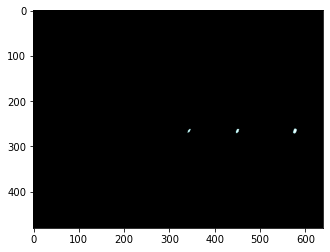

435 Pixel in Video: 0342.mp4


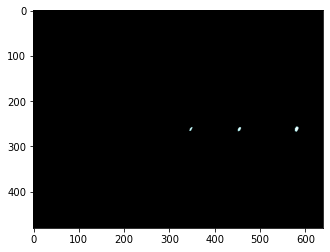

399 Pixel in Video: 0342.mp4


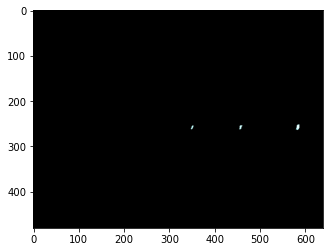

438 Pixel in Video: 0342.mp4


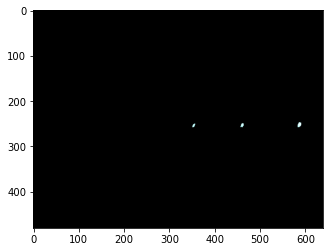

222 Pixel in Video: 0344.mp4


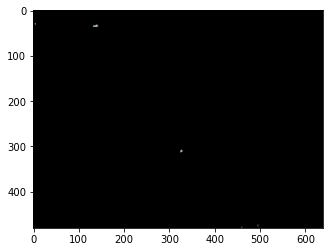

393 Pixel in Video: 0344.mp4


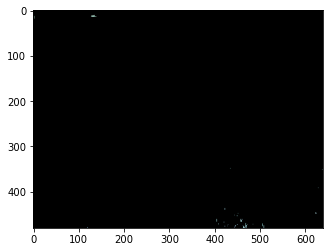

939 Pixel in Video: 0344.mp4


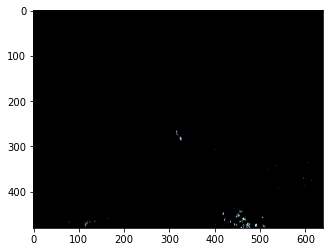

1575 Pixel in Video: 0344.mp4


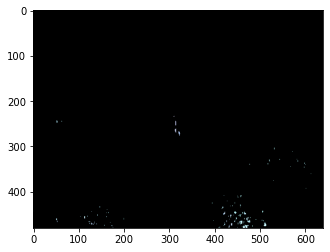

2376 Pixel in Video: 0344.mp4


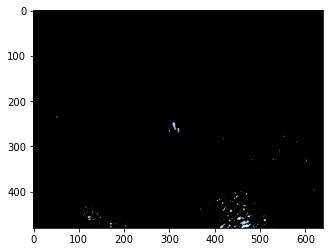

3657 Pixel in Video: 0344.mp4


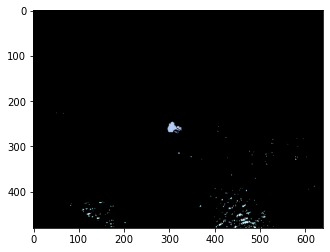

4257 Pixel in Video: 0344.mp4


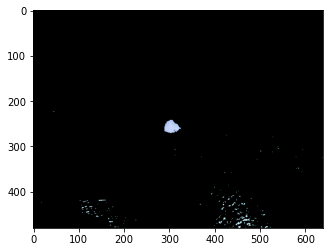

5697 Pixel in Video: 0344.mp4


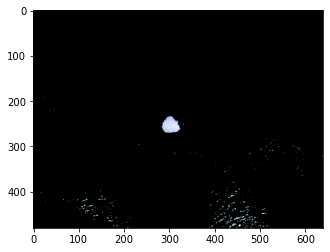

5616 Pixel in Video: 0344.mp4


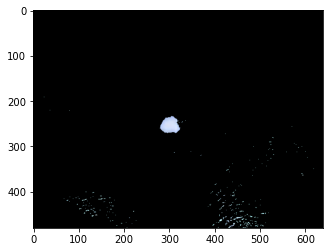

6399 Pixel in Video: 0344.mp4


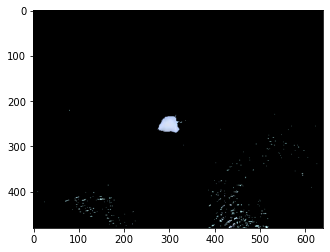

6843 Pixel in Video: 0344.mp4


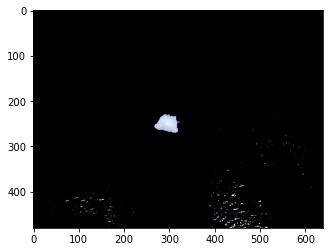

8247 Pixel in Video: 0344.mp4


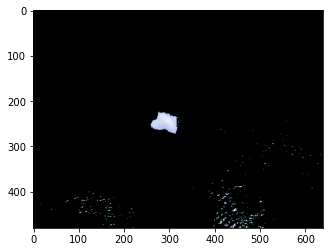

8934 Pixel in Video: 0344.mp4


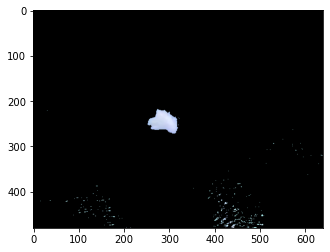

10404 Pixel in Video: 0344.mp4


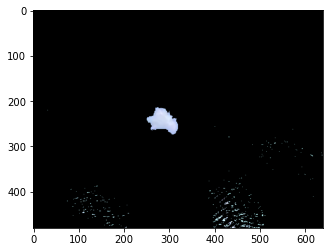

10482 Pixel in Video: 0344.mp4


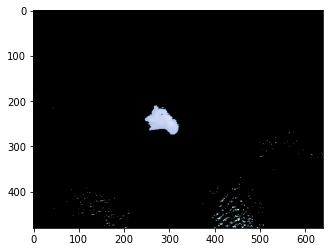

21444 Pixel in Video: 0345.mp4


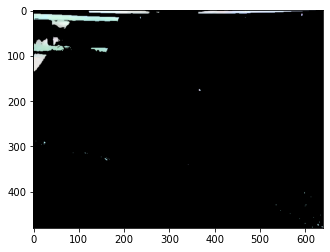

14394 Pixel in Video: 0345.mp4


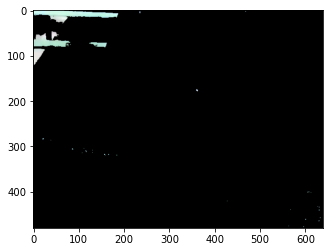

10758 Pixel in Video: 0345.mp4


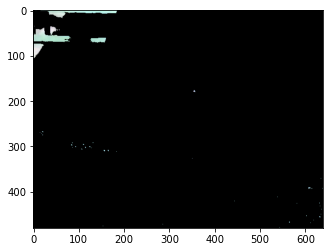

6735 Pixel in Video: 0345.mp4


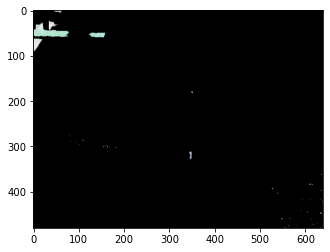

6510 Pixel in Video: 0345.mp4


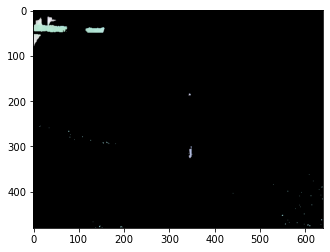

7365 Pixel in Video: 0345.mp4


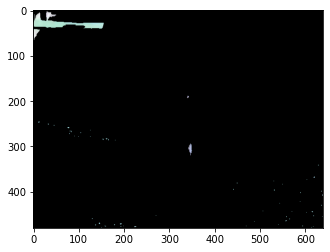

5610 Pixel in Video: 0345.mp4


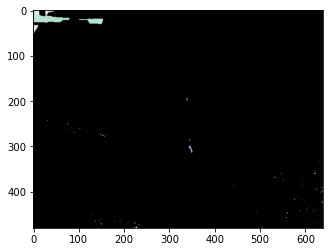

6471 Pixel in Video: 0345.mp4


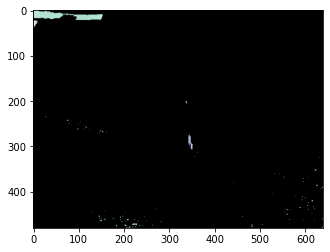

5775 Pixel in Video: 0345.mp4


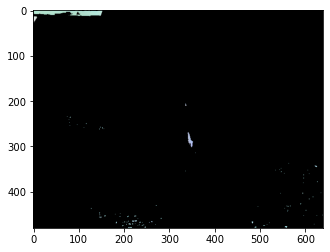

2172 Pixel in Video: 0345.mp4


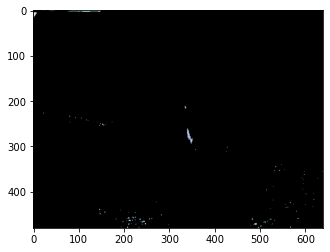

2064 Pixel in Video: 0345.mp4


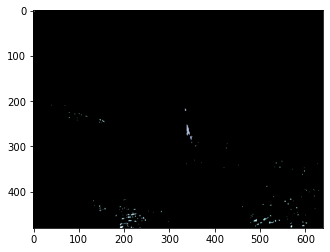

1944 Pixel in Video: 0345.mp4


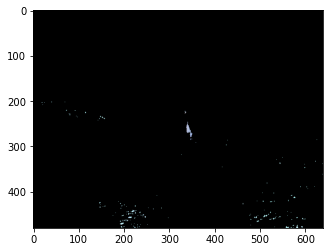

1752 Pixel in Video: 0345.mp4


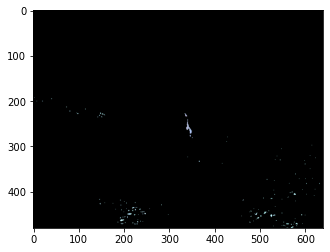

2190 Pixel in Video: 0345.mp4


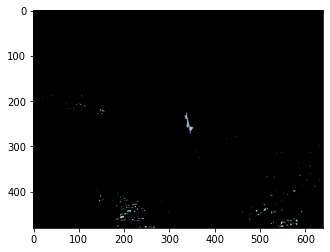

2256 Pixel in Video: 0345.mp4


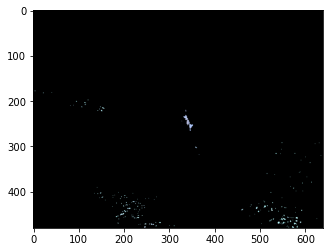

2475 Pixel in Video: 0345.mp4


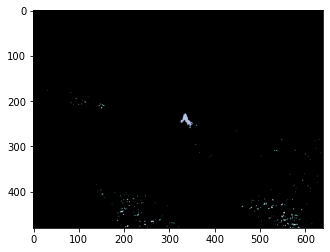

3156 Pixel in Video: 0345.mp4


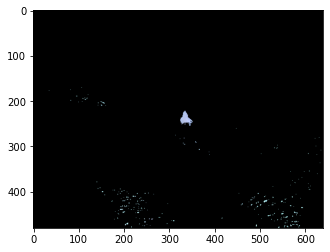

690 Pixel in Video: 0347.mp4


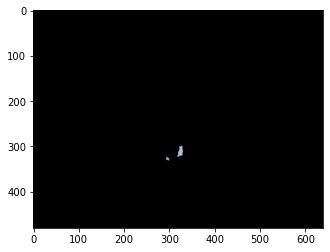

144 Pixel in Video: 0347.mp4


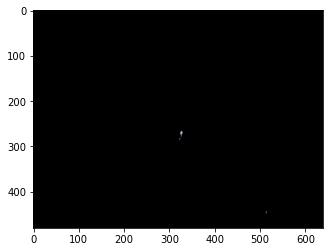

189 Pixel in Video: 0347.mp4


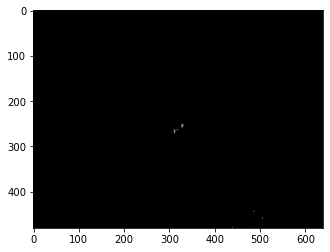

585 Pixel in Video: 0347.mp4


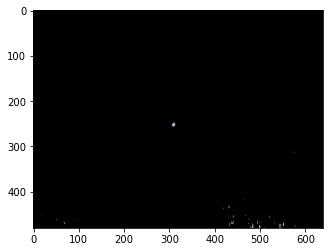

1533 Pixel in Video: 0347.mp4


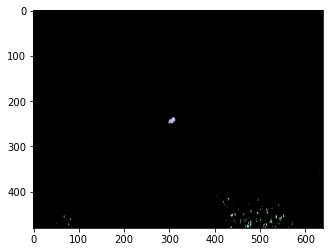

3432 Pixel in Video: 0347.mp4


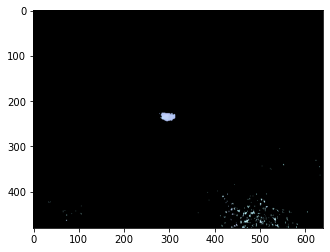

4176 Pixel in Video: 0347.mp4


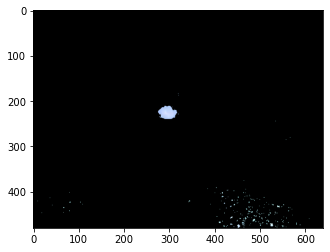

5835 Pixel in Video: 0347.mp4


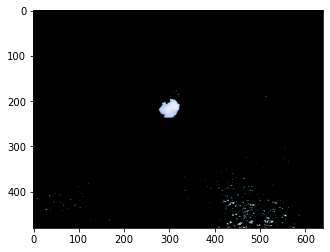

7527 Pixel in Video: 0347.mp4


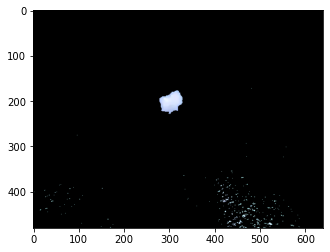

9105 Pixel in Video: 0347.mp4


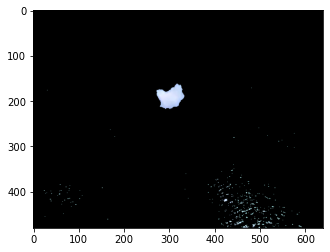

9792 Pixel in Video: 0347.mp4


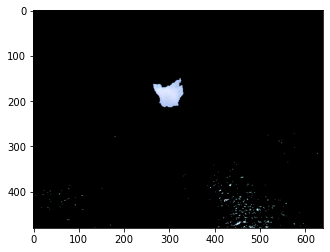

10566 Pixel in Video: 0347.mp4


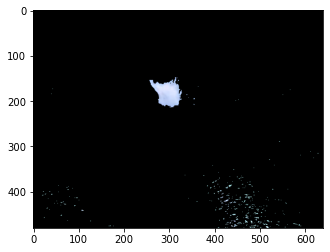

10530 Pixel in Video: 0347.mp4


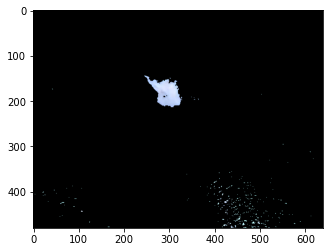

10866 Pixel in Video: 0347.mp4


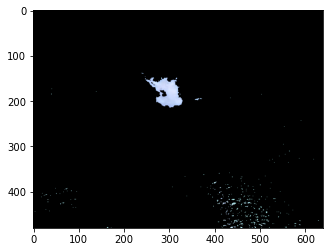

11112 Pixel in Video: 0347.mp4


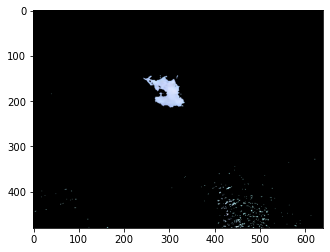

11022 Pixel in Video: 0347.mp4


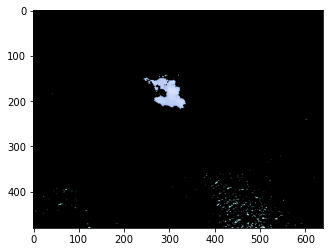

10800 Pixel in Video: 0347.mp4


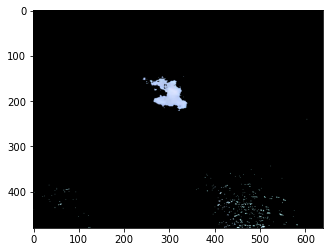

10026 Pixel in Video: 0347.mp4


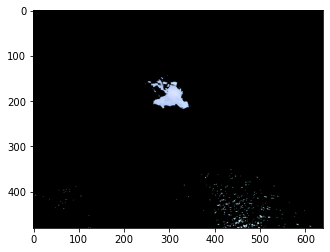

9495 Pixel in Video: 0347.mp4


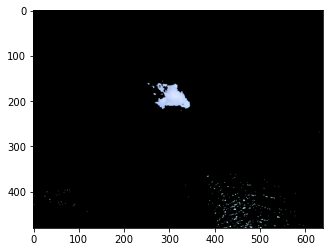

8682 Pixel in Video: 0347.mp4


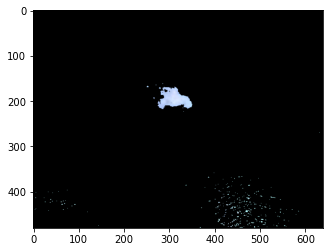

8865 Pixel in Video: 0347.mp4


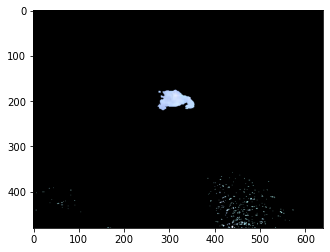

9222 Pixel in Video: 0347.mp4


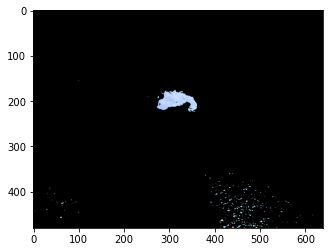

8682 Pixel in Video: 0347.mp4


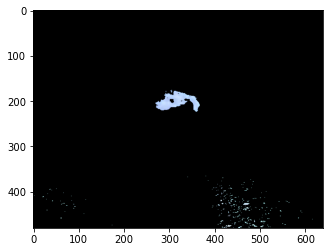

8604 Pixel in Video: 0347.mp4


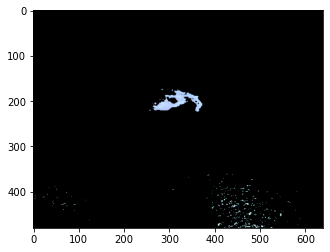

7545 Pixel in Video: 0347.mp4


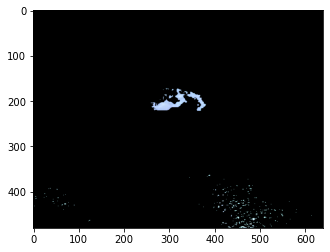

7863 Pixel in Video: 0347.mp4


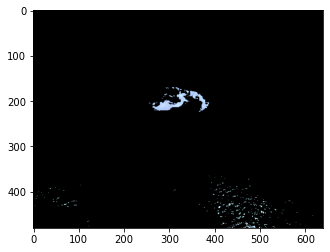

1239 Pixel in Video: 0348.mp4


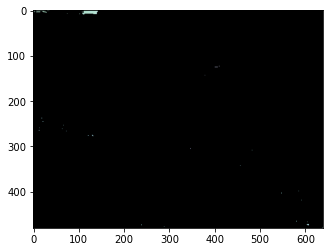

417 Pixel in Video: 0348.mp4


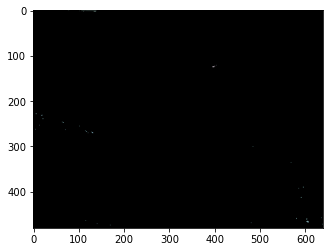

519 Pixel in Video: 0348.mp4


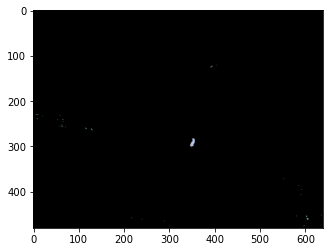

825 Pixel in Video: 0348.mp4


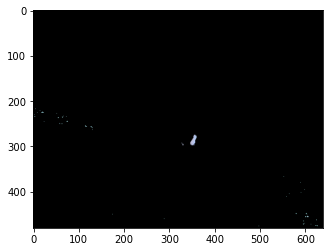

1110 Pixel in Video: 0348.mp4


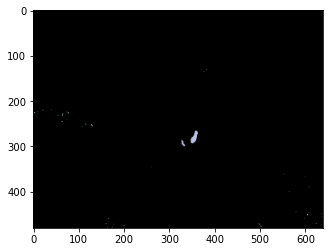

972 Pixel in Video: 0348.mp4


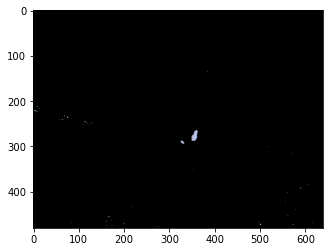

1113 Pixel in Video: 0348.mp4


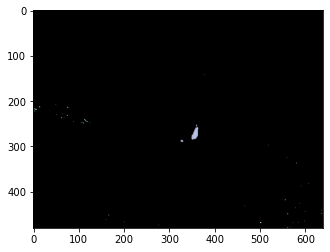

1077 Pixel in Video: 0348.mp4


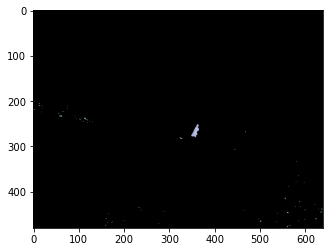

588 Pixel in Video: 0348.mp4


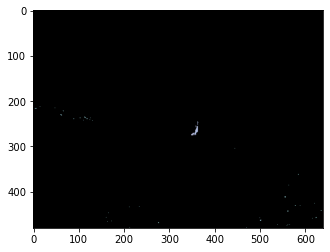

711 Pixel in Video: 0348.mp4


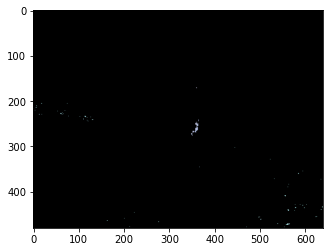

651 Pixel in Video: 0348.mp4


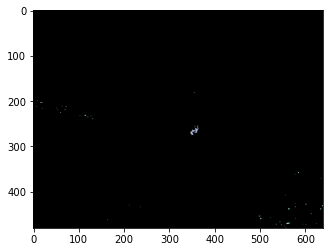

807 Pixel in Video: 0348.mp4


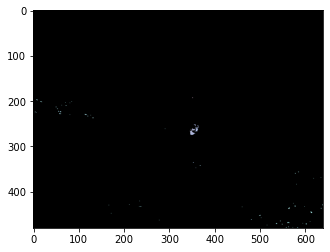

636 Pixel in Video: 0348.mp4


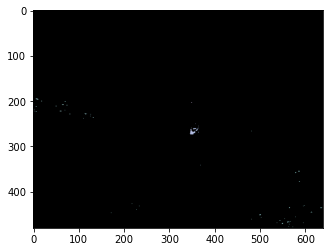

741 Pixel in Video: 0348.mp4


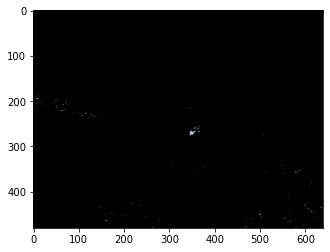

708 Pixel in Video: 0348.mp4


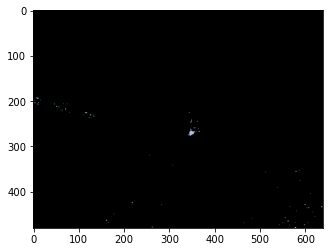

711 Pixel in Video: 0348.mp4


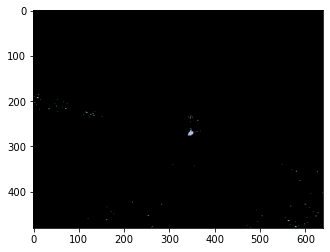

810 Pixel in Video: 0348.mp4


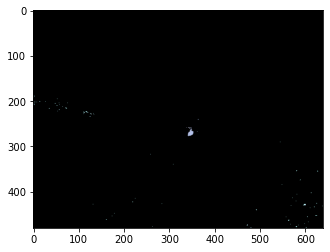

900 Pixel in Video: 0348.mp4


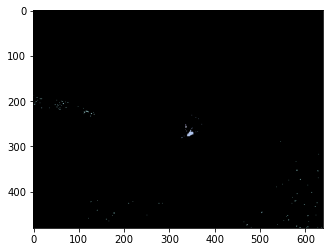

1359 Pixel in Video: 0348.mp4


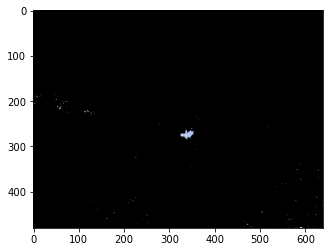

1440 Pixel in Video: 0348.mp4


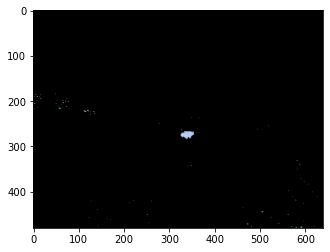

1974 Pixel in Video: 0348.mp4


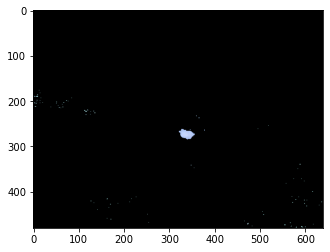

2274 Pixel in Video: 0348.mp4


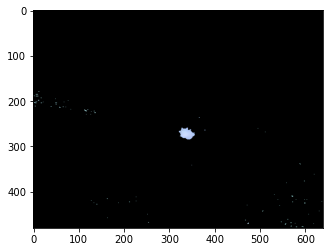

2760 Pixel in Video: 0348.mp4


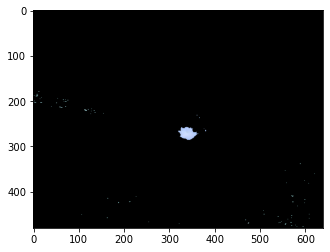

3051 Pixel in Video: 0348.mp4


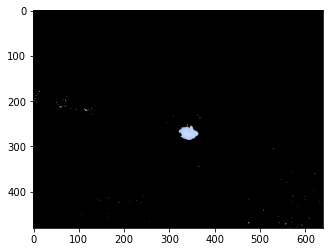

3471 Pixel in Video: 0348.mp4


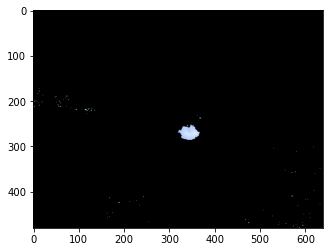

3993 Pixel in Video: 0348.mp4


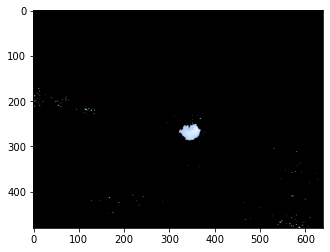

3993 Pixel in Video: 0348.mp4


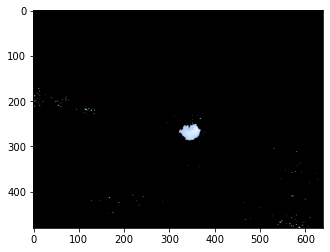

4203 Pixel in Video: 0348.mp4


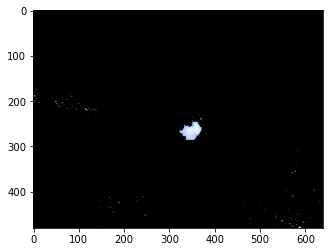

5115 Pixel in Video: 0348.mp4


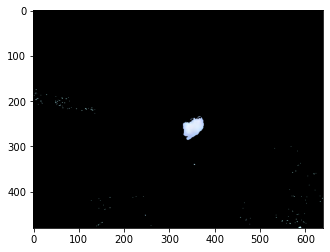

5676 Pixel in Video: 0348.mp4


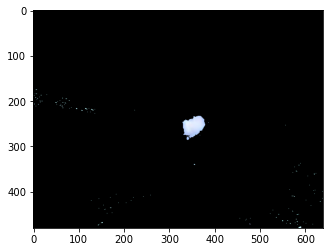

5874 Pixel in Video: 0348.mp4


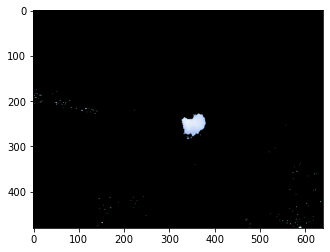

6291 Pixel in Video: 0348.mp4


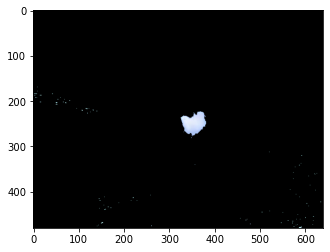

6873 Pixel in Video: 0348.mp4


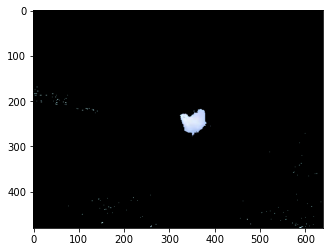

7329 Pixel in Video: 0348.mp4


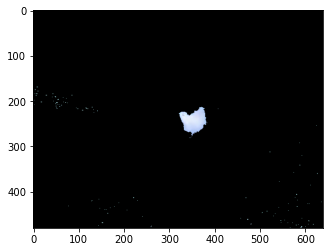

7773 Pixel in Video: 0348.mp4


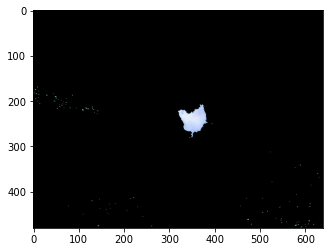

8139 Pixel in Video: 0348.mp4


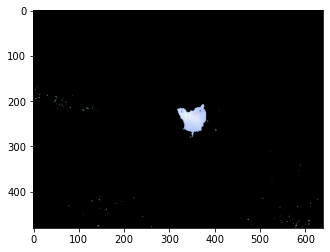

8484 Pixel in Video: 0348.mp4


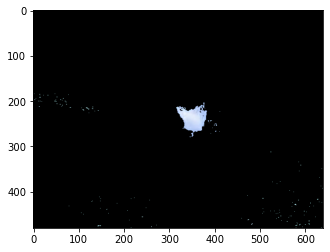

8289 Pixel in Video: 0348.mp4


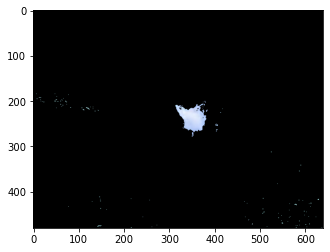

8514 Pixel in Video: 0348.mp4


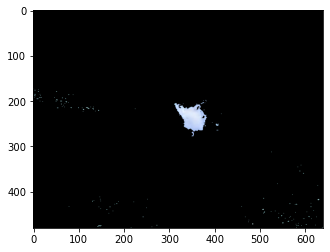

8598 Pixel in Video: 0348.mp4


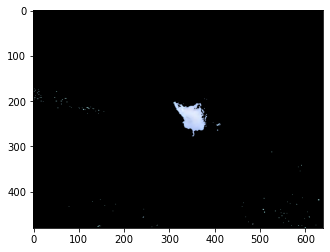

8763 Pixel in Video: 0348.mp4


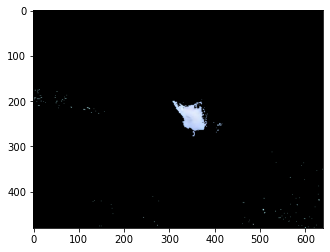

561 Pixel in Video: 0350.mp4


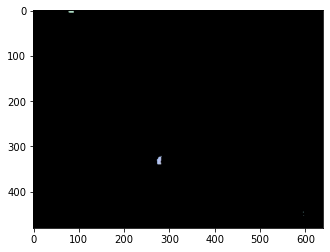

3345 Pixel in Video: 0350.mp4


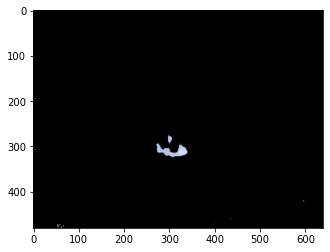

5967 Pixel in Video: 0350.mp4


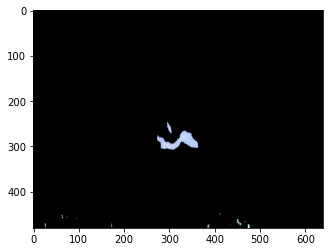

3630 Pixel in Video: 0350.mp4


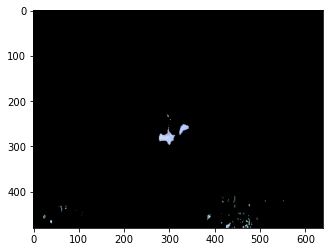

4998 Pixel in Video: 0350.mp4


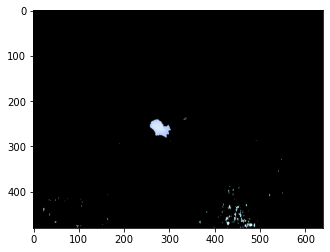

7938 Pixel in Video: 0350.mp4


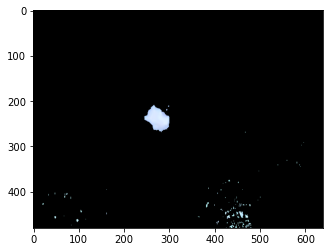

12417 Pixel in Video: 0350.mp4


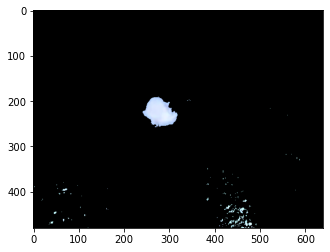

14367 Pixel in Video: 0350.mp4


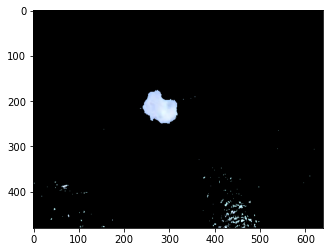

14871 Pixel in Video: 0350.mp4


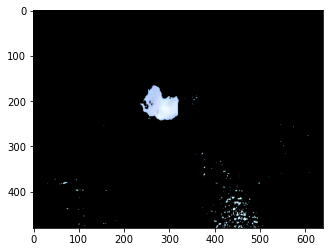

14076 Pixel in Video: 0350.mp4


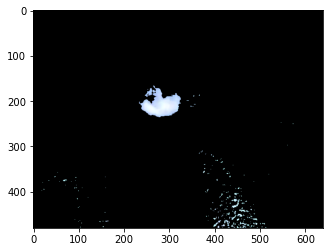

13590 Pixel in Video: 0350.mp4


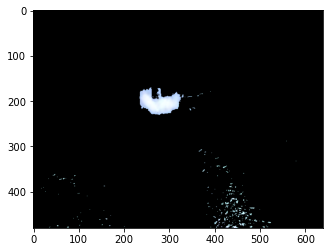

14454 Pixel in Video: 0350.mp4


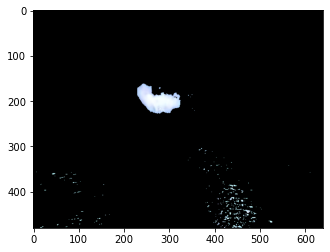

15702 Pixel in Video: 0350.mp4


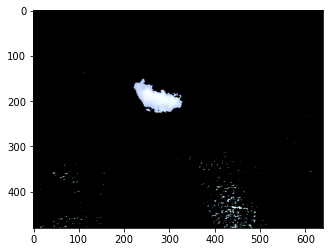

17724 Pixel in Video: 0350.mp4


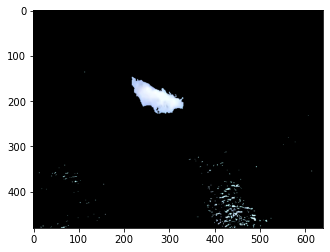

18216 Pixel in Video: 0350.mp4


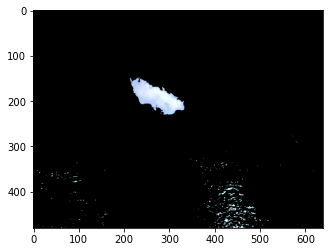

18258 Pixel in Video: 0350.mp4


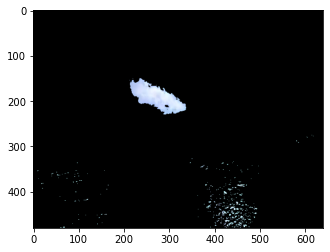

3501 Pixel in Video: 0351.mp4


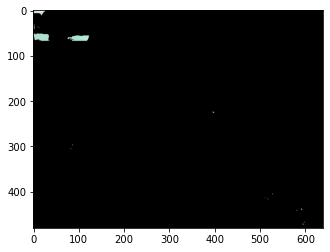

3303 Pixel in Video: 0351.mp4


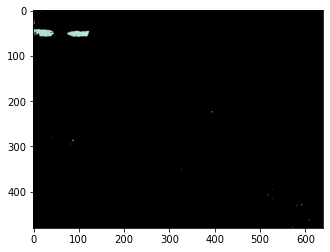

3588 Pixel in Video: 0351.mp4


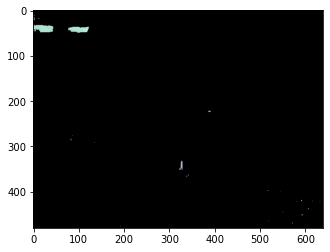

3396 Pixel in Video: 0351.mp4


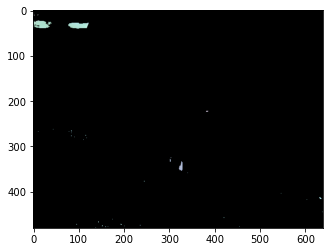

4272 Pixel in Video: 0351.mp4


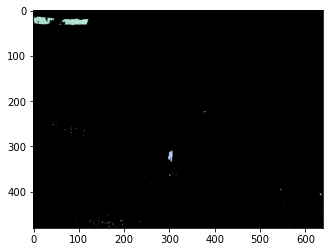

4206 Pixel in Video: 0351.mp4


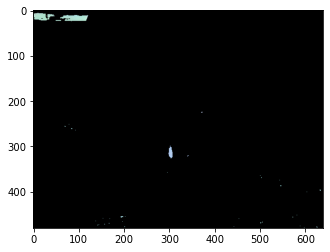

4950 Pixel in Video: 0351.mp4


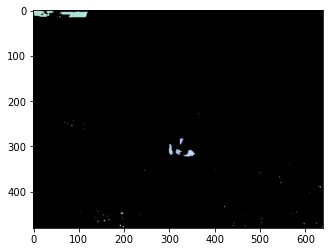

5430 Pixel in Video: 0351.mp4


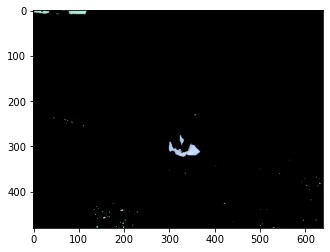

4710 Pixel in Video: 0351.mp4


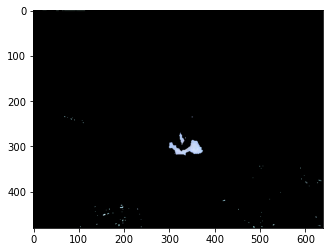

4977 Pixel in Video: 0351.mp4


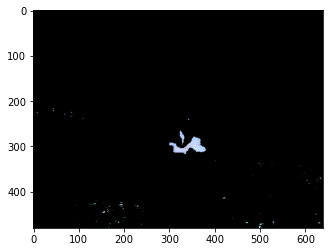

4713 Pixel in Video: 0351.mp4


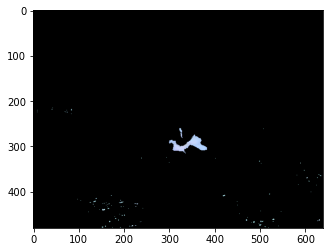

3333 Pixel in Video: 0351.mp4


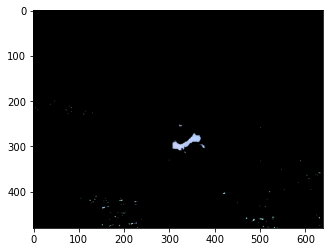

3420 Pixel in Video: 0351.mp4


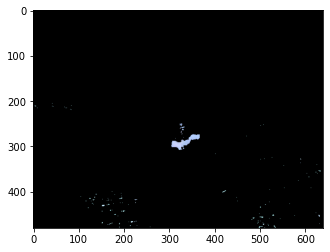

3027 Pixel in Video: 0351.mp4


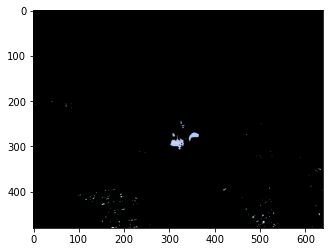

3345 Pixel in Video: 0351.mp4


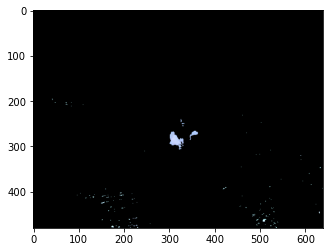

3423 Pixel in Video: 0351.mp4


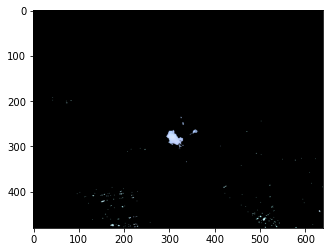

3969 Pixel in Video: 0351.mp4


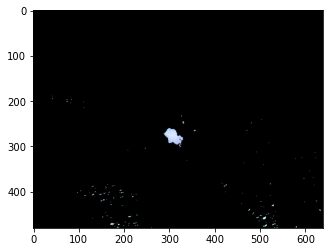

5034 Pixel in Video: 0351.mp4


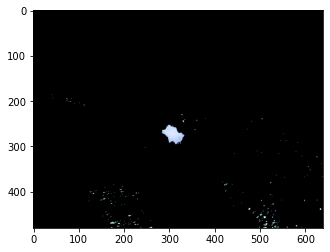

5949 Pixel in Video: 0351.mp4


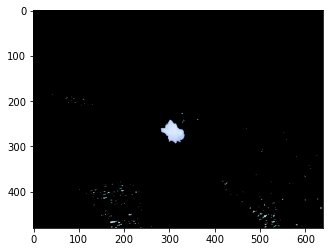

6750 Pixel in Video: 0351.mp4


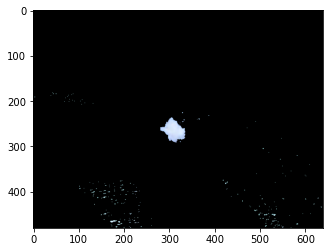

7407 Pixel in Video: 0351.mp4


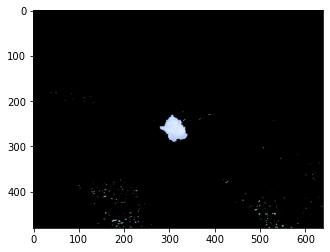

8682 Pixel in Video: 0351.mp4


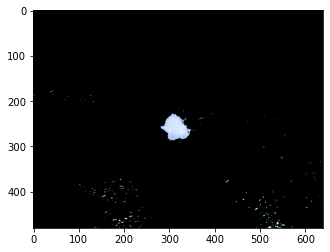

9132 Pixel in Video: 0351.mp4


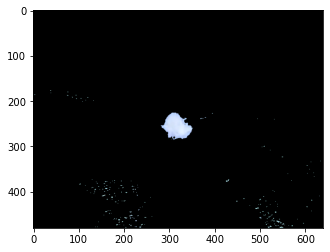

9804 Pixel in Video: 0351.mp4


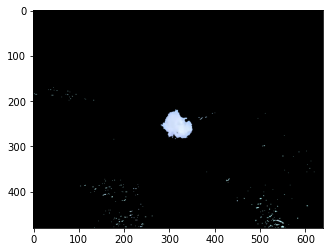

9768 Pixel in Video: 0351.mp4


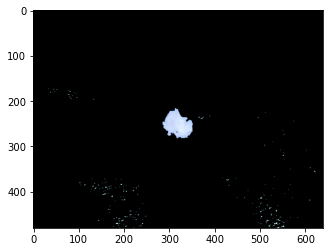

10566 Pixel in Video: 0351.mp4


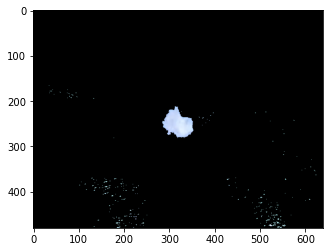

3480 Pixel in Video: 0353.mp4


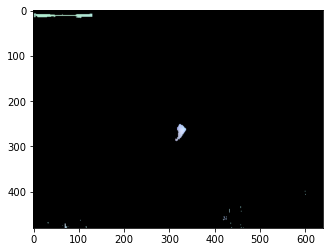

2556 Pixel in Video: 0353.mp4


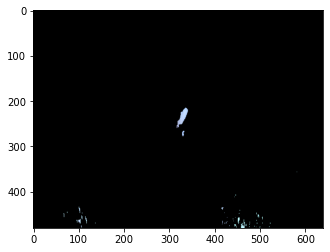

2859 Pixel in Video: 0353.mp4


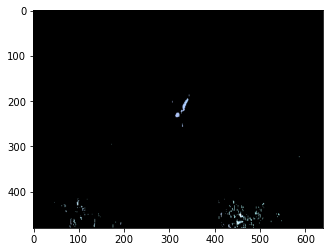

3039 Pixel in Video: 0353.mp4


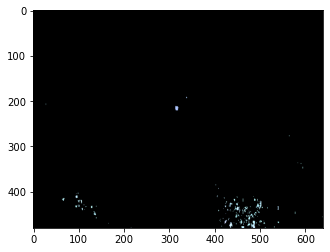

4317 Pixel in Video: 0353.mp4


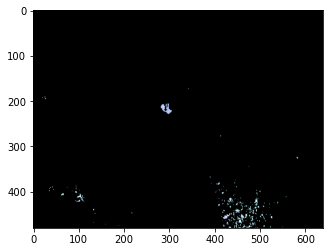

3753 Pixel in Video: 0353.mp4


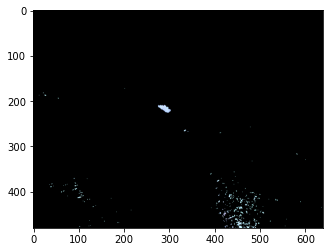

4881 Pixel in Video: 0353.mp4


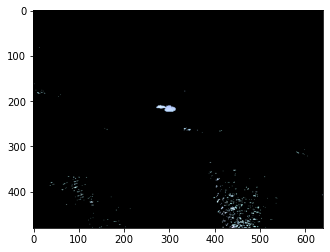

5868 Pixel in Video: 0353.mp4


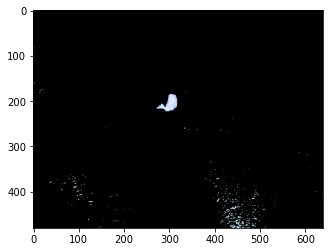

7593 Pixel in Video: 0353.mp4


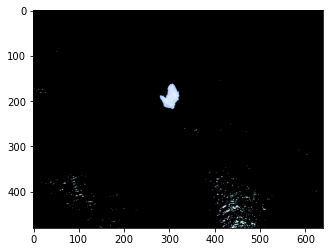

7689 Pixel in Video: 0353.mp4


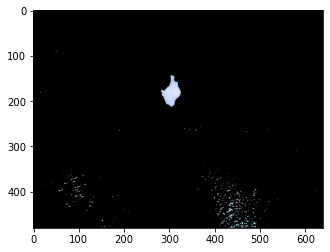

8538 Pixel in Video: 0353.mp4


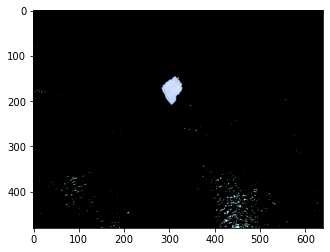

9078 Pixel in Video: 0353.mp4


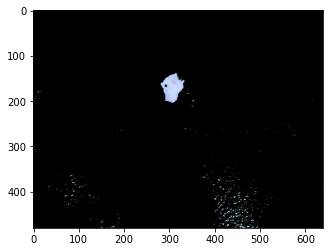

8931 Pixel in Video: 0353.mp4


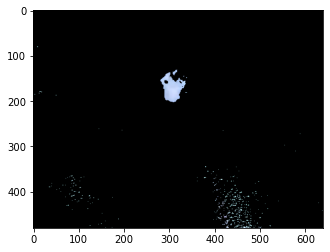

8490 Pixel in Video: 0353.mp4


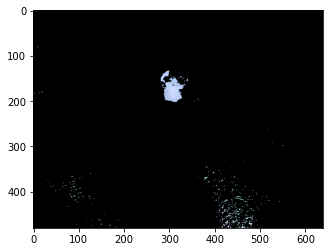

7587 Pixel in Video: 0353.mp4


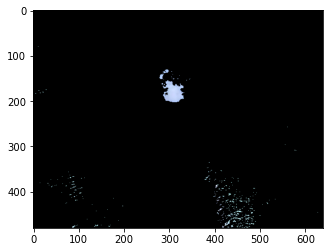

7335 Pixel in Video: 0353.mp4


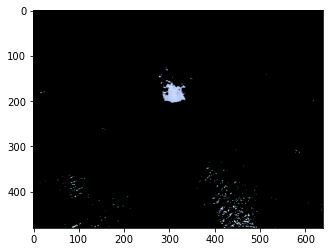

6687 Pixel in Video: 0353.mp4


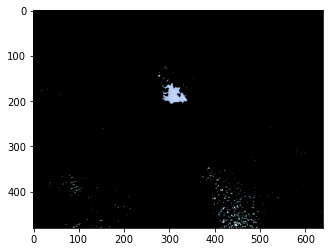

5790 Pixel in Video: 0353.mp4


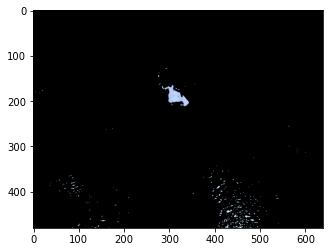

5598 Pixel in Video: 0353.mp4


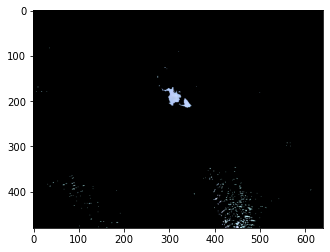

5064 Pixel in Video: 0353.mp4


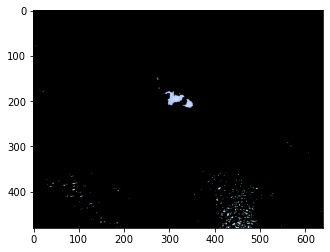

5265 Pixel in Video: 0353.mp4


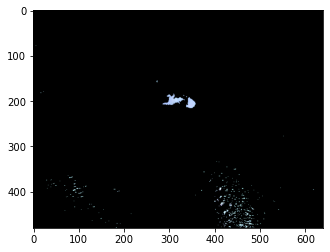

4803 Pixel in Video: 0353.mp4


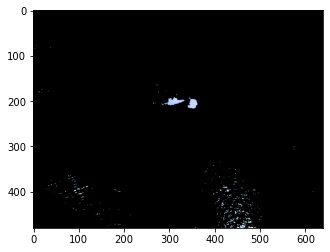

5556 Pixel in Video: 0353.mp4


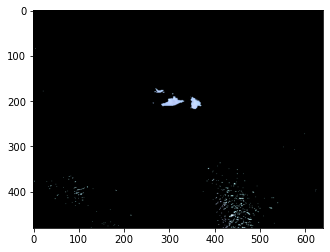

5964 Pixel in Video: 0353.mp4


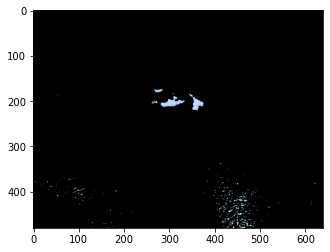

6564 Pixel in Video: 0353.mp4


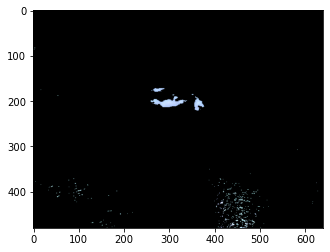

7140 Pixel in Video: 0353.mp4


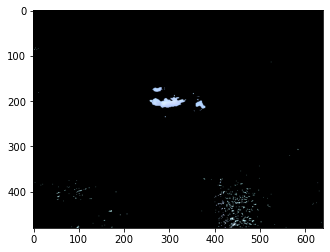

3492 Pixel in Video: 0354.mp4


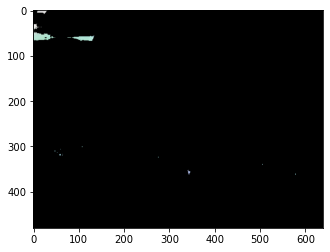

4107 Pixel in Video: 0354.mp4


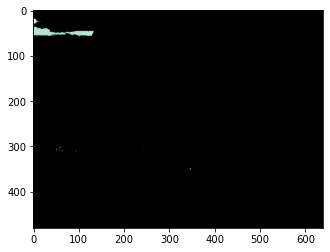

4680 Pixel in Video: 0354.mp4


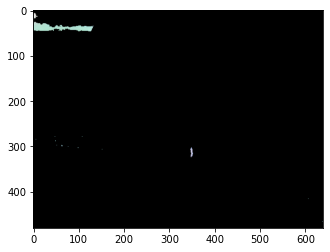

3816 Pixel in Video: 0354.mp4


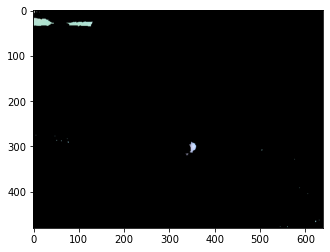

4302 Pixel in Video: 0354.mp4


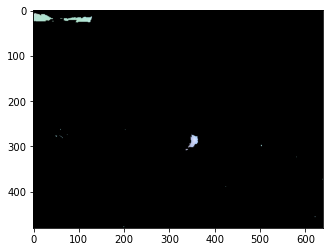

5118 Pixel in Video: 0354.mp4


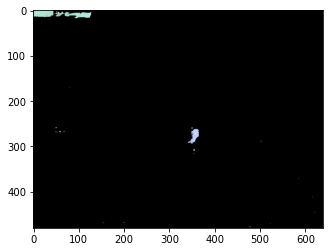

3282 Pixel in Video: 0354.mp4


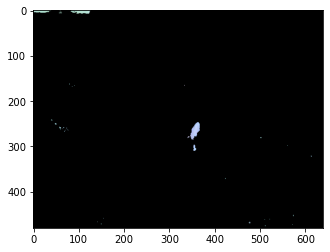

2028 Pixel in Video: 0354.mp4


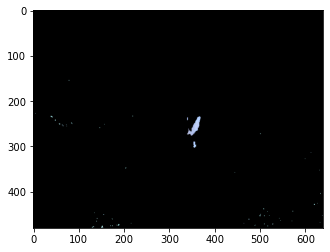

1995 Pixel in Video: 0354.mp4


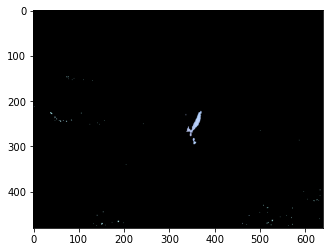

1509 Pixel in Video: 0354.mp4


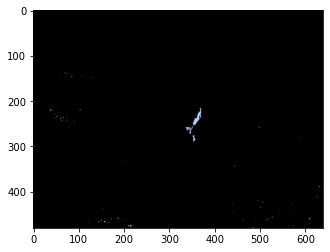

942 Pixel in Video: 0354.mp4


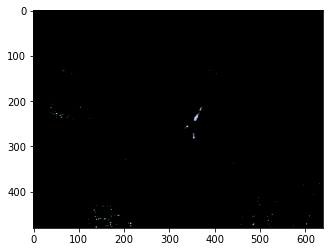

840 Pixel in Video: 0354.mp4


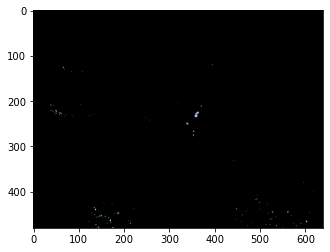

732 Pixel in Video: 0354.mp4


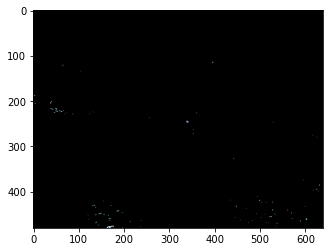

822 Pixel in Video: 0354.mp4


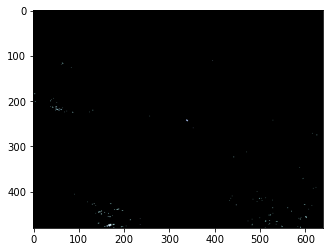

912 Pixel in Video: 0354.mp4


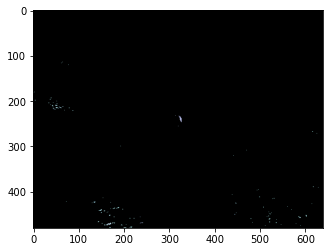

1299 Pixel in Video: 0354.mp4


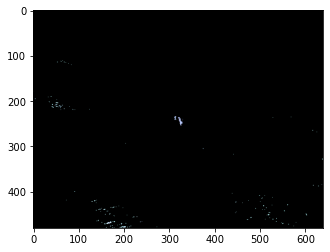

1647 Pixel in Video: 0354.mp4


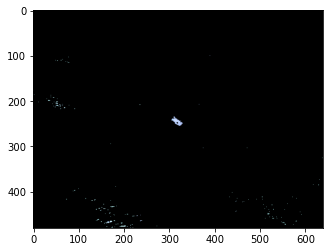

1821 Pixel in Video: 0354.mp4


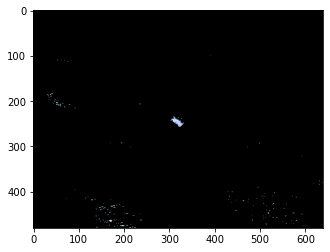

1815 Pixel in Video: 0354.mp4


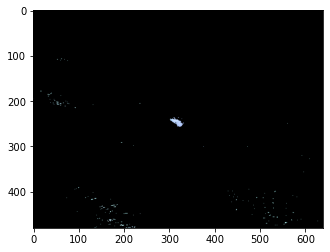

2184 Pixel in Video: 0354.mp4


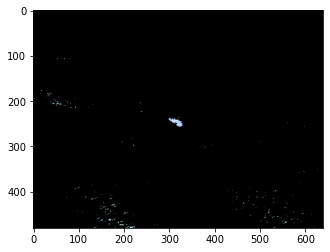

2049 Pixel in Video: 0354.mp4


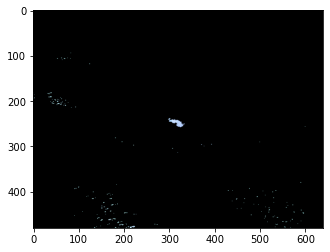

2148 Pixel in Video: 0354.mp4


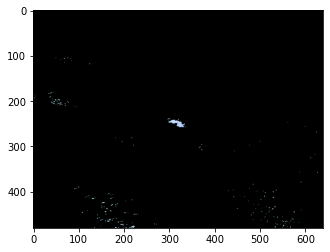

2142 Pixel in Video: 0354.mp4


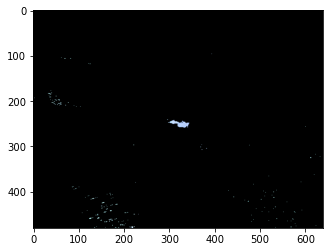

2655 Pixel in Video: 0354.mp4


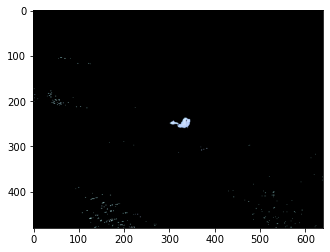

3177 Pixel in Video: 0354.mp4


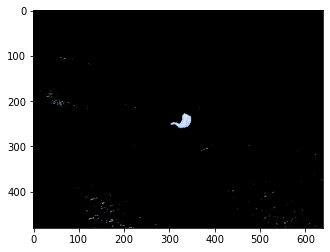

4320 Pixel in Video: 0354.mp4


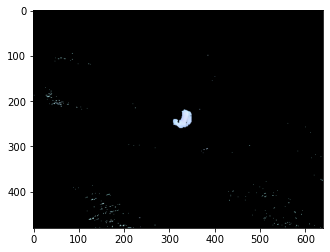

4899 Pixel in Video: 0354.mp4


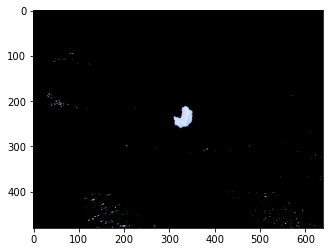

5250 Pixel in Video: 0354.mp4


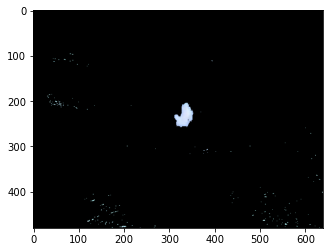

5433 Pixel in Video: 0354.mp4


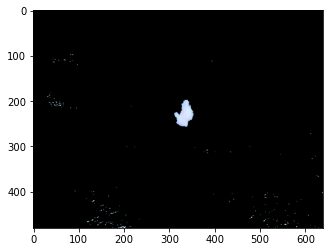

5637 Pixel in Video: 0354.mp4


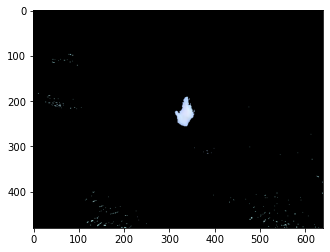

5820 Pixel in Video: 0354.mp4


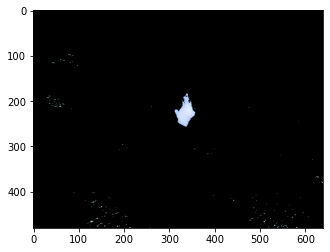

5931 Pixel in Video: 0354.mp4


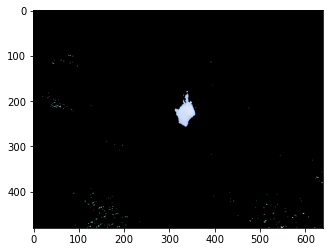

5901 Pixel in Video: 0354.mp4


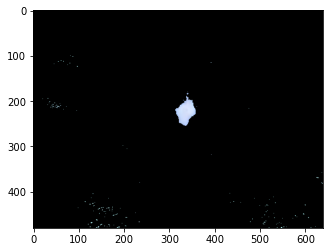

6288 Pixel in Video: 0354.mp4


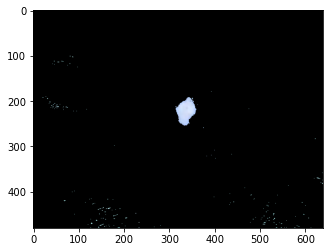

6594 Pixel in Video: 0354.mp4


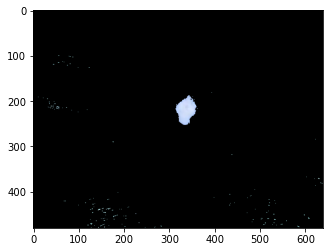

6909 Pixel in Video: 0354.mp4


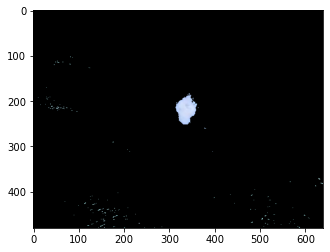

7317 Pixel in Video: 0354.mp4


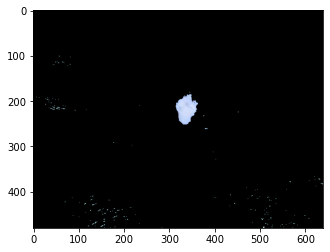

7788 Pixel in Video: 0354.mp4


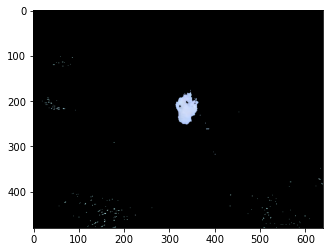

3858 Pixel in Video: 0356.mp4


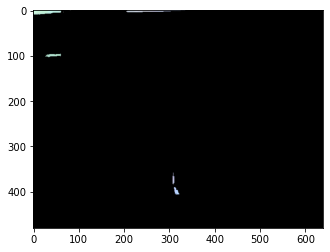

633 Pixel in Video: 0356.mp4


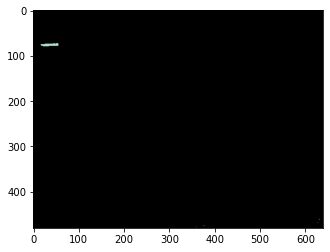

4185 Pixel in Video: 0356.mp4


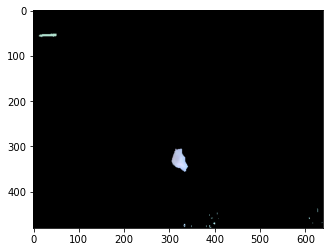

9183 Pixel in Video: 0356.mp4


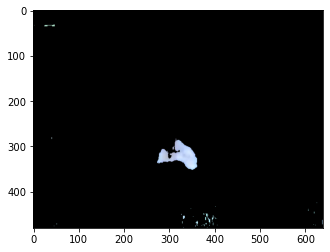

9513 Pixel in Video: 0356.mp4


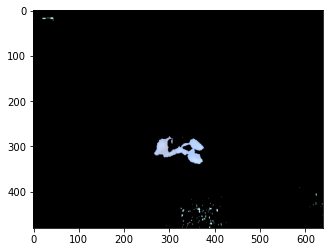

7212 Pixel in Video: 0356.mp4


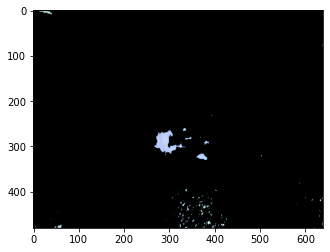

4869 Pixel in Video: 0356.mp4


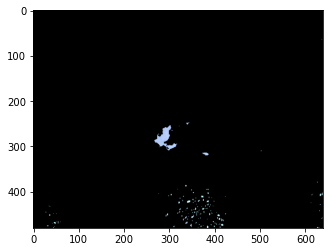

3117 Pixel in Video: 0356.mp4


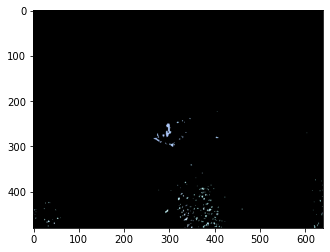

4719 Pixel in Video: 0356.mp4


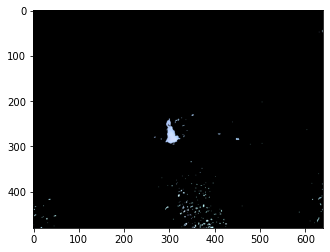

8118 Pixel in Video: 0356.mp4


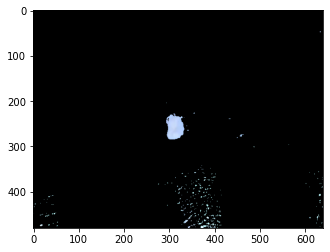

7866 Pixel in Video: 0356.mp4


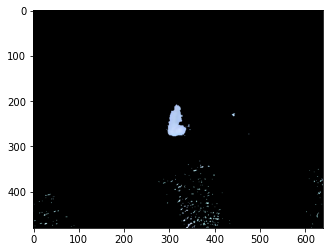

7698 Pixel in Video: 0356.mp4


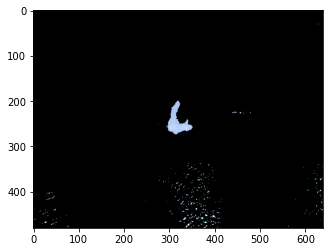

5823 Pixel in Video: 0356.mp4


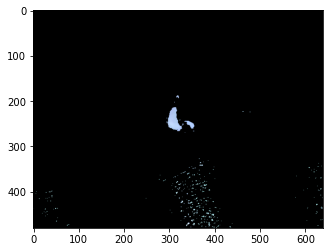

5148 Pixel in Video: 0356.mp4


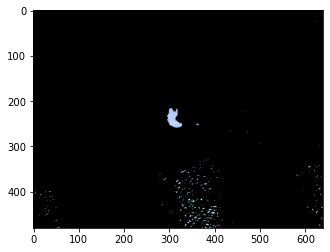

4491 Pixel in Video: 0356.mp4


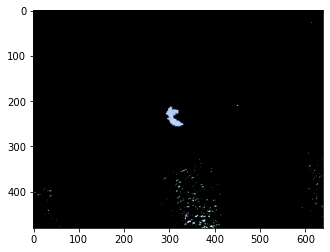

4215 Pixel in Video: 0356.mp4


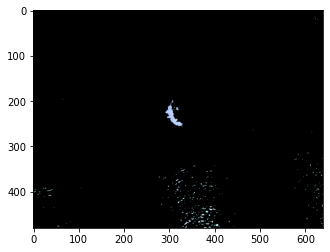

3786 Pixel in Video: 0356.mp4


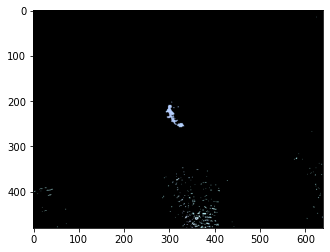

3348 Pixel in Video: 0356.mp4


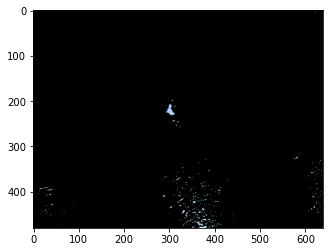

2832 Pixel in Video: 0356.mp4


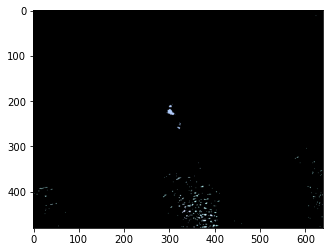

3405 Pixel in Video: 0357.mp4


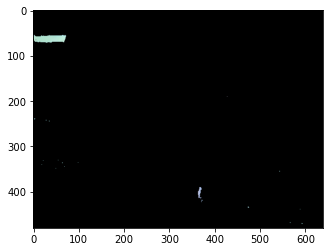

3663 Pixel in Video: 0357.mp4


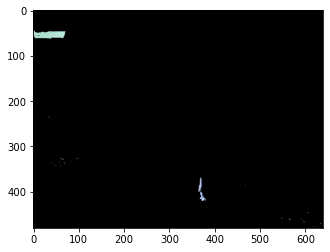

3924 Pixel in Video: 0357.mp4


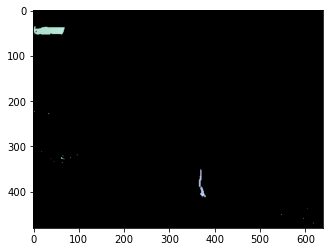

3849 Pixel in Video: 0357.mp4


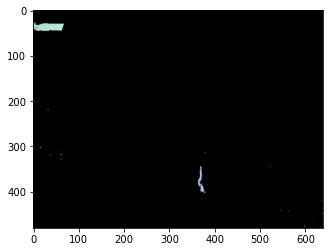

3210 Pixel in Video: 0357.mp4


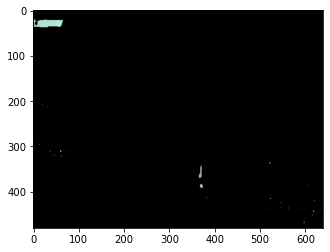

3126 Pixel in Video: 0357.mp4


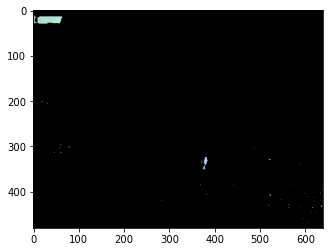

4749 Pixel in Video: 0357.mp4


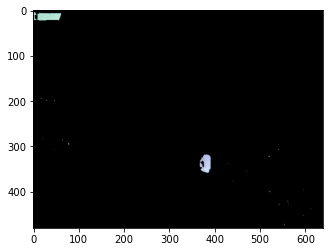

6597 Pixel in Video: 0357.mp4


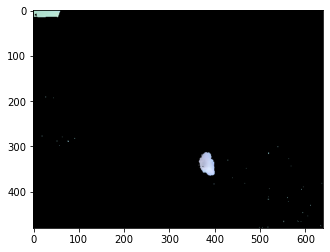

7356 Pixel in Video: 0357.mp4


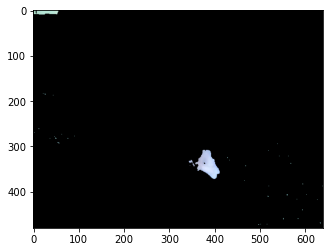

8277 Pixel in Video: 0357.mp4


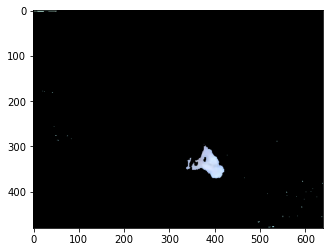

10299 Pixel in Video: 0357.mp4


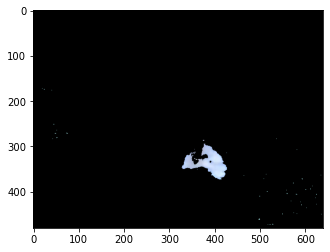

12108 Pixel in Video: 0357.mp4


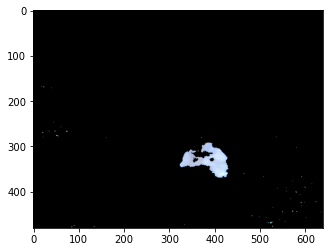

12930 Pixel in Video: 0357.mp4


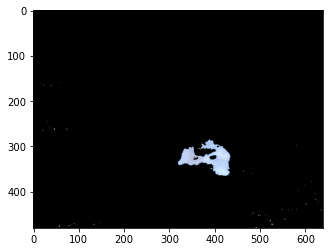

13215 Pixel in Video: 0357.mp4


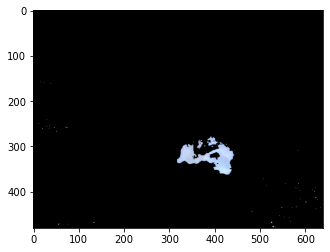

11778 Pixel in Video: 0357.mp4


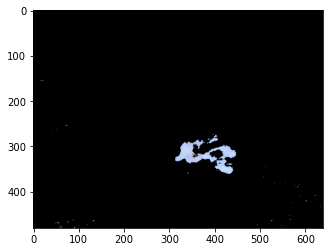

10233 Pixel in Video: 0357.mp4


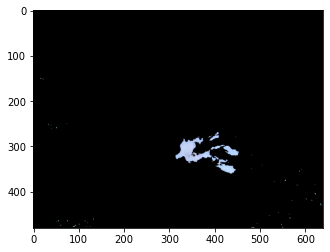

8967 Pixel in Video: 0357.mp4


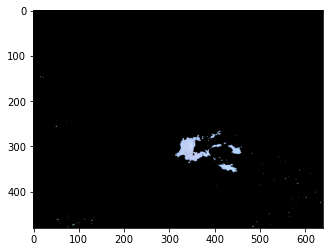

8250 Pixel in Video: 0357.mp4


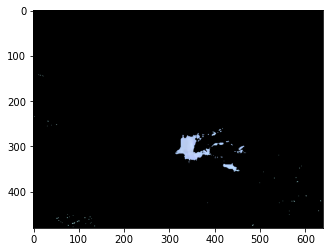

6849 Pixel in Video: 0357.mp4


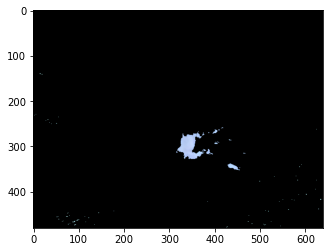

6519 Pixel in Video: 0357.mp4


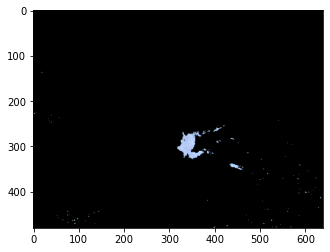

5460 Pixel in Video: 0357.mp4


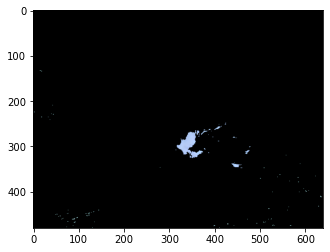

4275 Pixel in Video: 0357.mp4


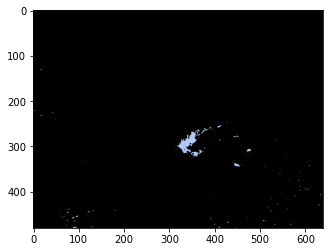

3870 Pixel in Video: 0357.mp4


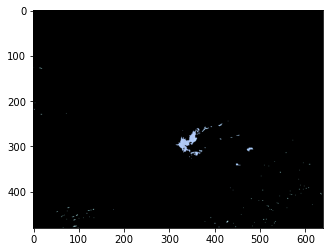

2697 Pixel in Video: 0357.mp4


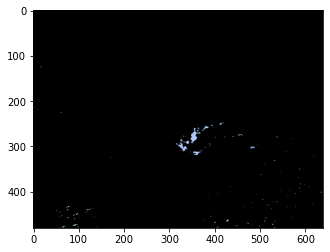

2508 Pixel in Video: 0357.mp4


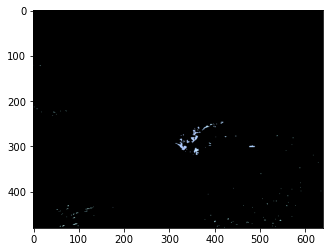

3501 Pixel in Video: 0357.mp4


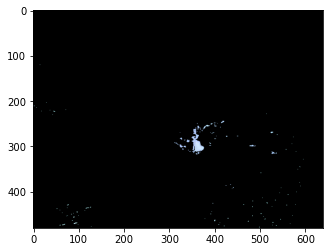

4827 Pixel in Video: 0357.mp4


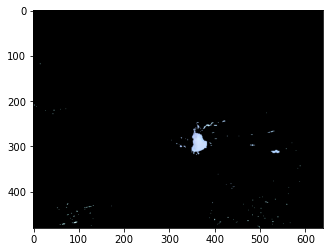

6078 Pixel in Video: 0357.mp4


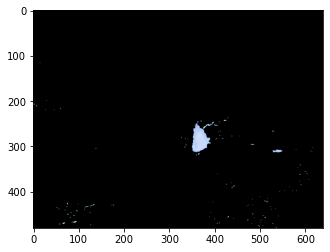

7026 Pixel in Video: 0357.mp4


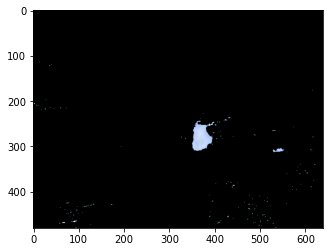

7491 Pixel in Video: 0357.mp4


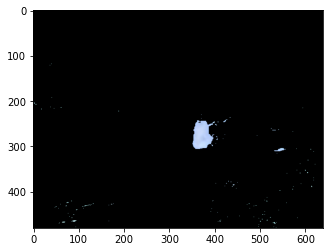

8274 Pixel in Video: 0357.mp4


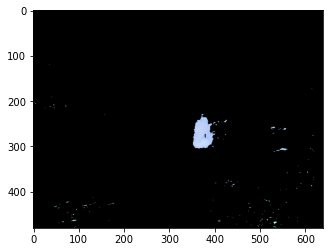

31791 Pixel in Video: 0358.mp4


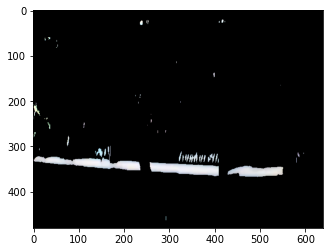

30513 Pixel in Video: 0358.mp4


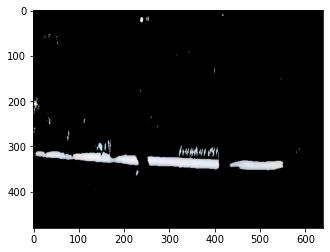

29052 Pixel in Video: 0358.mp4


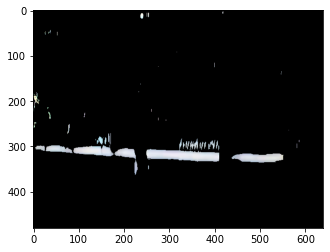

26271 Pixel in Video: 0358.mp4


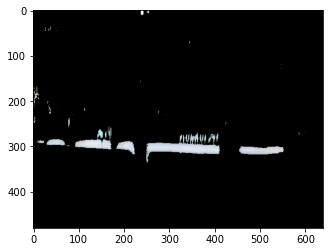

24687 Pixel in Video: 0358.mp4


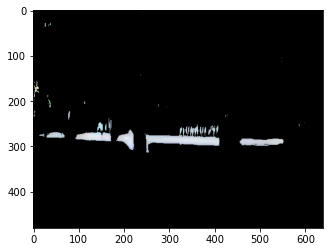

23877 Pixel in Video: 0358.mp4


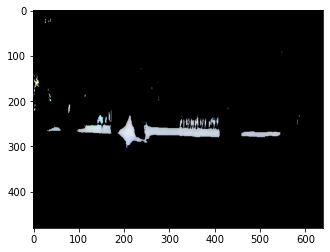

22590 Pixel in Video: 0358.mp4


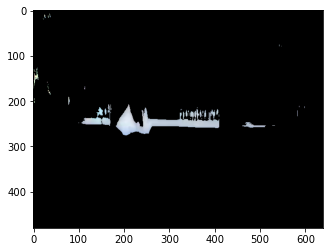

7590 Pixel in Video: 0358.mp4


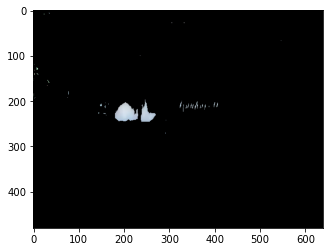

9489 Pixel in Video: 0358.mp4


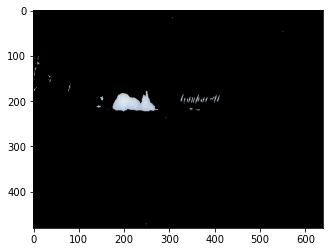

1533 Pixel in Video: 0358.mp4


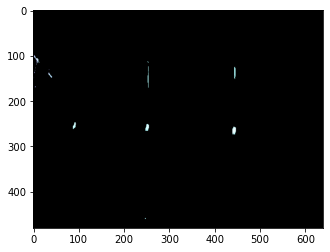

1053 Pixel in Video: 0358.mp4


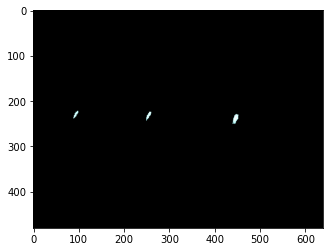

906 Pixel in Video: 0358.mp4


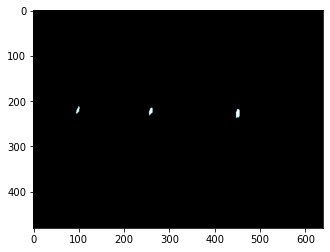

987 Pixel in Video: 0358.mp4


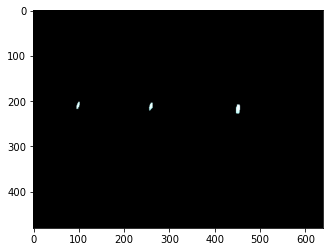

918 Pixel in Video: 0358.mp4


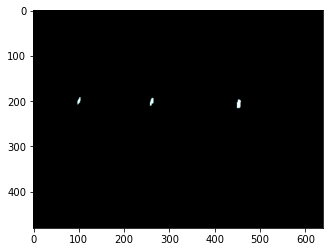

1122 Pixel in Video: 0358.mp4


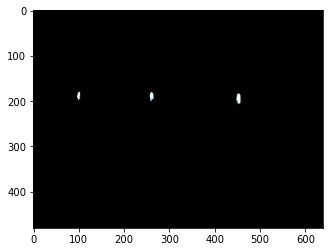

1026 Pixel in Video: 0358.mp4


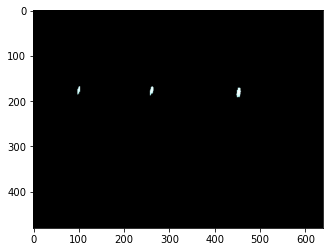

993 Pixel in Video: 0358.mp4


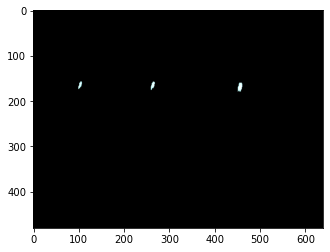

1149 Pixel in Video: 0358.mp4


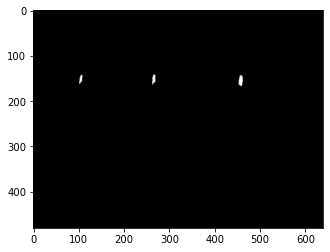

1050 Pixel in Video: 0358.mp4


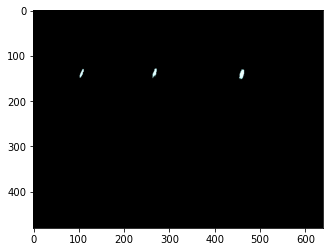

1101 Pixel in Video: 0358.mp4


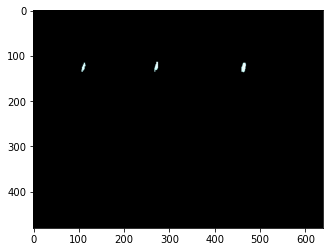

1122 Pixel in Video: 0358.mp4


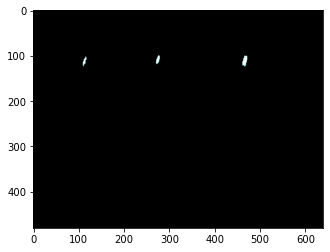

1032 Pixel in Video: 0358.mp4


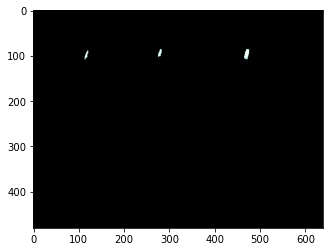

1032 Pixel in Video: 0358.mp4


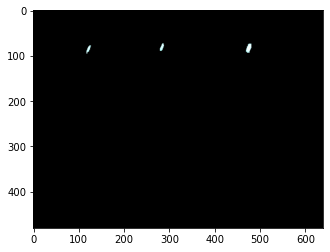

924 Pixel in Video: 0358.mp4


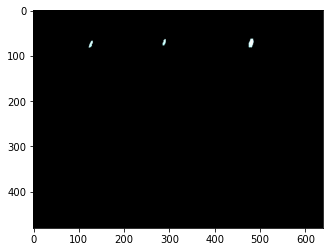

984 Pixel in Video: 0358.mp4


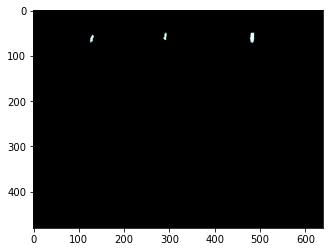

810 Pixel in Video: 0358.mp4


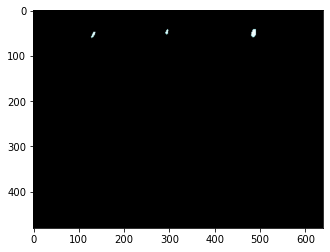

28557 Pixel in Video: 0359.mp4


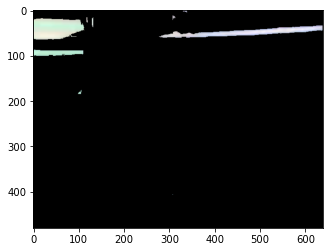

25665 Pixel in Video: 0359.mp4


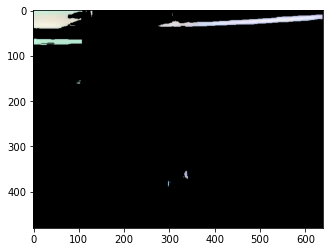

17046 Pixel in Video: 0359.mp4


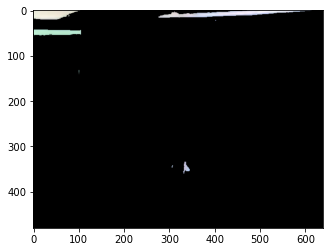

6213 Pixel in Video: 0359.mp4


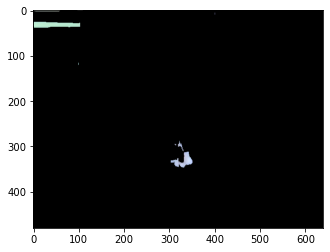

6924 Pixel in Video: 0359.mp4


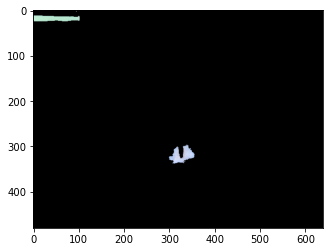

6519 Pixel in Video: 0359.mp4


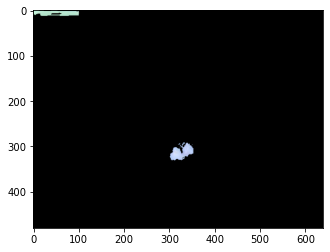

3357 Pixel in Video: 0359.mp4


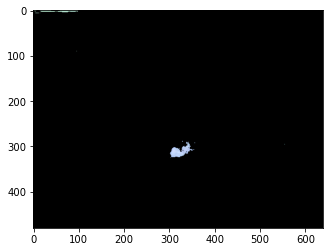

1992 Pixel in Video: 0359.mp4


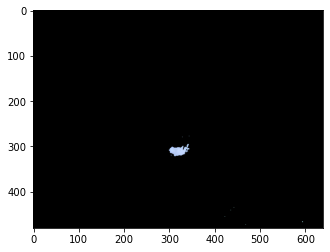

2451 Pixel in Video: 0359.mp4


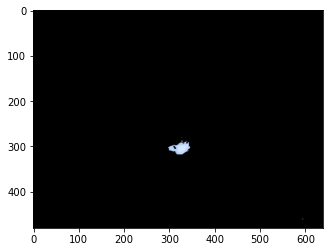

3660 Pixel in Video: 0359.mp4


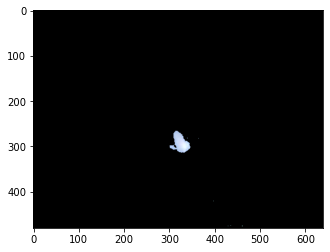

4941 Pixel in Video: 0359.mp4


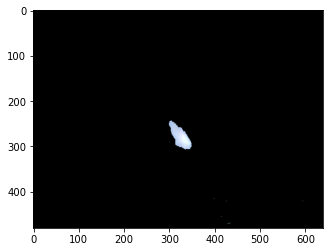

4944 Pixel in Video: 0359.mp4


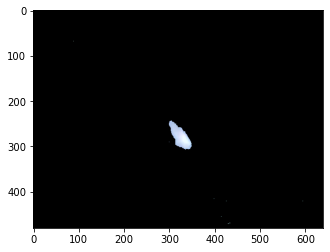

6348 Pixel in Video: 0359.mp4


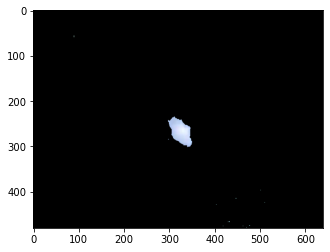

8376 Pixel in Video: 0359.mp4


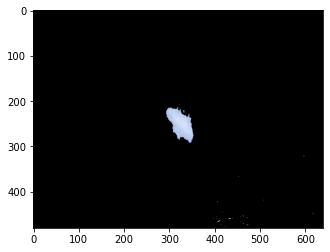

8928 Pixel in Video: 0359.mp4


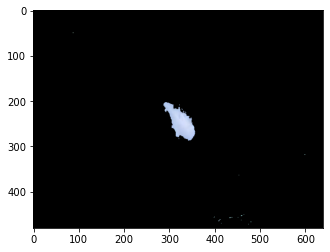

87 Pixel in Video: 0360.mp4


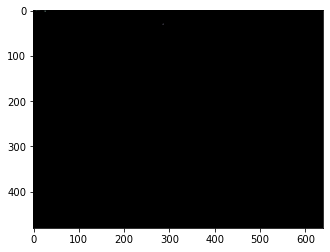

12 Pixel in Video: 0360.mp4


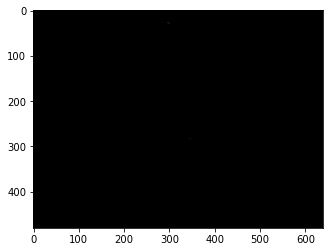

87 Pixel in Video: 0360.mp4


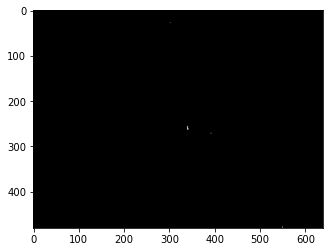

198 Pixel in Video: 0360.mp4


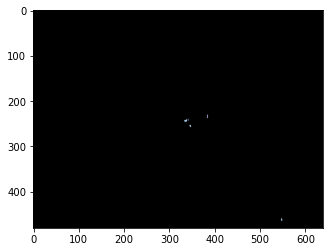

252 Pixel in Video: 0360.mp4


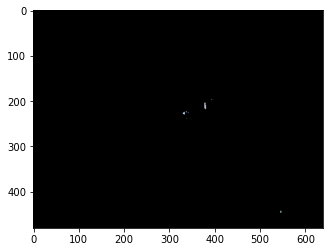

714 Pixel in Video: 0360.mp4


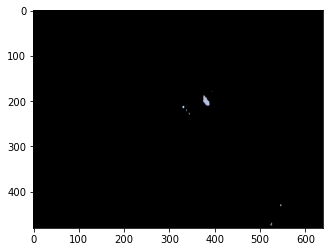

678 Pixel in Video: 0360.mp4


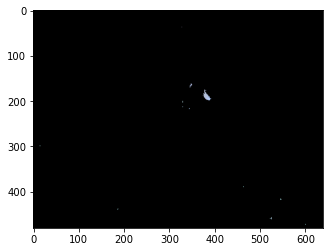

696 Pixel in Video: 0360.mp4


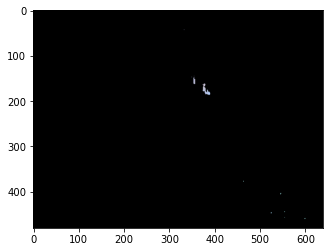

1887 Pixel in Video: 0360.mp4


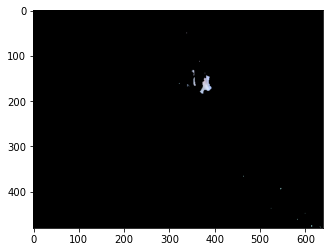

3381 Pixel in Video: 0360.mp4


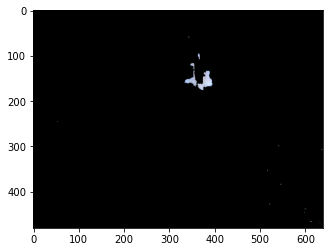

4200 Pixel in Video: 0360.mp4


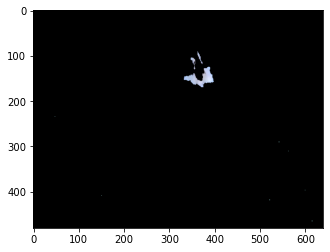

5271 Pixel in Video: 0360.mp4


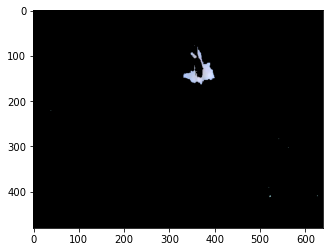

6024 Pixel in Video: 0360.mp4


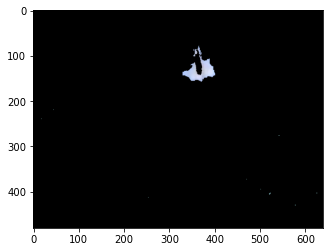

6588 Pixel in Video: 0360.mp4


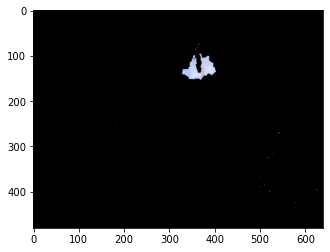

6888 Pixel in Video: 0360.mp4


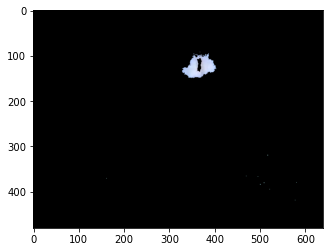

7482 Pixel in Video: 0360.mp4


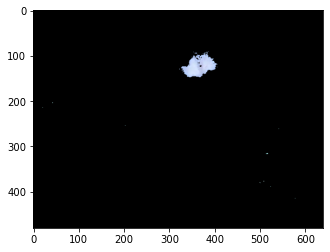

7026 Pixel in Video: 0360.mp4


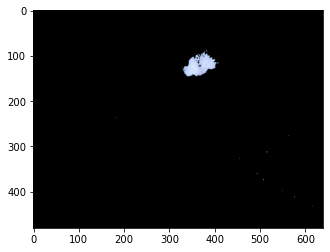

6690 Pixel in Video: 0360.mp4


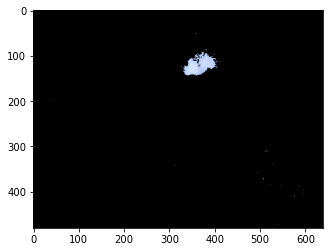

6057 Pixel in Video: 0360.mp4


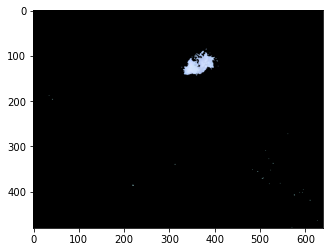

2841 Pixel in Video: 0366.mp4


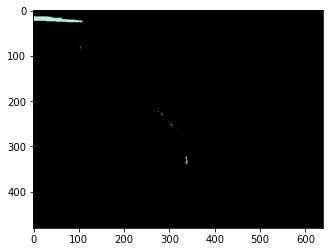

1059 Pixel in Video: 0366.mp4


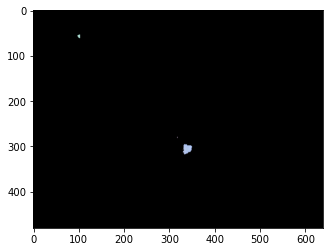

2661 Pixel in Video: 0366.mp4


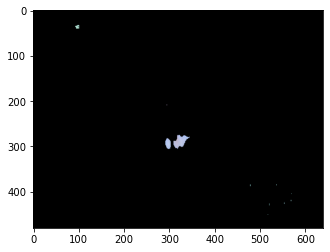

2916 Pixel in Video: 0366.mp4


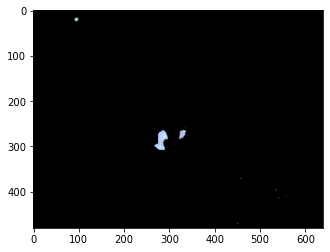

3819 Pixel in Video: 0366.mp4


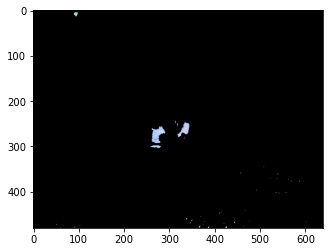

4533 Pixel in Video: 0366.mp4


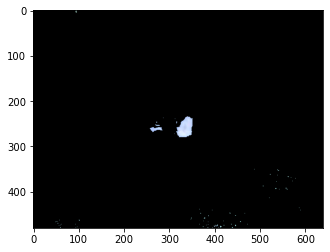

5283 Pixel in Video: 0366.mp4


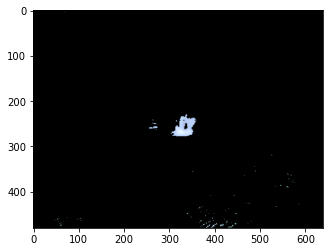

4488 Pixel in Video: 0366.mp4


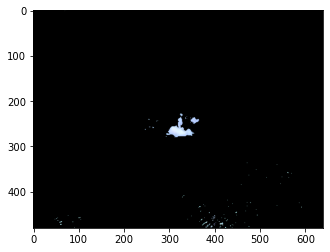

5145 Pixel in Video: 0366.mp4


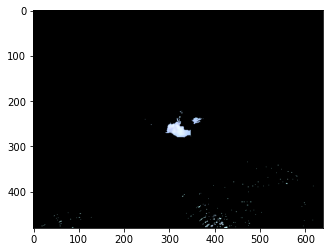

6474 Pixel in Video: 0366.mp4


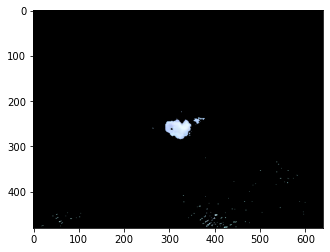

7146 Pixel in Video: 0366.mp4


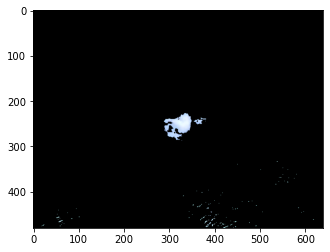

6009 Pixel in Video: 0366.mp4


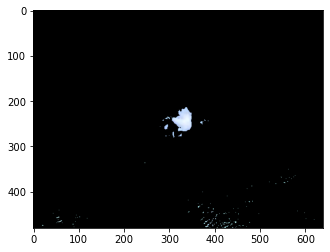

24900 Pixel in Video: 0367.mp4


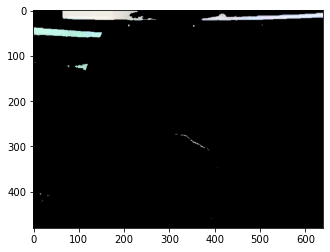

17013 Pixel in Video: 0367.mp4


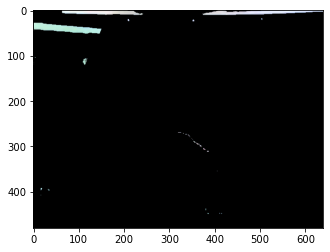

7185 Pixel in Video: 0367.mp4


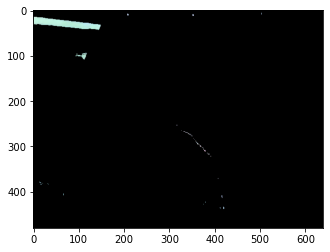

7779 Pixel in Video: 0367.mp4


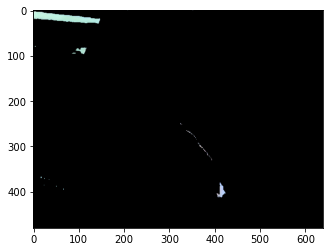

4992 Pixel in Video: 0367.mp4


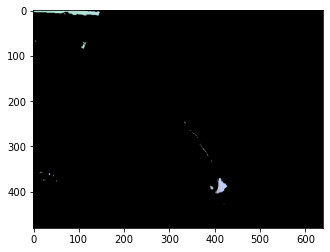

2856 Pixel in Video: 0367.mp4


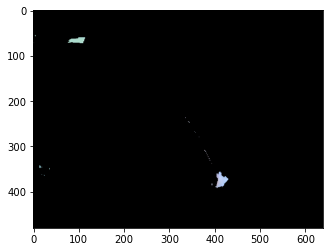

2244 Pixel in Video: 0367.mp4


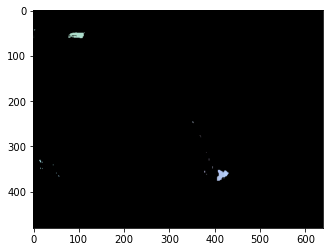

2448 Pixel in Video: 0367.mp4


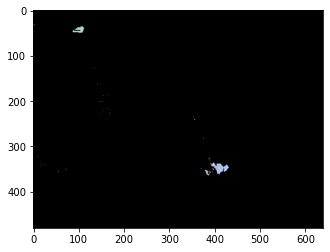

4065 Pixel in Video: 0367.mp4


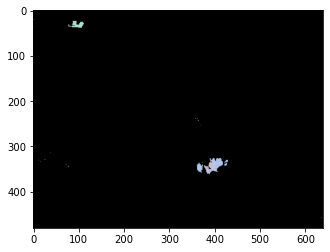

3807 Pixel in Video: 0367.mp4


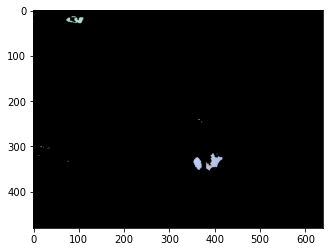

3504 Pixel in Video: 0367.mp4


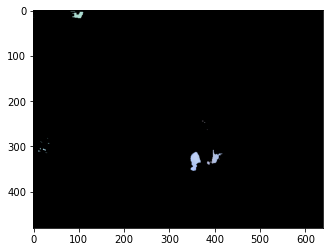

4302 Pixel in Video: 0367.mp4


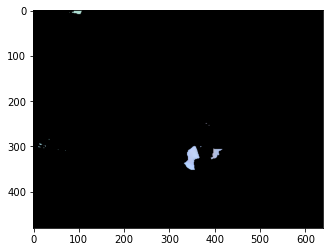

4386 Pixel in Video: 0367.mp4


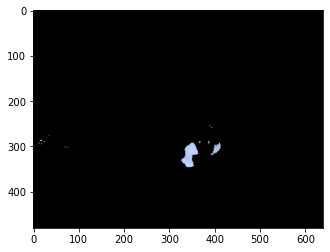

4839 Pixel in Video: 0367.mp4


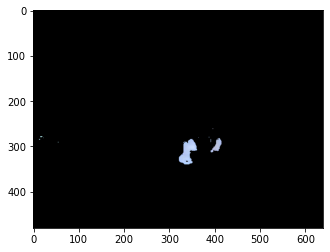

4938 Pixel in Video: 0367.mp4


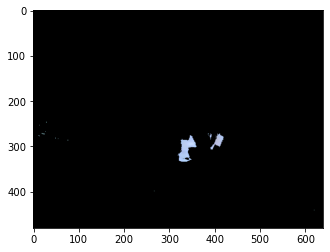

4989 Pixel in Video: 0367.mp4


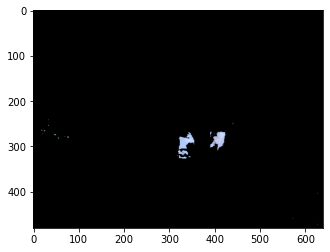

4917 Pixel in Video: 0367.mp4


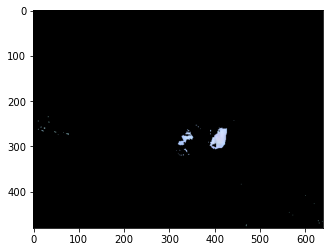

5382 Pixel in Video: 0367.mp4


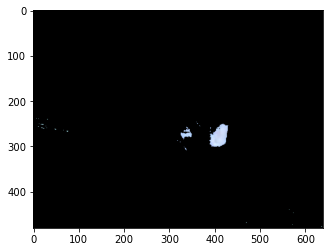

5823 Pixel in Video: 0367.mp4


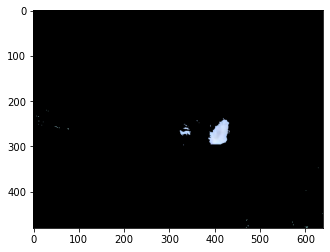

1008 Pixel in Video: 0369.mp4


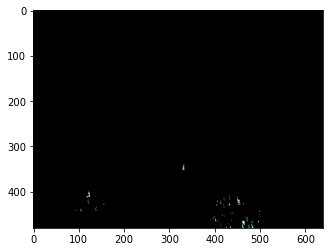

1689 Pixel in Video: 0369.mp4


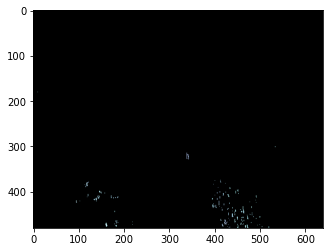

3588 Pixel in Video: 0369.mp4


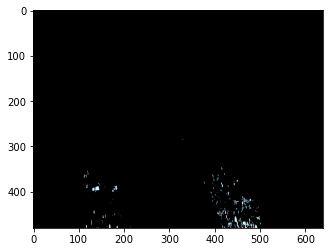

4428 Pixel in Video: 0369.mp4


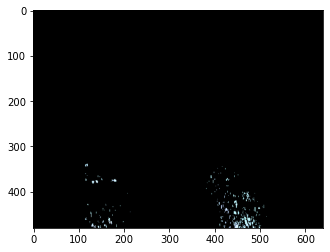

6060 Pixel in Video: 0369.mp4


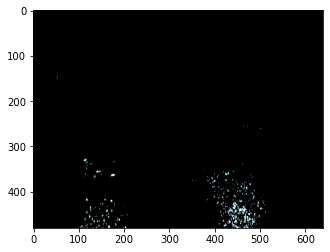

7968 Pixel in Video: 0369.mp4


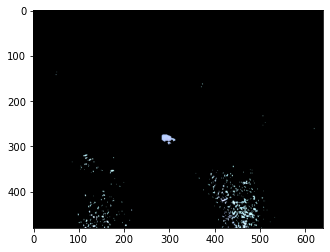

9261 Pixel in Video: 0369.mp4


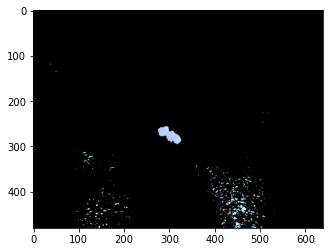

9183 Pixel in Video: 0369.mp4


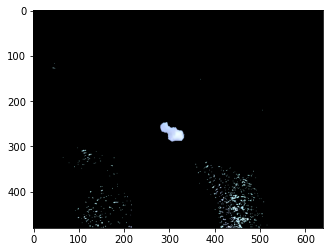

9858 Pixel in Video: 0369.mp4


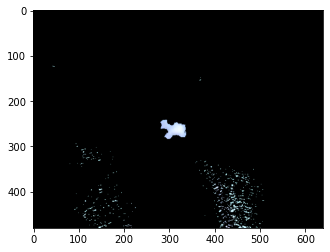

9618 Pixel in Video: 0369.mp4


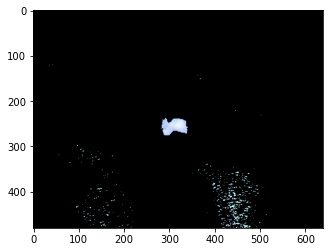

9549 Pixel in Video: 0369.mp4


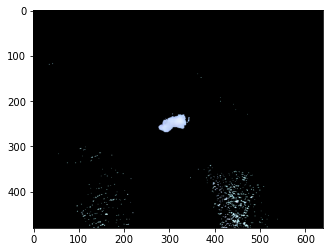

9234 Pixel in Video: 0369.mp4


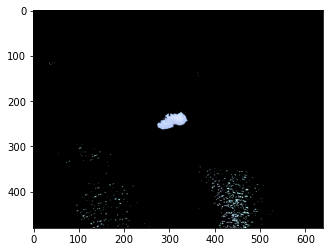

9846 Pixel in Video: 0369.mp4


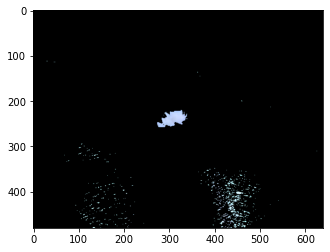

9108 Pixel in Video: 0369.mp4


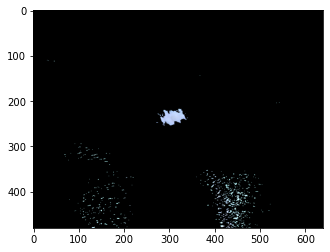

9189 Pixel in Video: 0369.mp4


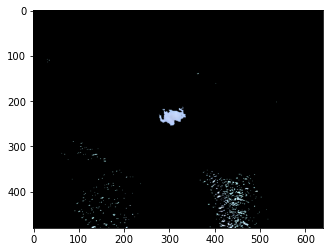

8937 Pixel in Video: 0369.mp4


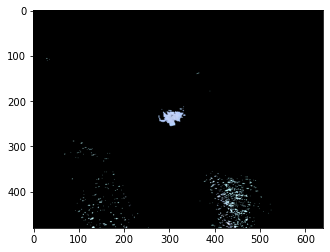

7944 Pixel in Video: 0369.mp4


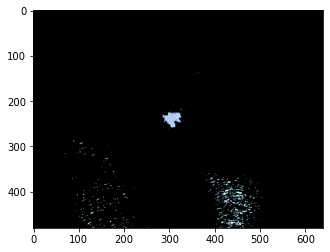

7197 Pixel in Video: 0369.mp4


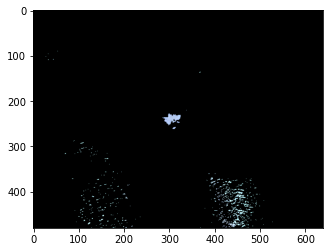

5817 Pixel in Video: 0369.mp4


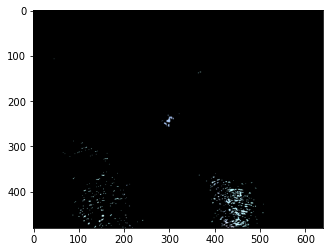

5475 Pixel in Video: 0369.mp4


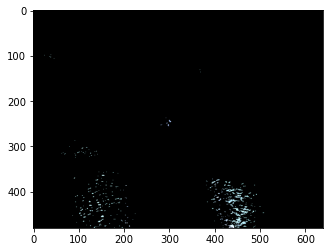

5199 Pixel in Video: 0369.mp4


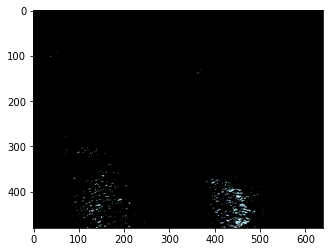

3528 Pixel in Video: 0370.mp4


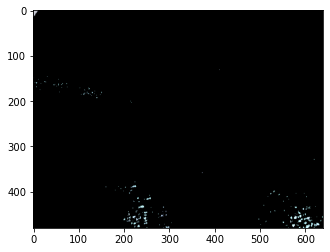

3765 Pixel in Video: 0370.mp4


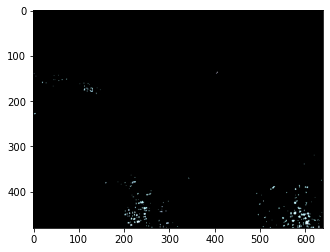

4278 Pixel in Video: 0370.mp4


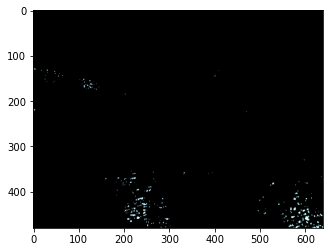

4821 Pixel in Video: 0370.mp4


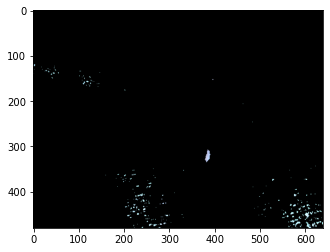

6207 Pixel in Video: 0370.mp4


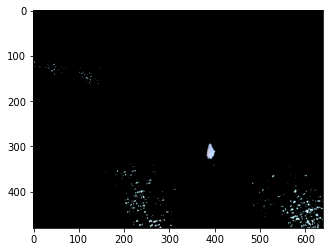

6672 Pixel in Video: 0370.mp4


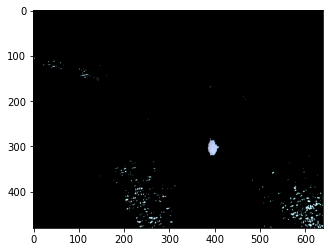

6582 Pixel in Video: 0370.mp4


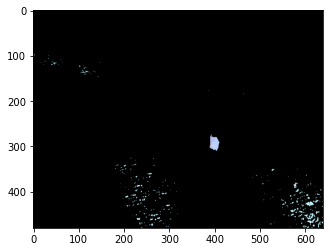

7218 Pixel in Video: 0370.mp4


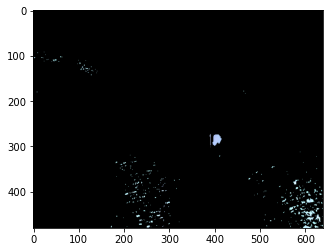

7128 Pixel in Video: 0370.mp4


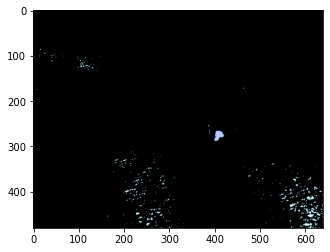

7083 Pixel in Video: 0370.mp4


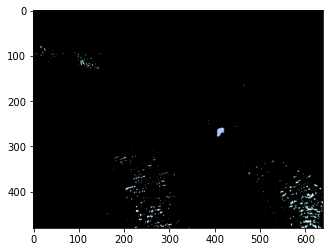

6207 Pixel in Video: 0370.mp4


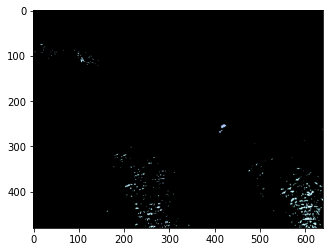

6294 Pixel in Video: 0370.mp4


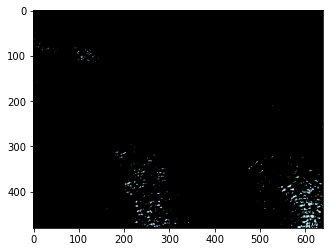

5886 Pixel in Video: 0370.mp4


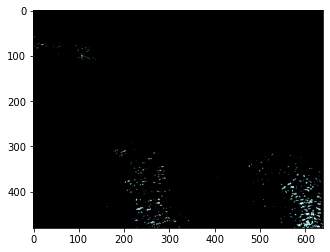

6291 Pixel in Video: 0370.mp4


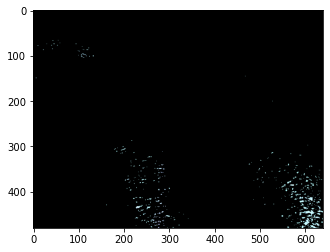

6246 Pixel in Video: 0370.mp4


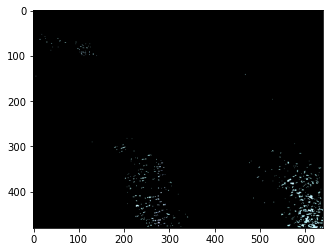

6627 Pixel in Video: 0370.mp4


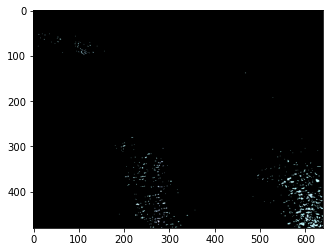

6735 Pixel in Video: 0370.mp4


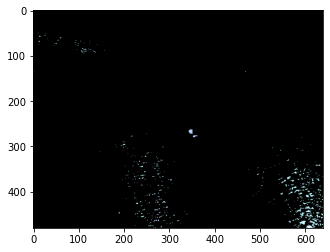

8433 Pixel in Video: 0370.mp4


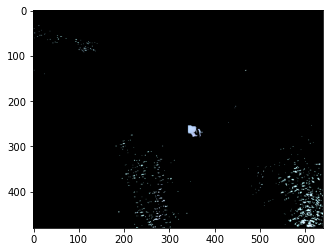

8844 Pixel in Video: 0370.mp4


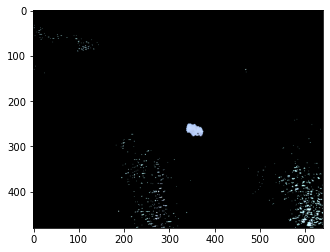

10785 Pixel in Video: 0370.mp4


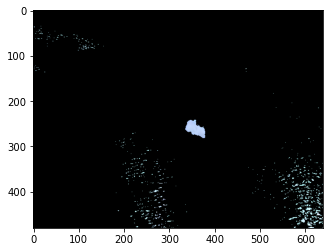

10398 Pixel in Video: 0370.mp4


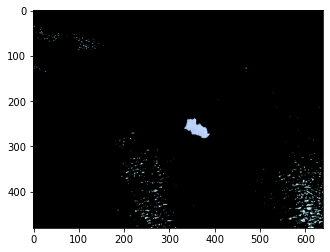

11967 Pixel in Video: 0370.mp4


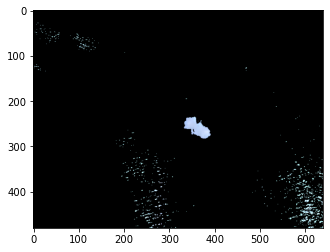

12393 Pixel in Video: 0370.mp4


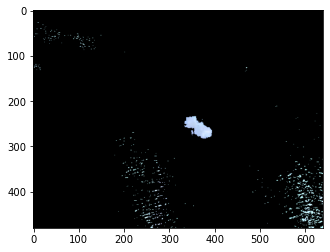

6390 Pixel in Video: 0372.mp4


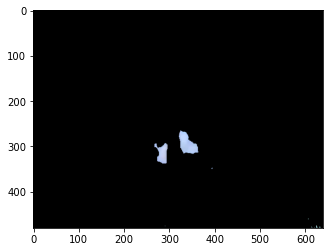

5616 Pixel in Video: 0372.mp4


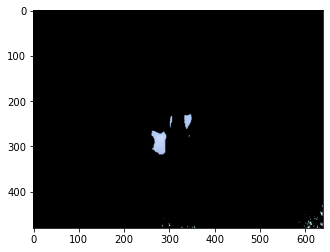

4314 Pixel in Video: 0372.mp4


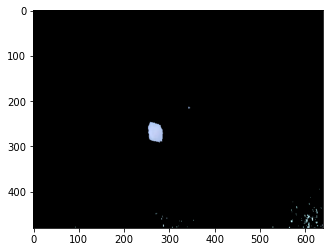

3108 Pixel in Video: 0372.mp4


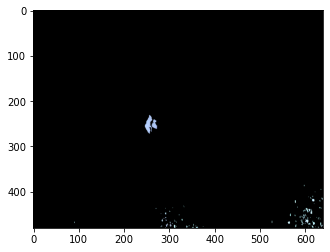

1791 Pixel in Video: 0372.mp4


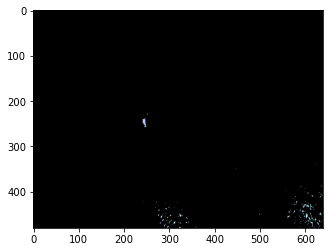

2136 Pixel in Video: 0372.mp4


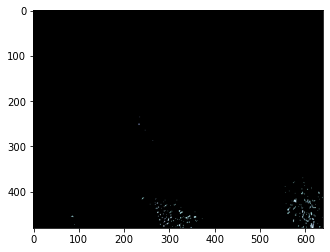

1641 Pixel in Video: 0372.mp4


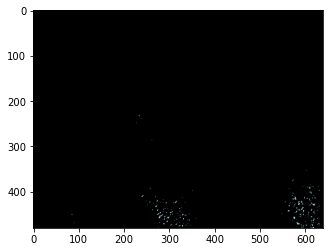

1833 Pixel in Video: 0372.mp4


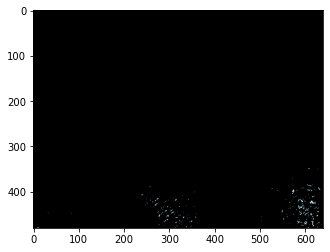

5739 Pixel in Video: 0372.mp4


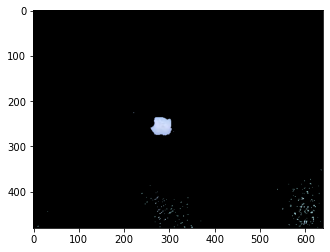

11274 Pixel in Video: 0372.mp4


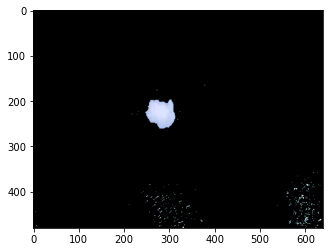

14505 Pixel in Video: 0372.mp4


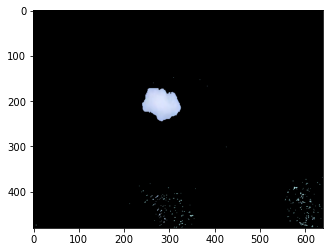

17499 Pixel in Video: 0372.mp4


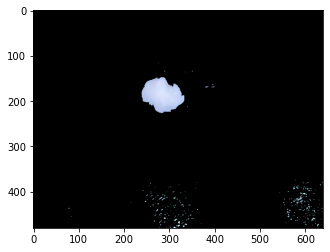

18297 Pixel in Video: 0372.mp4


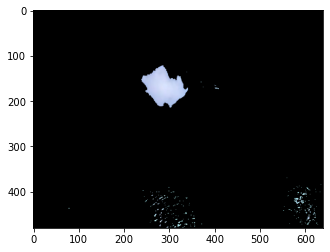

19164 Pixel in Video: 0372.mp4


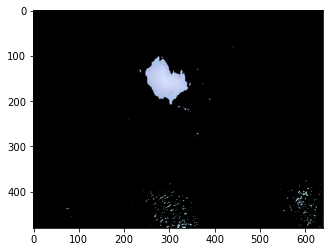

3426 Pixel in Video: 0374.mp4


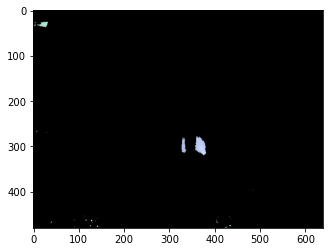

1059 Pixel in Video: 0376.mp4


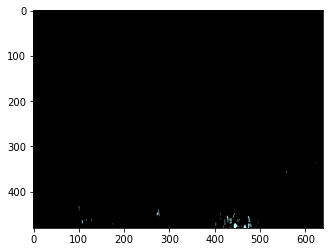

2688 Pixel in Video: 0376.mp4


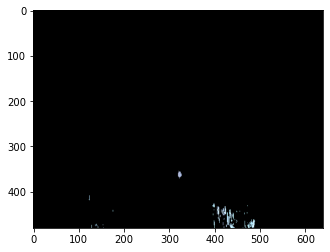

4995 Pixel in Video: 0376.mp4


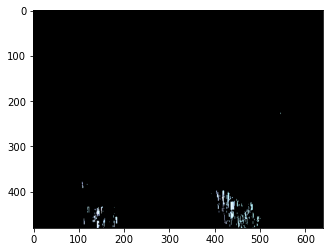

7185 Pixel in Video: 0376.mp4


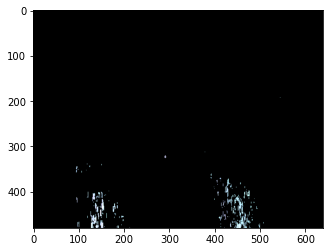

11919 Pixel in Video: 0376.mp4


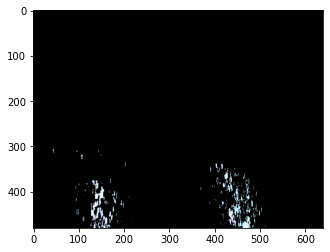

13779 Pixel in Video: 0376.mp4


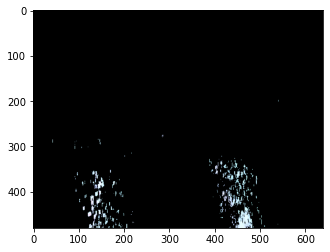

15600 Pixel in Video: 0376.mp4


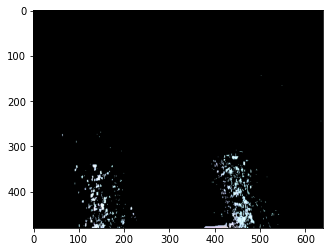

16188 Pixel in Video: 0376.mp4


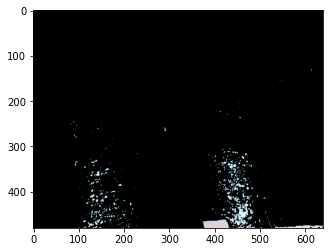

20211 Pixel in Video: 0376.mp4


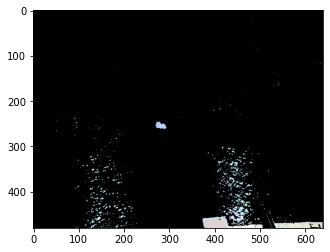

22803 Pixel in Video: 0376.mp4


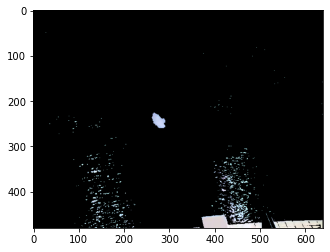

24816 Pixel in Video: 0376.mp4


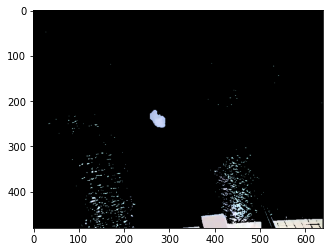

25017 Pixel in Video: 0376.mp4


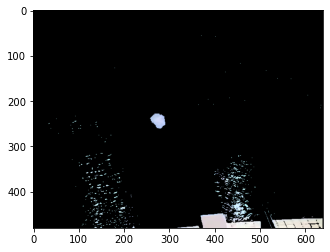

26373 Pixel in Video: 0376.mp4


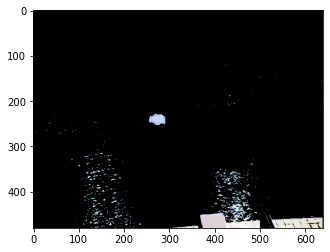

13365 Pixel in Video: 0377.mp4


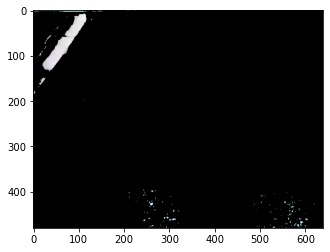

12861 Pixel in Video: 0377.mp4


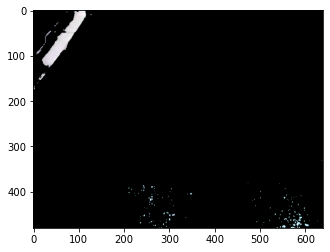

12933 Pixel in Video: 0377.mp4


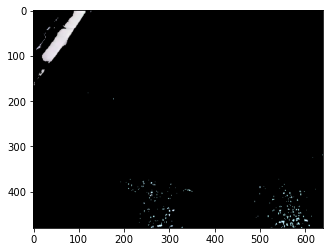

12297 Pixel in Video: 0377.mp4


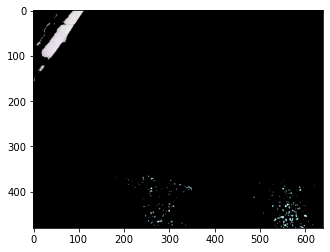

12705 Pixel in Video: 0377.mp4


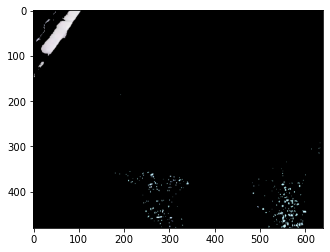

12303 Pixel in Video: 0377.mp4


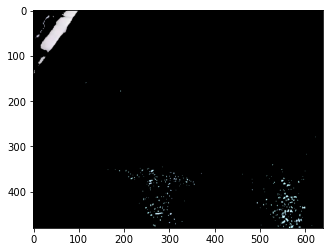

12441 Pixel in Video: 0377.mp4


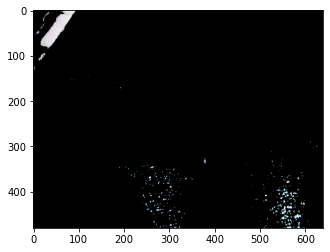

12342 Pixel in Video: 0377.mp4


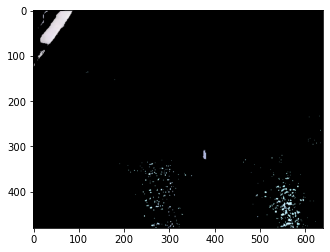

12885 Pixel in Video: 0377.mp4


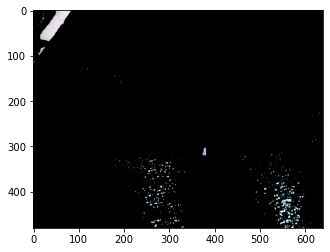

11484 Pixel in Video: 0377.mp4


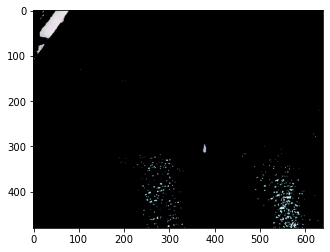

11265 Pixel in Video: 0377.mp4


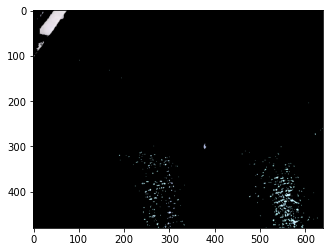

10305 Pixel in Video: 0377.mp4


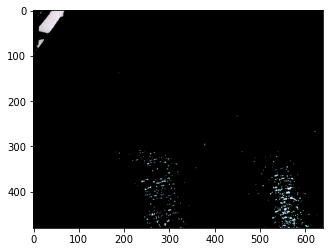

10509 Pixel in Video: 0377.mp4


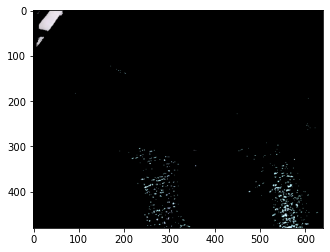

9684 Pixel in Video: 0377.mp4


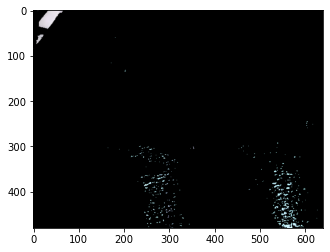

9396 Pixel in Video: 0377.mp4


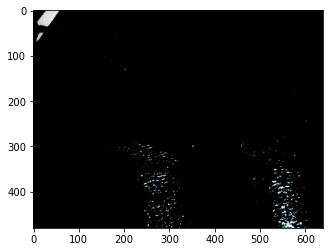

9300 Pixel in Video: 0377.mp4


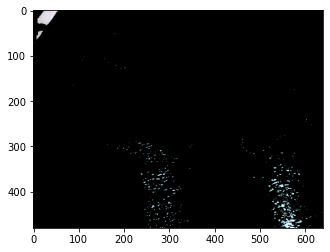

9315 Pixel in Video: 0377.mp4


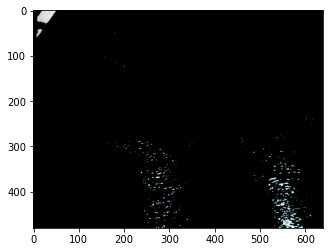

9861 Pixel in Video: 0377.mp4


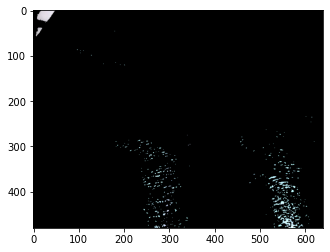

9870 Pixel in Video: 0377.mp4


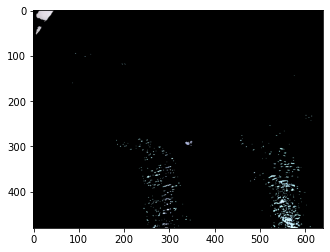

10284 Pixel in Video: 0377.mp4


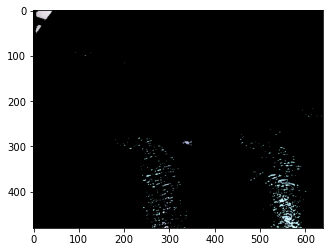

9681 Pixel in Video: 0377.mp4


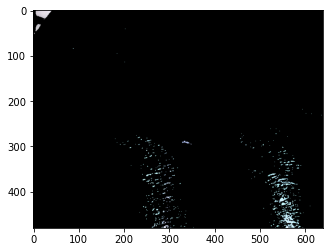

9768 Pixel in Video: 0377.mp4


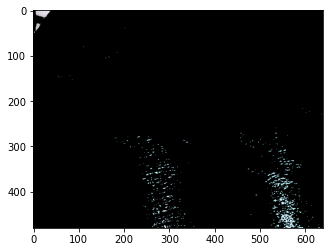

9348 Pixel in Video: 0377.mp4


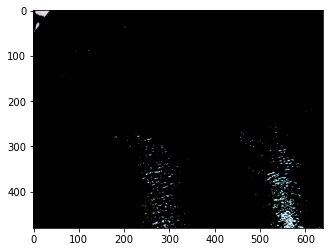

9441 Pixel in Video: 0377.mp4


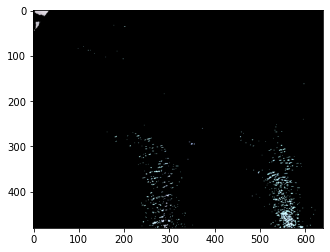

8757 Pixel in Video: 0377.mp4


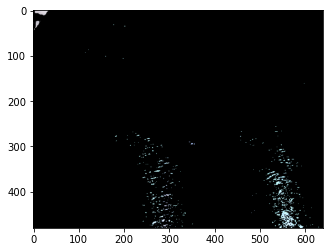

9570 Pixel in Video: 0377.mp4


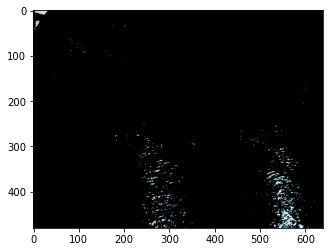

9141 Pixel in Video: 0377.mp4


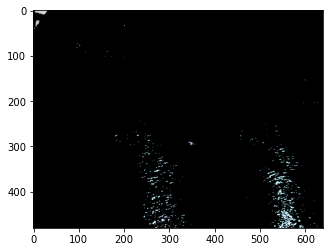

9714 Pixel in Video: 0377.mp4


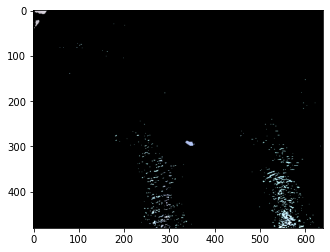

9795 Pixel in Video: 0377.mp4


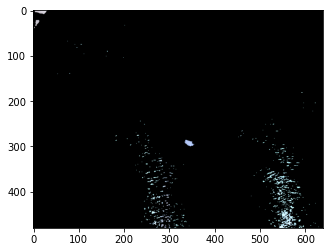

10506 Pixel in Video: 0377.mp4


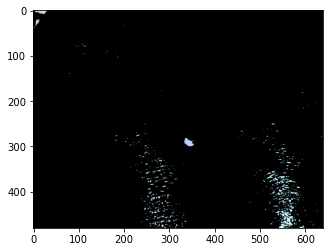

10419 Pixel in Video: 0377.mp4


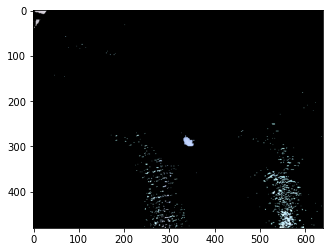

11019 Pixel in Video: 0377.mp4


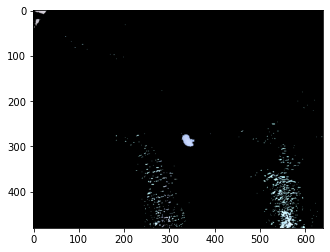

10836 Pixel in Video: 0377.mp4


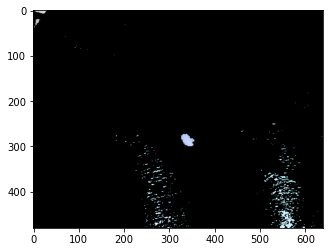

11436 Pixel in Video: 0377.mp4


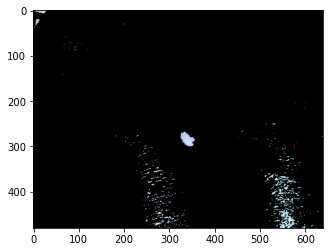

11253 Pixel in Video: 0377.mp4


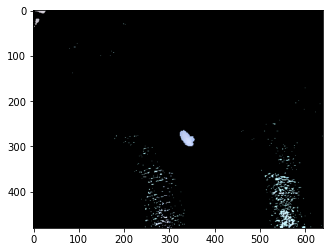

11481 Pixel in Video: 0377.mp4


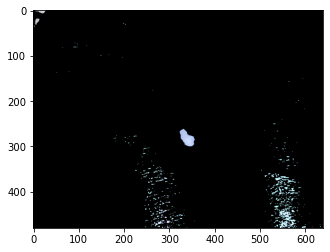

10953 Pixel in Video: 0377.mp4


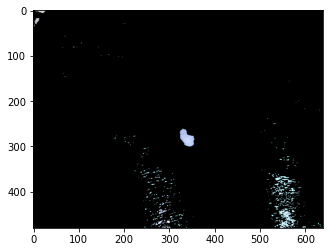

11328 Pixel in Video: 0377.mp4


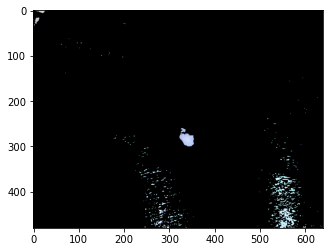

4668 Pixel in Video: 0379.mp4


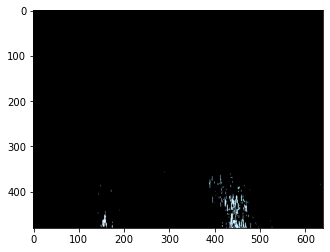

8499 Pixel in Video: 0379.mp4


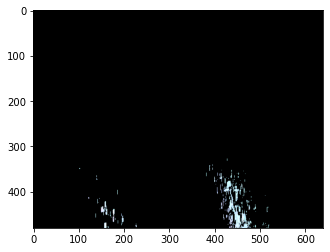

10881 Pixel in Video: 0379.mp4


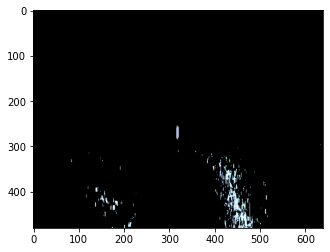

12171 Pixel in Video: 0379.mp4


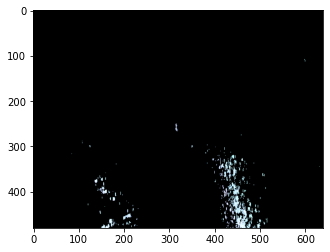

13077 Pixel in Video: 0379.mp4


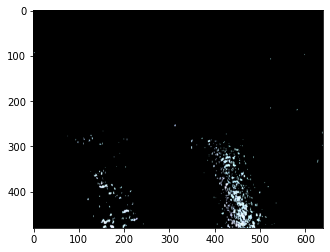

13077 Pixel in Video: 0379.mp4


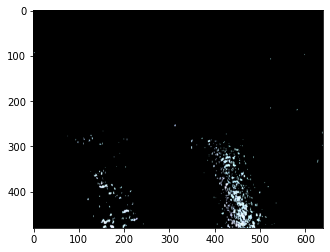

11931 Pixel in Video: 0379.mp4


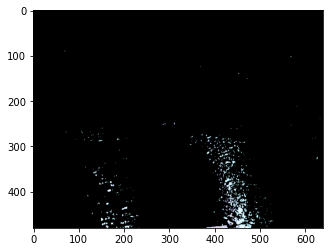

10929 Pixel in Video: 0379.mp4


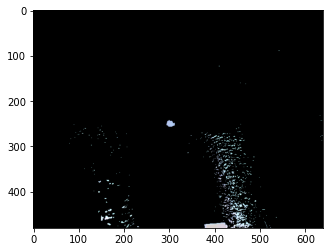

11898 Pixel in Video: 0379.mp4


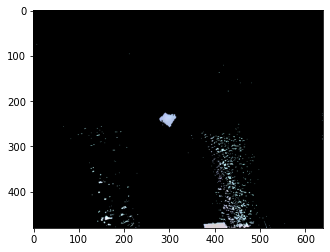

12882 Pixel in Video: 0379.mp4


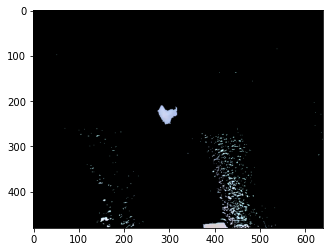

13701 Pixel in Video: 0379.mp4


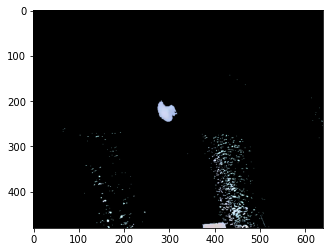

13929 Pixel in Video: 0379.mp4


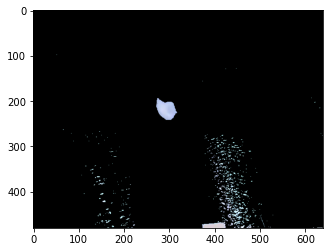

14490 Pixel in Video: 0379.mp4


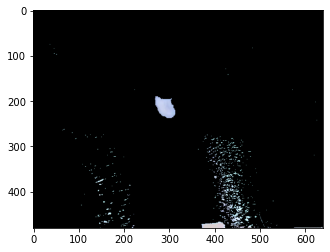

14385 Pixel in Video: 0379.mp4


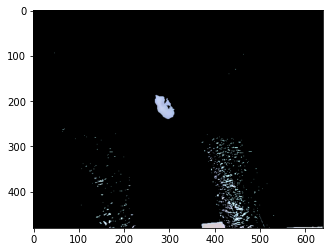

14373 Pixel in Video: 0379.mp4


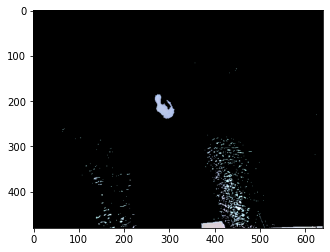

13941 Pixel in Video: 0379.mp4


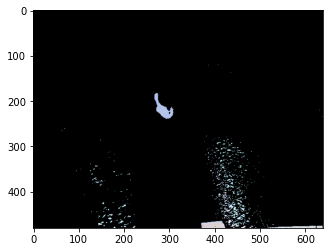

14004 Pixel in Video: 0379.mp4


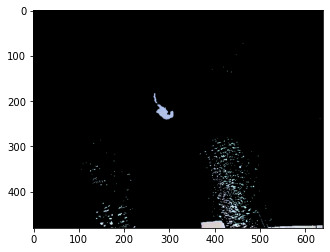

15090 Pixel in Video: 0380.mp4


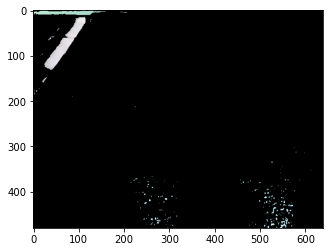

11925 Pixel in Video: 0380.mp4


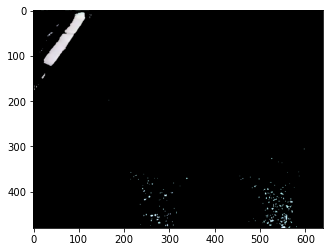

12363 Pixel in Video: 0380.mp4


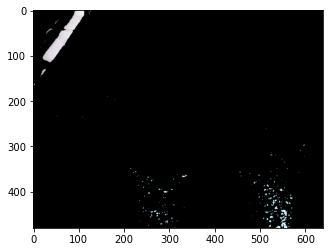

12750 Pixel in Video: 0380.mp4


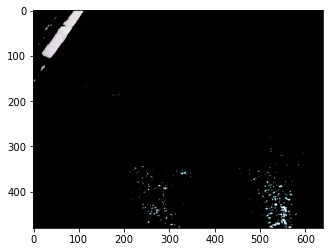

11832 Pixel in Video: 0380.mp4


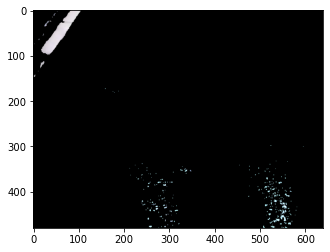

11820 Pixel in Video: 0380.mp4


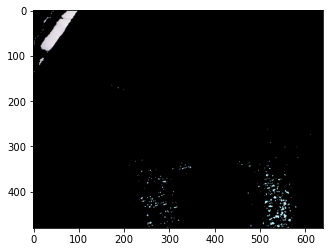

11907 Pixel in Video: 0380.mp4


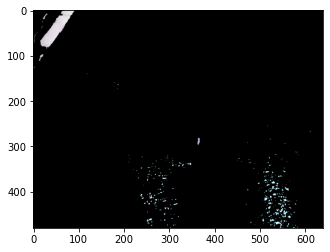

11160 Pixel in Video: 0380.mp4


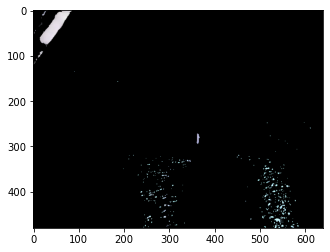

10821 Pixel in Video: 0380.mp4


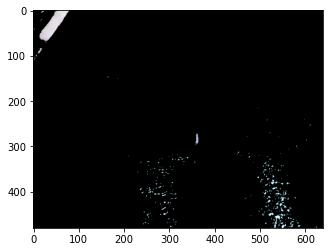

10383 Pixel in Video: 0380.mp4


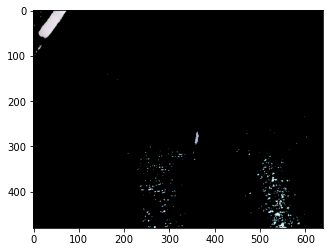

10089 Pixel in Video: 0380.mp4


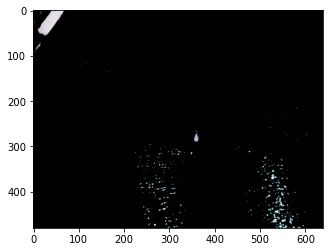

9528 Pixel in Video: 0380.mp4


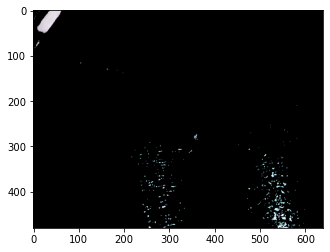

8898 Pixel in Video: 0380.mp4


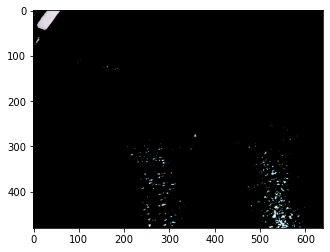

8547 Pixel in Video: 0380.mp4


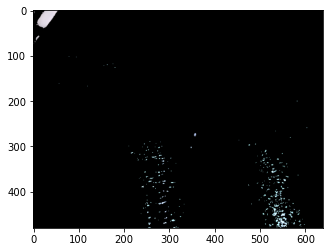

9168 Pixel in Video: 0380.mp4


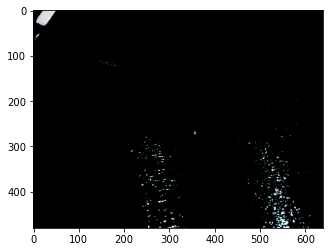

8385 Pixel in Video: 0380.mp4


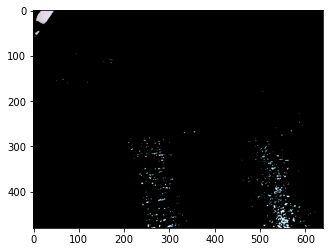

8559 Pixel in Video: 0380.mp4


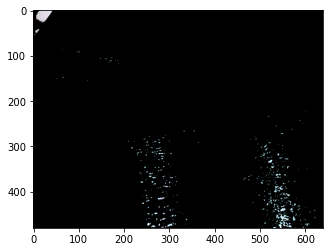

7806 Pixel in Video: 0380.mp4


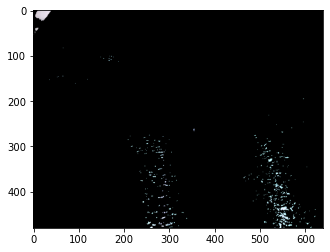

8478 Pixel in Video: 0380.mp4


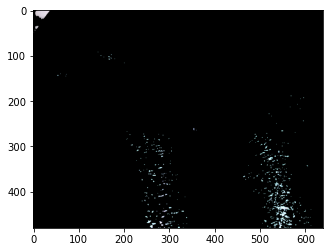

8247 Pixel in Video: 0380.mp4


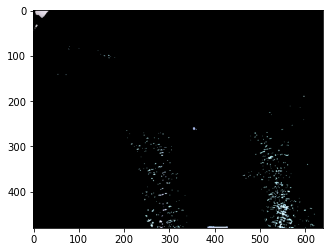

8679 Pixel in Video: 0380.mp4


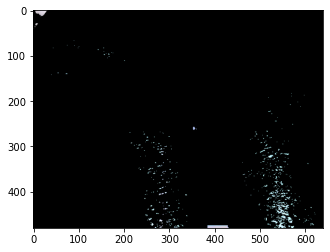

8499 Pixel in Video: 0380.mp4


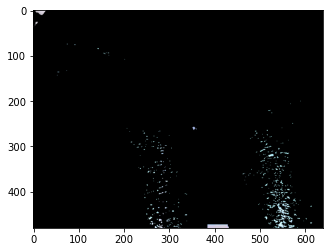

9504 Pixel in Video: 0380.mp4


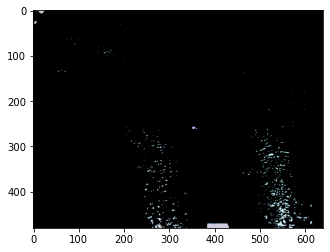

9987 Pixel in Video: 0380.mp4


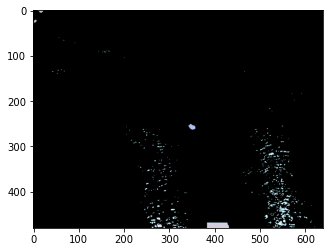

11586 Pixel in Video: 0380.mp4


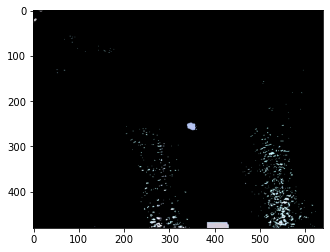

11586 Pixel in Video: 0380.mp4


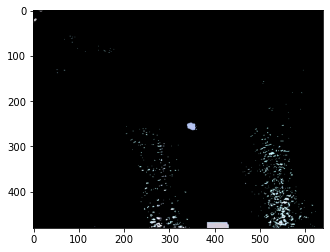

11397 Pixel in Video: 0380.mp4


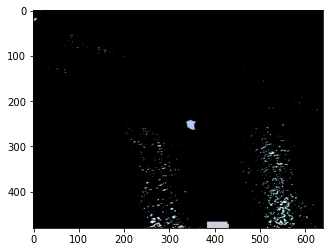

12819 Pixel in Video: 0380.mp4


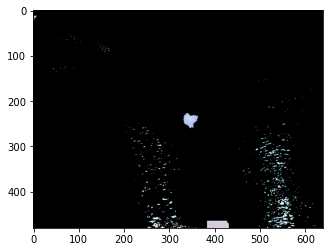

13167 Pixel in Video: 0380.mp4


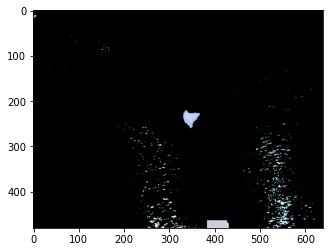

13620 Pixel in Video: 0380.mp4


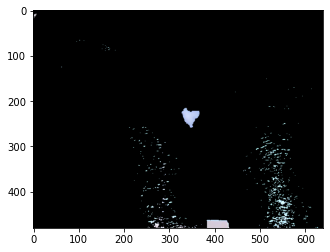

13860 Pixel in Video: 0380.mp4


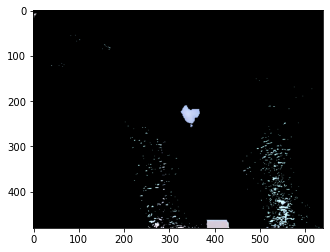

14406 Pixel in Video: 0380.mp4


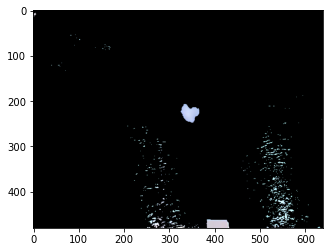

15219 Pixel in Video: 0380.mp4


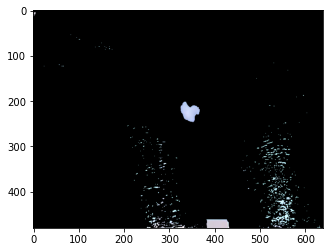

14937 Pixel in Video: 0380.mp4


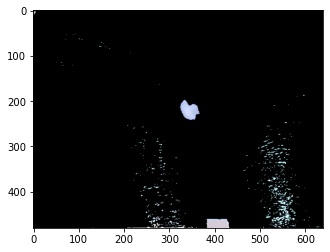

14805 Pixel in Video: 0380.mp4


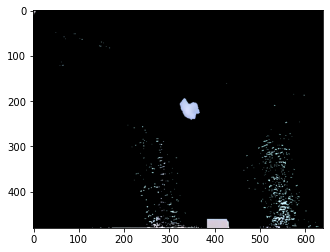

15684 Pixel in Video: 0380.mp4


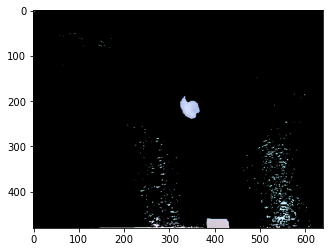

16875 Pixel in Video: 0380.mp4


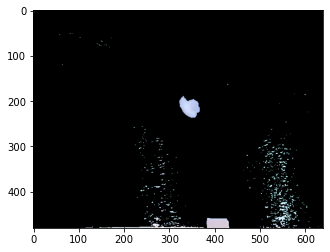

17481 Pixel in Video: 0380.mp4


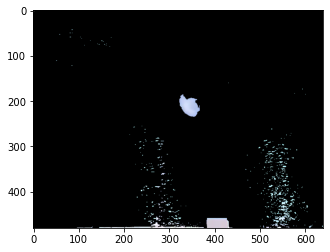

18042 Pixel in Video: 0380.mp4


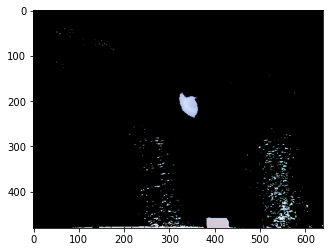

19290 Pixel in Video: 0380.mp4


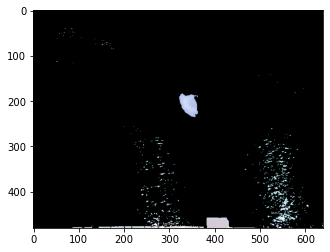

324 Pixel in Video: 0383.mp4


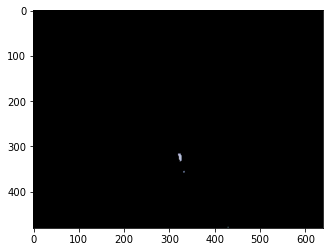

564 Pixel in Video: 0383.mp4


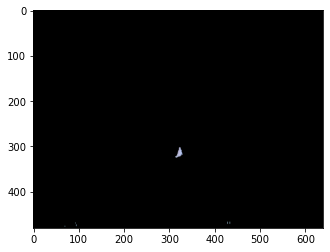

1143 Pixel in Video: 0383.mp4


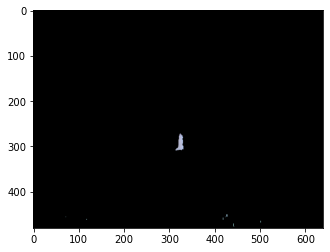

2094 Pixel in Video: 0383.mp4


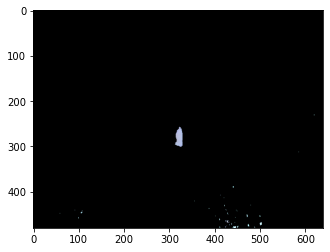

2109 Pixel in Video: 0383.mp4


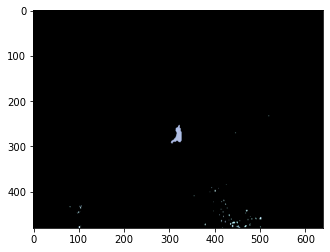

1779 Pixel in Video: 0383.mp4


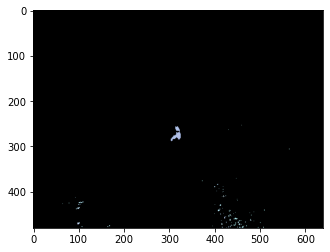

3309 Pixel in Video: 0383.mp4


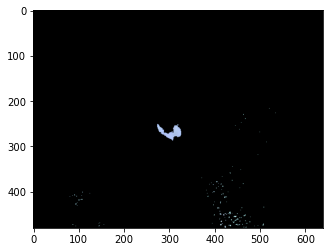

4419 Pixel in Video: 0383.mp4


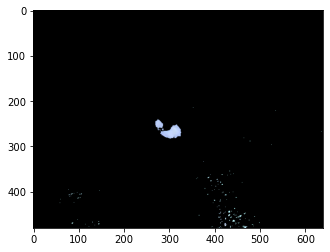

4692 Pixel in Video: 0383.mp4


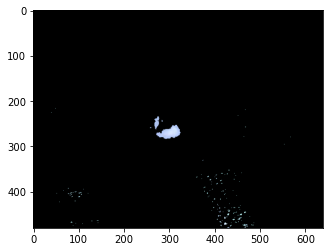

6453 Pixel in Video: 0383.mp4


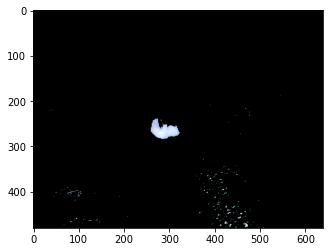

7455 Pixel in Video: 0383.mp4


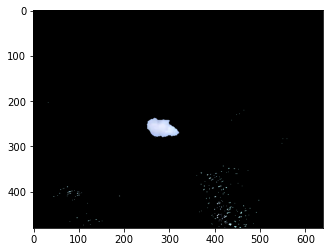

9075 Pixel in Video: 0383.mp4


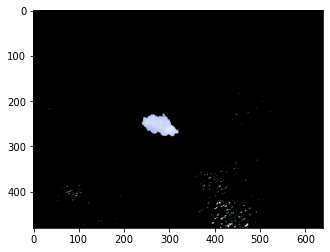

9540 Pixel in Video: 0383.mp4


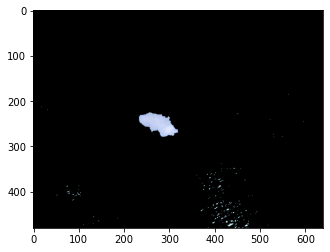

9858 Pixel in Video: 0383.mp4


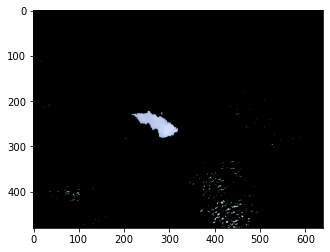

1605 Pixel in Video: 0384.mp4


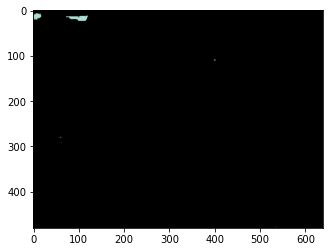

672 Pixel in Video: 0384.mp4


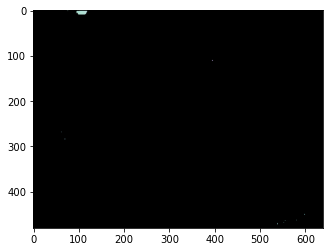

411 Pixel in Video: 0384.mp4


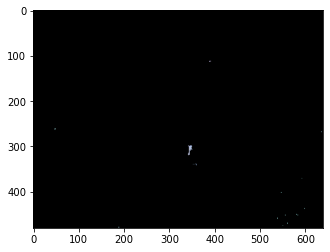

411 Pixel in Video: 0384.mp4


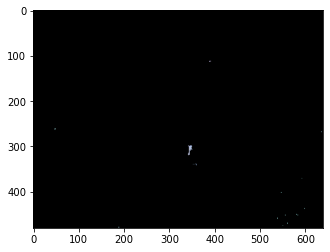

933 Pixel in Video: 0384.mp4


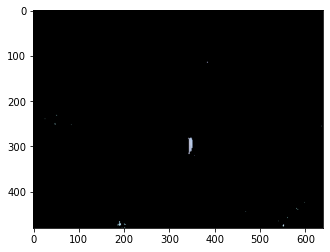

2364 Pixel in Video: 0384.mp4


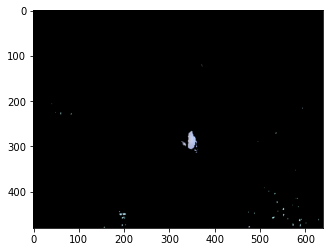

2019 Pixel in Video: 0384.mp4


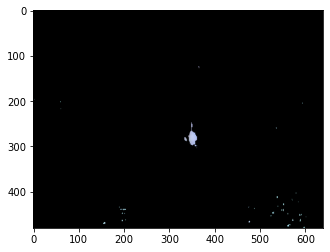

1677 Pixel in Video: 0384.mp4


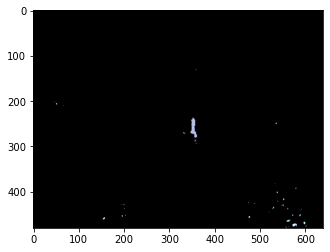

2382 Pixel in Video: 0384.mp4


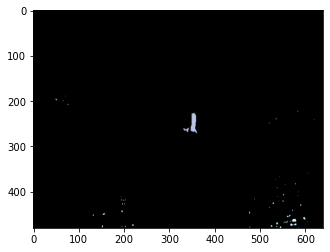

2763 Pixel in Video: 0384.mp4


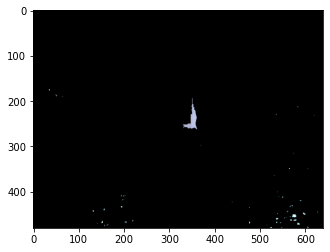

3765 Pixel in Video: 0384.mp4


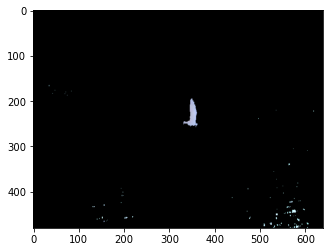

4209 Pixel in Video: 0384.mp4


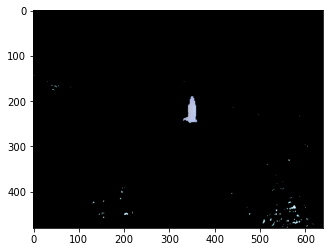

4161 Pixel in Video: 0384.mp4


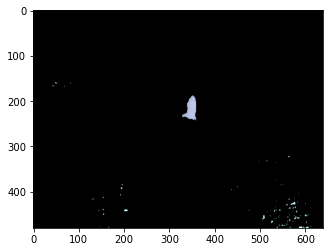

4335 Pixel in Video: 0384.mp4


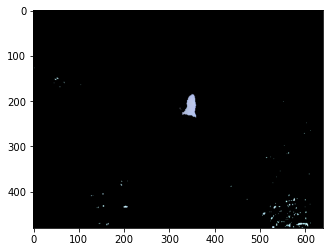

4449 Pixel in Video: 0384.mp4


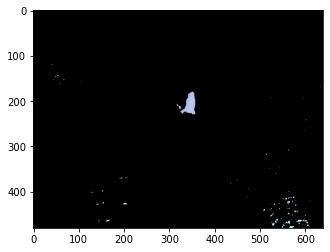

4314 Pixel in Video: 0384.mp4


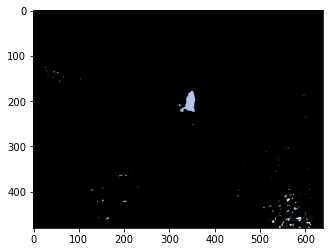

3867 Pixel in Video: 0384.mp4


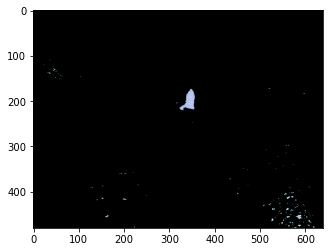

3765 Pixel in Video: 0384.mp4


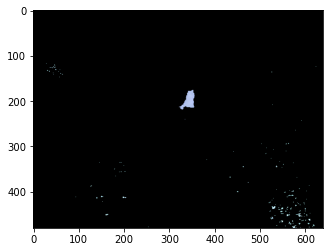

4188 Pixel in Video: 0384.mp4


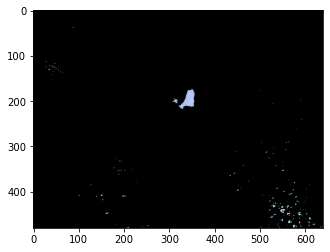

4938 Pixel in Video: 0384.mp4


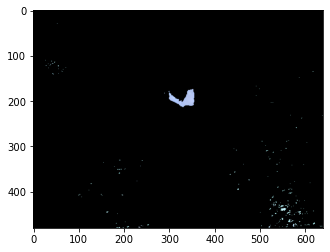

5760 Pixel in Video: 0384.mp4


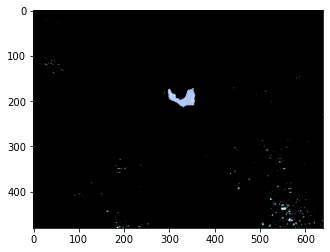

6405 Pixel in Video: 0384.mp4


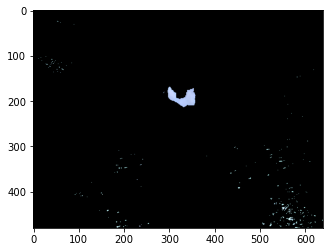

6756 Pixel in Video: 0384.mp4


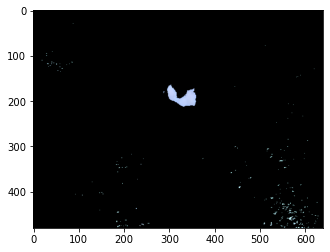

7308 Pixel in Video: 0384.mp4


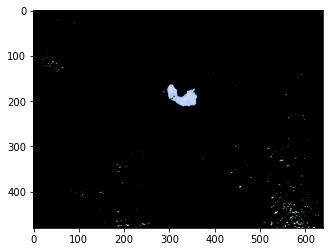

7932 Pixel in Video: 0384.mp4


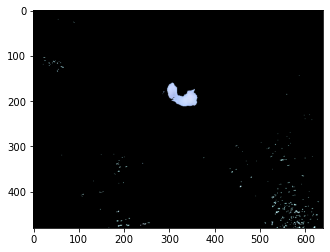

8103 Pixel in Video: 0384.mp4


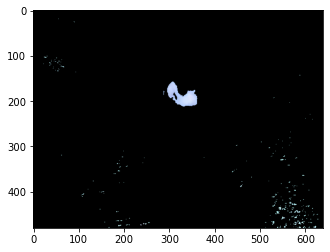

8295 Pixel in Video: 0384.mp4


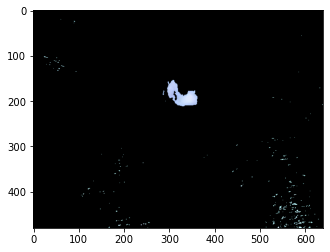

8601 Pixel in Video: 0384.mp4


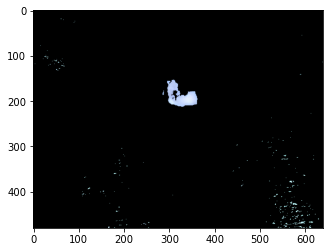

9366 Pixel in Video: 0384.mp4


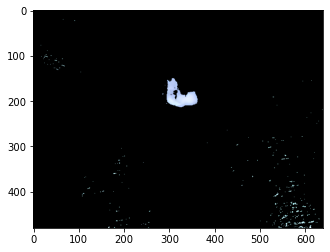

9795 Pixel in Video: 0384.mp4


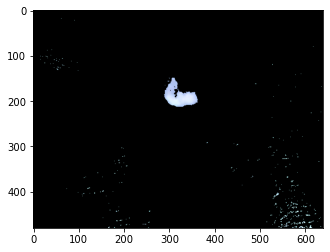

9936 Pixel in Video: 0384.mp4


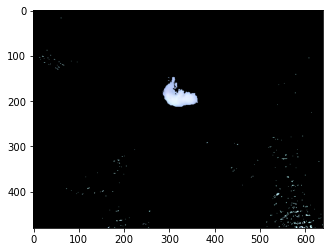

9855 Pixel in Video: 0384.mp4


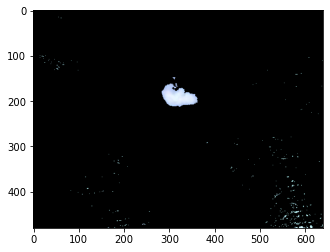

10464 Pixel in Video: 0384.mp4


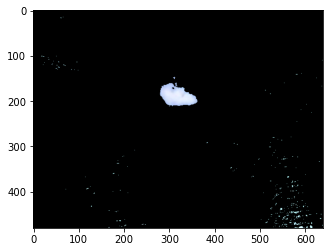

11196 Pixel in Video: 0384.mp4


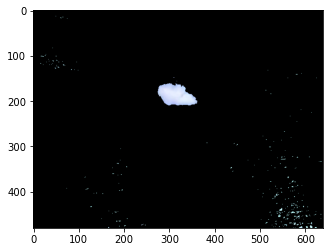

11481 Pixel in Video: 0384.mp4


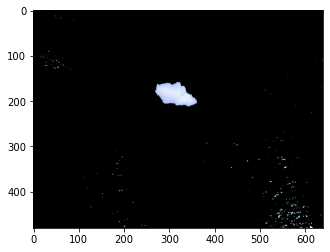

12294 Pixel in Video: 0384.mp4


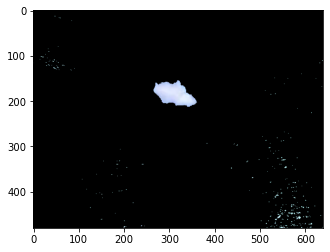

729 Pixel in Video: 0385.mp4


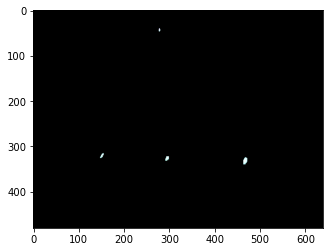

573 Pixel in Video: 0385.mp4


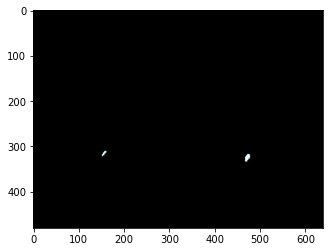

654 Pixel in Video: 0385.mp4


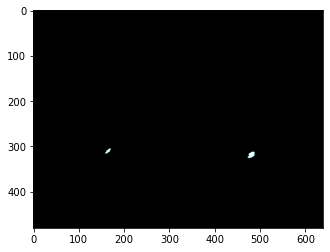

654 Pixel in Video: 0385.mp4


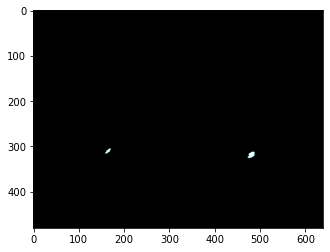

504 Pixel in Video: 0385.mp4


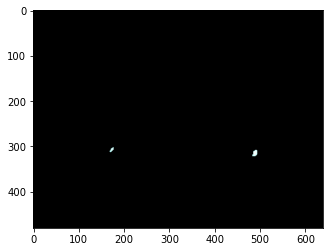

465 Pixel in Video: 0385.mp4


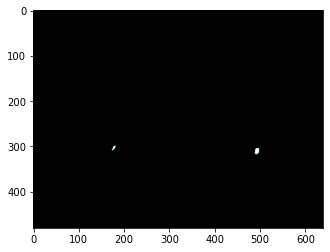

525 Pixel in Video: 0385.mp4


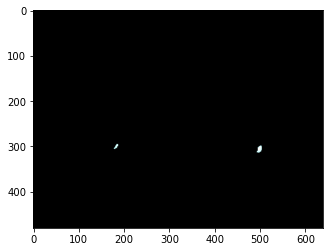

525 Pixel in Video: 0385.mp4


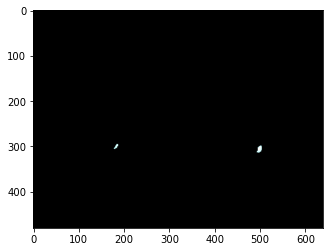

489 Pixel in Video: 0385.mp4


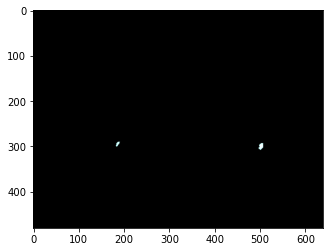

537 Pixel in Video: 0385.mp4


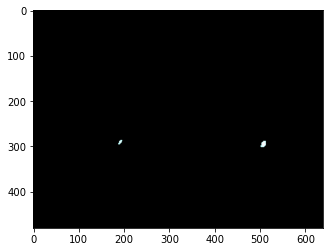

534 Pixel in Video: 0385.mp4


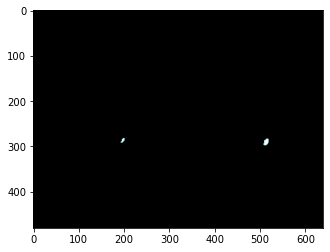

534 Pixel in Video: 0385.mp4


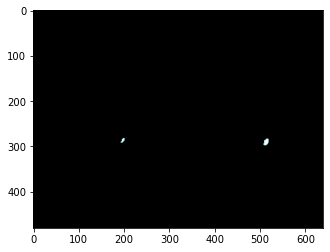

546 Pixel in Video: 0385.mp4


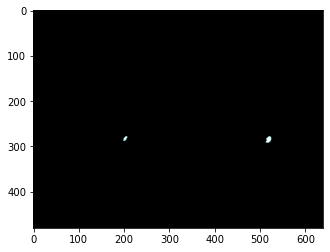

534 Pixel in Video: 0385.mp4


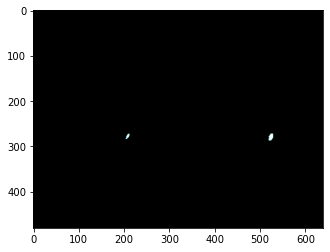

555 Pixel in Video: 0385.mp4


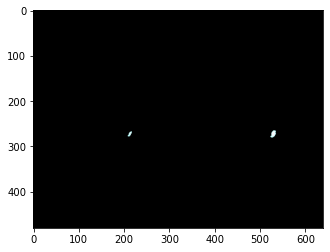

555 Pixel in Video: 0385.mp4


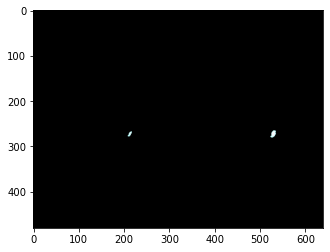

588 Pixel in Video: 0385.mp4


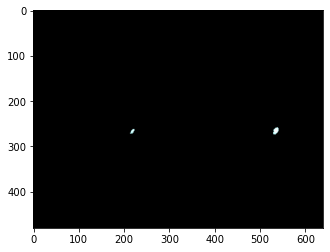

561 Pixel in Video: 0385.mp4


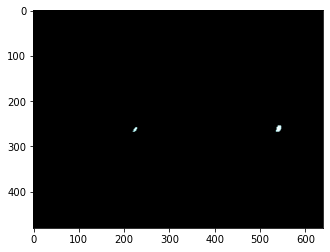

588 Pixel in Video: 0385.mp4


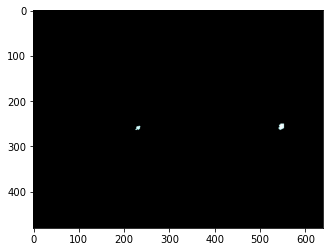

336 Pixel in Video: 0386.mp4


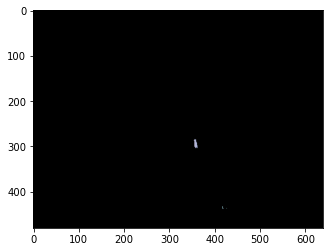

1101 Pixel in Video: 0386.mp4


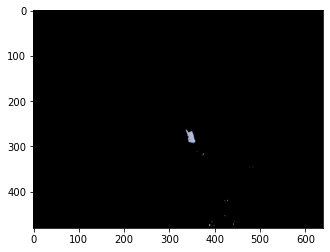

2064 Pixel in Video: 0386.mp4


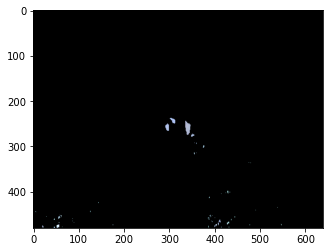

2262 Pixel in Video: 0386.mp4


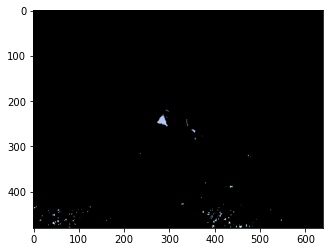

1824 Pixel in Video: 0386.mp4


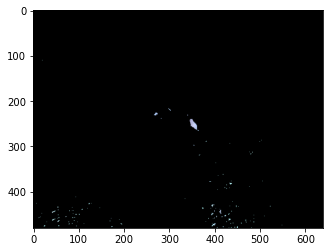

4698 Pixel in Video: 0386.mp4


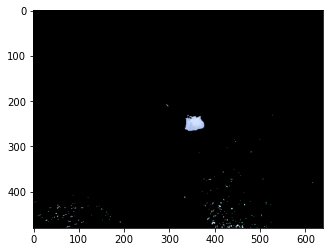

5454 Pixel in Video: 0386.mp4


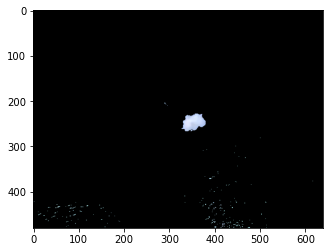

7251 Pixel in Video: 0386.mp4


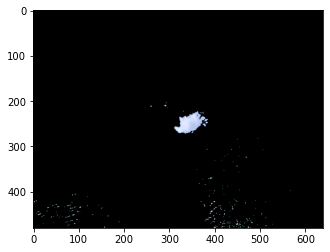

8352 Pixel in Video: 0386.mp4


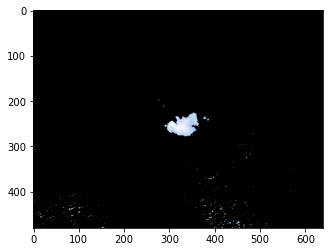

9951 Pixel in Video: 0386.mp4


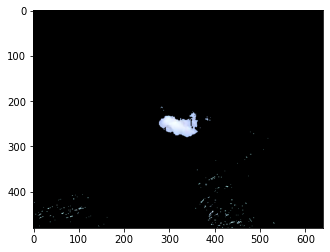

11520 Pixel in Video: 0386.mp4


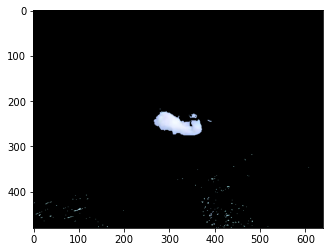

14061 Pixel in Video: 0386.mp4


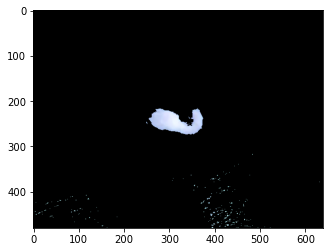

16764 Pixel in Video: 0386.mp4


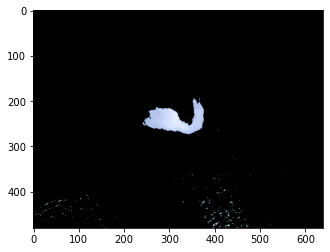

16884 Pixel in Video: 0386.mp4


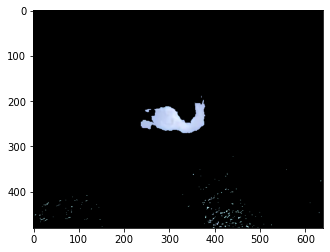

16509 Pixel in Video: 0386.mp4


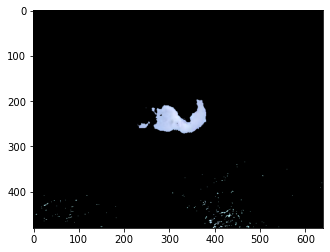

15516 Pixel in Video: 0386.mp4


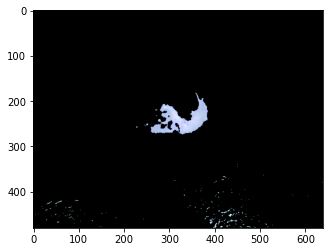

12123 Pixel in Video: 0386.mp4


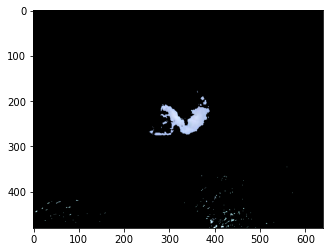

9852 Pixel in Video: 0386.mp4


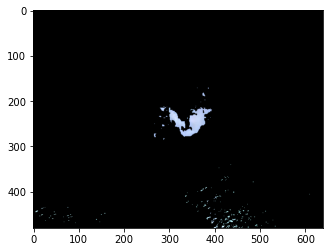

8472 Pixel in Video: 0386.mp4


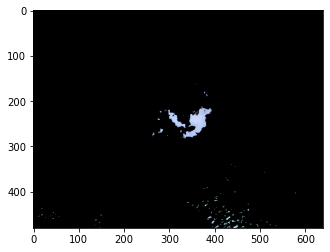

7071 Pixel in Video: 0386.mp4


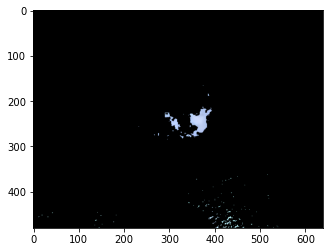

5775 Pixel in Video: 0386.mp4


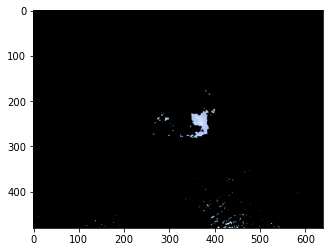

5331 Pixel in Video: 0386.mp4


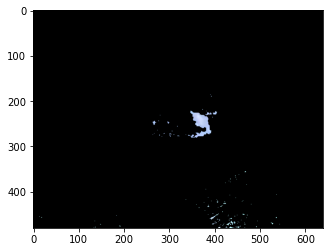

300 Pixel in Video: 0387.mp4


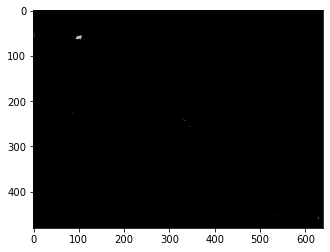

387 Pixel in Video: 0387.mp4


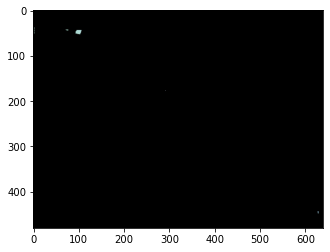

615 Pixel in Video: 0387.mp4


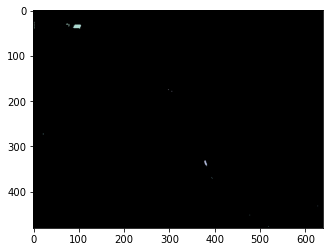

1164 Pixel in Video: 0387.mp4


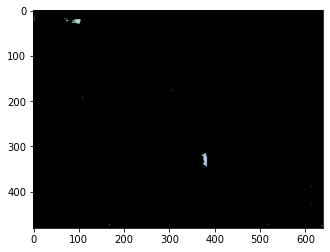

2709 Pixel in Video: 0387.mp4


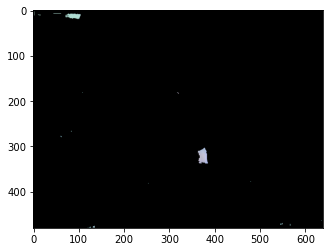

1980 Pixel in Video: 0387.mp4


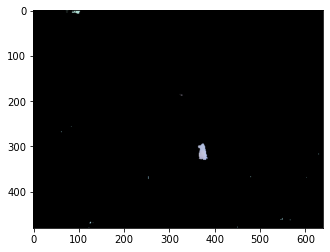

2136 Pixel in Video: 0387.mp4


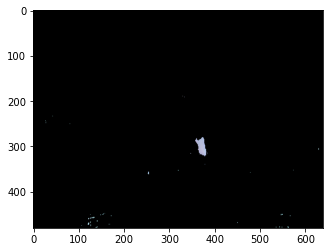

2187 Pixel in Video: 0387.mp4


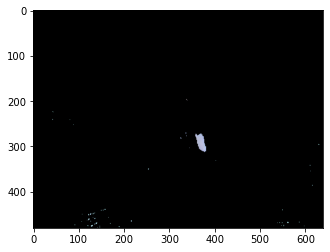

2547 Pixel in Video: 0387.mp4


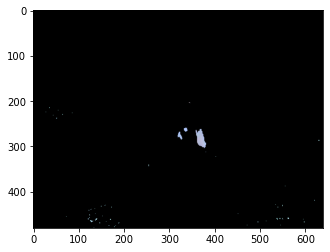

2964 Pixel in Video: 0387.mp4


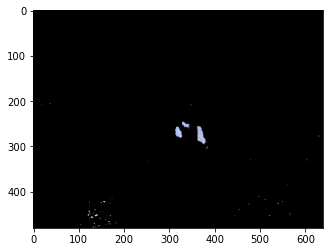

3045 Pixel in Video: 0387.mp4


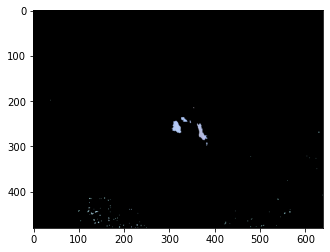

2952 Pixel in Video: 0387.mp4


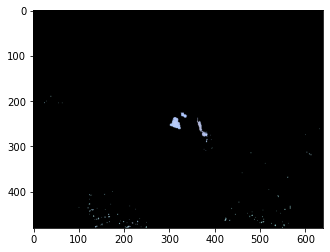

3375 Pixel in Video: 0387.mp4


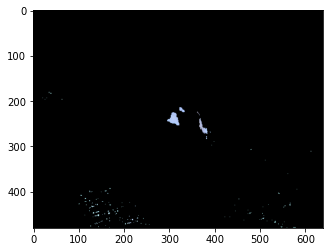

2628 Pixel in Video: 0387.mp4


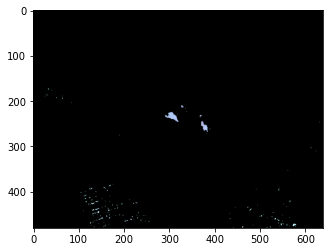

2448 Pixel in Video: 0387.mp4


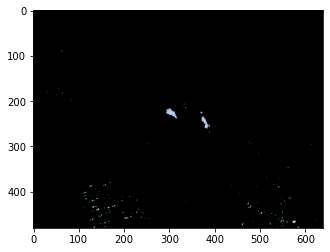

3936 Pixel in Video: 0387.mp4


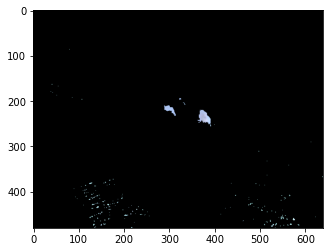

3855 Pixel in Video: 0387.mp4


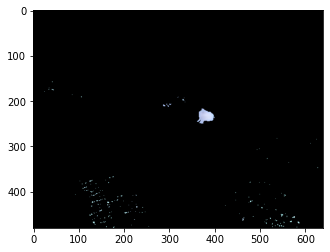

4407 Pixel in Video: 0387.mp4


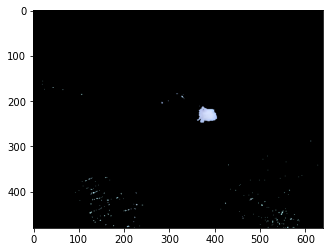

4992 Pixel in Video: 0387.mp4


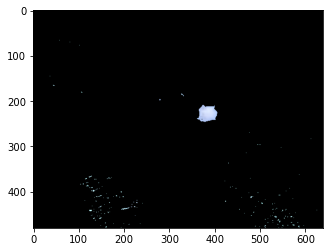

5403 Pixel in Video: 0387.mp4


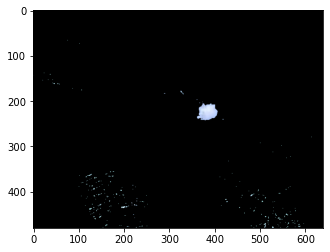

5892 Pixel in Video: 0387.mp4


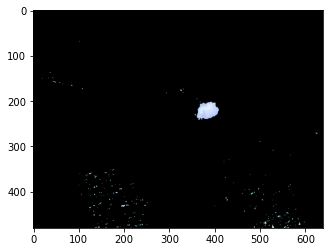

6891 Pixel in Video: 0387.mp4


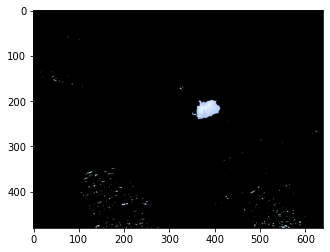

7647 Pixel in Video: 0387.mp4


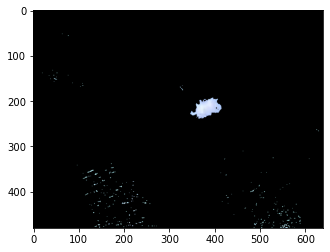

8238 Pixel in Video: 0387.mp4


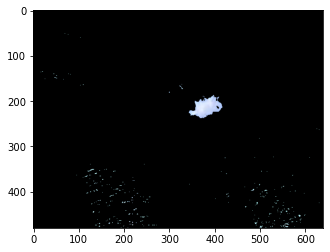

9099 Pixel in Video: 0387.mp4


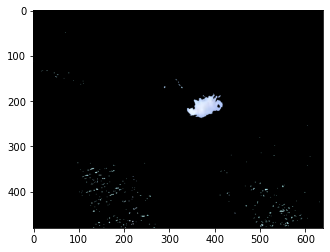

9690 Pixel in Video: 0387.mp4


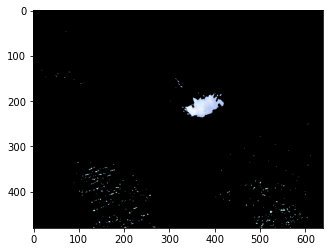

10368 Pixel in Video: 0387.mp4


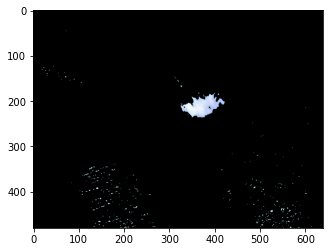

11283 Pixel in Video: 0387.mp4


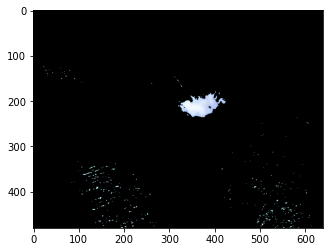

11988 Pixel in Video: 0387.mp4


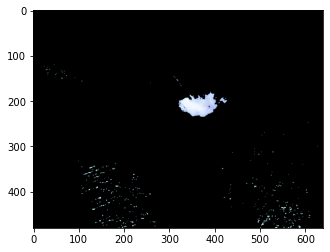

12303 Pixel in Video: 0387.mp4


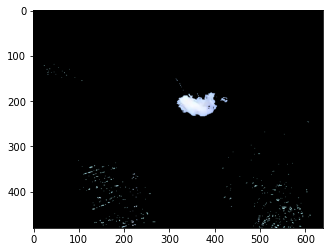

12405 Pixel in Video: 0387.mp4


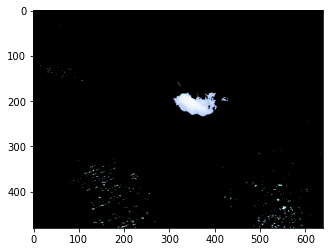

13161 Pixel in Video: 0387.mp4


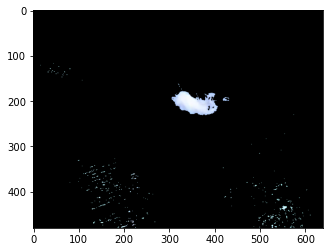

13341 Pixel in Video: 0387.mp4


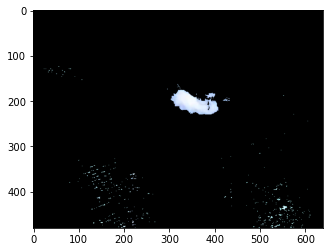

6264 Pixel in Video: 0389.mp4


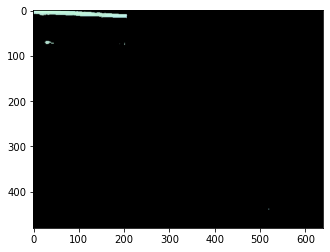

480 Pixel in Video: 0389.mp4


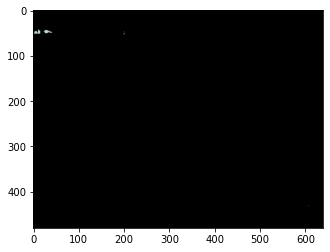

255 Pixel in Video: 0389.mp4


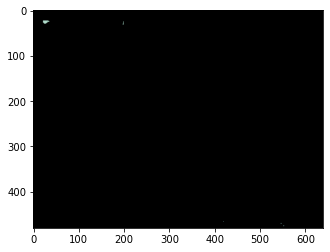

213 Pixel in Video: 0389.mp4


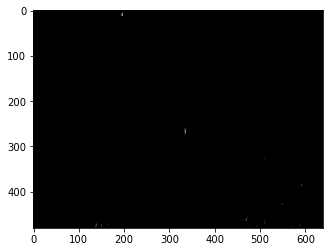

720 Pixel in Video: 0389.mp4


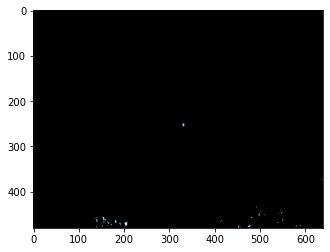

1329 Pixel in Video: 0389.mp4


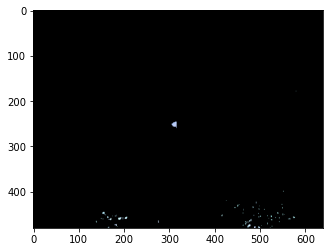

1278 Pixel in Video: 0389.mp4


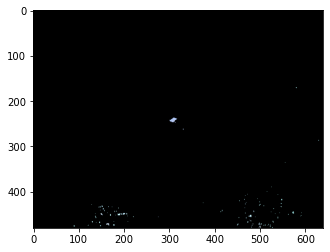

3396 Pixel in Video: 0389.mp4


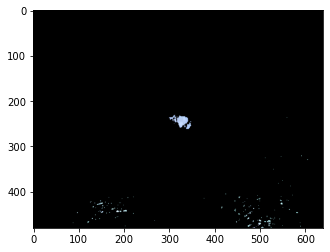

4995 Pixel in Video: 0389.mp4


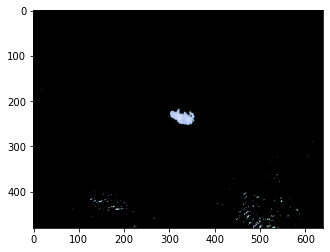

6549 Pixel in Video: 0389.mp4


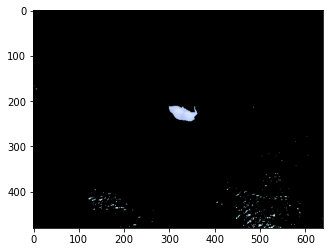

6774 Pixel in Video: 0389.mp4


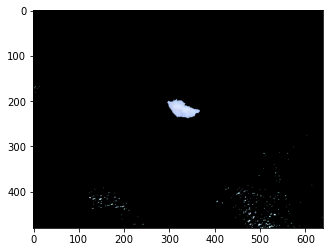

7497 Pixel in Video: 0389.mp4


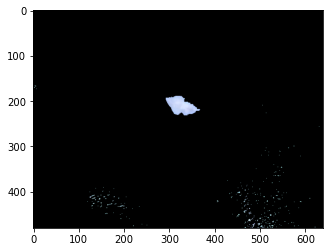

7647 Pixel in Video: 0389.mp4


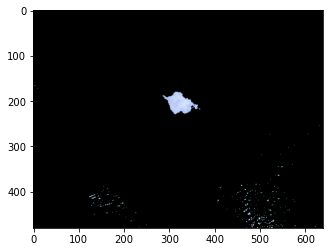

8127 Pixel in Video: 0389.mp4


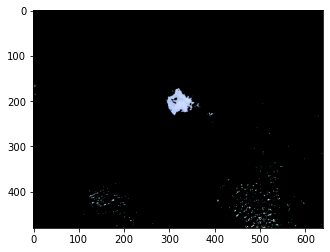

6459 Pixel in Video: 0389.mp4


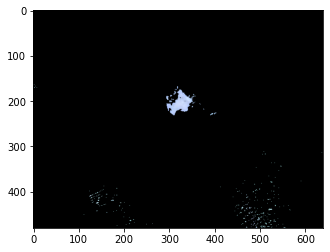

6336 Pixel in Video: 0389.mp4


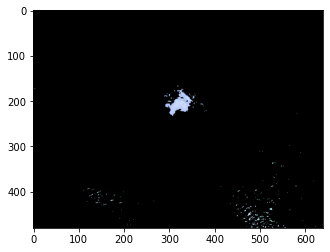

5052 Pixel in Video: 0389.mp4


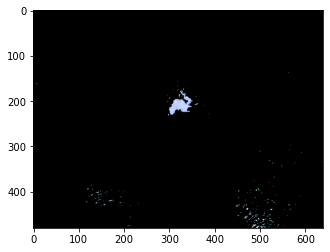

4959 Pixel in Video: 0389.mp4


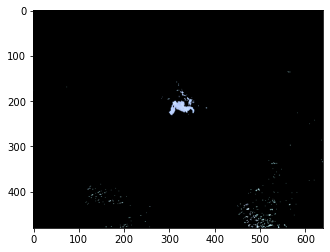

3369 Pixel in Video: 0389.mp4


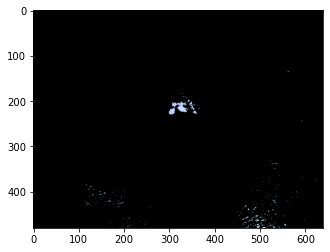

3171 Pixel in Video: 0389.mp4


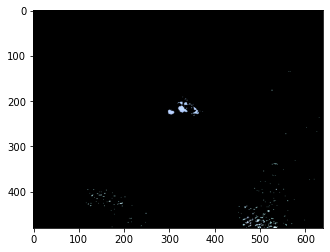

2976 Pixel in Video: 0389.mp4


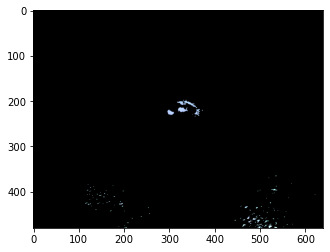

3444 Pixel in Video: 0389.mp4


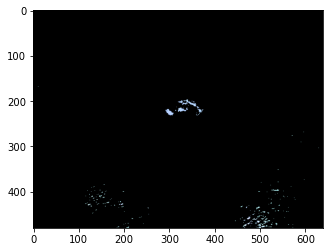

2484 Pixel in Video: 0389.mp4


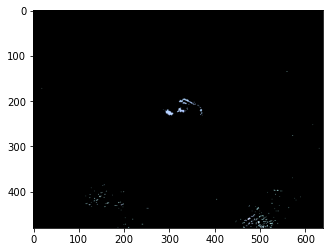

4806 Pixel in Video: 0390.mp4


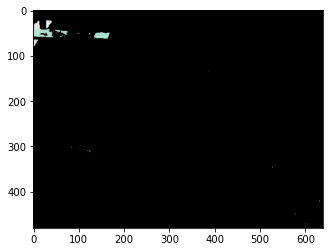

3573 Pixel in Video: 0390.mp4


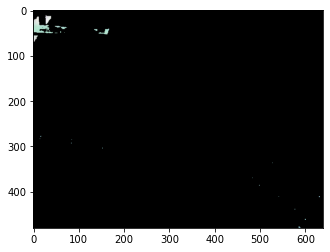

3450 Pixel in Video: 0390.mp4


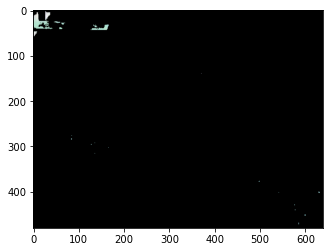

3396 Pixel in Video: 0390.mp4


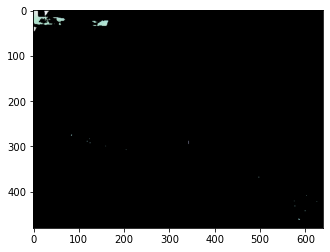

2568 Pixel in Video: 0390.mp4


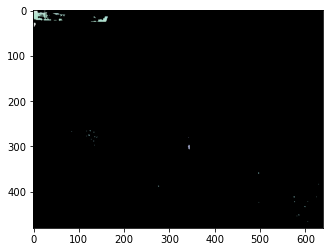

1959 Pixel in Video: 0390.mp4


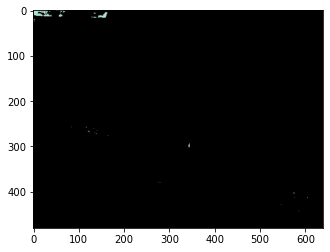

1134 Pixel in Video: 0390.mp4


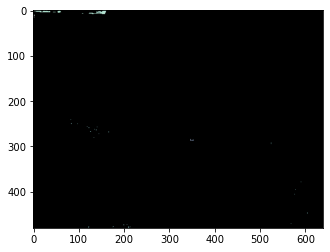

114 Pixel in Video: 0390.mp4


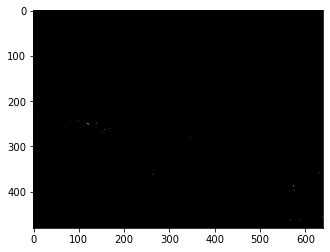

204 Pixel in Video: 0390.mp4


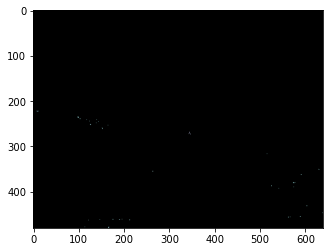

156 Pixel in Video: 0390.mp4


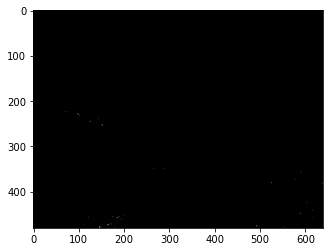

255 Pixel in Video: 0390.mp4


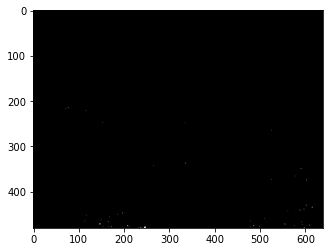

429 Pixel in Video: 0390.mp4


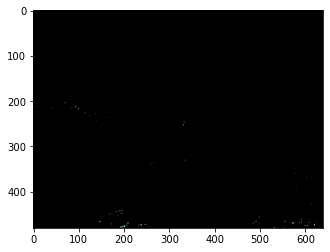

780 Pixel in Video: 0390.mp4


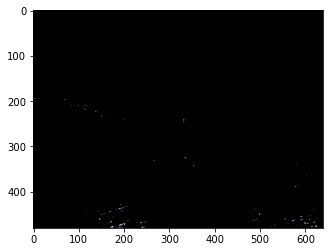

777 Pixel in Video: 0390.mp4


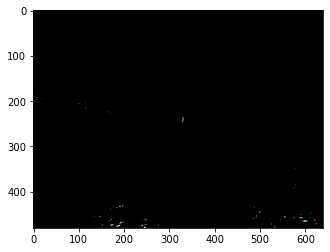

1014 Pixel in Video: 0390.mp4


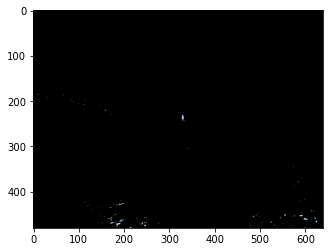

1089 Pixel in Video: 0390.mp4


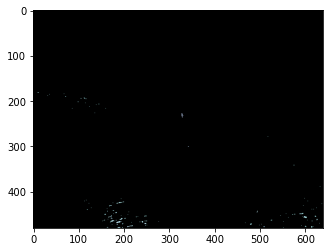

1245 Pixel in Video: 0390.mp4


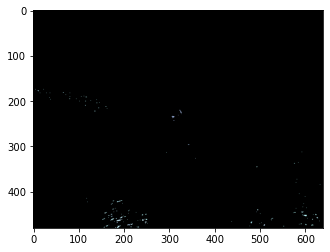

1437 Pixel in Video: 0390.mp4


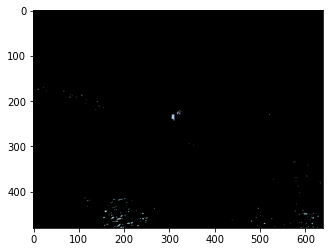

1530 Pixel in Video: 0390.mp4


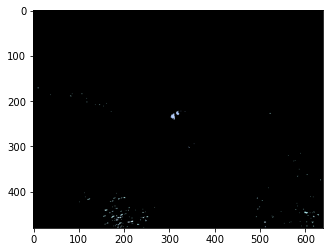

1629 Pixel in Video: 0390.mp4


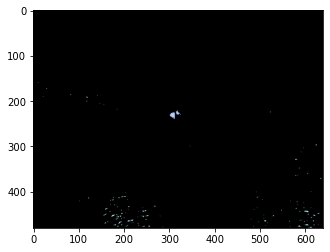

2376 Pixel in Video: 0390.mp4


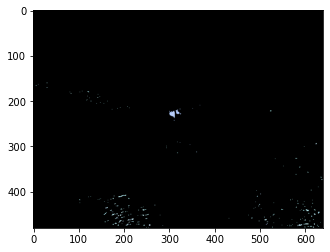

2244 Pixel in Video: 0390.mp4


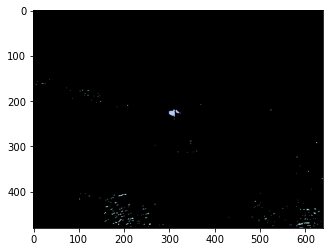

2298 Pixel in Video: 0390.mp4


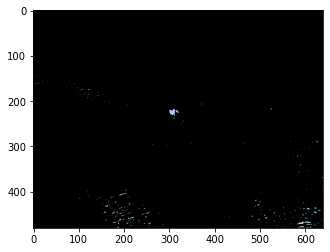

2943 Pixel in Video: 0390.mp4


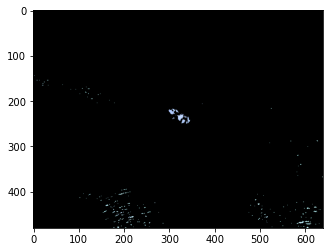

3870 Pixel in Video: 0390.mp4


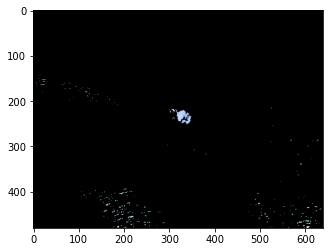

4698 Pixel in Video: 0390.mp4


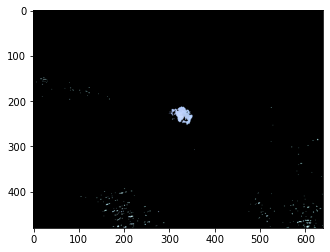

6183 Pixel in Video: 0390.mp4


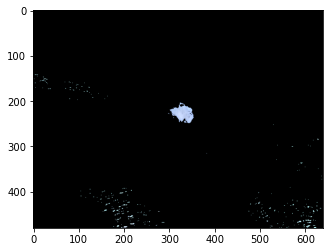

6711 Pixel in Video: 0390.mp4


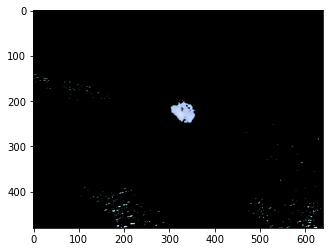

6429 Pixel in Video: 0390.mp4


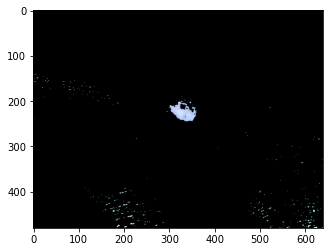

6360 Pixel in Video: 0390.mp4


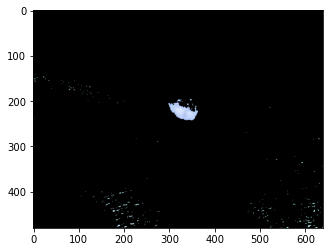

6873 Pixel in Video: 0390.mp4


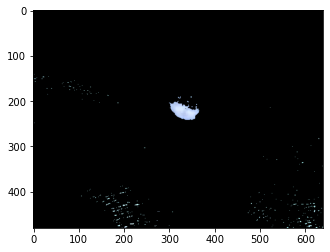

6873 Pixel in Video: 0390.mp4


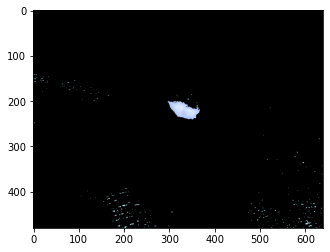

7701 Pixel in Video: 0390.mp4


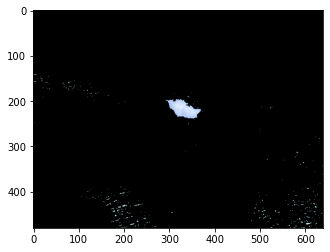

8190 Pixel in Video: 0390.mp4


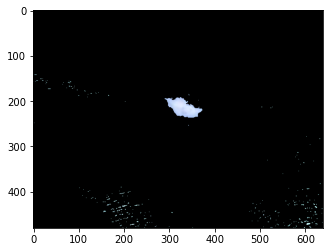

8829 Pixel in Video: 0390.mp4


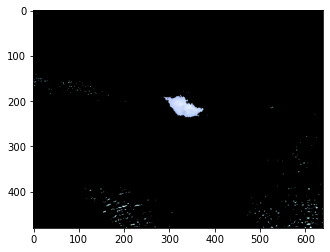

9144 Pixel in Video: 0390.mp4


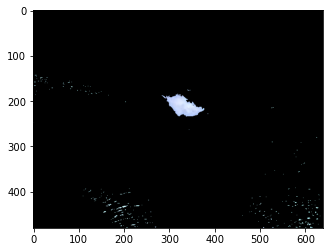

9741 Pixel in Video: 0390.mp4


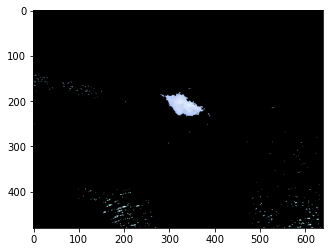

9741 Pixel in Video: 0390.mp4


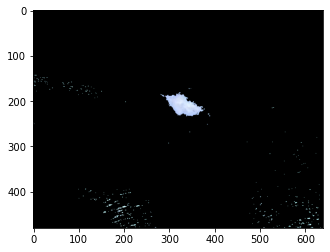

9264 Pixel in Video: 0390.mp4


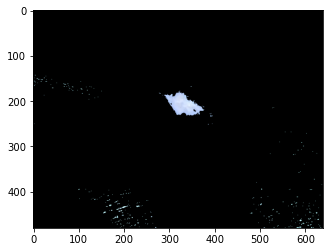

32484 Pixel in Video: 0392.mp4


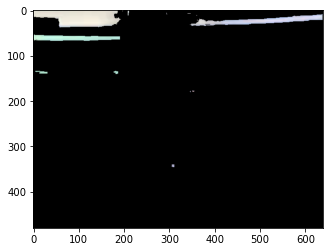

13782 Pixel in Video: 0392.mp4


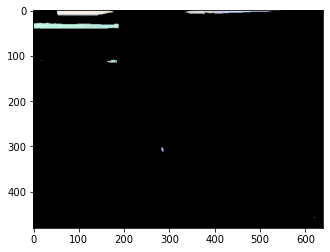

6399 Pixel in Video: 0392.mp4


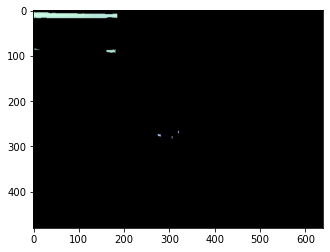

717 Pixel in Video: 0392.mp4


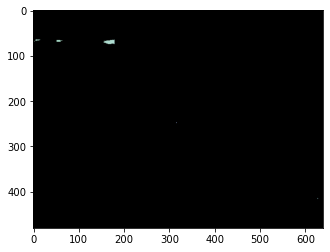

786 Pixel in Video: 0392.mp4


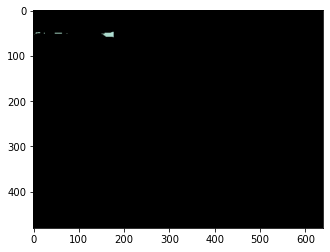

666 Pixel in Video: 0392.mp4


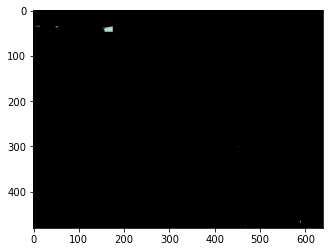

2493 Pixel in Video: 0392.mp4


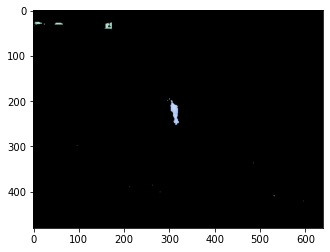

4200 Pixel in Video: 0392.mp4


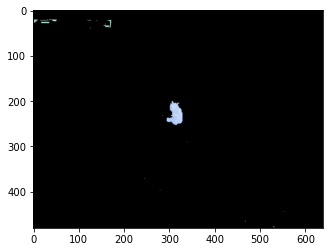

5967 Pixel in Video: 0392.mp4


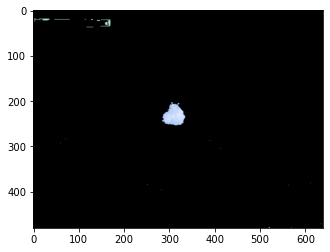

7539 Pixel in Video: 0392.mp4


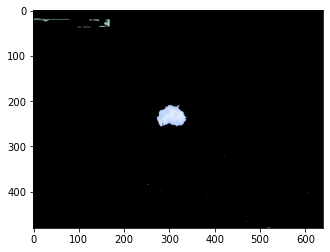

8844 Pixel in Video: 0392.mp4


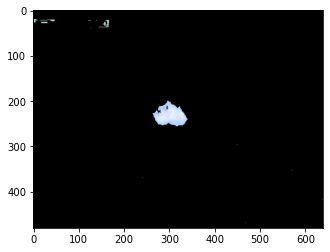

9600 Pixel in Video: 0392.mp4


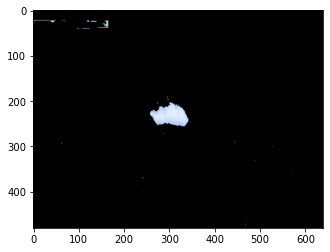

10635 Pixel in Video: 0392.mp4


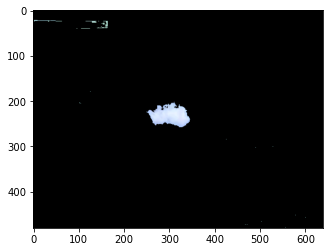

11112 Pixel in Video: 0392.mp4


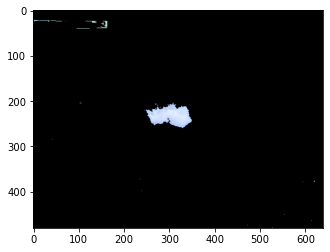

11085 Pixel in Video: 0392.mp4


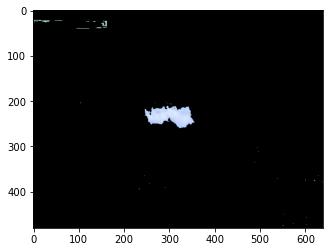

6480 Pixel in Video: 0393.mp4


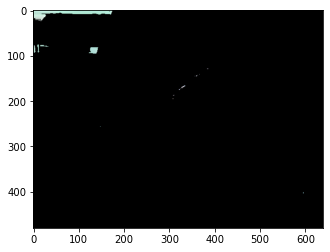

1761 Pixel in Video: 0393.mp4


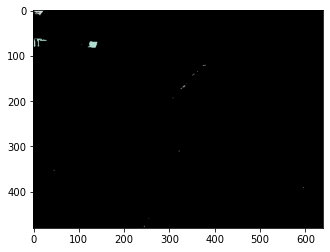

2490 Pixel in Video: 0393.mp4


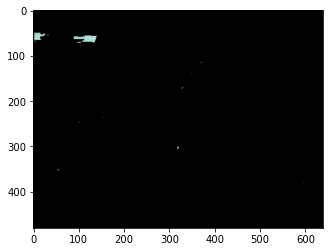

1734 Pixel in Video: 0393.mp4


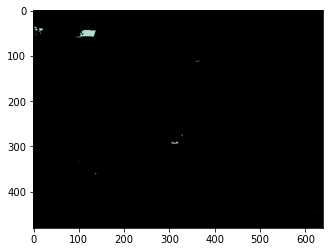

1602 Pixel in Video: 0393.mp4


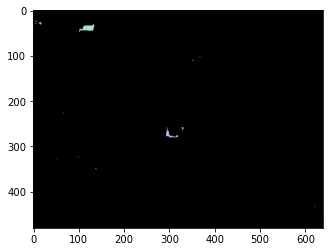

2253 Pixel in Video: 0393.mp4


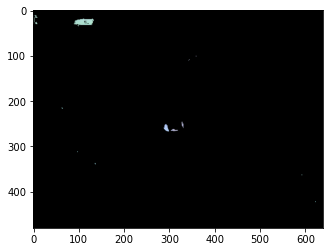

1155 Pixel in Video: 0393.mp4


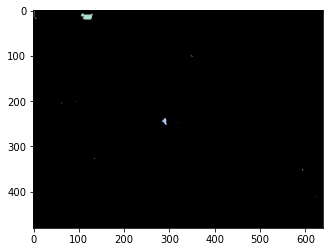

921 Pixel in Video: 0393.mp4


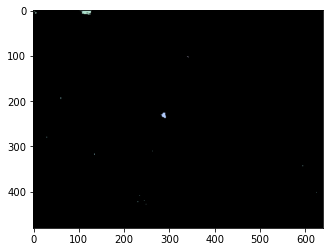

336 Pixel in Video: 0393.mp4


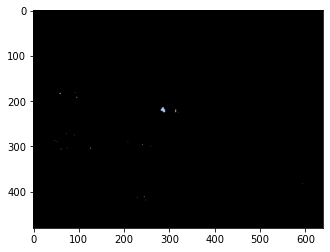

303 Pixel in Video: 0393.mp4


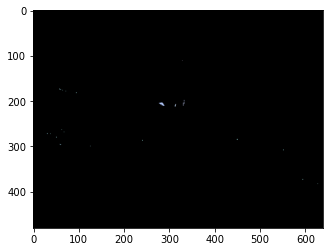

183 Pixel in Video: 0393.mp4


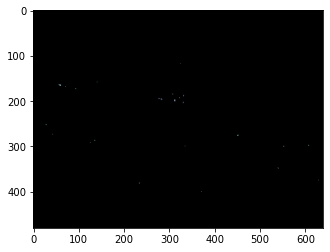

108 Pixel in Video: 0393.mp4


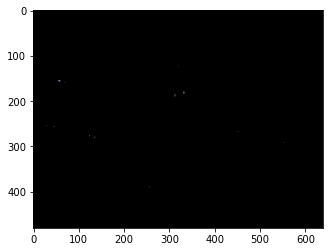

81 Pixel in Video: 0393.mp4


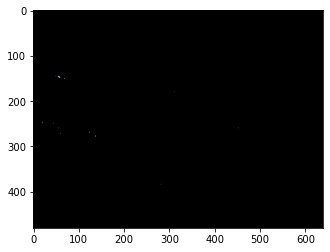

105 Pixel in Video: 0393.mp4


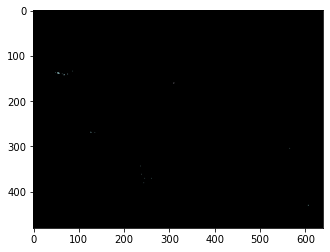

192 Pixel in Video: 0393.mp4


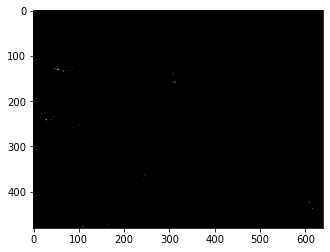

147 Pixel in Video: 0393.mp4


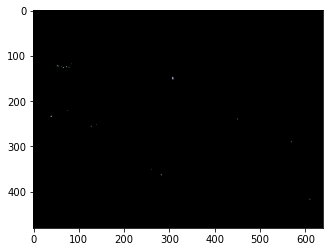

156 Pixel in Video: 0393.mp4


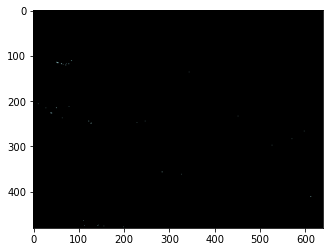

261 Pixel in Video: 0393.mp4


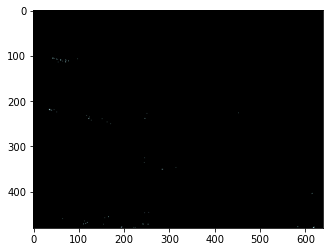

300 Pixel in Video: 0393.mp4


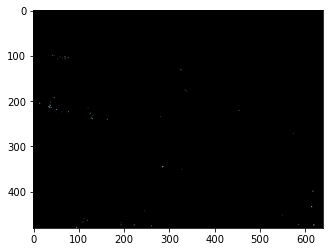

300 Pixel in Video: 0393.mp4


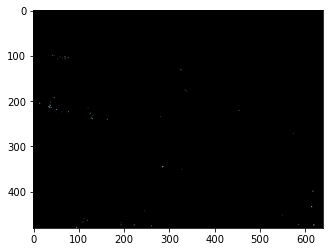

603 Pixel in Video: 0393.mp4


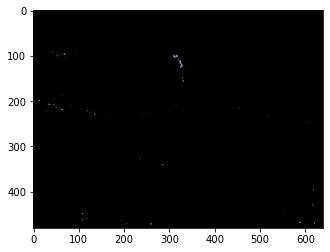

3762 Pixel in Video: 0393.mp4


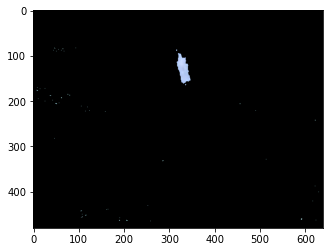

4683 Pixel in Video: 0393.mp4


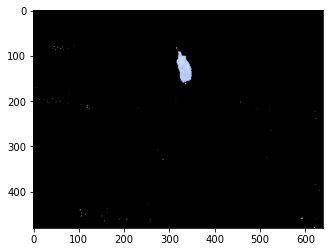

5103 Pixel in Video: 0393.mp4


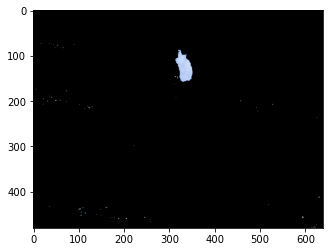

5982 Pixel in Video: 0393.mp4


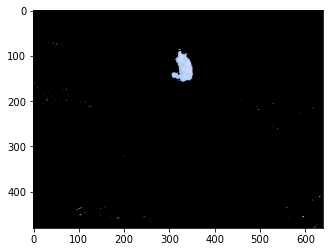

7023 Pixel in Video: 0393.mp4


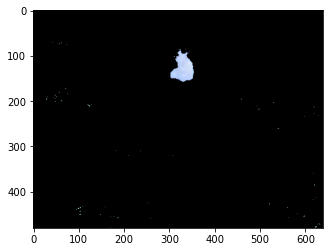

7788 Pixel in Video: 0393.mp4


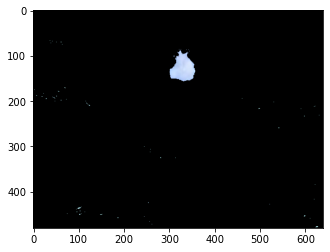

8601 Pixel in Video: 0393.mp4


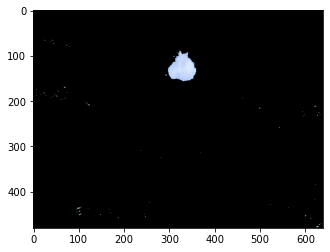

9612 Pixel in Video: 0393.mp4


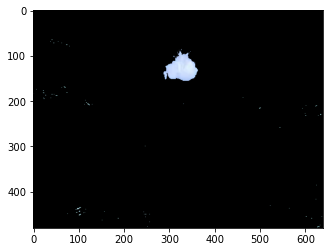

10554 Pixel in Video: 0393.mp4


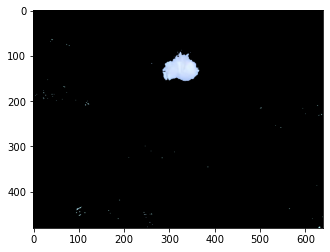

11499 Pixel in Video: 0393.mp4


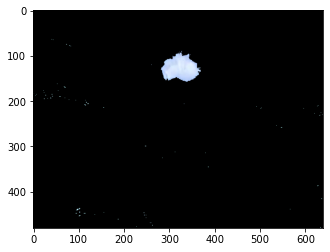

12126 Pixel in Video: 0393.mp4


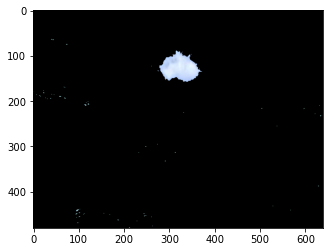

13281 Pixel in Video: 0393.mp4


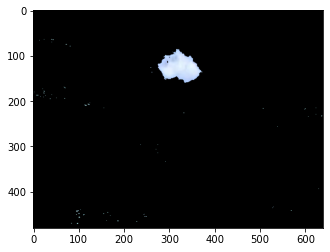

14226 Pixel in Video: 0393.mp4


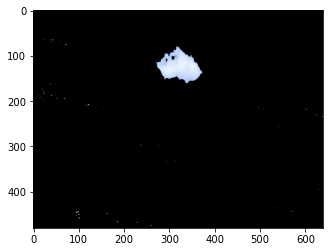

15132 Pixel in Video: 0393.mp4


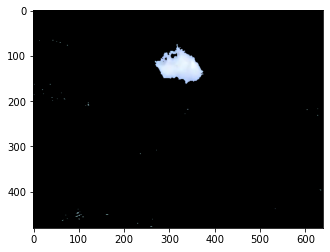

15687 Pixel in Video: 0393.mp4


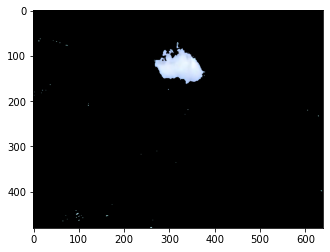

16230 Pixel in Video: 0393.mp4


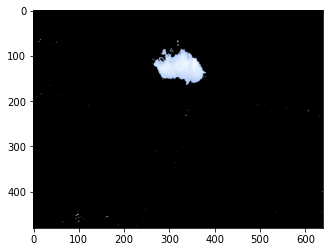

31119 Pixel in Video: 0395.mp4


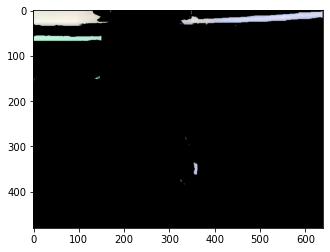

6099 Pixel in Video: 0395.mp4


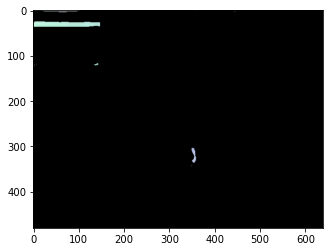

5745 Pixel in Video: 0395.mp4


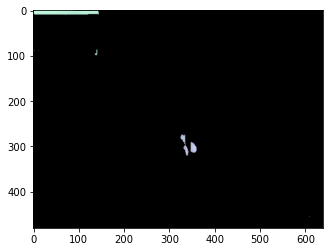

2058 Pixel in Video: 0395.mp4


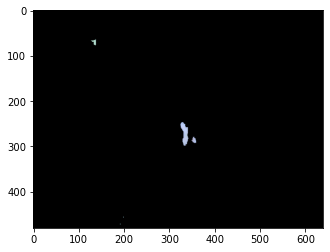

3909 Pixel in Video: 0395.mp4


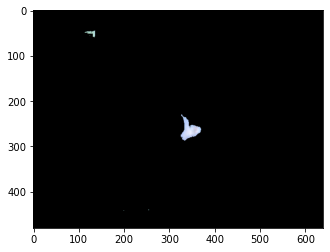

4884 Pixel in Video: 0395.mp4


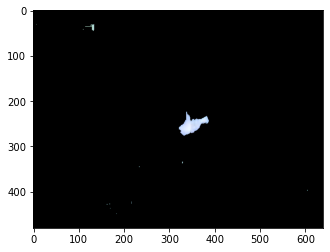

5109 Pixel in Video: 0395.mp4


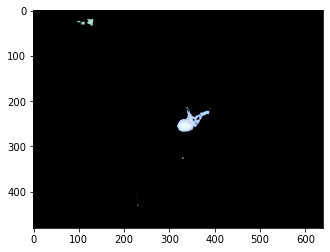

6732 Pixel in Video: 0398.mp4


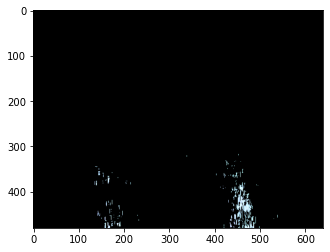

9039 Pixel in Video: 0398.mp4


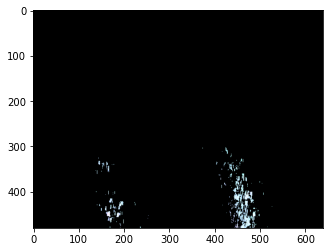

10737 Pixel in Video: 0398.mp4


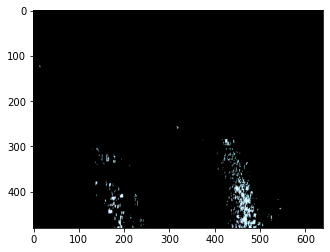

11022 Pixel in Video: 0398.mp4


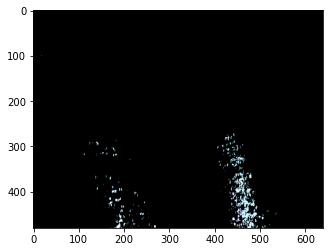

11091 Pixel in Video: 0398.mp4


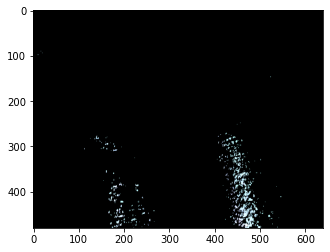

11697 Pixel in Video: 0398.mp4


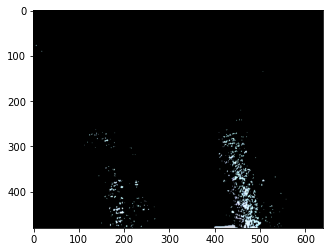

12732 Pixel in Video: 0398.mp4


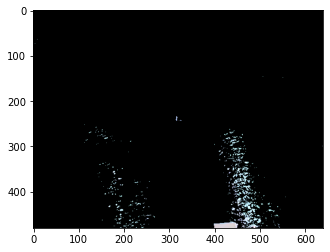

13983 Pixel in Video: 0398.mp4


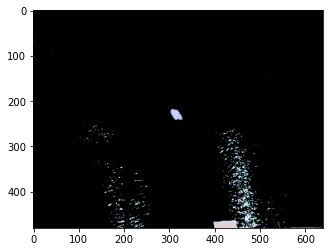

16509 Pixel in Video: 0398.mp4


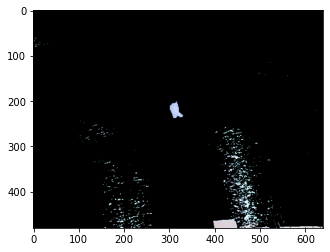

16938 Pixel in Video: 0398.mp4


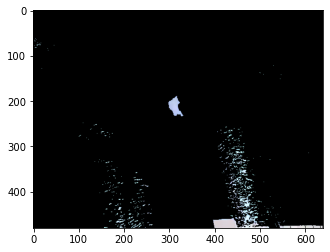

18204 Pixel in Video: 0398.mp4


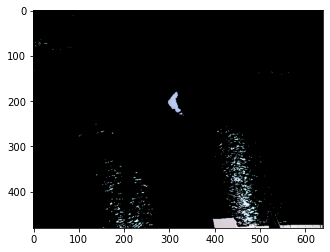

17589 Pixel in Video: 0398.mp4


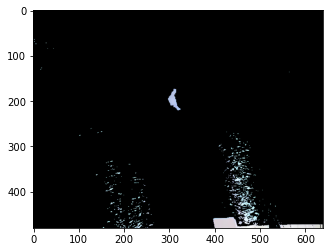

18621 Pixel in Video: 0398.mp4


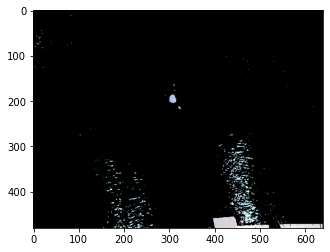

17796 Pixel in Video: 0398.mp4


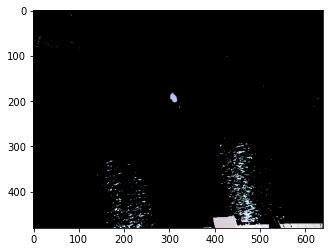

18876 Pixel in Video: 0398.mp4


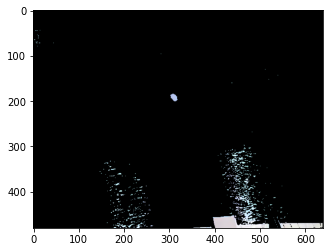

19362 Pixel in Video: 0398.mp4


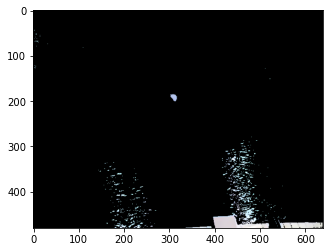

20148 Pixel in Video: 0398.mp4


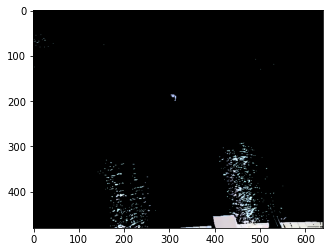

6021 Pixel in Video: 0400.mp4


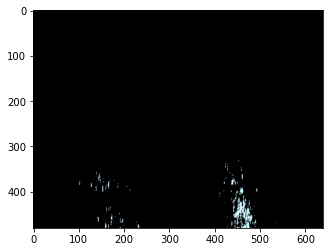

5952 Pixel in Video: 0400.mp4


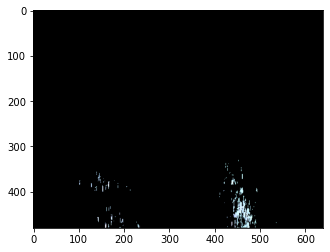

7251 Pixel in Video: 0400.mp4


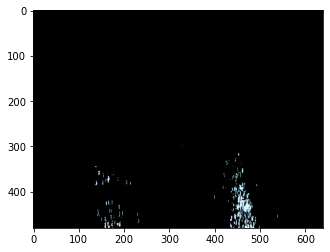

8835 Pixel in Video: 0400.mp4


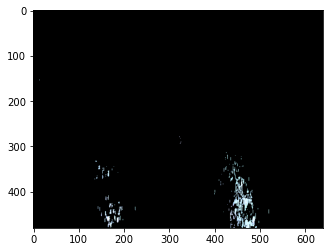

9822 Pixel in Video: 0400.mp4


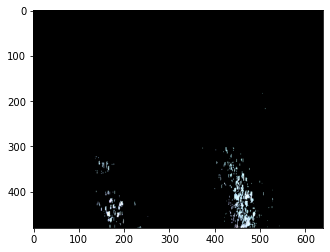

10626 Pixel in Video: 0400.mp4


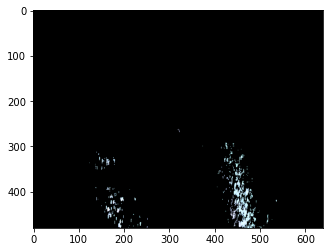

10593 Pixel in Video: 0400.mp4


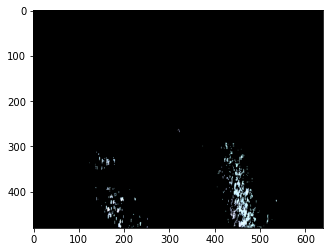

11112 Pixel in Video: 0400.mp4


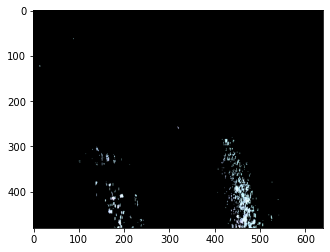

8529 Pixel in Video: 0402.mp4


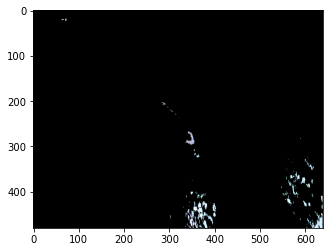

12411 Pixel in Video: 0402.mp4


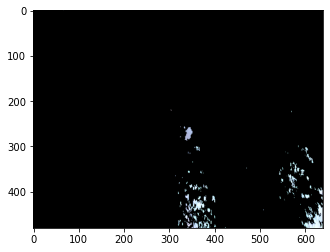

13590 Pixel in Video: 0402.mp4


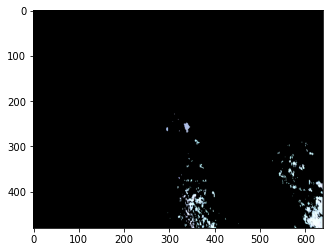

14067 Pixel in Video: 0402.mp4


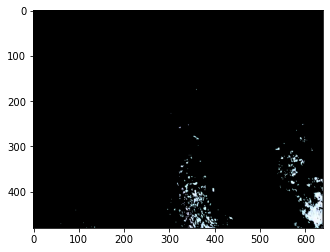

13038 Pixel in Video: 0402.mp4


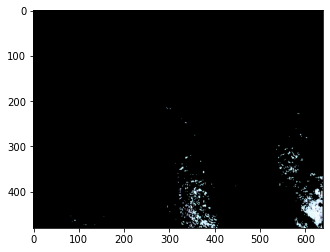

13872 Pixel in Video: 0402.mp4


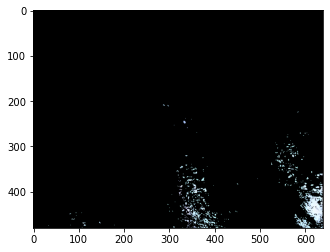

13683 Pixel in Video: 0402.mp4


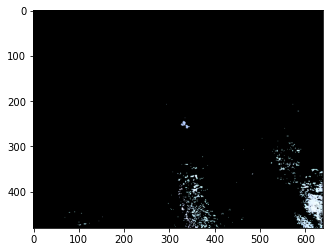

2823 Pixel in Video: 0403.mp4


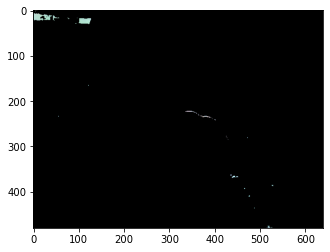

2142 Pixel in Video: 0403.mp4


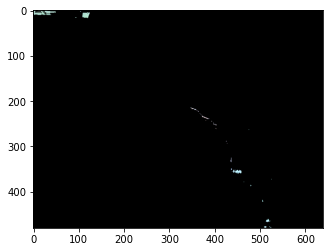

2289 Pixel in Video: 0403.mp4


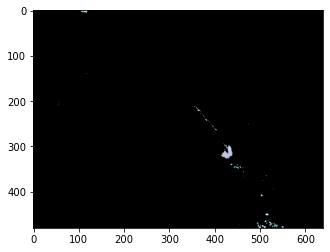

2676 Pixel in Video: 0403.mp4


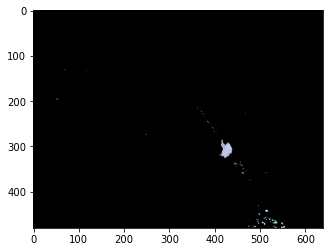

2337 Pixel in Video: 0403.mp4


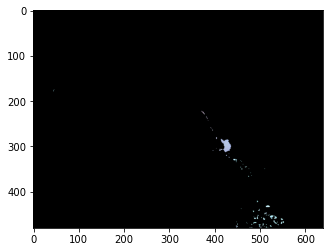

2907 Pixel in Video: 0403.mp4


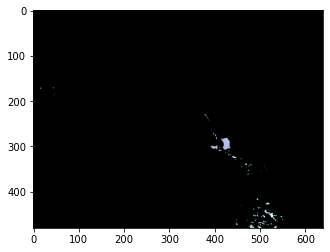

2619 Pixel in Video: 0403.mp4


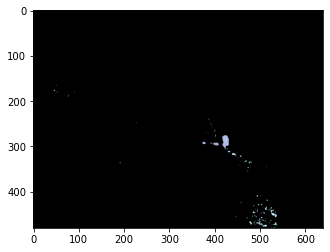

2709 Pixel in Video: 0403.mp4


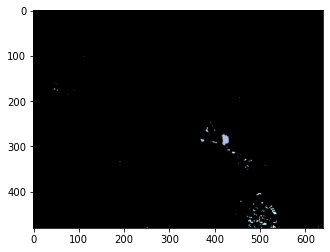

1890 Pixel in Video: 0403.mp4


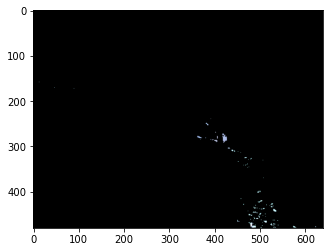

1701 Pixel in Video: 0403.mp4


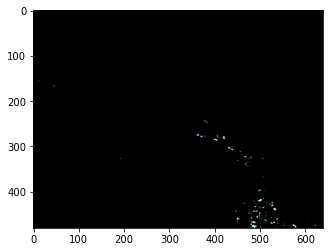

1584 Pixel in Video: 0403.mp4


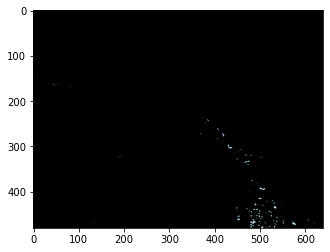

1815 Pixel in Video: 0403.mp4


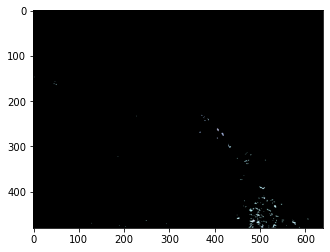

1542 Pixel in Video: 0403.mp4


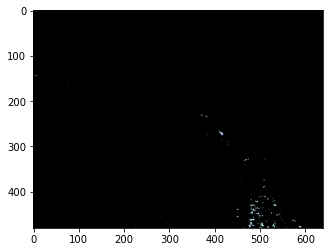

1668 Pixel in Video: 0403.mp4


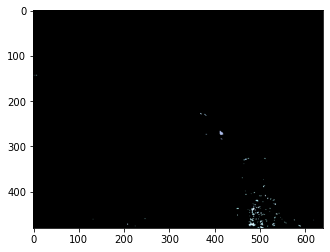

2256 Pixel in Video: 0403.mp4


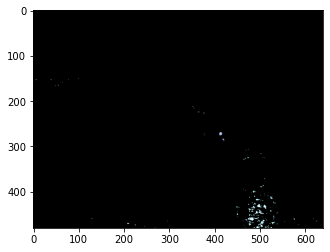

2427 Pixel in Video: 0403.mp4


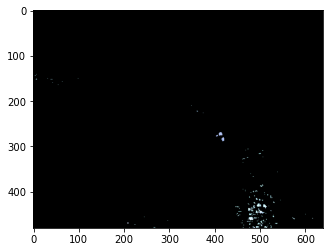

2181 Pixel in Video: 0403.mp4


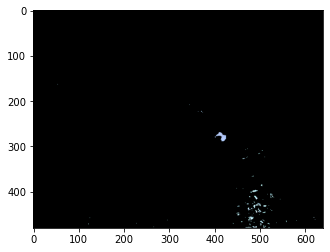

2544 Pixel in Video: 0403.mp4


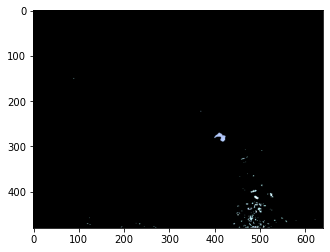

3168 Pixel in Video: 0403.mp4


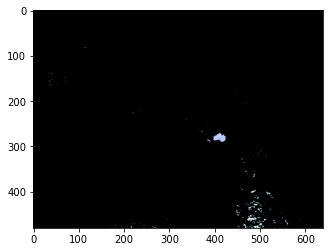

3531 Pixel in Video: 0403.mp4


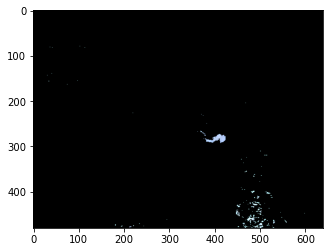

4023 Pixel in Video: 0403.mp4


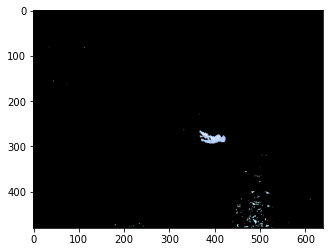

4866 Pixel in Video: 0403.mp4


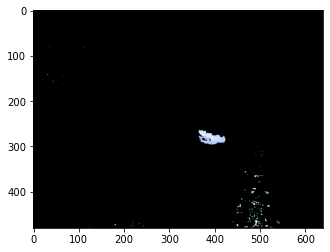

5493 Pixel in Video: 0403.mp4


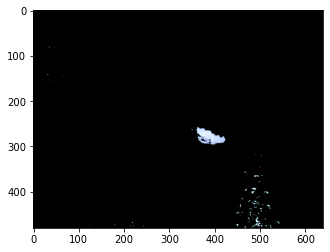

6690 Pixel in Video: 0403.mp4


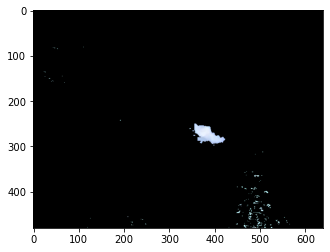

7491 Pixel in Video: 0403.mp4


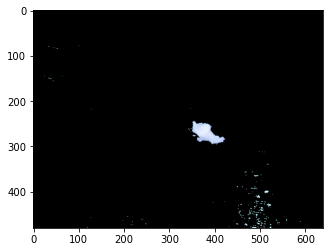

8412 Pixel in Video: 0403.mp4


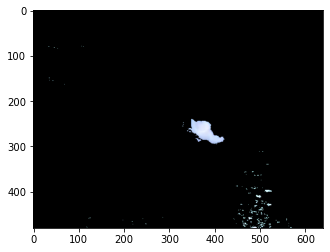

9015 Pixel in Video: 0403.mp4


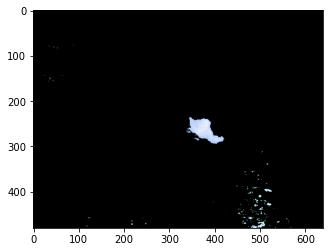

396 Pixel in Video: 0406.mp4


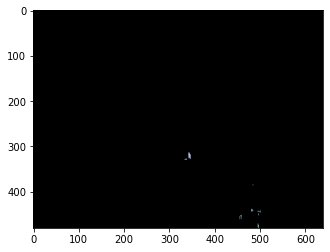

114 Pixel in Video: 0406.mp4


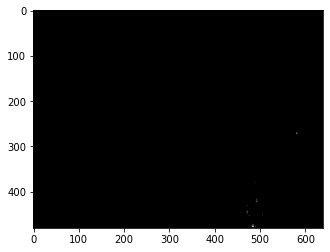

948 Pixel in Video: 0406.mp4


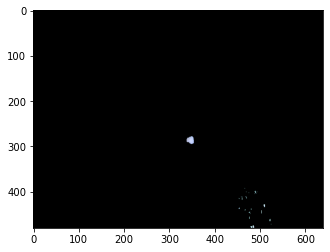

1587 Pixel in Video: 0406.mp4


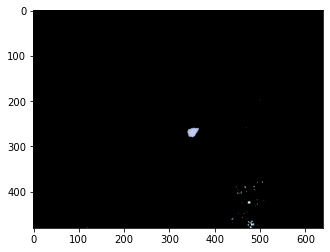

2664 Pixel in Video: 0406.mp4


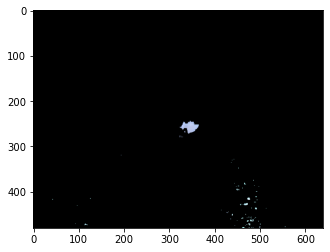

2124 Pixel in Video: 0406.mp4


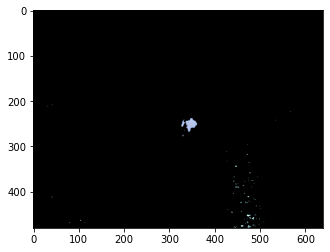

1593 Pixel in Video: 0406.mp4


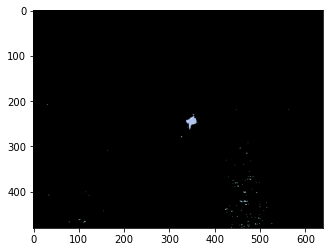

2181 Pixel in Video: 0406.mp4


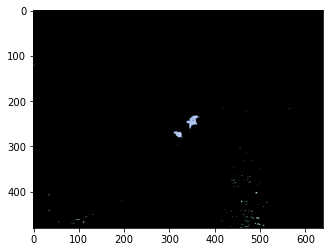

3525 Pixel in Video: 0406.mp4


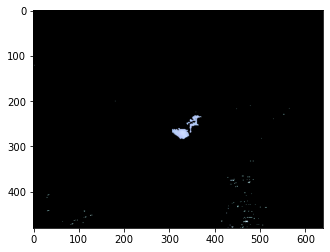

3996 Pixel in Video: 0406.mp4


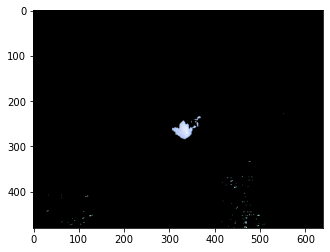

4680 Pixel in Video: 0406.mp4


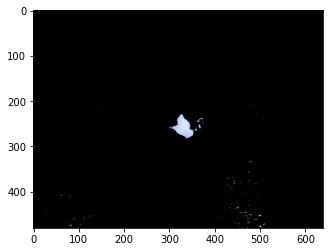

5550 Pixel in Video: 0406.mp4


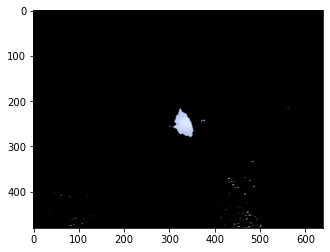

6705 Pixel in Video: 0406.mp4


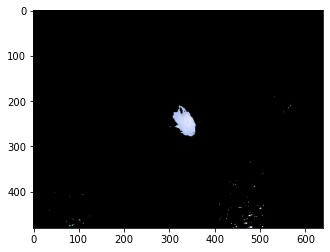

7005 Pixel in Video: 0406.mp4


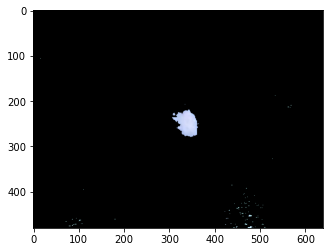

7965 Pixel in Video: 0406.mp4


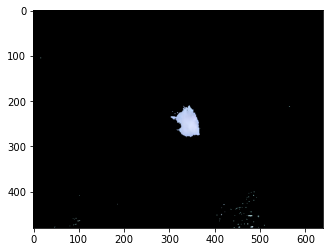

7857 Pixel in Video: 0406.mp4


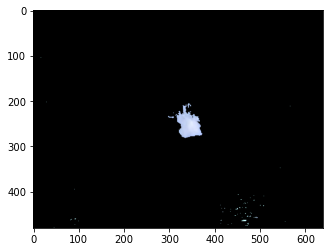

7278 Pixel in Video: 0406.mp4


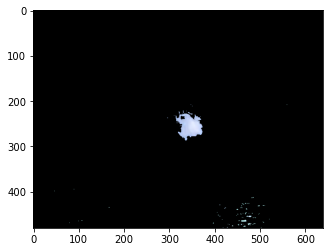

6327 Pixel in Video: 0406.mp4


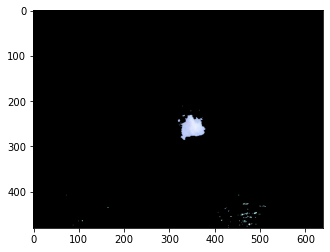

5808 Pixel in Video: 0406.mp4


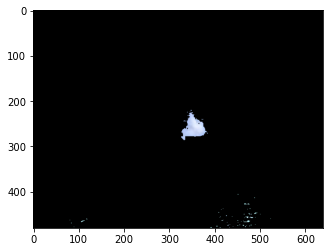

5370 Pixel in Video: 0406.mp4


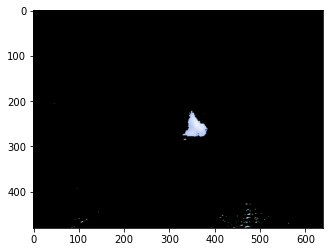

5397 Pixel in Video: 0406.mp4


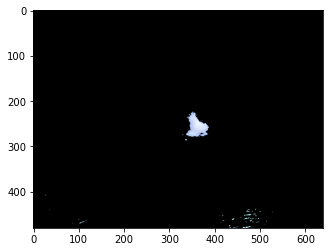

6144 Pixel in Video: 0406.mp4


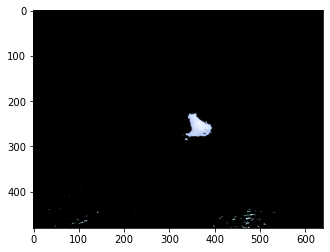

6399 Pixel in Video: 0406.mp4


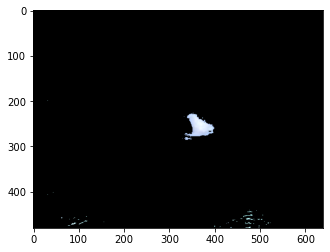

6348 Pixel in Video: 0406.mp4


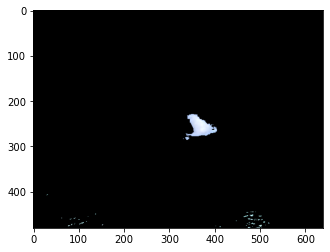

6336 Pixel in Video: 0406.mp4


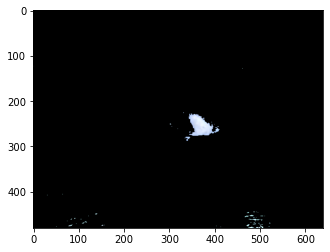

6336 Pixel in Video: 0406.mp4


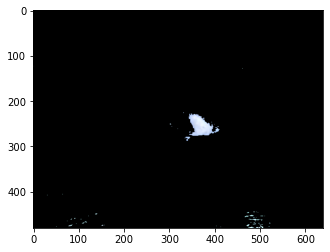

6207 Pixel in Video: 0406.mp4


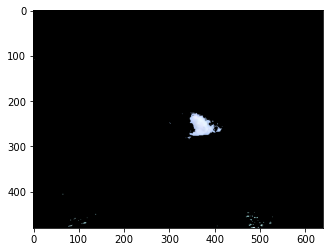

5466 Pixel in Video: 0406.mp4


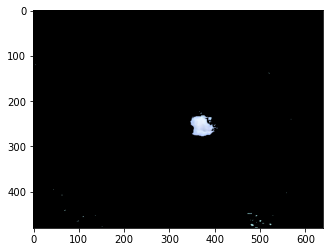

5709 Pixel in Video: 0406.mp4


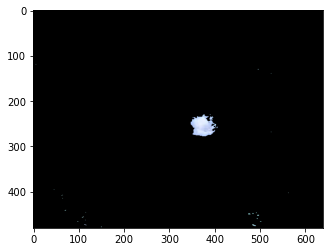

5562 Pixel in Video: 0406.mp4


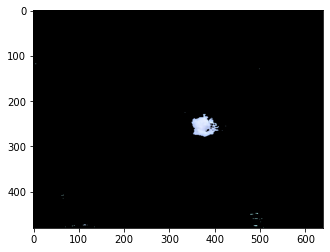

5430 Pixel in Video: 0406.mp4


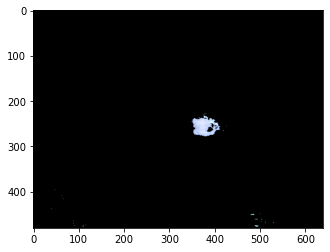

5208 Pixel in Video: 0406.mp4


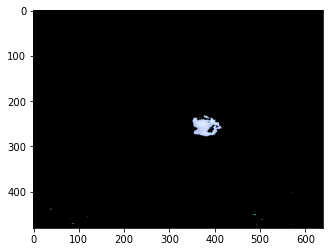

5211 Pixel in Video: 0406.mp4


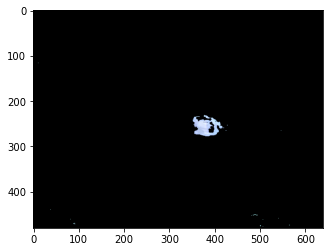

744 Pixel in Video: 0406.mp4


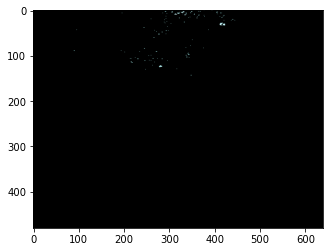

432 Pixel in Video: 0406.mp4


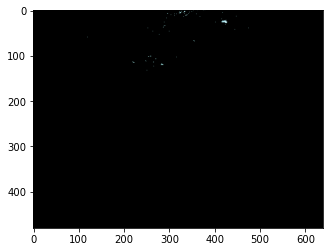

312 Pixel in Video: 0406.mp4


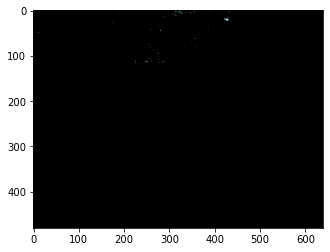

249 Pixel in Video: 0406.mp4


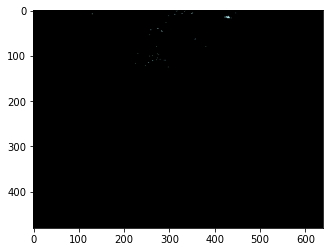

249 Pixel in Video: 0406.mp4


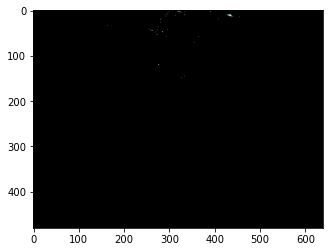

183 Pixel in Video: 0406.mp4


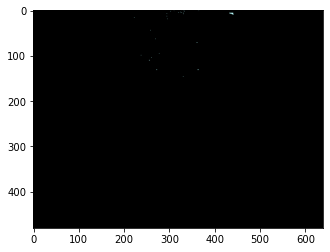

183 Pixel in Video: 0406.mp4


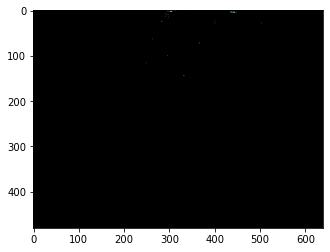

183 Pixel in Video: 0406.mp4


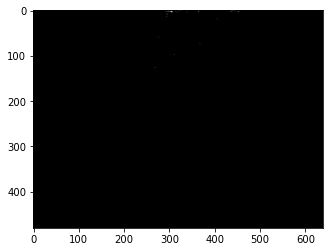

1080 Pixel in Video: 0407.mp4


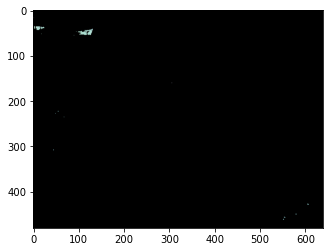

1080 Pixel in Video: 0407.mp4


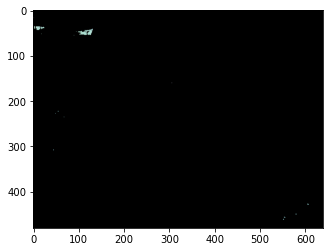

1161 Pixel in Video: 0407.mp4


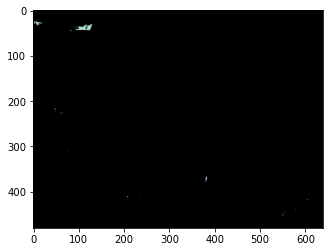

2025 Pixel in Video: 0407.mp4


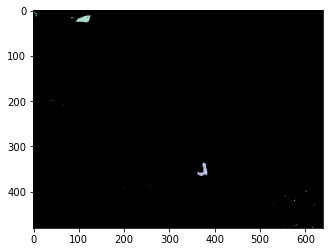

1902 Pixel in Video: 0407.mp4


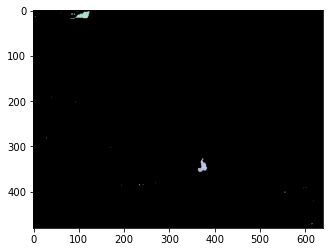

1233 Pixel in Video: 0407.mp4


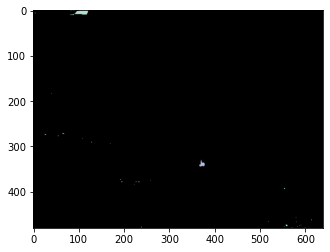

270 Pixel in Video: 0407.mp4


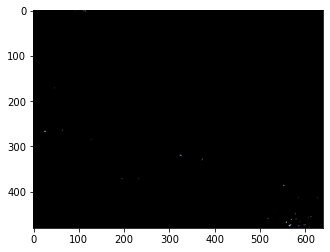

261 Pixel in Video: 0407.mp4


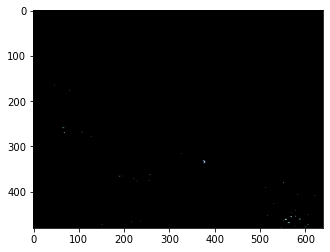

1032 Pixel in Video: 0407.mp4


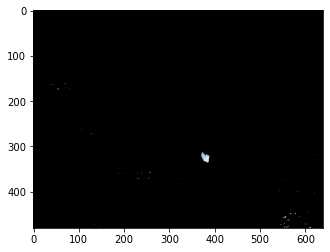

1491 Pixel in Video: 0407.mp4


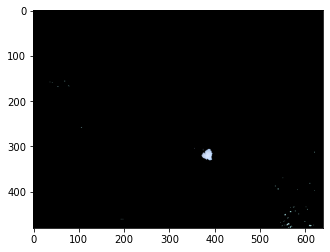

1983 Pixel in Video: 0407.mp4


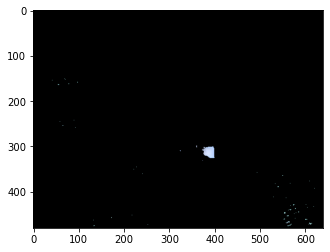

2196 Pixel in Video: 0407.mp4


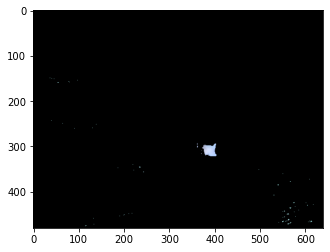

2436 Pixel in Video: 0407.mp4


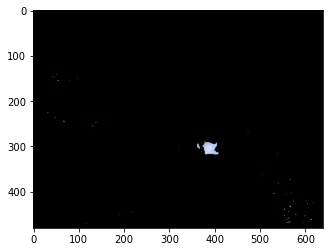

2439 Pixel in Video: 0407.mp4


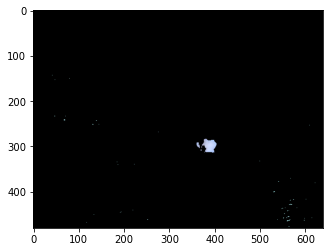

3360 Pixel in Video: 0407.mp4


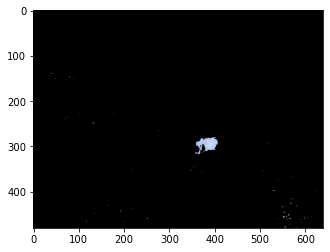

3840 Pixel in Video: 0407.mp4


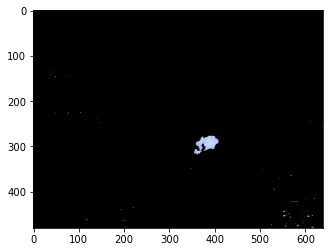

4035 Pixel in Video: 0407.mp4


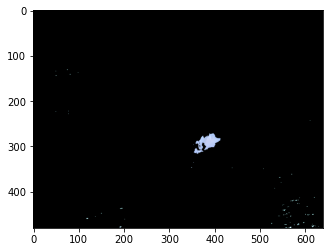

3876 Pixel in Video: 0407.mp4


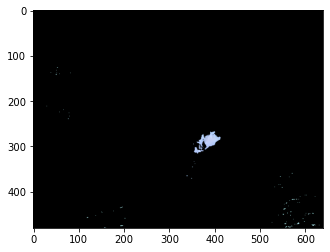

3867 Pixel in Video: 0407.mp4


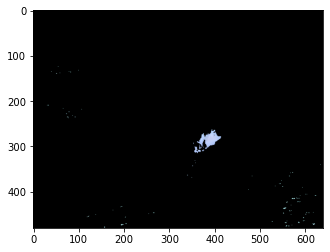

3537 Pixel in Video: 0407.mp4


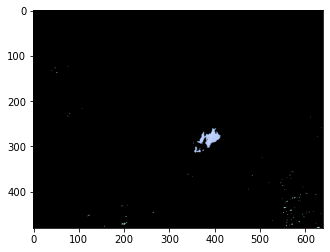

3216 Pixel in Video: 0407.mp4


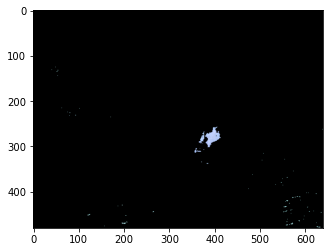

3300 Pixel in Video: 0407.mp4


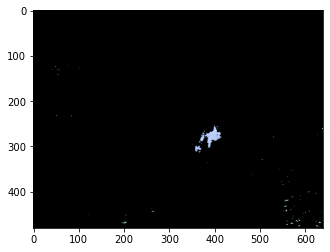

3372 Pixel in Video: 0407.mp4


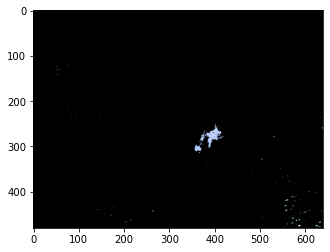

3360 Pixel in Video: 0407.mp4


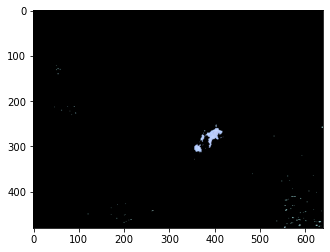

3591 Pixel in Video: 0407.mp4


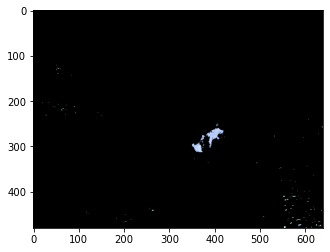

3831 Pixel in Video: 0407.mp4


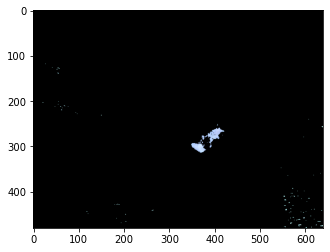

4383 Pixel in Video: 0407.mp4


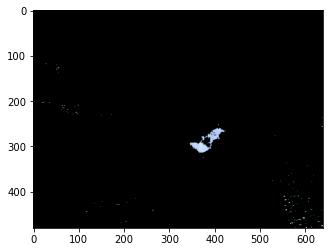

5058 Pixel in Video: 0407.mp4


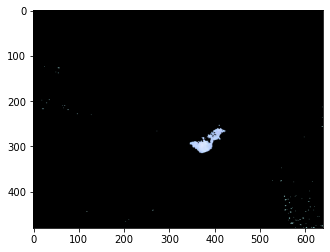

5637 Pixel in Video: 0407.mp4


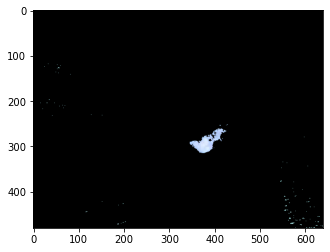

5559 Pixel in Video: 0407.mp4


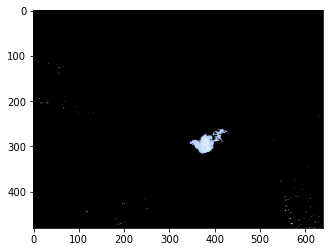

5901 Pixel in Video: 0407.mp4


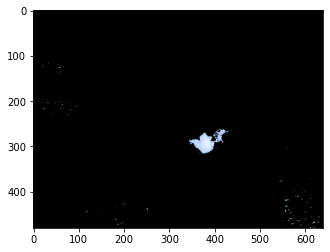

5907 Pixel in Video: 0407.mp4


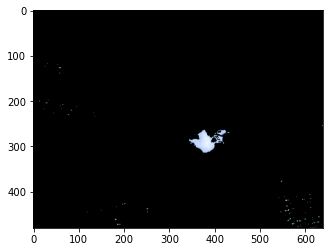

6171 Pixel in Video: 0407.mp4


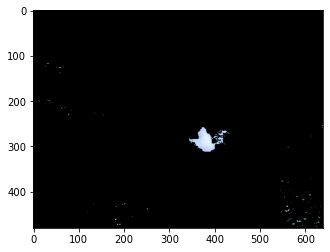

6492 Pixel in Video: 0407.mp4


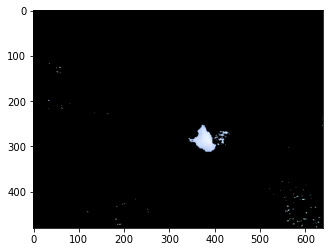

6819 Pixel in Video: 0407.mp4


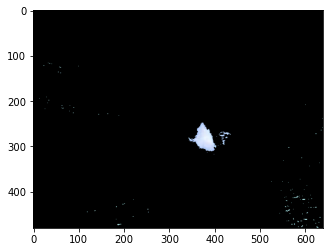

7029 Pixel in Video: 0407.mp4


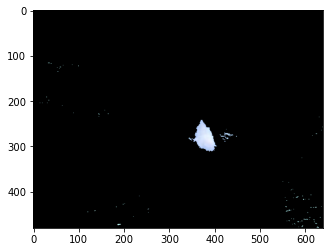

7254 Pixel in Video: 0407.mp4


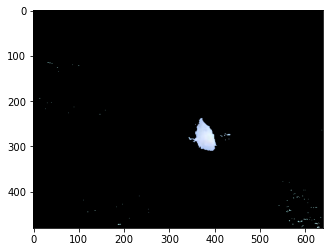

8067 Pixel in Video: 0407.mp4


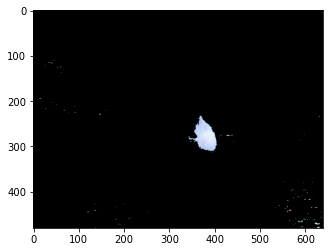

19134 Pixel in Video: 0409.mp4


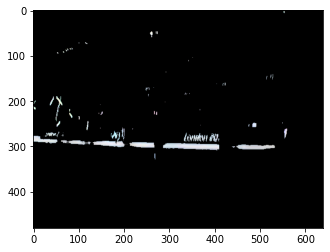

16074 Pixel in Video: 0409.mp4


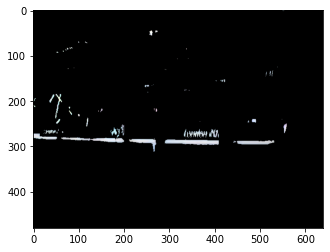

8061 Pixel in Video: 0409.mp4


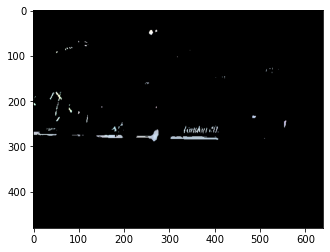

7869 Pixel in Video: 0409.mp4


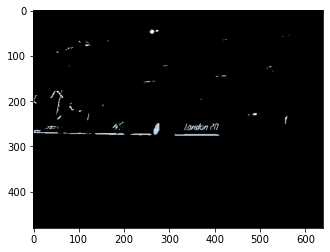

1716 Pixel in Video: 0409.mp4


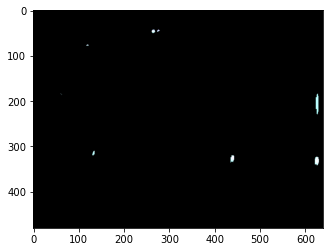

930 Pixel in Video: 0409.mp4


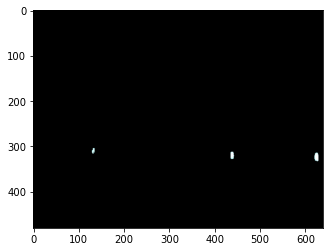

957 Pixel in Video: 0409.mp4


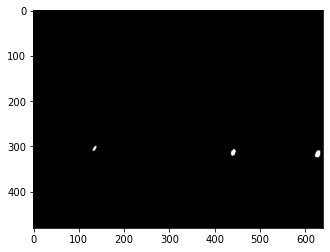

801 Pixel in Video: 0409.mp4


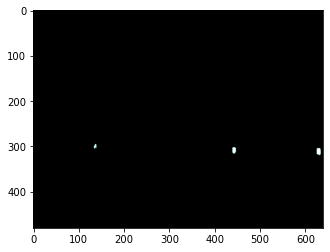

777 Pixel in Video: 0409.mp4


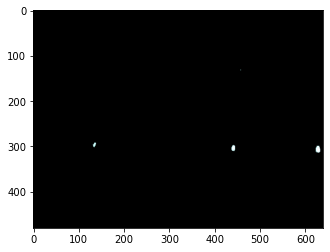

777 Pixel in Video: 0409.mp4


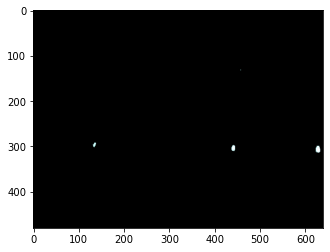

816 Pixel in Video: 0409.mp4


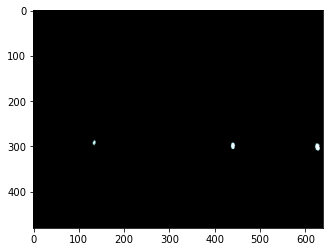

954 Pixel in Video: 0409.mp4


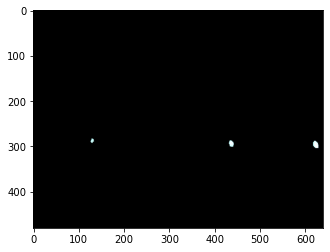

795 Pixel in Video: 0409.mp4


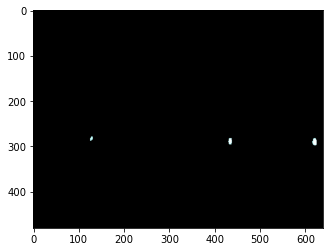

789 Pixel in Video: 0409.mp4


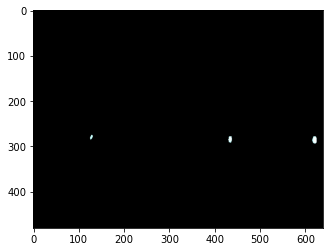

840 Pixel in Video: 0409.mp4


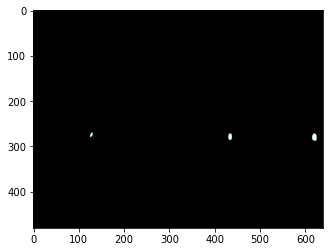

837 Pixel in Video: 0409.mp4


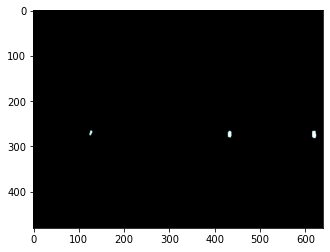

837 Pixel in Video: 0409.mp4


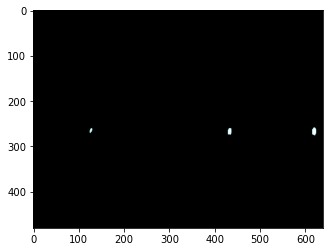

813 Pixel in Video: 0409.mp4


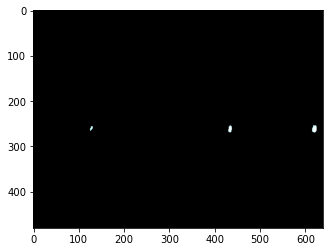

897 Pixel in Video: 0409.mp4


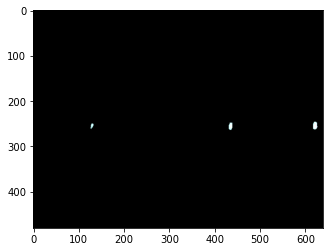

864 Pixel in Video: 0409.mp4


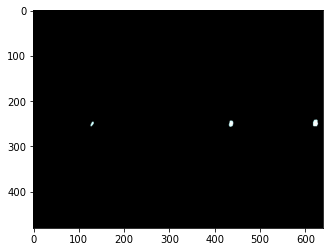

747 Pixel in Video: 0409.mp4


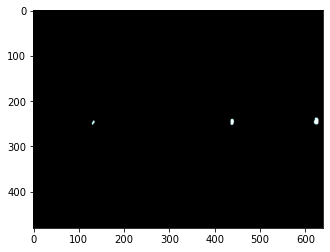

747 Pixel in Video: 0409.mp4


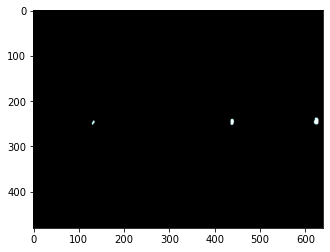

2478 Pixel in Video: 0411.mp4


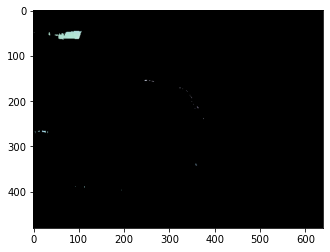

2469 Pixel in Video: 0411.mp4


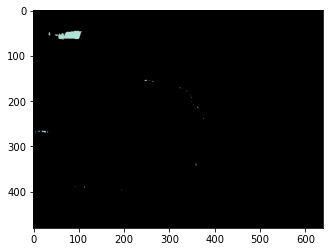

1998 Pixel in Video: 0411.mp4


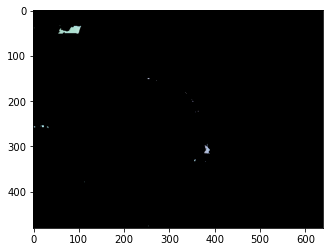

4296 Pixel in Video: 0411.mp4


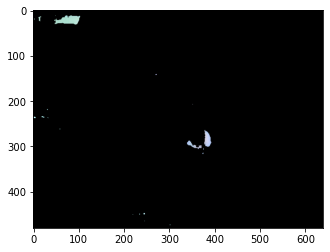

4785 Pixel in Video: 0411.mp4


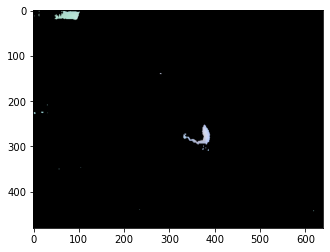

4194 Pixel in Video: 0411.mp4


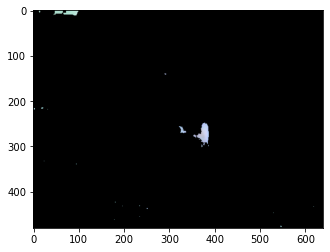

3204 Pixel in Video: 0411.mp4


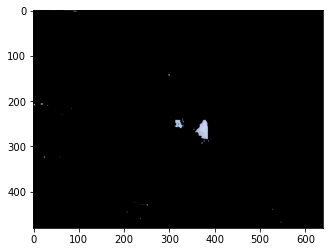

3291 Pixel in Video: 0411.mp4


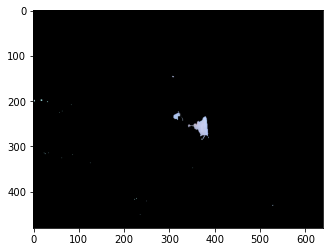

4158 Pixel in Video: 0411.mp4


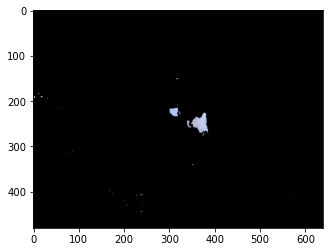

4074 Pixel in Video: 0411.mp4


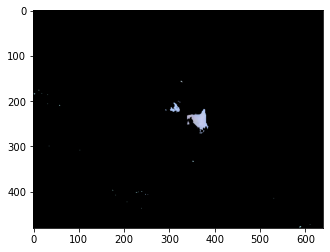

3027 Pixel in Video: 0411.mp4


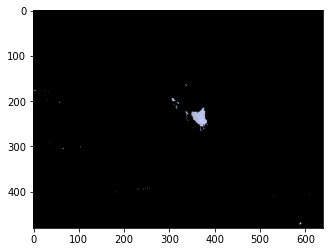

2421 Pixel in Video: 0411.mp4


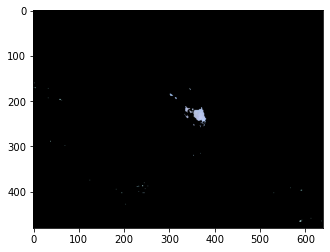

2418 Pixel in Video: 0411.mp4


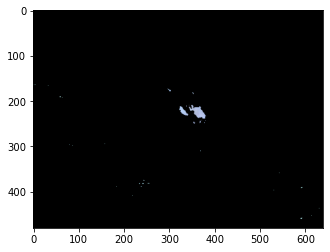

1902 Pixel in Video: 0411.mp4


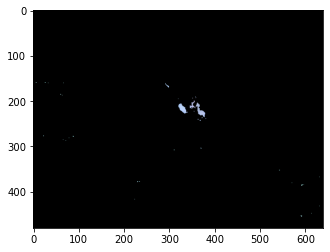

1572 Pixel in Video: 0411.mp4


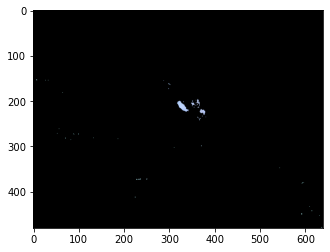

1461 Pixel in Video: 0411.mp4


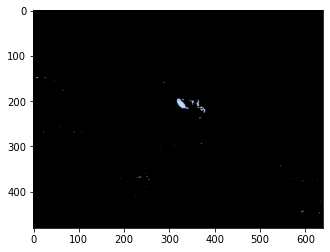

1692 Pixel in Video: 0411.mp4


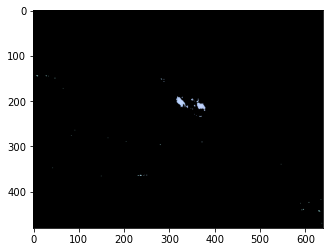

2049 Pixel in Video: 0411.mp4


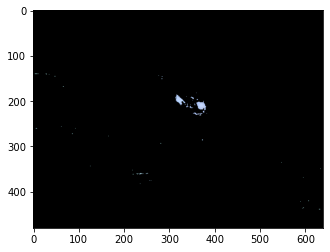

2496 Pixel in Video: 0411.mp4


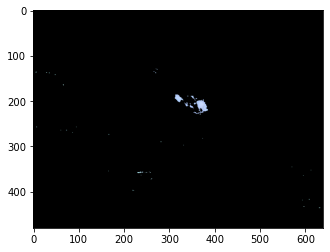

2664 Pixel in Video: 0411.mp4


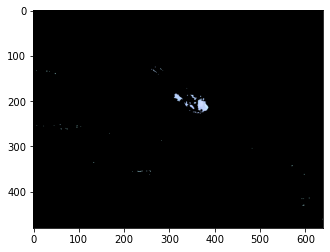

3726 Pixel in Video: 0411.mp4


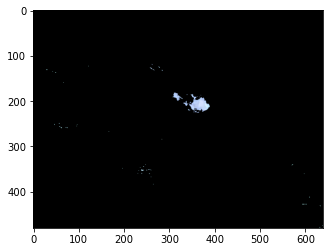

4140 Pixel in Video: 0411.mp4


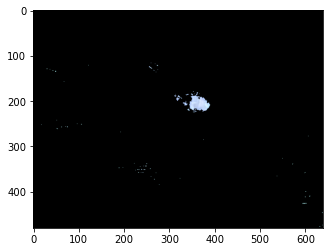

5010 Pixel in Video: 0411.mp4


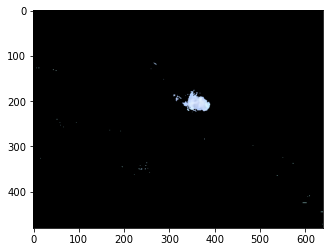

5970 Pixel in Video: 0411.mp4


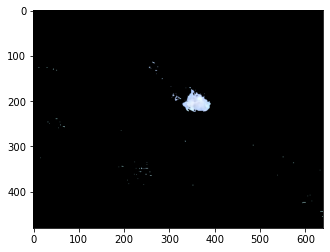

6429 Pixel in Video: 0411.mp4


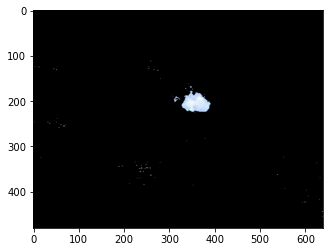

6672 Pixel in Video: 0411.mp4


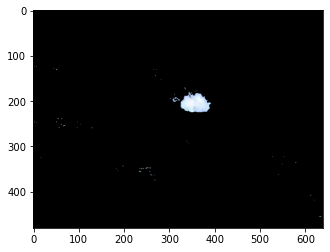

7308 Pixel in Video: 0411.mp4


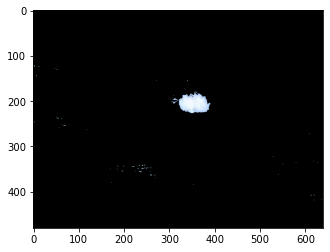

7770 Pixel in Video: 0411.mp4


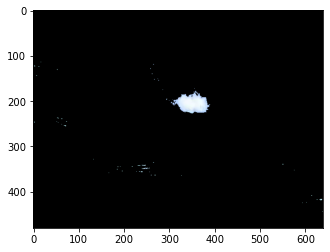

8433 Pixel in Video: 0411.mp4


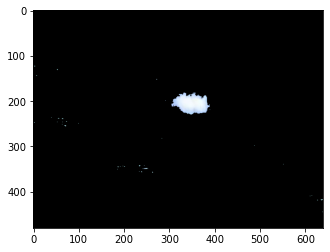

9831 Pixel in Video: 0411.mp4


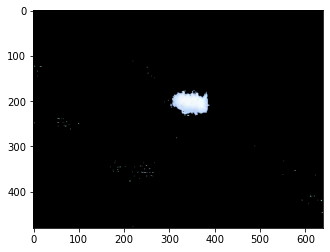

11070 Pixel in Video: 0411.mp4


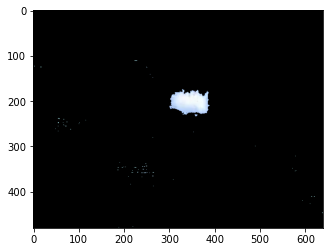

11739 Pixel in Video: 0411.mp4


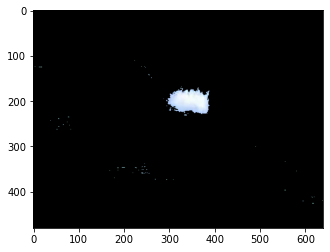

12780 Pixel in Video: 0411.mp4


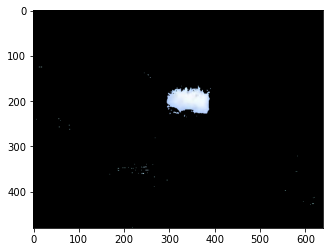

13587 Pixel in Video: 0411.mp4


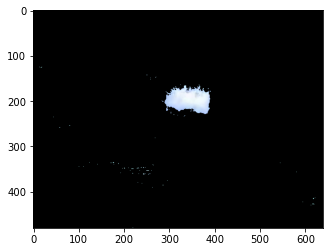

14175 Pixel in Video: 0411.mp4


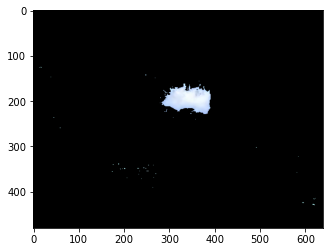

15879 Pixel in Video: 0411.mp4


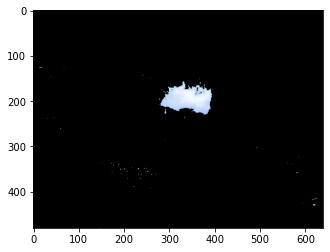

16476 Pixel in Video: 0411.mp4


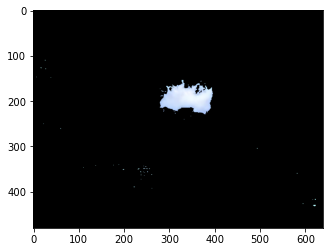

17379 Pixel in Video: 0411.mp4


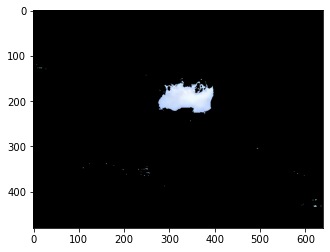

18318 Pixel in Video: 0411.mp4


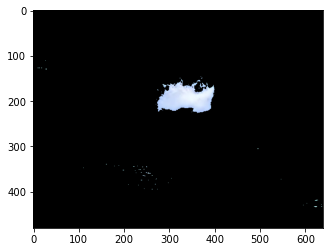

19092 Pixel in Video: 0411.mp4


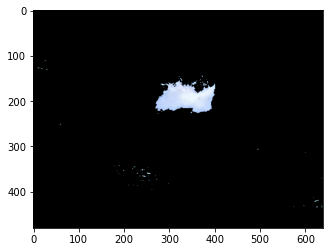

19272 Pixel in Video: 0411.mp4


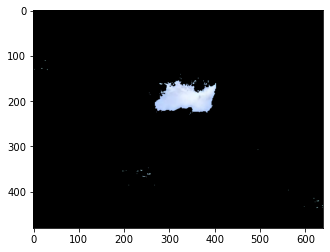

20445 Pixel in Video: 0411.mp4


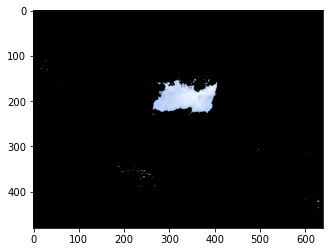

20565 Pixel in Video: 0411.mp4


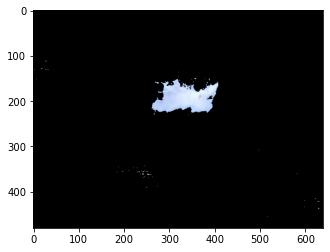

21312 Pixel in Video: 0411.mp4


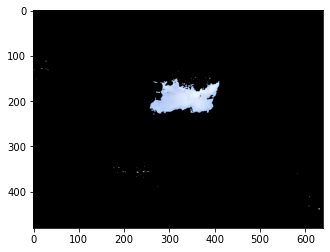

22074 Pixel in Video: 0411.mp4


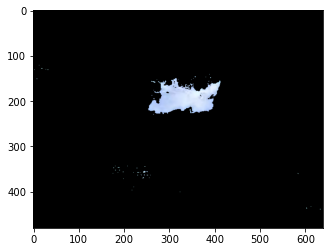

1191 Pixel in Video: 0413.mp4


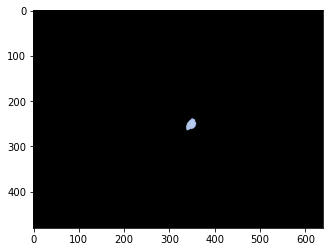

90 Pixel in Video: 0413.mp4


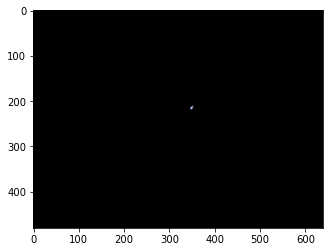

9 Pixel in Video: 0413.mp4


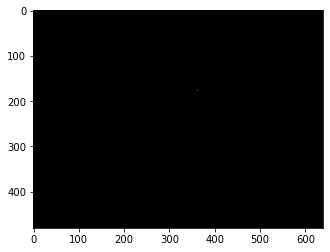

126 Pixel in Video: 0413.mp4


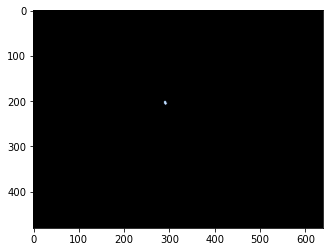

21 Pixel in Video: 0413.mp4


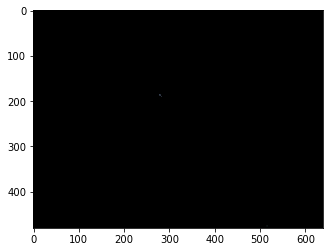

129 Pixel in Video: 0413.mp4


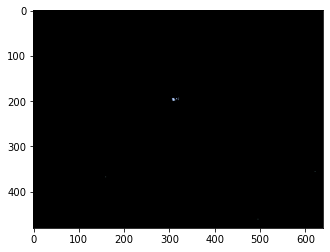

1926 Pixel in Video: 0413.mp4


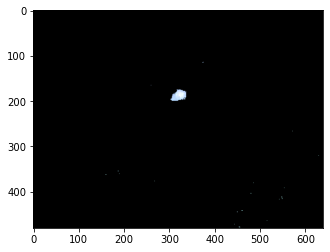

5040 Pixel in Video: 0413.mp4


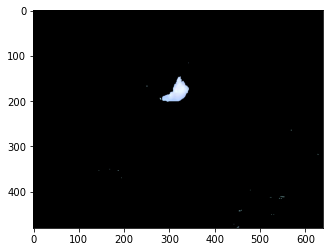

7923 Pixel in Video: 0413.mp4


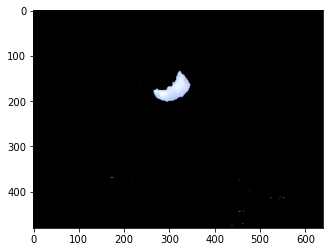

10125 Pixel in Video: 0413.mp4


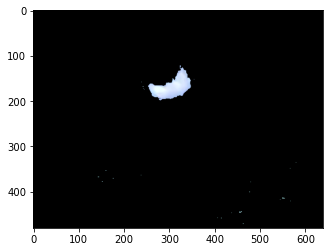

42 Pixel in Video: 0414.mp4


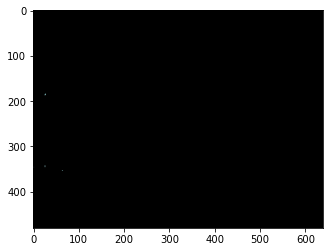

99 Pixel in Video: 0414.mp4


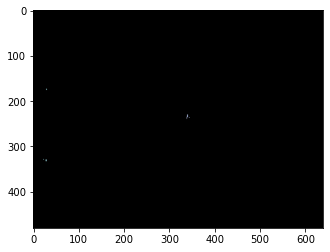

1047 Pixel in Video: 0414.mp4


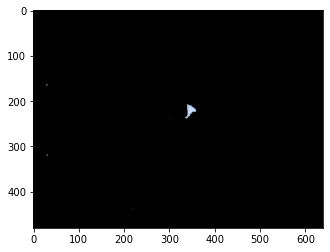

1860 Pixel in Video: 0414.mp4


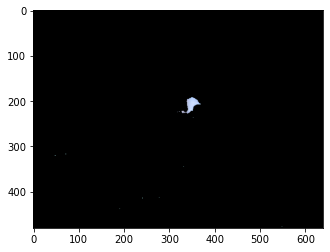

2475 Pixel in Video: 0414.mp4


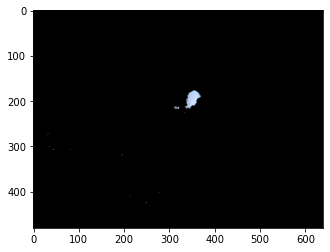

2553 Pixel in Video: 0414.mp4


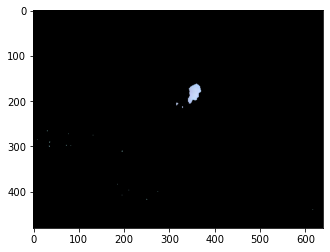

2679 Pixel in Video: 0414.mp4


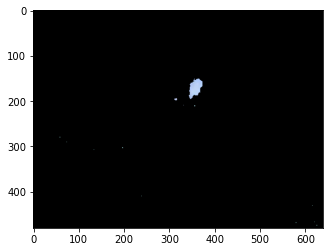

2415 Pixel in Video: 0414.mp4


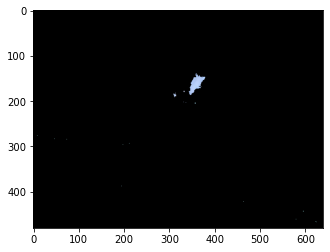

1500 Pixel in Video: 0414.mp4


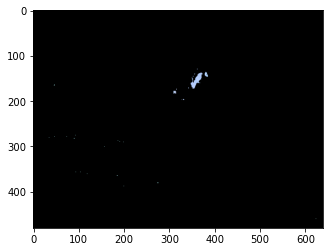

861 Pixel in Video: 0414.mp4


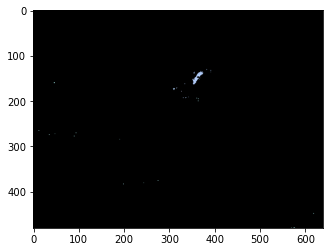

582 Pixel in Video: 0414.mp4


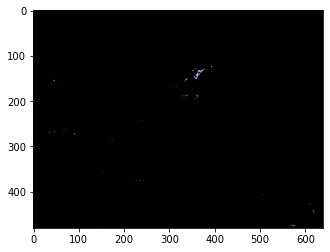

450 Pixel in Video: 0414.mp4


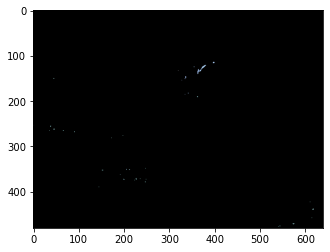

342 Pixel in Video: 0414.mp4


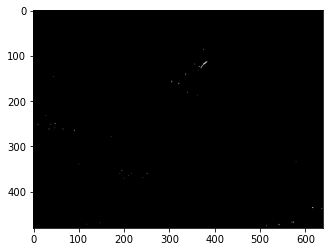

246 Pixel in Video: 0414.mp4


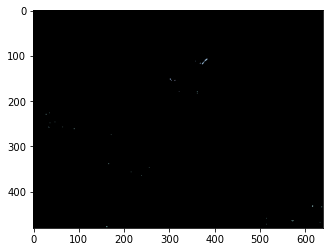

603 Pixel in Video: 0414.mp4


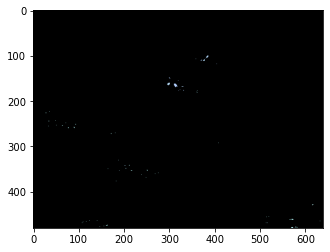

1002 Pixel in Video: 0414.mp4


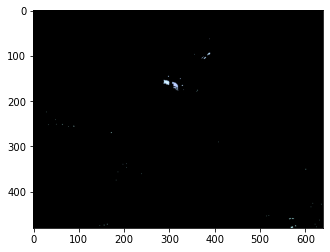

1281 Pixel in Video: 0414.mp4


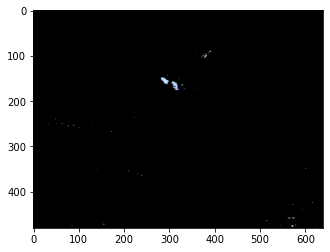

1323 Pixel in Video: 0414.mp4


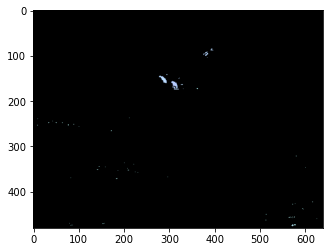

0 Pixel in Video: 0416.mp4


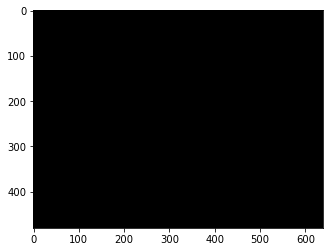

684 Pixel in Video: 0416.mp4


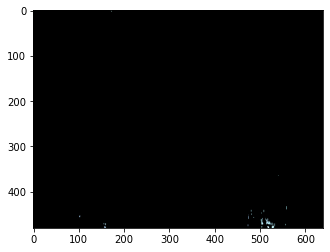

1497 Pixel in Video: 0416.mp4


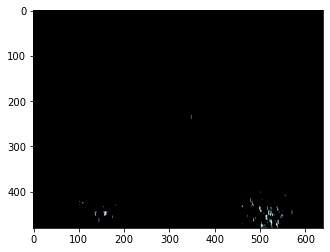

2157 Pixel in Video: 0416.mp4


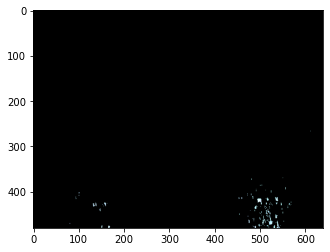

2679 Pixel in Video: 0416.mp4


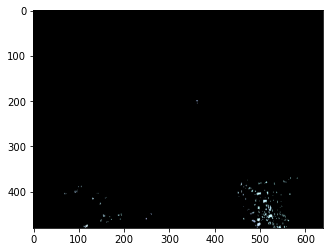

2781 Pixel in Video: 0416.mp4


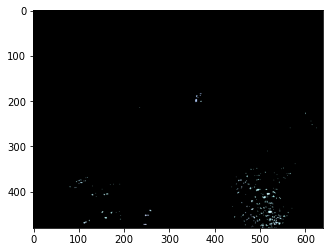

2979 Pixel in Video: 0416.mp4


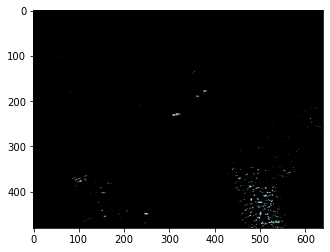

3909 Pixel in Video: 0416.mp4


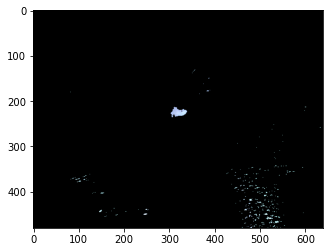

7017 Pixel in Video: 0416.mp4


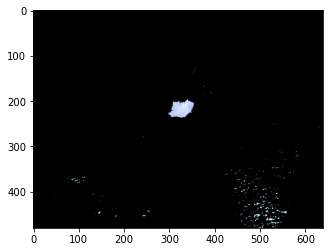

9123 Pixel in Video: 0416.mp4


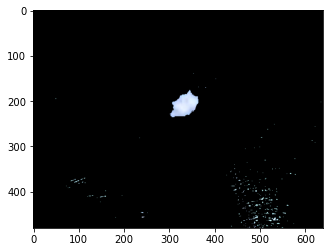

12324 Pixel in Video: 0416.mp4


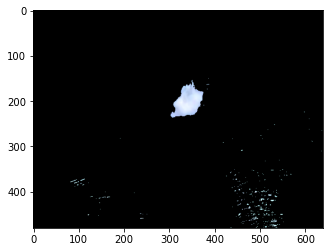

12933 Pixel in Video: 0416.mp4


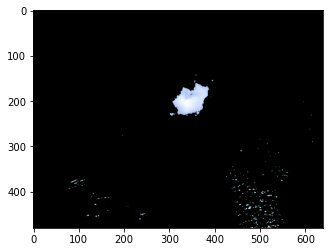

13884 Pixel in Video: 0416.mp4


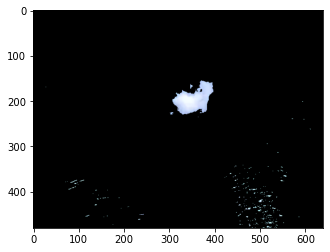

14823 Pixel in Video: 0416.mp4


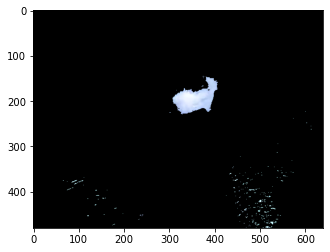

15744 Pixel in Video: 0416.mp4


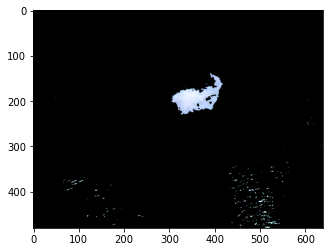

15714 Pixel in Video: 0416.mp4


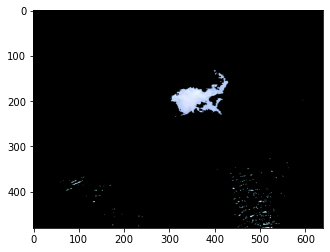

14988 Pixel in Video: 0416.mp4


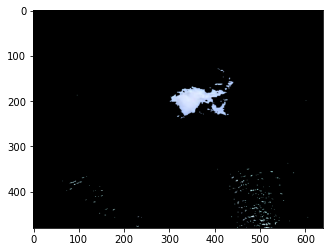

15090 Pixel in Video: 0416.mp4


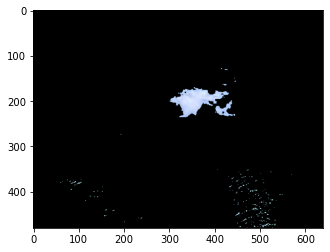

14361 Pixel in Video: 0416.mp4


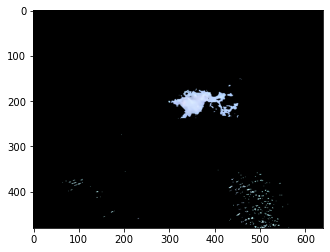

13263 Pixel in Video: 0416.mp4


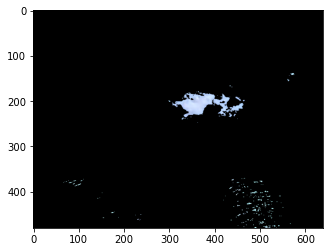

13899 Pixel in Video: 0416.mp4


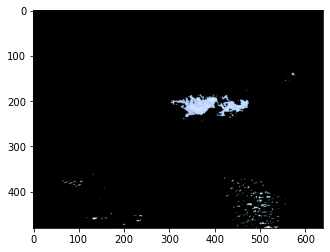

13680 Pixel in Video: 0416.mp4


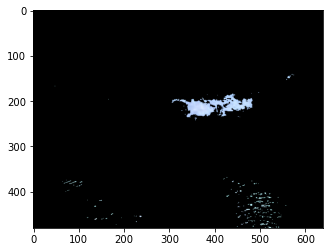

14262 Pixel in Video: 0416.mp4


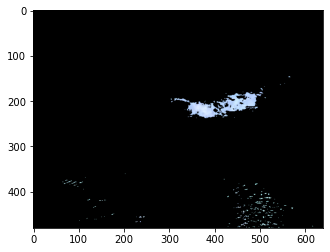

13215 Pixel in Video: 0416.mp4


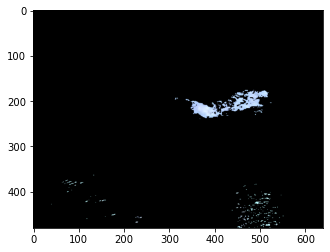

11841 Pixel in Video: 0416.mp4


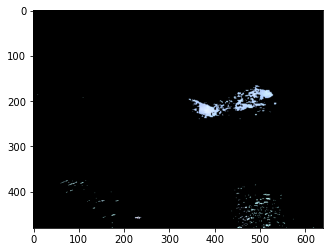

8361 Pixel in Video: 0416.mp4


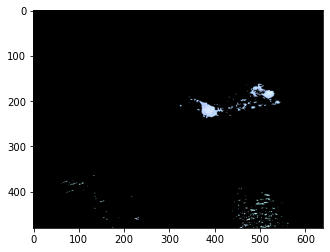

6951 Pixel in Video: 0416.mp4


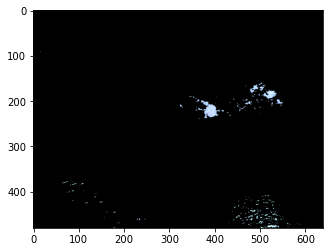

5274 Pixel in Video: 0416.mp4


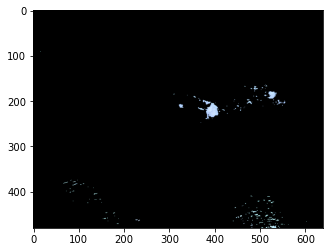

4401 Pixel in Video: 0416.mp4


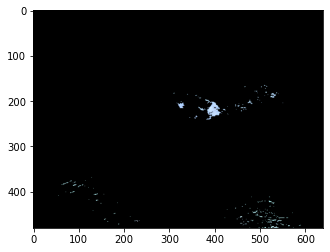

3339 Pixel in Video: 0416.mp4


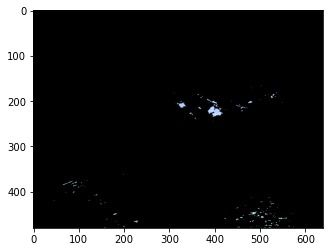

2862 Pixel in Video: 0416.mp4


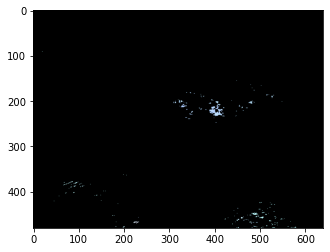

2010 Pixel in Video: 0416.mp4


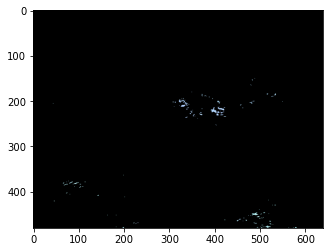

2385 Pixel in Video: 0416.mp4


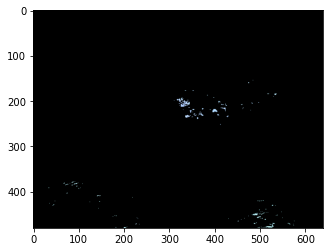

2439 Pixel in Video: 0416.mp4


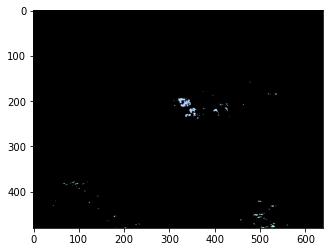

2877 Pixel in Video: 0416.mp4


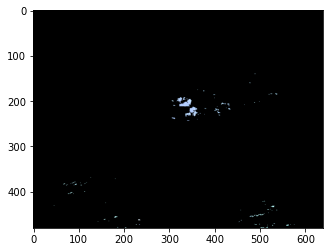

2688 Pixel in Video: 0416.mp4


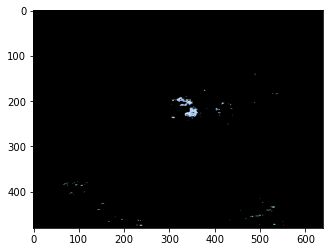

3258 Pixel in Video: 0416.mp4


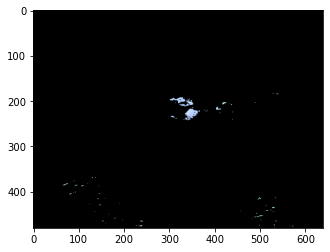

2646 Pixel in Video: 0416.mp4


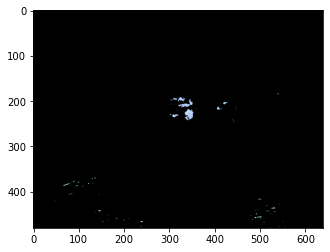

6 Pixel in Video: 0416.mp4


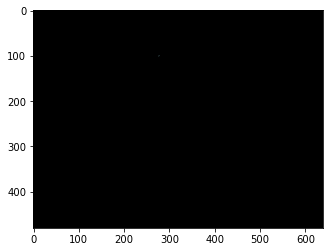

0 Pixel in Video: 0416.mp4


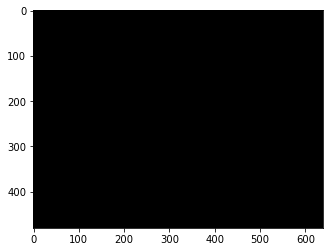

12 Pixel in Video: 0416.mp4


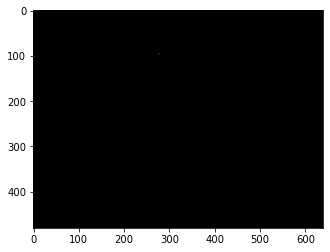

6 Pixel in Video: 0416.mp4


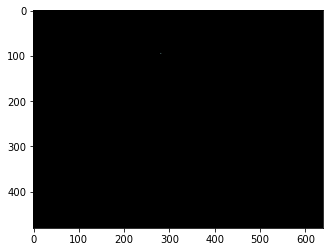

0 Pixel in Video: 0416.mp4


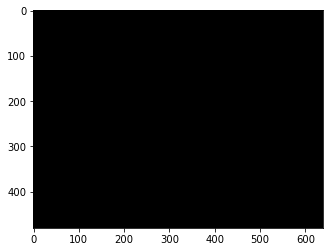

0 Pixel in Video: 0416.mp4


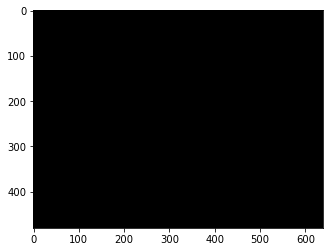

0 Pixel in Video: 0416.mp4


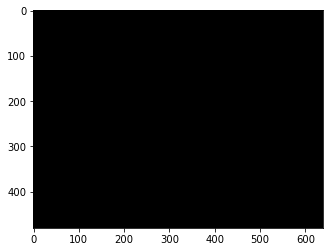

0 Pixel in Video: 0416.mp4


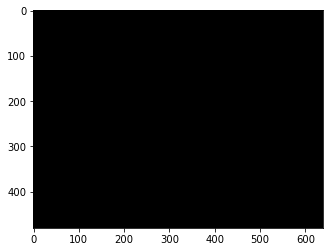

0 Pixel in Video: 0416.mp4


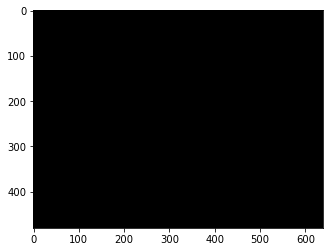

0 Pixel in Video: 0416.mp4


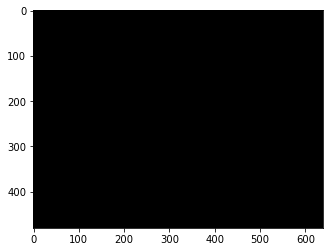

0 Pixel in Video: 0416.mp4


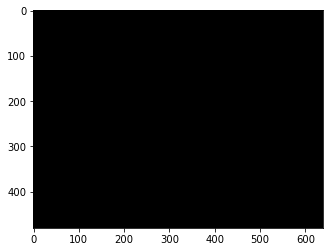

0 Pixel in Video: 0416.mp4


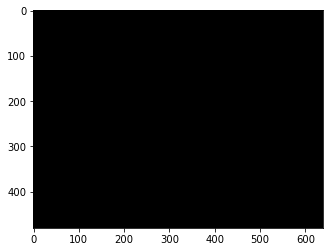

96 Pixel in Video: 0416.mp4


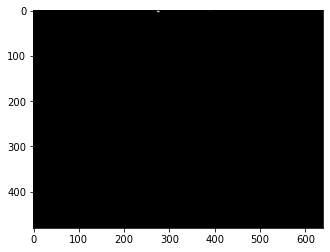

411 Pixel in Video: 0416.mp4


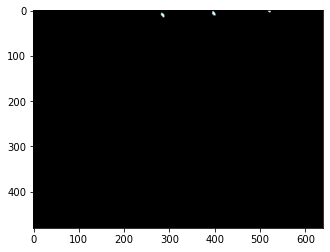

549 Pixel in Video: 0416.mp4


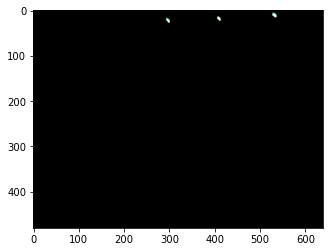

522 Pixel in Video: 0416.mp4


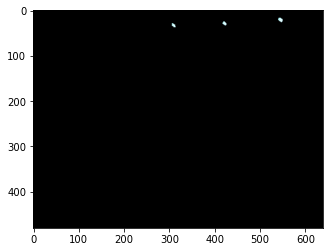

513 Pixel in Video: 0416.mp4


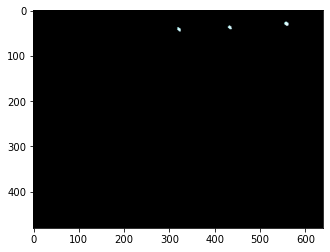

486 Pixel in Video: 0416.mp4


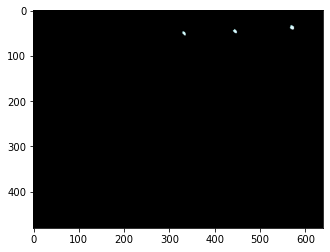

480 Pixel in Video: 0416.mp4


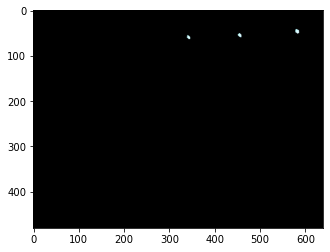

498 Pixel in Video: 0416.mp4


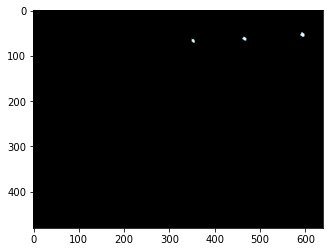

480 Pixel in Video: 0416.mp4


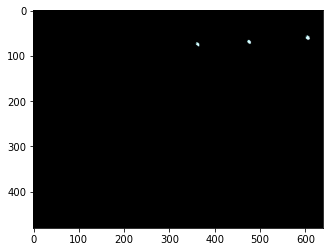

498 Pixel in Video: 0416.mp4


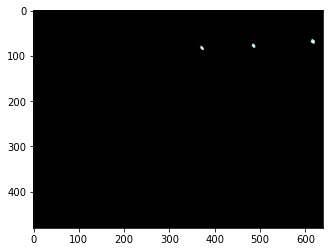

522 Pixel in Video: 0416.mp4


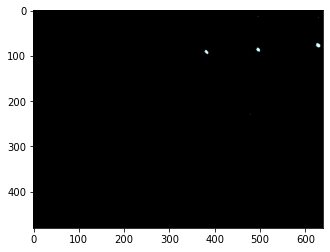

354 Pixel in Video: 0416.mp4


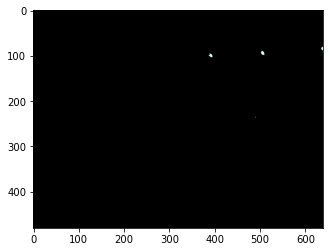

297 Pixel in Video: 0416.mp4


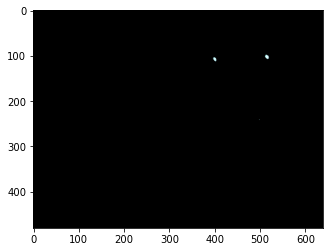

276 Pixel in Video: 0416.mp4


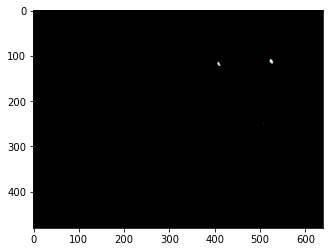

279 Pixel in Video: 0416.mp4


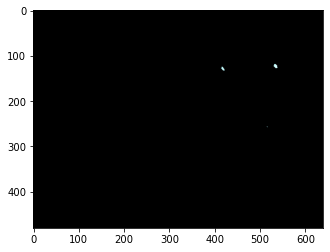

276 Pixel in Video: 0416.mp4


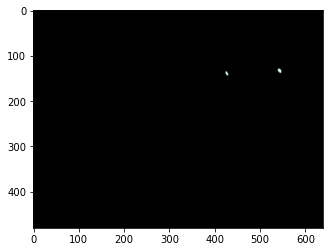

303 Pixel in Video: 0416.mp4


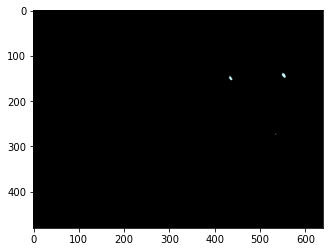

309 Pixel in Video: 0416.mp4


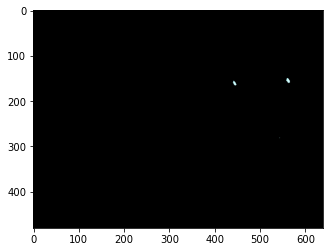

315 Pixel in Video: 0416.mp4


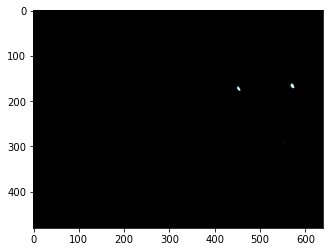

309 Pixel in Video: 0416.mp4


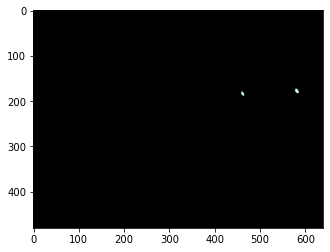

309 Pixel in Video: 0416.mp4


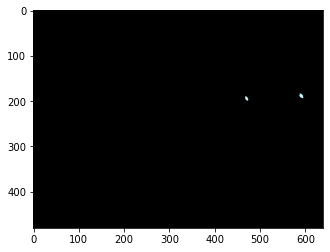

327 Pixel in Video: 0416.mp4


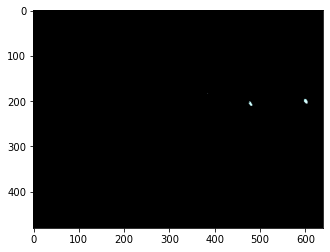

13977 Pixel in Video: 0417.mp4


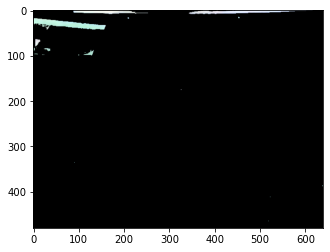

7530 Pixel in Video: 0417.mp4


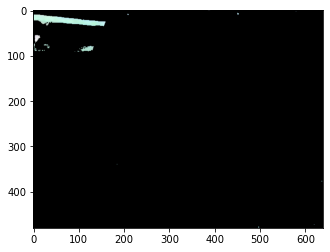

7254 Pixel in Video: 0417.mp4


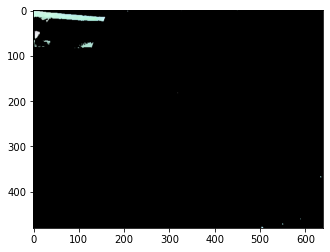

5883 Pixel in Video: 0417.mp4


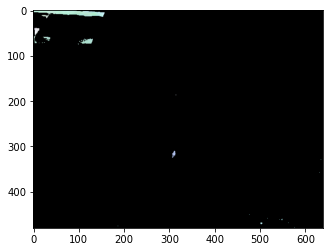

2814 Pixel in Video: 0417.mp4


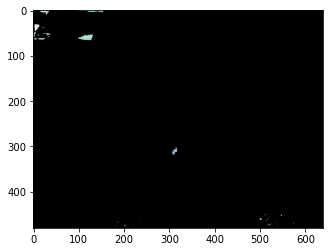

2331 Pixel in Video: 0417.mp4


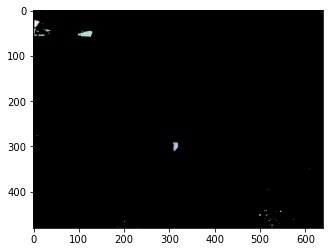

2244 Pixel in Video: 0417.mp4


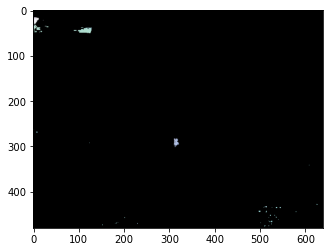

2196 Pixel in Video: 0417.mp4


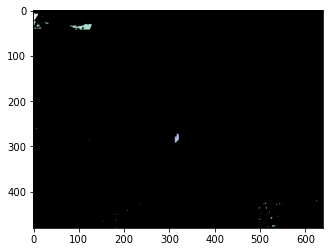

2058 Pixel in Video: 0417.mp4


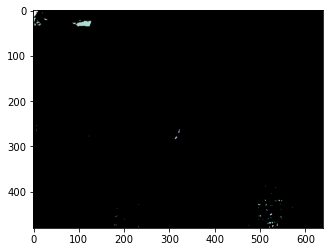

1647 Pixel in Video: 0417.mp4


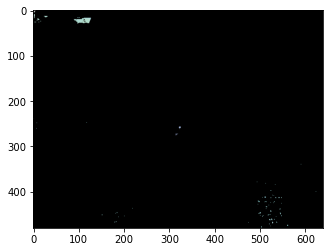

1623 Pixel in Video: 0417.mp4


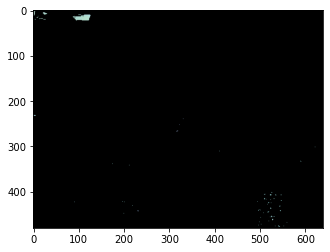

1650 Pixel in Video: 0417.mp4


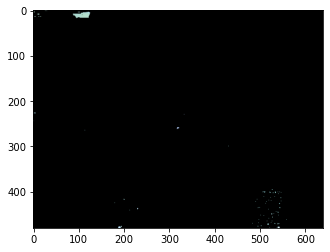

1641 Pixel in Video: 0417.mp4


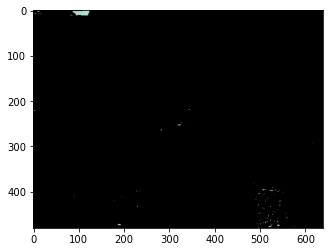

1275 Pixel in Video: 0417.mp4


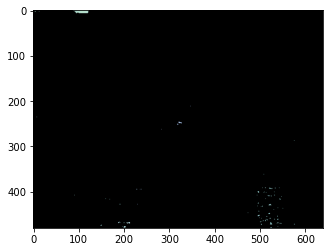

1266 Pixel in Video: 0417.mp4


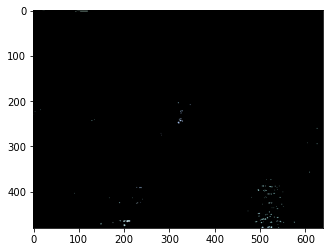

885 Pixel in Video: 0417.mp4


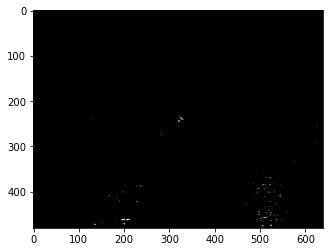

927 Pixel in Video: 0417.mp4


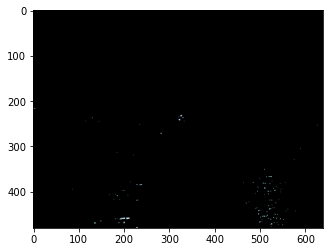

822 Pixel in Video: 0417.mp4


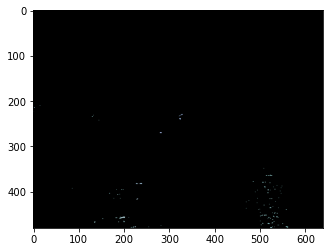

1005 Pixel in Video: 0417.mp4


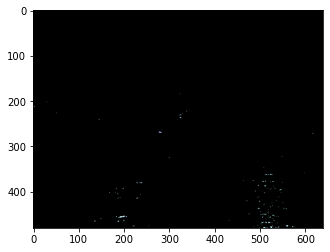

1326 Pixel in Video: 0417.mp4


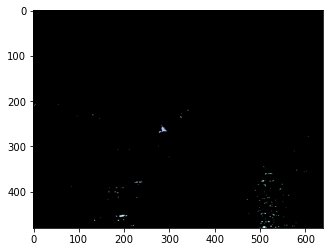

1617 Pixel in Video: 0417.mp4


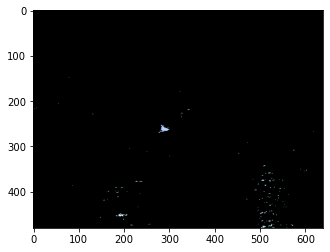

1956 Pixel in Video: 0417.mp4


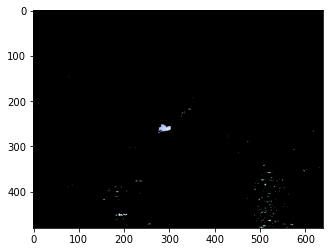

2712 Pixel in Video: 0417.mp4


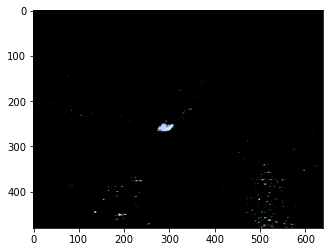

3378 Pixel in Video: 0417.mp4


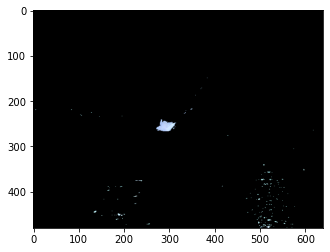

4239 Pixel in Video: 0417.mp4


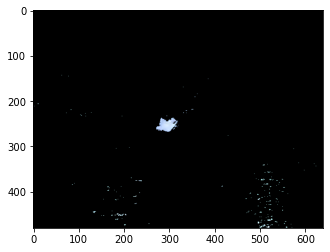

5133 Pixel in Video: 0417.mp4


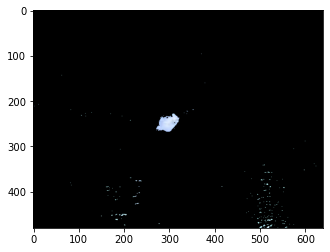

5913 Pixel in Video: 0417.mp4


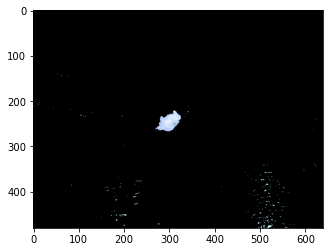

6594 Pixel in Video: 0417.mp4


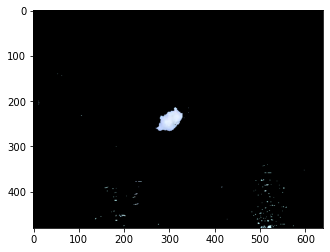

7311 Pixel in Video: 0417.mp4


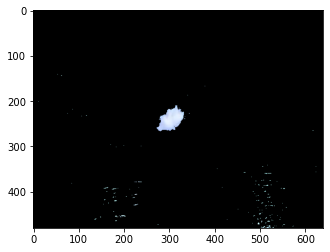

8076 Pixel in Video: 0417.mp4


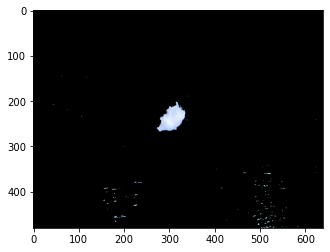

8916 Pixel in Video: 0417.mp4


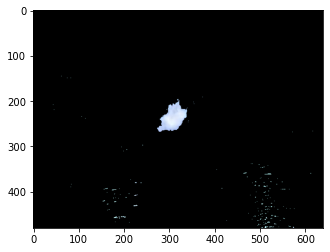

9486 Pixel in Video: 0417.mp4


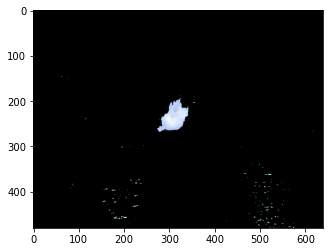

9987 Pixel in Video: 0417.mp4


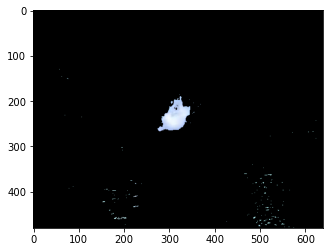

10329 Pixel in Video: 0417.mp4


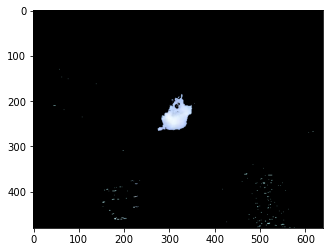

10761 Pixel in Video: 0417.mp4


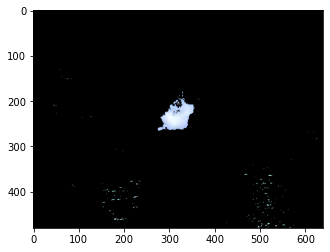

10392 Pixel in Video: 0417.mp4


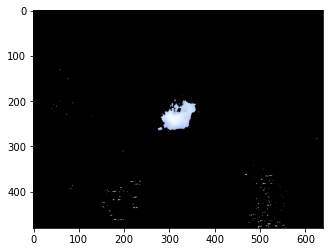

10917 Pixel in Video: 0417.mp4


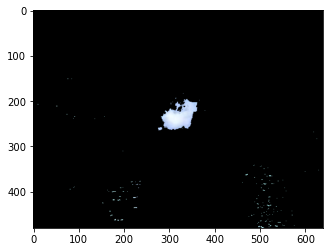

534 Pixel in Video: 0419.mp4


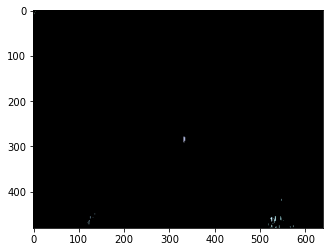

924 Pixel in Video: 0419.mp4


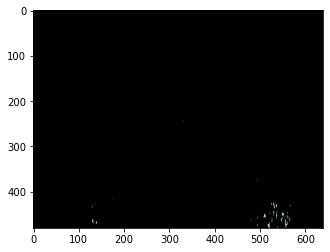

2613 Pixel in Video: 0419.mp4


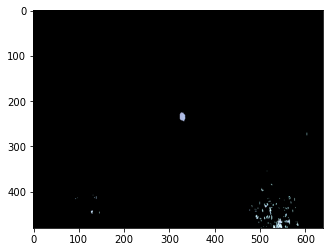

2616 Pixel in Video: 0419.mp4


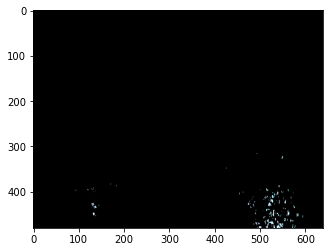

3180 Pixel in Video: 0419.mp4


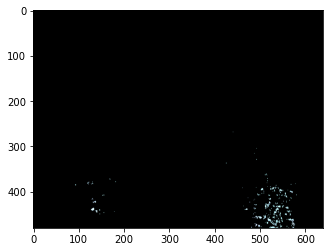

2766 Pixel in Video: 0419.mp4


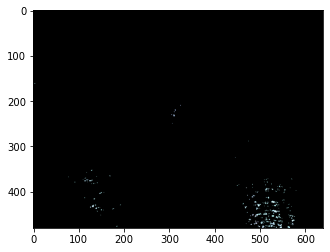

2853 Pixel in Video: 0419.mp4


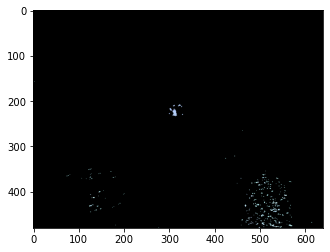

4311 Pixel in Video: 0419.mp4


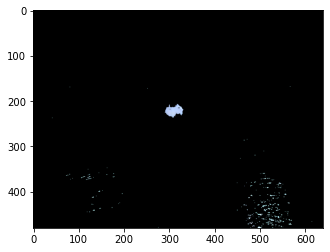

5985 Pixel in Video: 0419.mp4


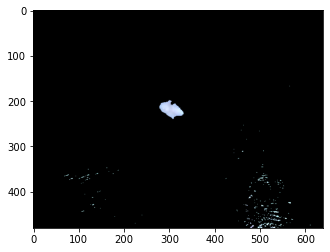

6693 Pixel in Video: 0419.mp4


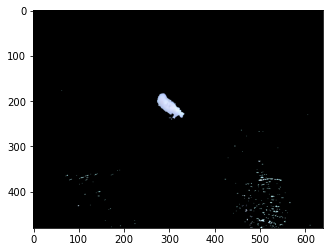

8046 Pixel in Video: 0419.mp4


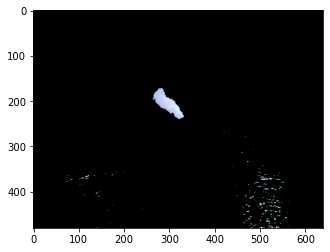

8814 Pixel in Video: 0419.mp4


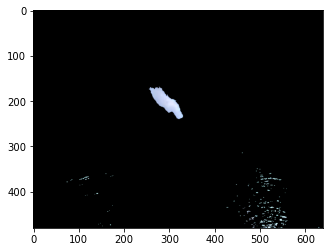

10173 Pixel in Video: 0419.mp4


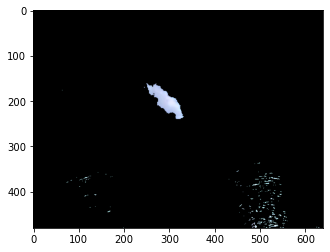

9498 Pixel in Video: 0419.mp4


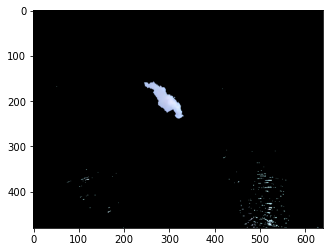

9318 Pixel in Video: 0419.mp4


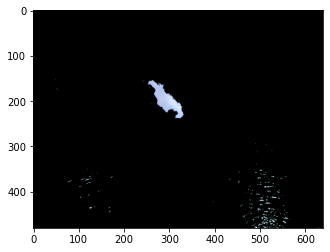

8913 Pixel in Video: 0419.mp4


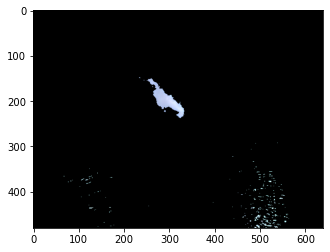

8061 Pixel in Video: 0419.mp4


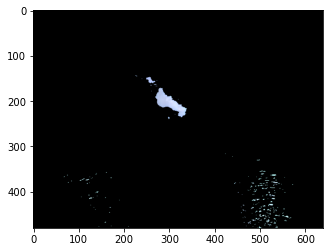

7761 Pixel in Video: 0419.mp4


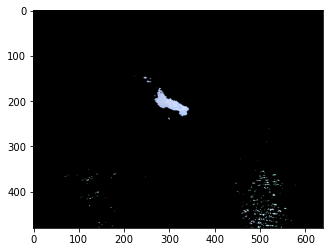

7233 Pixel in Video: 0419.mp4


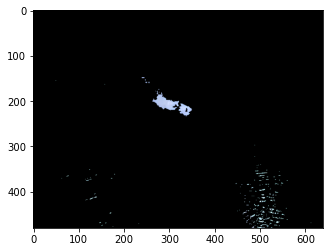

5730 Pixel in Video: 0419.mp4


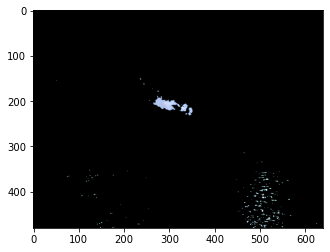

5154 Pixel in Video: 0419.mp4


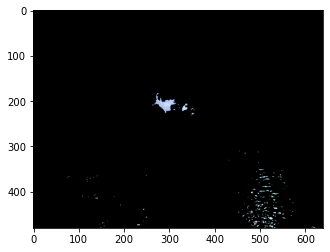

4992 Pixel in Video: 0419.mp4


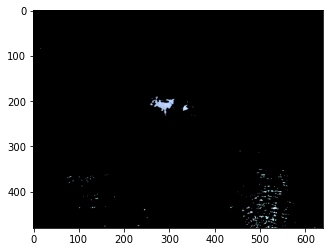

4677 Pixel in Video: 0419.mp4


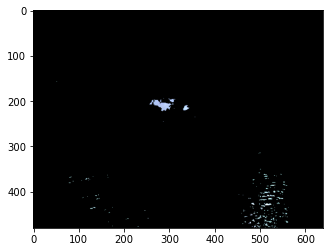

4311 Pixel in Video: 0419.mp4


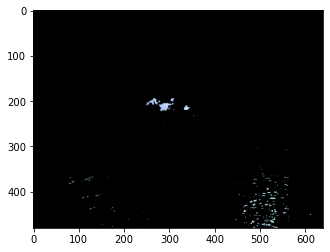

4296 Pixel in Video: 0419.mp4


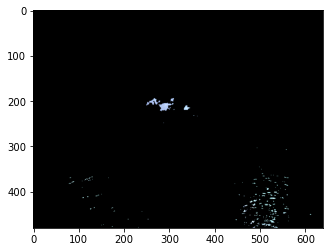

4902 Pixel in Video: 0419.mp4


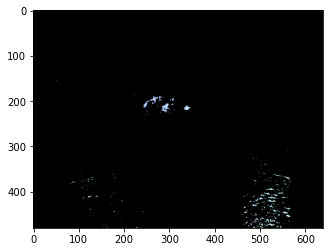

4263 Pixel in Video: 0419.mp4


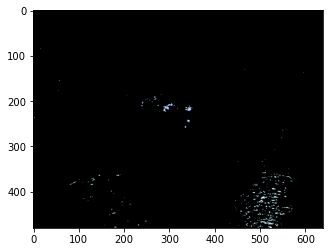

4824 Pixel in Video: 0419.mp4


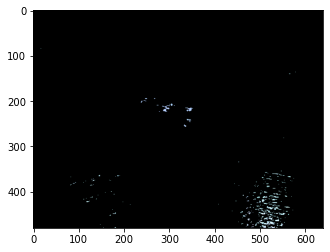

0 Pixel in Video: 0419.mp4


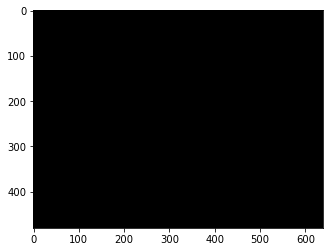

3 Pixel in Video: 0419.mp4


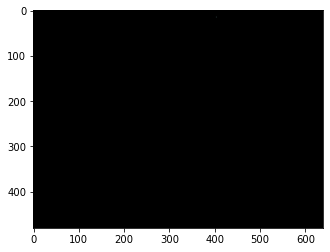

3 Pixel in Video: 0419.mp4


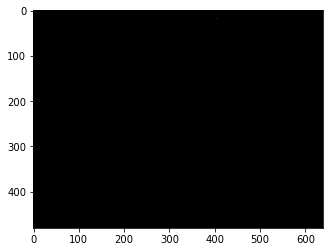

0 Pixel in Video: 0419.mp4


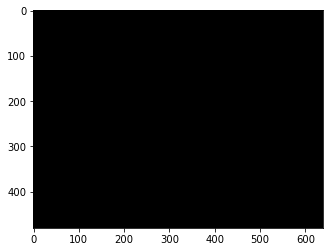

0 Pixel in Video: 0419.mp4


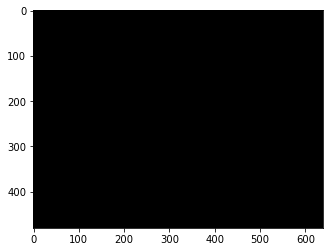

0 Pixel in Video: 0419.mp4


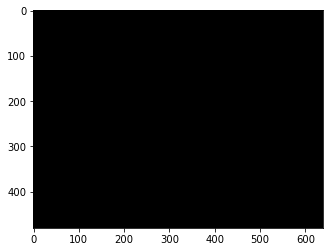

0 Pixel in Video: 0419.mp4


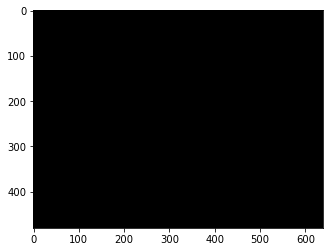

3 Pixel in Video: 0419.mp4


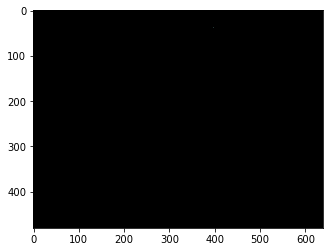

3 Pixel in Video: 0419.mp4


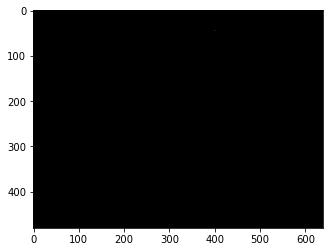

3 Pixel in Video: 0419.mp4


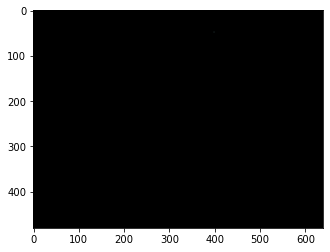

0 Pixel in Video: 0419.mp4


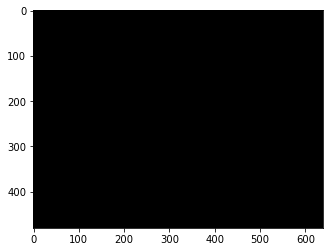

0 Pixel in Video: 0419.mp4


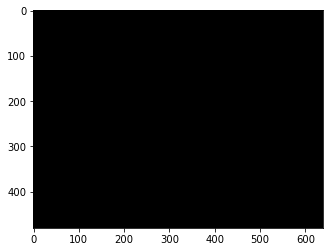

0 Pixel in Video: 0419.mp4


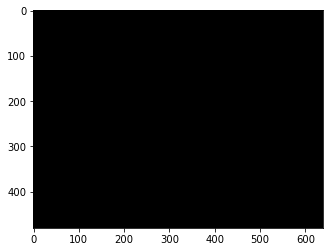

0 Pixel in Video: 0419.mp4


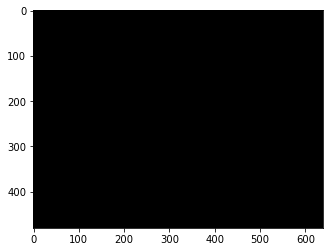

0 Pixel in Video: 0419.mp4


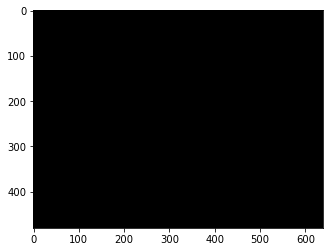

0 Pixel in Video: 0419.mp4


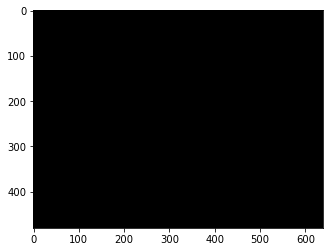

0 Pixel in Video: 0419.mp4


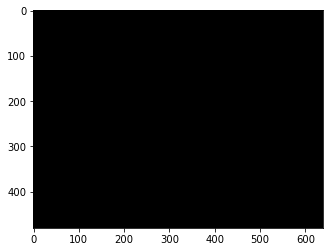

0 Pixel in Video: 0419.mp4


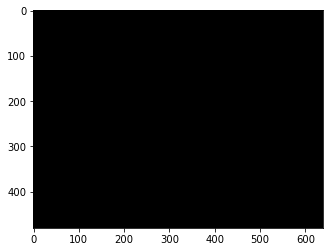

0 Pixel in Video: 0419.mp4


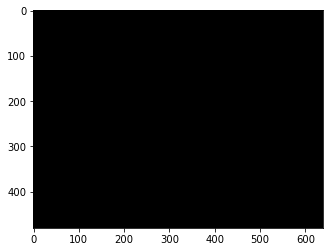

0 Pixel in Video: 0419.mp4


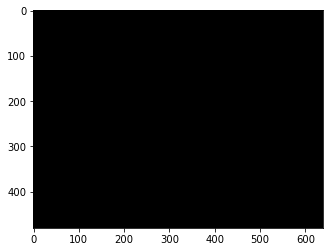

0 Pixel in Video: 0419.mp4


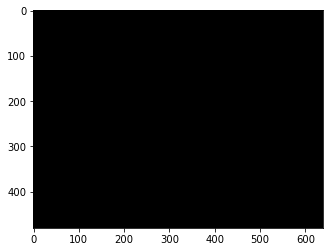

0 Pixel in Video: 0419.mp4


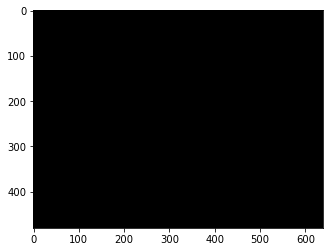

0 Pixel in Video: 0419.mp4


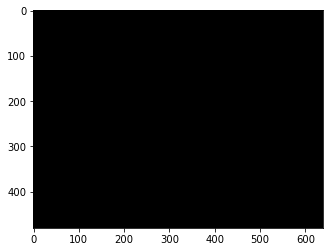

0 Pixel in Video: 0419.mp4


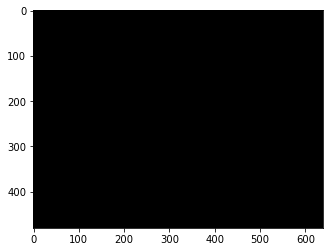

0 Pixel in Video: 0419.mp4


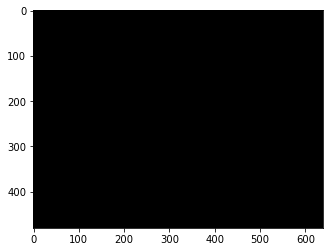

0 Pixel in Video: 0419.mp4


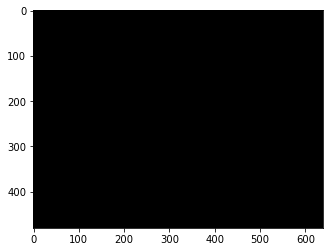

0 Pixel in Video: 0419.mp4


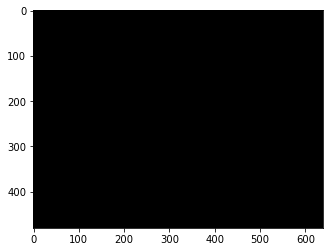

0 Pixel in Video: 0419.mp4


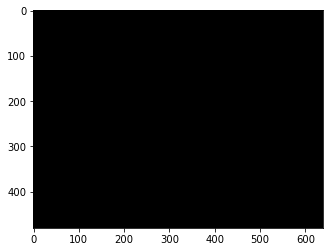

0 Pixel in Video: 0419.mp4


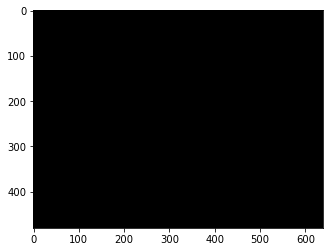

3 Pixel in Video: 0419.mp4


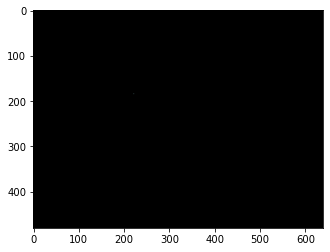

3 Pixel in Video: 0419.mp4


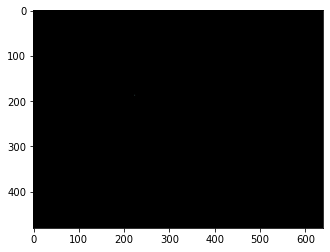

3 Pixel in Video: 0419.mp4


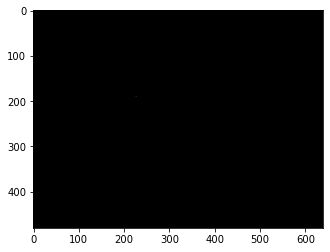

3 Pixel in Video: 0419.mp4


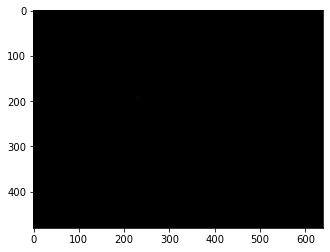

2295 Pixel in Video: 0420.mp4


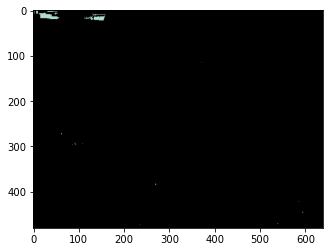

1917 Pixel in Video: 0420.mp4


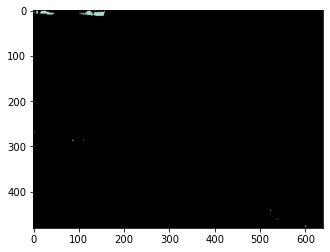

459 Pixel in Video: 0420.mp4


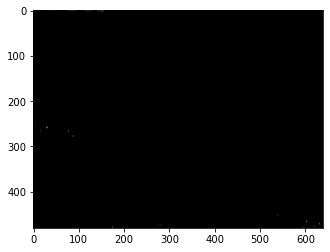

450 Pixel in Video: 0420.mp4


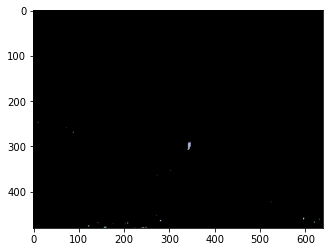

483 Pixel in Video: 0420.mp4


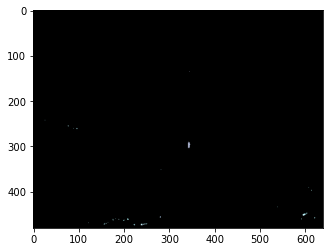

444 Pixel in Video: 0420.mp4


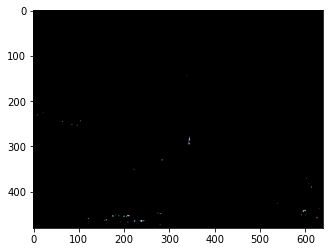

504 Pixel in Video: 0420.mp4


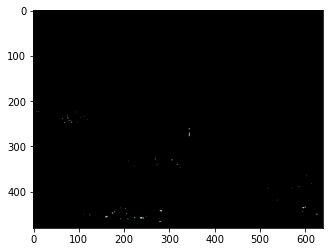

792 Pixel in Video: 0420.mp4


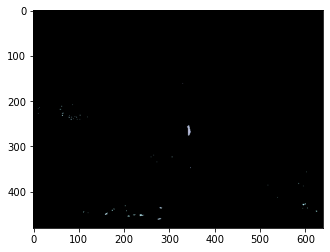

1062 Pixel in Video: 0420.mp4


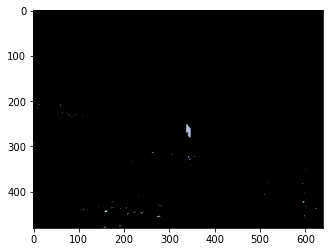

1344 Pixel in Video: 0420.mp4


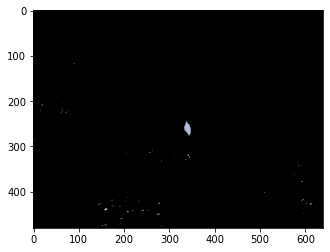

1290 Pixel in Video: 0420.mp4


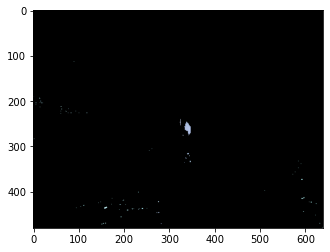

1329 Pixel in Video: 0420.mp4


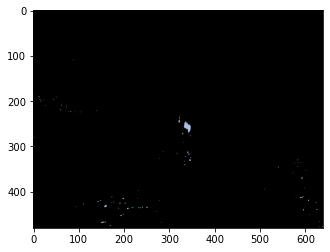

1329 Pixel in Video: 0420.mp4


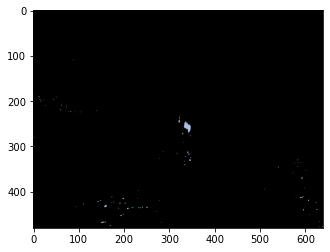

954 Pixel in Video: 0420.mp4


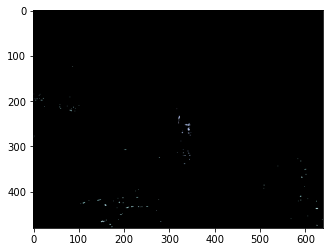

822 Pixel in Video: 0420.mp4


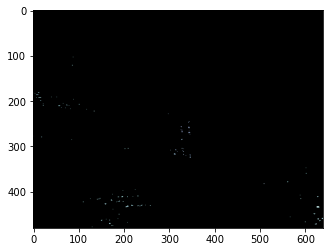

780 Pixel in Video: 0420.mp4


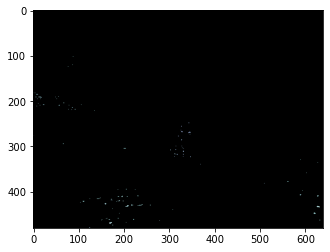

858 Pixel in Video: 0420.mp4


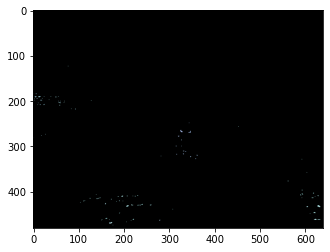

816 Pixel in Video: 0420.mp4


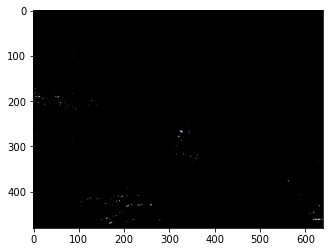

1005 Pixel in Video: 0420.mp4


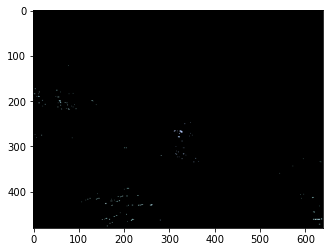

4269 Pixel in Video: 0422.mp4


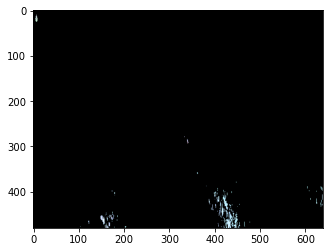

5181 Pixel in Video: 0422.mp4


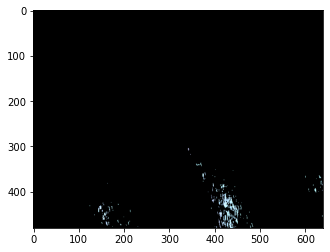

5646 Pixel in Video: 0422.mp4


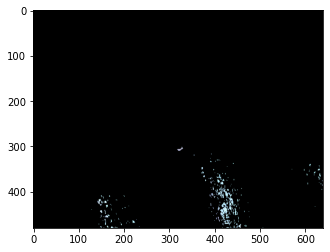

5697 Pixel in Video: 0422.mp4


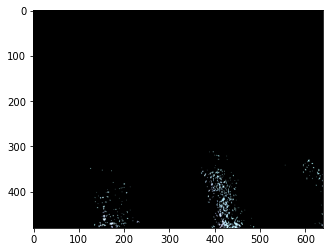

6342 Pixel in Video: 0422.mp4


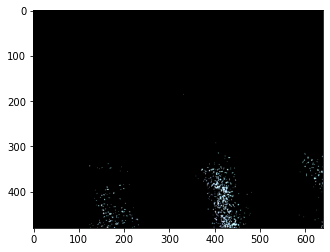

5205 Pixel in Video: 0422.mp4


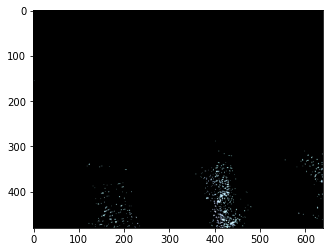

5037 Pixel in Video: 0422.mp4


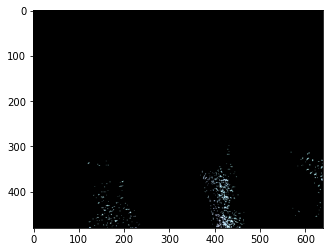

5817 Pixel in Video: 0422.mp4


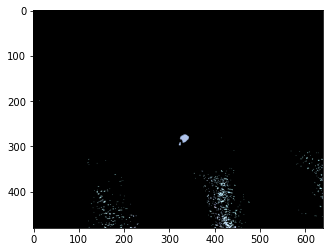

6552 Pixel in Video: 0422.mp4


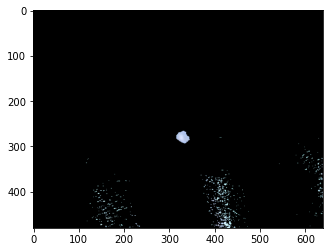

6396 Pixel in Video: 0422.mp4


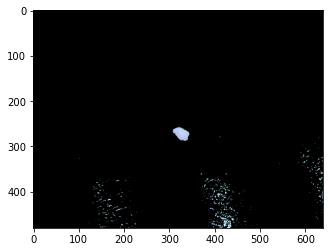

7524 Pixel in Video: 0422.mp4


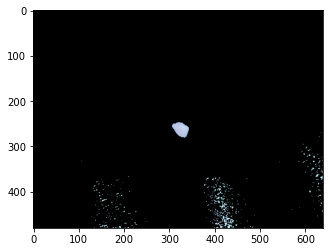

8304 Pixel in Video: 0422.mp4


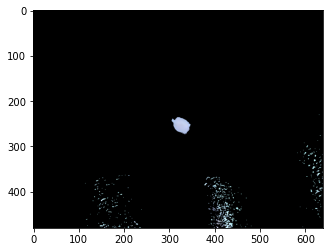

8934 Pixel in Video: 0422.mp4


8895 Pixel in Video: 0422.mp4


9306 Pixel in Video: 0422.mp4


8607 Pixel in Video: 0422.mp4


8400 Pixel in Video: 0422.mp4


8502 Pixel in Video: 0422.mp4


8391 Pixel in Video: 0422.mp4


9459 Pixel in Video: 0422.mp4


10305 Pixel in Video: 0422.mp4


10530 Pixel in Video: 0422.mp4


10980 Pixel in Video: 0422.mp4


11451 Pixel in Video: 0422.mp4


10629 Pixel in Video: 0422.mp4


10404 Pixel in Video: 0422.mp4


11736 Pixel in Video: 0423.mp4


11943 Pixel in Video: 0423.mp4


12486 Pixel in Video: 0423.mp4


12198 Pixel in Video: 0423.mp4


12513 Pixel in Video: 0423.mp4


13755 Pixel in Video: 0423.mp4


13173 Pixel in Video: 0423.mp4


11979 Pixel in Video: 0423.mp4


11211 Pixel in Video: 0423.mp4


10401 Pixel in Video: 0423.mp4


10518 Pixel in Video: 0423.mp4


9816 Pixel in Video: 0423.mp4


9717 Pixel in Video: 0423.mp4


9528 Pixel in Video: 0423.mp4


9588 Pixel in Video: 0423.mp4


9051 Pixel in Video: 0423.mp4


9129 Pixel in Video: 0423.mp4


8967 Pixel in Video: 0423.mp4


9150 Pixel in Video: 0423.mp4


8688 Pixel in Video: 0423.mp4


9123 Pixel in Video: 0423.mp4


8946 Pixel in Video: 0423.mp4


9450 Pixel in Video: 0423.mp4


9558 Pixel in Video: 0423.mp4


10527 Pixel in Video: 0423.mp4


11034 Pixel in Video: 0423.mp4


11556 Pixel in Video: 0423.mp4


11436 Pixel in Video: 0423.mp4


11796 Pixel in Video: 0423.mp4


11385 Pixel in Video: 0423.mp4


11481 Pixel in Video: 0423.mp4


11364 Pixel in Video: 0423.mp4


11481 Pixel in Video: 0423.mp4


11577 Pixel in Video: 0423.mp4


11925 Pixel in Video: 0423.mp4


11793 Pixel in Video: 0423.mp4


11979 Pixel in Video: 0423.mp4


12105 Pixel in Video: 0423.mp4


12294 Pixel in Video: 0423.mp4


12018 Pixel in Video: 0423.mp4


12312 Pixel in Video: 0423.mp4


12345 Pixel in Video: 0423.mp4


12354 Pixel in Video: 0423.mp4


12021 Pixel in Video: 0423.mp4


12309 Pixel in Video: 0423.mp4


11910 Pixel in Video: 0423.mp4


12222 Pixel in Video: 0423.mp4


11880 Pixel in Video: 0423.mp4


11328 Pixel in Video: 0423.mp4


11046 Pixel in Video: 0423.mp4


10608 Pixel in Video: 0423.mp4


10065 Pixel in Video: 0423.mp4


9870 Pixel in Video: 0423.mp4


9078 Pixel in Video: 0423.mp4


8781 Pixel in Video: 0423.mp4


7974 Pixel in Video: 0423.mp4


8040 Pixel in Video: 0423.mp4


7620 Pixel in Video: 0423.mp4


7524 Pixel in Video: 0423.mp4


7245 Pixel in Video: 0423.mp4


6948 Pixel in Video: 0423.mp4


4368 Pixel in Video: 0423.mp4


2628 Pixel in Video: 0423.mp4


90 Pixel in Video: 0423.mp4


3 Pixel in Video: 0423.mp4


0 Pixel in Video: 0423.mp4


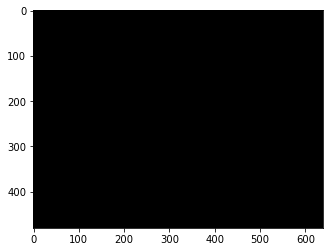

0 Pixel in Video: 0423.mp4


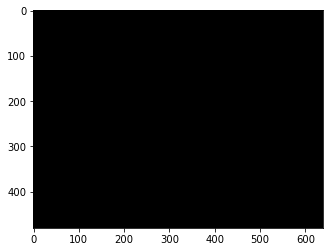

0 Pixel in Video: 0423.mp4


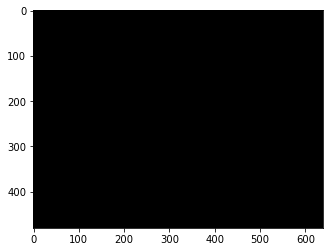

0 Pixel in Video: 0423.mp4


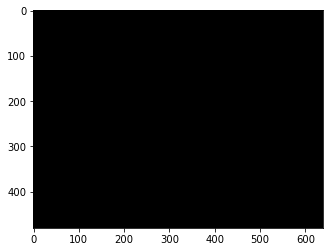

0 Pixel in Video: 0423.mp4


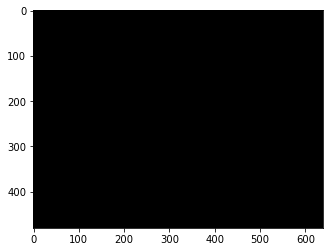

0 Pixel in Video: 0423.mp4


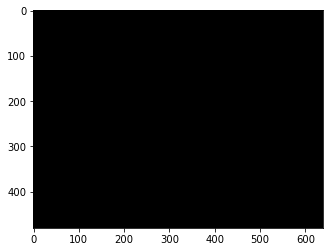

0 Pixel in Video: 0423.mp4


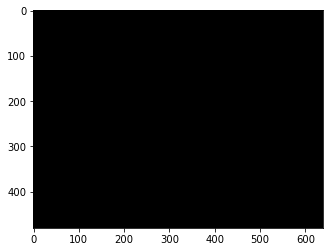

0 Pixel in Video: 0423.mp4


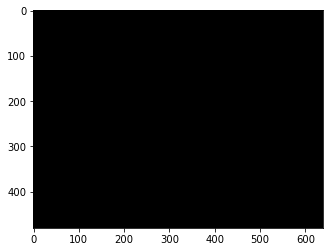

0 Pixel in Video: 0423.mp4


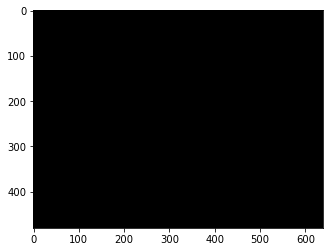

0 Pixel in Video: 0423.mp4


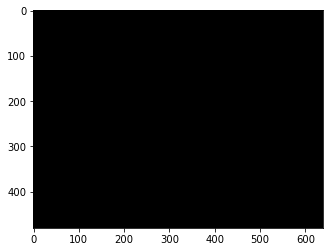

0 Pixel in Video: 0423.mp4


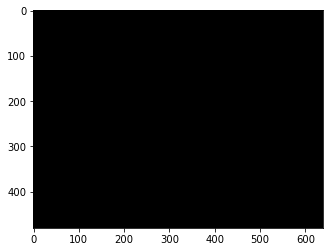

0 Pixel in Video: 0423.mp4


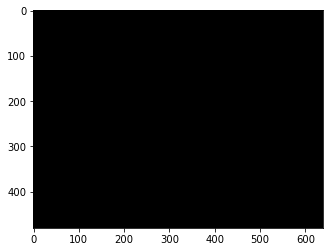

0 Pixel in Video: 0423.mp4


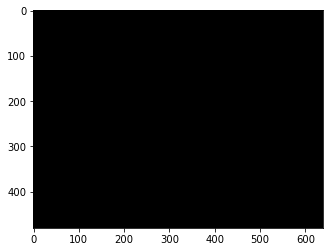

0 Pixel in Video: 0423.mp4


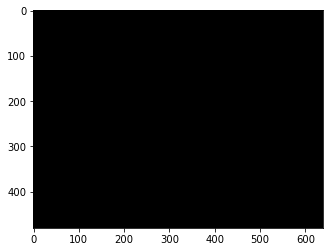

0 Pixel in Video: 0423.mp4


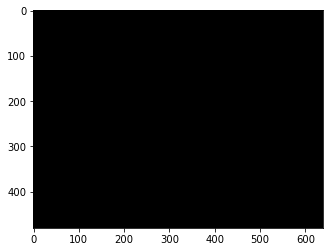

4920 Pixel in Video: 0425.mp4


6711 Pixel in Video: 0425.mp4


8055 Pixel in Video: 0425.mp4


12054 Pixel in Video: 0425.mp4


13872 Pixel in Video: 0425.mp4


12528 Pixel in Video: 0425.mp4


12912 Pixel in Video: 0425.mp4


12912 Pixel in Video: 0425.mp4


11787 Pixel in Video: 0425.mp4


14310 Pixel in Video: 0425.mp4


16572 Pixel in Video: 0425.mp4


25221 Pixel in Video: 0425.mp4


33429 Pixel in Video: 0425.mp4


40119 Pixel in Video: 0425.mp4


42162 Pixel in Video: 0425.mp4


22287 Pixel in Video: 0428.mp4


8613 Pixel in Video: 0428.mp4


8754 Pixel in Video: 0428.mp4


4629 Pixel in Video: 0428.mp4


4398 Pixel in Video: 0428.mp4


4116 Pixel in Video: 0428.mp4


5856 Pixel in Video: 0428.mp4


8157 Pixel in Video: 0428.mp4


10416 Pixel in Video: 0428.mp4


12135 Pixel in Video: 0428.mp4


13173 Pixel in Video: 0428.mp4


13512 Pixel in Video: 0428.mp4


14043 Pixel in Video: 0428.mp4


14643 Pixel in Video: 0428.mp4


12762 Pixel in Video: 0428.mp4


12015 Pixel in Video: 0428.mp4


1404 Pixel in Video: 0429.mp4


1335 Pixel in Video: 0429.mp4


2373 Pixel in Video: 0429.mp4


1521 Pixel in Video: 0429.mp4


1884 Pixel in Video: 0429.mp4


4278 Pixel in Video: 0429.mp4


3765 Pixel in Video: 0429.mp4


4086 Pixel in Video: 0429.mp4


4692 Pixel in Video: 0429.mp4


4560 Pixel in Video: 0429.mp4


4974 Pixel in Video: 0429.mp4


4770 Pixel in Video: 0429.mp4


4233 Pixel in Video: 0429.mp4


4101 Pixel in Video: 0429.mp4


4080 Pixel in Video: 0429.mp4


3951 Pixel in Video: 0429.mp4


3708 Pixel in Video: 0429.mp4


3741 Pixel in Video: 0429.mp4


21609 Pixel in Video: 0430.mp4


21111 Pixel in Video: 0430.mp4


21411 Pixel in Video: 0430.mp4


21384 Pixel in Video: 0430.mp4


20784 Pixel in Video: 0430.mp4


18273 Pixel in Video: 0430.mp4


18267 Pixel in Video: 0430.mp4


12027 Pixel in Video: 0430.mp4


11880 Pixel in Video: 0430.mp4


543 Pixel in Video: 0430.mp4


354 Pixel in Video: 0430.mp4


321 Pixel in Video: 0430.mp4


267 Pixel in Video: 0430.mp4


255 Pixel in Video: 0430.mp4


279 Pixel in Video: 0430.mp4


339 Pixel in Video: 0430.mp4


318 Pixel in Video: 0430.mp4


318 Pixel in Video: 0430.mp4


315 Pixel in Video: 0430.mp4


780 Pixel in Video: 0435.mp4


735 Pixel in Video: 0435.mp4


1293 Pixel in Video: 0435.mp4


1473 Pixel in Video: 0435.mp4


1659 Pixel in Video: 0435.mp4


3804 Pixel in Video: 0435.mp4


4827 Pixel in Video: 0435.mp4


5463 Pixel in Video: 0435.mp4


6501 Pixel in Video: 0435.mp4


8142 Pixel in Video: 0435.mp4


9588 Pixel in Video: 0435.mp4


10578 Pixel in Video: 0435.mp4


In [32]:
img=[]
for df in listDFs:
    for frame in df.iloc():
        
        img=frame["Frame"]
        video=frame["Video"]
        mask_white = cv2.inRange(img, light_white, dark_white)
        result_white = cv2.bitwise_and(img, img, mask=mask_white)
        pixel_count = np.sum(result_white != (0,0,0))
        print(pixel_count,"Pixel in Video:",video)
        plt.imshow(result_white)
        plt.show()
        
        

# Format Image in 2D (Where masked_image != Black)

In [101]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler


def dbscan(video, X, eps, min_samples):
    if(len(X)>0):
        db = DBSCAN(eps=eps, min_samples=min_samples)
        y_pred = db.fit_predict(X)

        labels=db.labels_
        n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
        n_noise_ = list(labels).count(-1)
    
        print("NUMBER OF CLUSTERS:",n_clusters_)
        print("NUMBER OF NOISES:",n_noise_)

        counts = np.bincount(labels[labels>=0])
        labels1, counts = np.unique(labels[labels>=0], return_counts=True)
        max1 = labels1[np.argsort(-counts)[:1]]
        cluster = np.array(X[labels == max1])
        if(n_clusters_==0):
            return 1,"fail"
        return int(counts[max1]), video
    else:
        return 1,"fail"

img=[]
videoname= []
max_count=[]
for df in listDFs:

    for frame in df.iloc():
        
        img=frame["Frame"]
        video=frame["Video"]
        mask_white = cv2.inRange(img, light_white, dark_white)
        result_white = cv2.bitwise_and(img, img, mask=mask_white)
        pixel_count = np.sum(result_white != (0,0,0))
        print(pixel_count,"Pixel in Video:",video)
        
        indices = np.where(result_white!= (0,0,0))
    
        my_coords = []
        for i in range(0,len(indices[0])): 
            x = indices[1][i]
            y = indices[0][i]
            my_coords.append((x,y))
        
        unique_coordinates = list(set(list(my_coords)))
        my_sorted_coord=sorted(unique_coordinates)
        
        max1, video1=dbscan(video,np.array(my_sorted_coord).reshape(-1, 1),eps=10, min_samples=40)
        videoname.append(video1)
        max_count.append(max1)
print(videoname,max_count)

5811 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 100
5769 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 68
6411 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 92
6411 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 92
5730 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 54
6264 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 87
6579 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 51
6960 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 59
7026 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 57
7575 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 83
7056 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 68
6666 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 82
5547 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 88
5265 Pixel in Video: 0293.mp4
NUMBER OF CLUSTERS: 

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


1116 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 53
1626 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 84
1020 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 158
507 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 177
1332 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 133
2436 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 192
3627 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 129
4260 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 107
5580 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 69
7569 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 120
9108 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 80
9705 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 91
10017 Pixel in Video: 0299.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 67
9645 Pixel in Video: 0299.mp4
NUMBER OF CLUS

NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
18492 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
10914 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 6
NUMBER OF NOISES: 1
9525 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 11
1173 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 36
1164 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
1407 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
1128 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
1104 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
987 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 1
993 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 1
747 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
789 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
822 Pixel in Video: 0303.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 0
831 Pixel in Video: 030

6999 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 0
7230 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 28
7011 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 7
6849 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 10
6720 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 7
6624 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 3
6429 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 21
7026 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 33
7419 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 4
8187 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 7
8946 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 9
9534 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 5
10299 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 4
10851 Pixel in Video: 0309.mp4
NUMBER OF CLUSTERS: 3
NUMBER

NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 157
14649 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 105
15438 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 156
15534 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 107
15531 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 106
14793 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 151
15549 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 98
16428 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 129
16809 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 6
NUMBER OF NOISES: 86
16830 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 6
NUMBER OF NOISES: 61
17064 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 65
17169 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 84
17580 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 101
17868 Pixel in Video: 0312.mp4
NUMBER OF CLUSTERS: 4
NUMBER O

NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 61
3129 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 78
4308 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 52
4617 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 48
6669 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 53
7452 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 52
8670 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 97
8373 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 74
9087 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 92
8613 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 80
7959 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 60
6915 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 59
8091 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 75
6237 Pixel in Video: 0317.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 72
5517 Pix

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 40
8316 Pixel in Video: 0326.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 59
7944 Pixel in Video: 0326.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 51
8631 Pixel in Video: 0326.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 104
9177 Pixel in Video: 0326.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 42
26400 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 8
16749 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 12
7848 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 23
8526 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 13
2817 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 30
2604 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 56
3528 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 57
3138 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 6
NUMBER OF NOISES: 60
2799 Pixel in Video: 0327.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 113
2343 

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 45
7737 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 99
9180 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 88
9282 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 96
10320 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 83
10602 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 88
10554 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 78
10554 Pixel in Video: 0329.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 78
4053 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 8
4407 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 25
4947 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 20
5235 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 13
5637 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 24
5100 Pixel in Video: 0330.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 48
5073 

NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 146
6522 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 149
6705 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 130
7812 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 82
8394 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 171
10029 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 115
10869 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 164
12276 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 163
12249 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 122
12828 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 161
12339 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 85
12738 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 72
12585 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 75
13320 Pixel in Video: 0338.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF N

417 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 100
519 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 117
825 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 179
1110 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 126
972 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 176
1113 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 174
1077 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 218
588 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 139
711 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 206
651 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 192
807 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 242
636 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 192
741 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 262
708 Pixel in Video: 0348.mp4
NUMBER OF CLUSTERS:

NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 37
3282 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 88
2028 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 152
1995 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 163
1509 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 128
942 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 223
840 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 226
732 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 228
822 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 226
912 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 153
1299 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 140
1647 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 134
1821 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 129
1815 Pixel in Video: 0354.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 193
2

NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 1
1992 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 16
2451 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 4
3660 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 11
4941 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 16
4944 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 18
6348 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 36
8376 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 37
8928 Pixel in Video: 0359.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 57
87 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 16
12 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 8
87 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 58


<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


198 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 38
252 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 46
714 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 70
678 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 81
696 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 32
1887 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 37
3381 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 41
4200 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 17
5271 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 18
6024 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 24
6588 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 26
6888 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 13
7482 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 23
7026 Pixel in Video: 0360.mp4
NUMBER OF CLUSTERS: 2
NUMB

NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 55
16188 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 91
20211 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 10
22803 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 38
24816 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 17
25017 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 27
26373 Pixel in Video: 0376.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 24
13365 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 84
12861 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 60
12933 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 90
12297 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 72
12705 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 82
12303 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 75
12441 Pixel in Video: 0377.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES

NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 70
9858 Pixel in Video: 0383.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 107
1605 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 19
672 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 31
411 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 68
411 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 68
933 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 51
2364 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 148
2019 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 178
1677 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 121
2382 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 115
2763 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 124
3765 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 94
4209 Pixel in Video: 0384.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 127
4161 

NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 8
255 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 19
213 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 142
720 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 120
1329 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 91
1278 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 113
3396 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 68
4995 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 47
6549 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 37
6774 Pixel in Video: 0389.mp4


<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 51
7497 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 34
7647 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 35
8127 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 45
6459 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 28
6336 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 88
5052 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 34
4959 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 116
3369 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 100
3171 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 120
2976 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 80
3444 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 29
2484 Pixel in Video: 0389.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 101
4806 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 36
3573

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


1014 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 114
1089 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 125
1245 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 170
1437 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 128
1530 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 98
1629 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 110
2376 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 124
2244 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 113
2298 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 123
2943 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 91
3870 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 173
4698 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 132
6183 Pixel in Video: 0390.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 154
6711 Pixel in Video: 0390.mp4
NUMBER OF 

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels ==

NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 129
4683 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 150
5103 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 157
5982 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 192
7023 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 192
7788 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 162
8601 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 176
9612 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 177
10554 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 174
11499 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 154
12126 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 177
13281 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 139
14226 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 121
15132 Pixel in Video: 0393.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF 

NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 120
432 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 129
312 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 137
249 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 114
249 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 106
183 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 76
183 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 73
183 Pixel in Video: 0406.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 65
1080 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 39
1080 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 39
1161 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 47
2025 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 58
1902 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 38
1233 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 91
270 Pixel 

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 165
4035 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 101
3876 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 104
3867 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 166
3537 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 108
3216 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 113
3300 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 148
3372 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 112
3360 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 140
3591 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 168
3831 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 126
4383 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 168
5058 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 136
5637 Pixel in Video: 0407.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 49
10125 Pixel in Video: 0413.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 74
42 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 28
99 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 66
1047 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 24
1860 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 16
2475 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 16
2553 Pixel in Video: 0414.mp4


<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 69
2679 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 54
2415 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 52
1500 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 69
861 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 85
582 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 122
450 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 119
342 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 131
246 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 164
603 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 258
1002 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 157
1281 Pixel in Video: 0414.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 138
1323 Pixel in Video: 0414.mp4


<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 167
0 Pixel in Video: 0416.mp4
684 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 58
1497 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 66
2157 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 40
2679 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 138
2781 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 40
2979 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 140
3909 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 171
7017 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 98
9123 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 117
12324 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 39
12933 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 48
13884 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 38
14823 Pixel in Video: 0416.mp4
NUMBER OF CLUSTE

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


486 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
480 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
498 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
480 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
498 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 0
522 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 4
354 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 28
297 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 2
276 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 39
279 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 41
276 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 37
303 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 6
309 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 2
315 Pixel in Video: 0416.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 2
30

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
3 Pixel in Video: 0419.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 2
3 Pixel in Video: 0419.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 2
3 Pixel in Video: 0419.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 2
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
0 Pixel in Video: 0419.mp4
3 Pixel in Video: 0419.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 2
3 Pixel in Video: 0419.mp4
NUMBER OF CLUSTERS: 0
NUMBER OF NOISES: 2
3 Pixel in Video: 0419.mp4
NUMBER 

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 117
444 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 160
504 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 147
792 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 120
1062 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 157
1344 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 170
1290 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 188
1329 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 179
1329 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 179
954 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 199
822 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 6
NUMBER OF NOISES: 161
780 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 236
858 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 205
816 Pixel in Video: 0420.mp4
NUMBER OF CLUSTERS: 5
NUMBER OF NOISES: 184
10

<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])
<ipython-input-101-d7696a1046a5>:26: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  cluster = np.array(X[labels == max1])


NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 40
6711 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 66
8055 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 144
12054 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 121
13872 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 159
12528 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 1
NUMBER OF NOISES: 190
12912 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 85
12912 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 85
11787 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 105
14310 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 125
16572 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 96
25221 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 3
NUMBER OF NOISES: 33
33429 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NOISES: 20
40119 Pixel in Video: 0425.mp4
NUMBER OF CLUSTERS: 2
NUMBER OF NO

In [117]:
max_f=1
video=""
df=pd.DataFrame(columns=["max_f","video"])

for i in range(1,len(videoname)):
    if(str(videoname[i])==str(videoname[i-1])):
        
        if(max_count[i]>=max_f):
            max_f=max_count[i]
            video=videoname[i]
    else:
        df=df.append({"max_f":max_f, "video": video},ignore_index=True)
        max_f=1
        
print(df)     
df=df.sort_values("max_f",ascending=False)
print(df)
df.to_csv("Ranking")

     max_f     video
0     2922  0293.mp4
1     3668  0295.mp4
2    12925  0298.mp4
3        1      fail
4     9999  0299.mp4
..     ...       ...
107      1      fail
108  28004  0425.mp4
109   8825  0428.mp4
110   1825  0429.mp4
111  14260  0430.mp4

[112 rows x 2 columns]
      max_f     video
26   122530  0328.mp4
33    37959  0337.mp4
21    32170  0324.mp4
108   28004  0425.mp4
17    20696  0319.mp4
..      ...       ...
84        1      fail
68        1  0389.mp4
28        1      fail
71        1      fail
27        1  0328.mp4

[112 rows x 2 columns]


# Clustering mit DBSCAN

In [79]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

def dbscan(X, eps, min_samples):
    db = DBSCAN(eps=eps, min_samples=min_samples)
    y_pred = db.fit_predict(X)
    plt.gca().invert_yaxis()
    plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='plasma')
    plt.title("DBSCAN")
    labels=db.labels_
    print(X)
    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    
    
    print("NUMBER OF CLUSTERS:",n_clusters_)
    print("NUMBER OF NOISES:",n_noise_)
    print(labels)

    counts = np.bincount(labels[labels>=0])
    print(counts)
    labels1, counts = np.unique(labels[labels>=0], return_counts=True)
    max1 = labels1[np.argsort(-counts)[:1]]
    print(max1)
    cluster = np.array(X[labels == max1])
    df=pd.DataFrame(cluster)
    
    
    return df
    
    
    
df =dbscan(np.array(my_sorted_coord),eps=10, min_samples=40)

[[ 15 321]
 [ 15 322]
 [ 15 323]
 ...
 [637 349]
 [637 350]
 [637 351]]
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 119
[-1 -1 -1 ...  2  2  2]
[1351  387  920   75]
[0]


In [80]:
# Data of biggest Cluster
print(df)
print(df.describe())

        0    1
0     260  416
1     260  417
2     260  418
3     260  419
4     261  415
...   ...  ...
1346  343  429
1347  343  430
1348  343  431
1349  343  432
1350  344  431

[1351 rows x 2 columns]
                 0            1
count  1351.000000  1351.000000
mean    292.787565   429.578090
std      19.551452     7.408579
min     260.000000   412.000000
25%     276.000000   424.000000
50%     292.000000   430.000000
75%     307.000000   435.000000
max     344.000000   443.000000


In [21]:
dbscan(np.array(my_sorted_coord),eps=10, min_samples=40)
plt.imshow(result_white)
plt.imshow(training_frames[77])

[[  0 576]
 [  0 577]
 [  0 578]
 ...
 [443 322]
 [443 323]
 [443 324]]
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 119
[-1 -1 -1 ...  3  3  3]
[  75  920  387 1351]
[3]
        0    1
0     412  270
1     412  271
2     412  272
3     412  273
4     413  264
...   ...  ...
1346  443  320
1347  443  321
1348  443  322
1349  443  323
1350  443  324

[1351 rows x 2 columns]
                 0            1
count  1351.000000  1351.000000
mean    429.578090   292.787565
std       7.408579    19.551452
min     412.000000   260.000000
25%     424.000000   276.000000
50%     430.000000   292.000000
75%     435.000000   307.000000
max     443.000000   344.000000


In [55]:
dbscan(np.array(my_sorted_coord),eps=10, min_samples=40)
plt.imshow(result_white)
plt.imshow(img)

[[ 15 321]
 [ 15 322]
 [ 15 323]
 ...
 [637 349]
 [637 350]
 [637 351]]
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 119
[-1 -1 -1 ...  2  2  2]
[1351  387  920   75]
[0]
        0    1
0     260  416
1     260  417
2     260  418
3     260  419
4     261  415
...   ...  ...
1346  343  429
1347  343  430
1348  343  431
1349  343  432
1350  344  431

[1351 rows x 2 columns]
                 0            1
count  1351.000000  1351.000000
mean    292.787565   429.578090
std      19.551452     7.408579
min     260.000000   412.000000
25%     276.000000   424.000000
50%     292.000000   430.000000
75%     307.000000   435.000000
max     344.000000   443.000000


In [69]:
dbscan(np.array(my_sorted_coord),eps=10, min_samples=40)
plt.imshow(img)

plt.ylim([410,450])
plt.xlim([250,330])

plt.show()


[[ 15 321]
 [ 15 322]
 [ 15 323]
 ...
 [637 349]
 [637 350]
 [637 351]]
NUMBER OF CLUSTERS: 4
NUMBER OF NOISES: 119
[-1 -1 -1 ...  2  2  2]
[1351  387  920   75]
[0]
        0    1
0     260  416
1     260  417
2     260  418
3     260  419
4     261  415
...   ...  ...
1346  343  429
1347  343  430
1348  343  431
1349  343  432
1350  344  431

[1351 rows x 2 columns]
                 0            1
count  1351.000000  1351.000000
mean    292.787565   429.578090
std      19.551452     7.408579
min     260.000000   412.000000
25%     276.000000   424.000000
50%     292.000000   430.000000
75%     307.000000   435.000000
max     344.000000   443.000000
